In [ ]:
import json
from pathlib import Path

import torch
from torch import Tensor

from train import train_gfn_sr, evaluate_model

### Benchmark Nguyen sin ruido

In [2]:
def h1(X: Tensor) -> Tensor:
    return X[:, 0].pow(3) + X[:, 0].pow(2) + X[:, 0]

def h2(X: Tensor) -> Tensor:
    return X[:, 0].pow(4) + X[:, 0].pow(3) + X[:, 0].pow(2) + X[:, 0]

def h3(X: Tensor) -> Tensor:
    return (
        X[:, 0].pow(5) + X[:, 0].pow(4) +
        X[:, 0].pow(3) + X[:, 0].pow(2) + X[:, 0]
    )

def h4(X: Tensor) -> Tensor:
    return (
        X[:, 0].pow(6) + X[:, 0].pow(5) +
        X[:, 0].pow(4) + X[:, 0].pow(3) +
        X[:, 0].pow(2) + X[:, 0]
    )

def h5(X: Tensor) -> Tensor:
    return X[:, 0].pow(2).sin() * X[:, 0].cos() - 1

def h6(X: Tensor) -> Tensor:
    return X[:, 0].sin() + (X[:, 0] + X[:, 0].pow(2)).sin()

def h7(X: Tensor) -> Tensor:
    return (X[:, 0] + 1).log() + (X[:, 0].pow(2) + 1).log()

def h8(X: Tensor) -> Tensor:
    return X[:, 0].sqrt()

def h9(X: Tensor, Y: Tensor) -> Tensor:
     return X[:, 0].sin() + Y[:, 0].pow(2).sin()

def h10(X: Tensor, Y: Tensor) -> Tensor:
    return 2 * X[:, 0].sin() * Y[:, 0].cos()

def h11(X: Tensor, Y: Tensor) -> Tensor:
    return X[:, 0].pow(Y[:, 0])

def h12(X: Tensor, Y: Tensor) -> Tensor:
    return (
        X[:, 0].pow(4) - X[:, 0].pow(3) +
        0.5 * Y[:, 0].pow(2) - Y[:, 0]
    )


#### Intervalos considerados

In [3]:
FUNC_PARAMS = {
    h1: {"interval": (-1, 1), "n_variables": 1, "expr": "x**3 + x**2 + x"},
    h2: {"interval": (-1, 1), "n_variables": 1, "expr": "x**4 + x**3 + x**2 + x"},
    h3: {"interval": (-1, 1), "n_variables": 1, "expr": "x**5 + x**4 + x**3 + x**2 + x"},
    h4: {"interval": (-1, 1), "n_variables": 1, "expr": "x**6 + x**5 + x**4 + x**3 + x**2 + x"},
    h5: {"interval": (-1, 1), "n_variables": 1, "expr": "sin(x**2)cos(x) - 1"},
    h6: {"interval": (-1, 1), "n_variables": 1, "expr": "sin(x) + sin(x + x**2)"},
    h7: {"interval": (0, 2), "n_variables": 1, "expr": "log(x + 1) + log(x**2 + 1)"},
    h8: {"interval": (0, 4), "n_variables": 1, "expr": "sqrt(x)"},
    h9: {"interval": (-1, 1), "n_variables": 2, "expr": "sin(x) + sin(y**2)"},
    h10: {"interval": (-1, 1), "n_variables": 2, "expr": "2sin(x)cos(y)"},
    # h11: {"interval": (1, 3), "n_variables": 2, "expr": "x**y"},
    # h12: {"interval": (0, 2), "n_variables": 2, "expr": "x**4 - x**3 + 0.5 * y**2 - y"},
}

#### Entrenamiento

In [6]:
batch_size = 64
num_epochs = 5000

results_folder = Path("results")
results_folder.mkdir(exist_ok=True)

--------------------------------------------------
FUNCTION x**3 + x**2 + x Interval considered: [-1, 1]
**************************************************
Experiment 1
training started with device cuda


  0%|          | 0/5000 [00:00<?, ?it/s]

13.732:   0%|          | 1/5000 [00:00<08:34,  9.72it/s]


new best reward (vanilla): 0.94625324010849
mse (pre/post optimized): 0.048918116837739944/0.2499576210975647
((x1) - (0.33)) * (exp(x1))
expr: (x1 - 0.33)*exp(x1)


0.000: 100%|██████████| 5000/5000 [02:06<00:00, 39.46it/s]


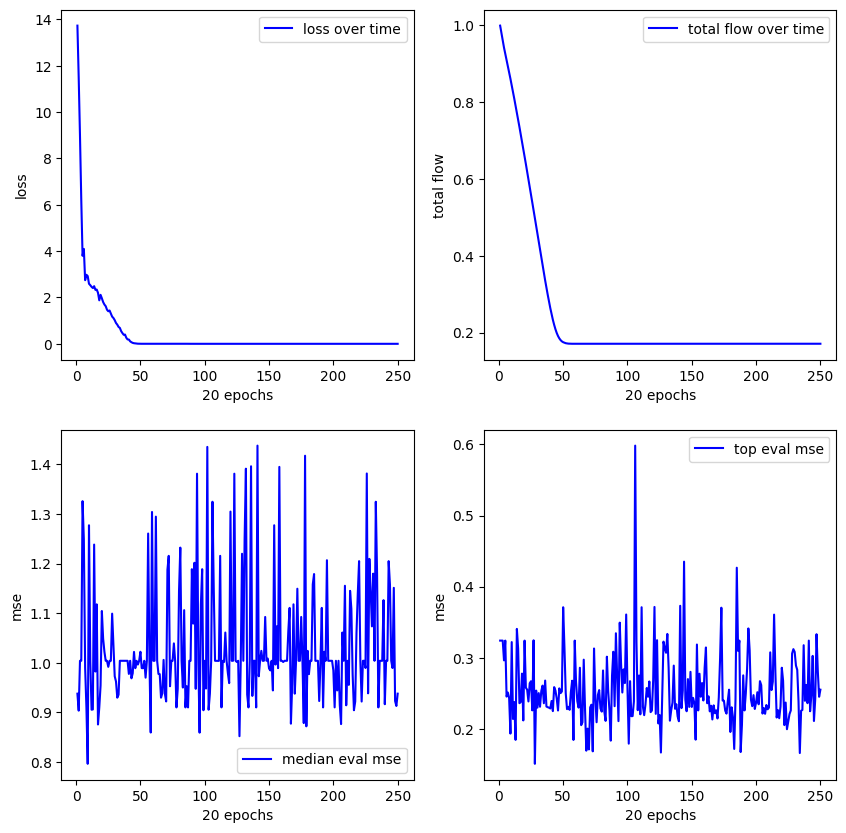

**************************************************
Experiment 2
training started with device cuda


12.121:   0%|          | 2/5000 [00:00<04:45, 17.54it/s]


new best reward (vanilla): 0.9703824520111084
mse (pre/post optimized): 0.02545246109366417/0.02545246109366417
(exp(x1)) * (x1)
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:54<00:00, 43.54it/s]


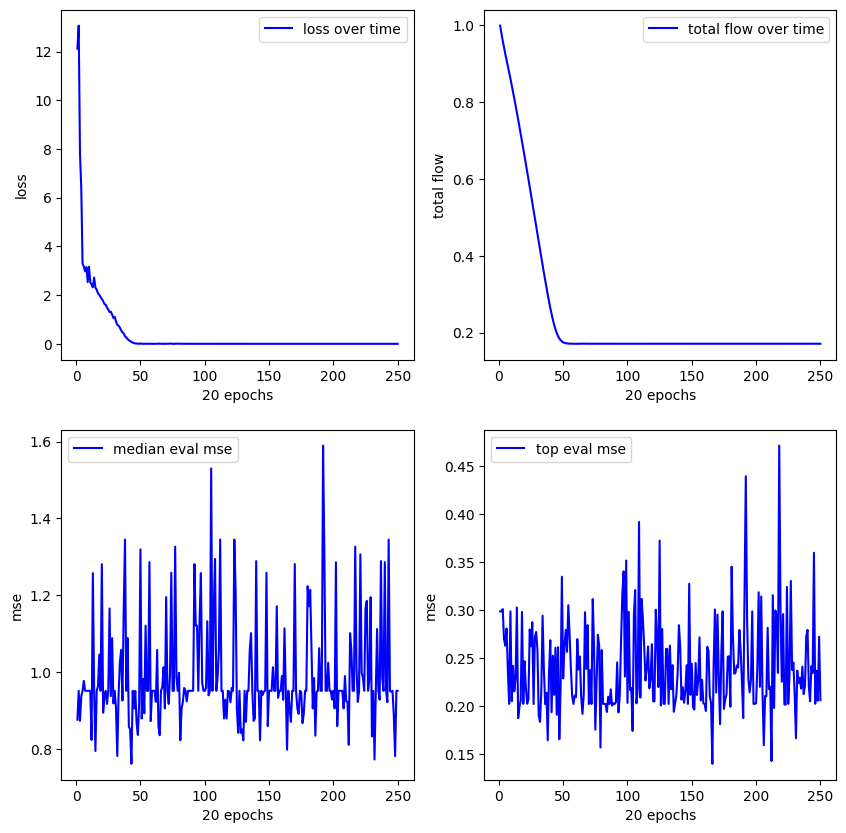

**************************************************
Experiment 3
training started with device cuda


15.327:   0%|          | 2/5000 [00:00<04:20, 19.18it/s]


new best reward (vanilla): 0.8037066459655762
mse (pre/post optimized): 0.18264684081077576/0.15920545160770416
((x1) - (0.19)) + ((x1) + (0.49))
expr: 2*x1 + 0.3


0.000: 100%|██████████| 5000/5000 [01:18<00:00, 63.93it/s]


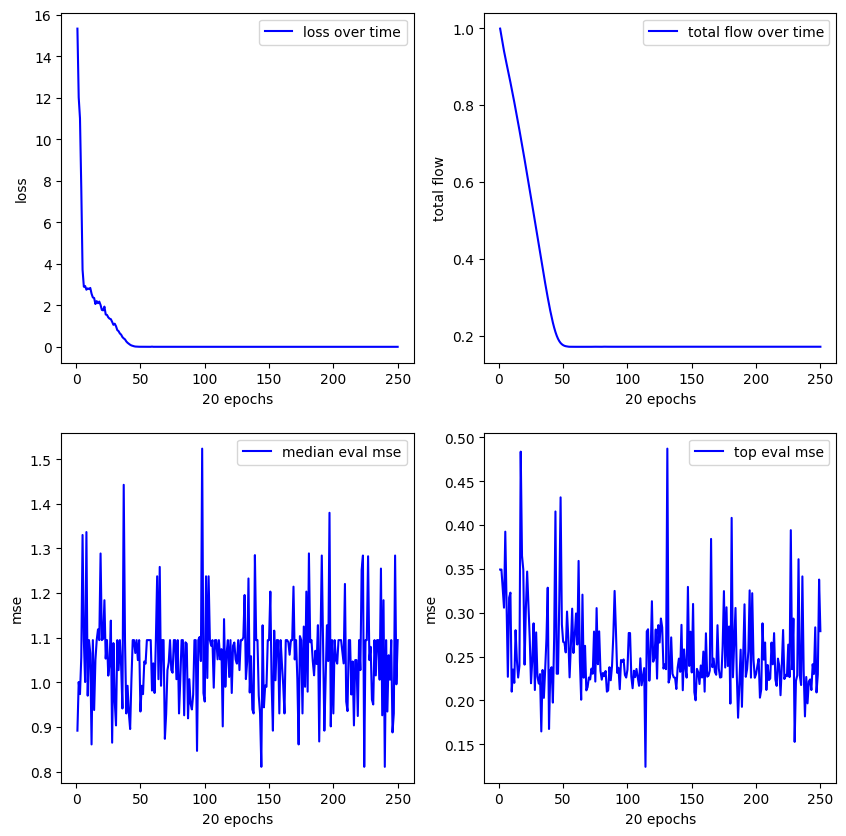

**************************************************
Experiment 4
training started with device cuda


16.163:   0%|          | 2/5000 [00:00<04:14, 19.67it/s]


new best reward (vanilla): 0.696844756603241
mse (pre/post optimized): 0.32934388518333435/0.03376459702849388
((x1) + (0.06)) * (exp(x1))
expr: (x1 + 0.06)*exp(x1)

new best reward (vanilla): 0.8077290058135986
mse (pre/post optimized): 0.07787902653217316/0.07787902653217316
(sin(x1)) * (exp(x1))
expr: exp(x1)*sin(x1)


0.000: 100%|██████████| 5000/5000 [01:14<00:00, 67.01it/s]


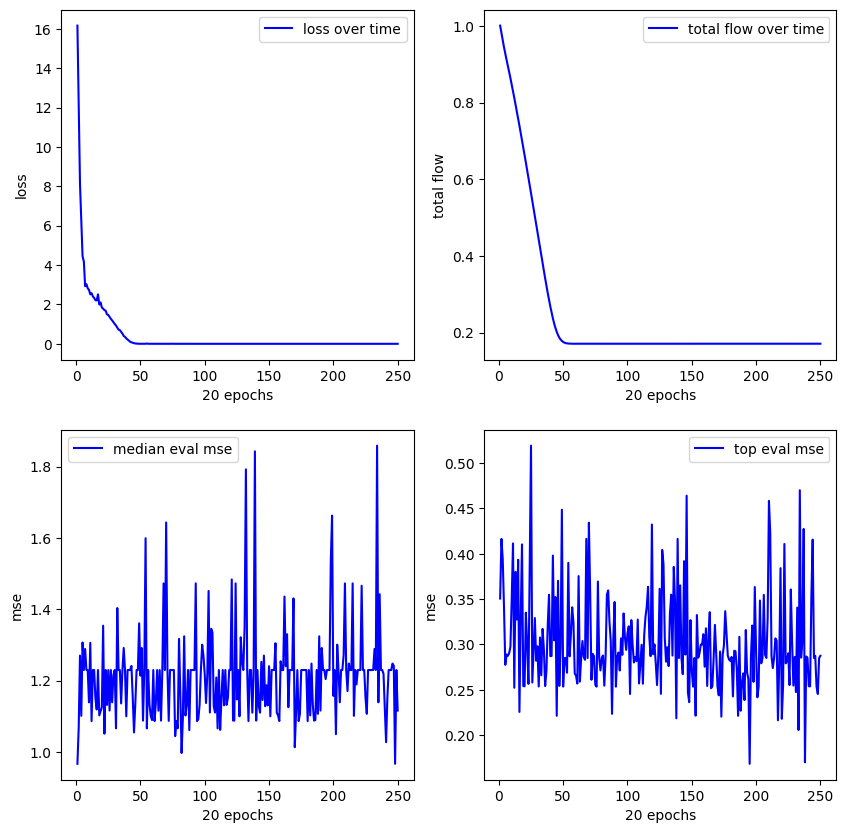

**************************************************
Experiment 5
training started with device cuda


15.112:   0%|          | 2/5000 [00:00<04:16, 19.47it/s]


new best reward (vanilla): 0.8131005167961121
mse (pre/post optimized): 0.15736979246139526/0.15736979246139526
(square(x1)) + (sin(x1))
expr: square(x1) + sin(x1)


0.000: 100%|██████████| 5000/5000 [01:10<00:00, 70.46it/s]


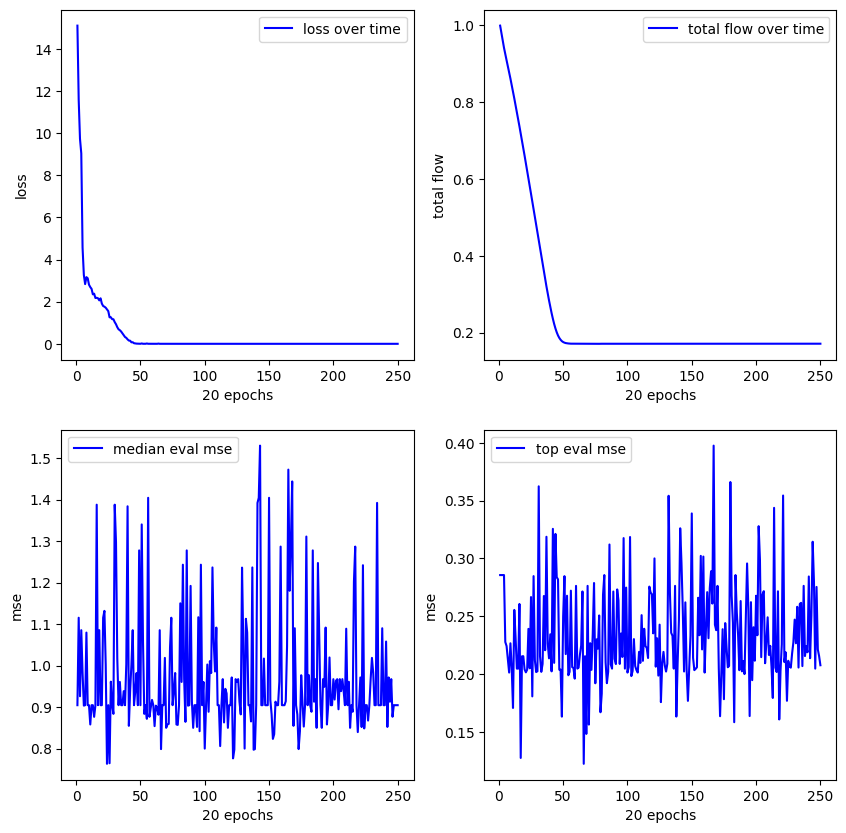

**************************************************
Experiment 6
training started with device cuda


16.246:   0%|          | 4/5000 [00:00<02:12, 37.66it/s]


new best reward (vanilla): 0.8498895764350891
mse (pre/post optimized): 0.12364740669727325/0.10279134660959244
((0.49) * (x1)) + ((x1) + (0.33))
expr: 1.49*x1 + 0.33


0.000: 100%|██████████| 5000/5000 [01:23<00:00, 60.21it/s]


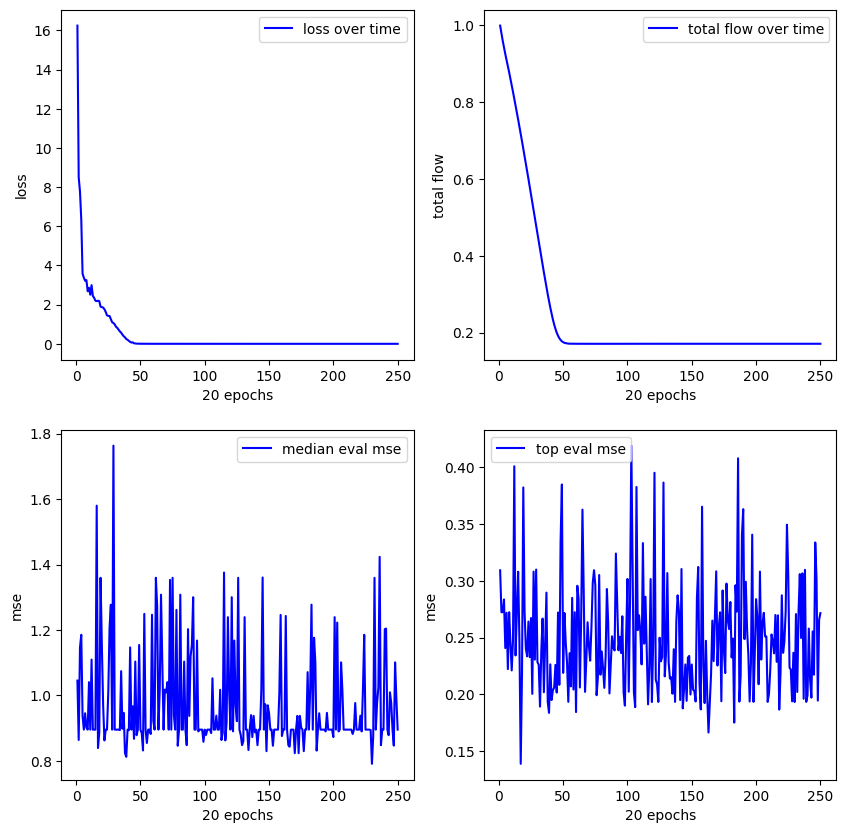

**************************************************
Experiment 7
training started with device cuda


14.528:   0%|          | 2/5000 [00:00<04:45, 17.54it/s]


new best reward (vanilla): 0.6895799040794373
mse (pre/post optimized): 0.23214079439640045/0.19099308550357819
square((0.52) + (x1))
expr: square(x1 + 0.52)

new best reward (vanilla): 0.7644221782684326
mse (pre/post optimized): 0.055902060121297836/0.055902060121297836
(exp(x1)) * (sin(x1))
expr: exp(x1)*sin(x1)


0.000: 100%|██████████| 5000/5000 [01:19<00:00, 63.07it/s]


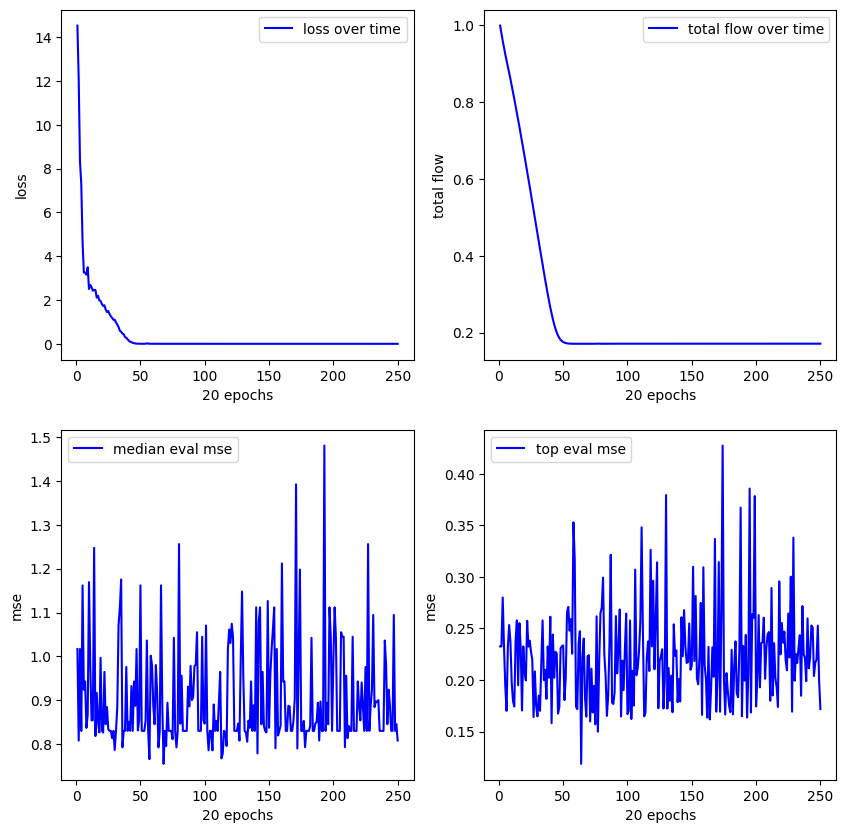

**************************************************
Experiment 8
training started with device cuda


12.751:   0%|          | 5/5000 [00:00<01:54, 43.65it/s]


new best reward (vanilla): 0.6492246389389038
mse (pre/post optimized): 0.3185322880744934/0.16959697008132935
(sin(x1)) * ((1.04) + (x1))
expr: (x1 + 1.04)*sin(x1)


12.751:   0%|          | 10/5000 [00:00<01:46, 46.88it/s]


new best reward (vanilla): 0.7455479502677917
mse (pre/post optimized): 0.024907169863581657/0.021289784461259842
(exp(x1)) / ((0.89) / (x1))
expr: 1.12359550561798*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:18<00:00, 63.56it/s]


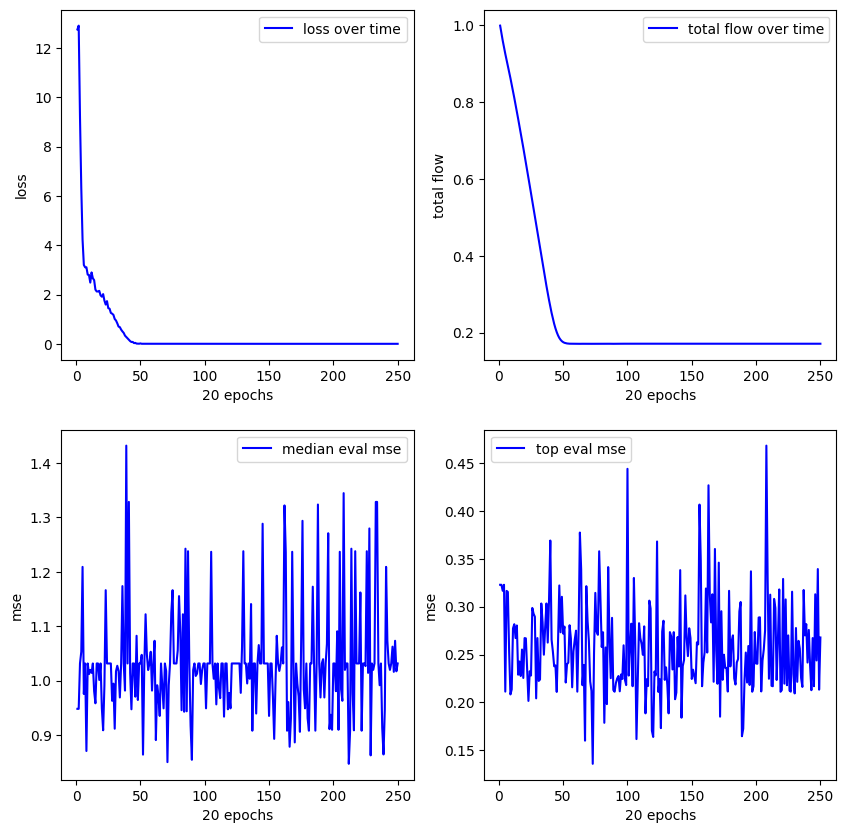

**************************************************
Experiment 9
training started with device cuda


12.147:   0%|          | 4/5000 [00:00<02:13, 37.44it/s]


new best reward (vanilla): 0.7513174414634705
mse (pre/post optimized): 0.25052037835121155/0.25052037835121155
(x1) + (sin(x1))
expr: x1 + sin(x1)

new best reward (vanilla): 0.8014411926269531
mse (pre/post optimized): 0.03273838385939598/0.03273838385939598
(exp(x1)) * (x1)
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:17<00:00, 64.64it/s]


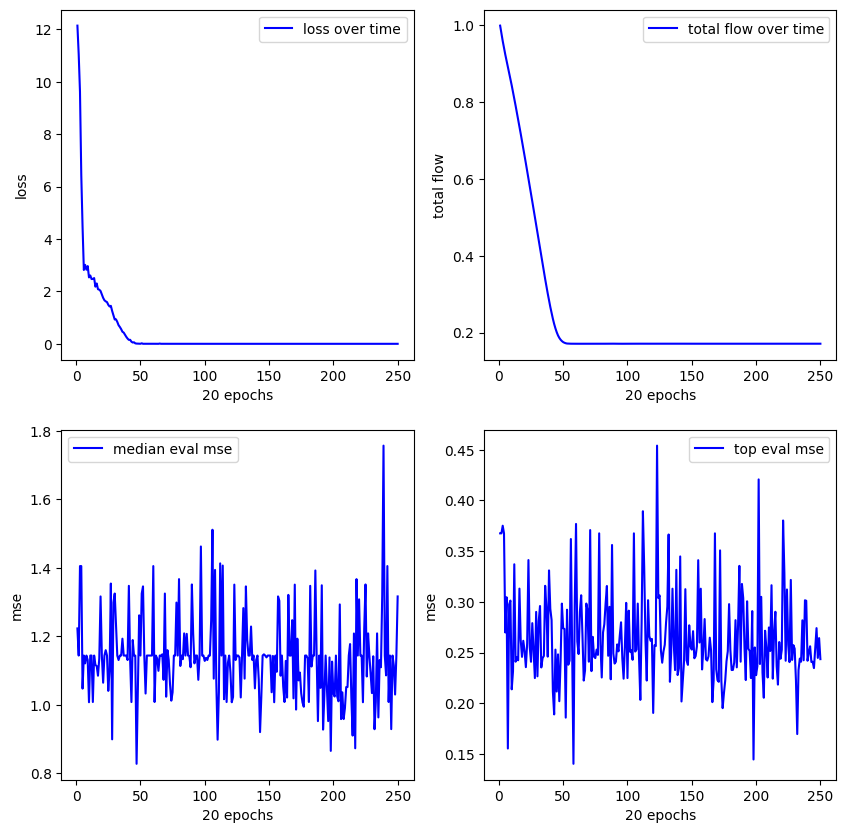

**************************************************
Experiment 10
training started with device cuda


13.694:   0%|          | 4/5000 [00:00<02:13, 37.29it/s]


new best reward (vanilla): 0.6659078001976013
mse (pre/post optimized): 0.2840791642665863/0.26861828565597534
sin((x1) / (0.62))
expr: sin(1.61290322580645*x1)

new best reward (vanilla): 0.923020601272583
mse (pre/post optimized): 0.02622699737548828/0.026149842888116837
(exp(x1)) * ((0.03) + (x1))
expr: (x1 + 0.03)*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:08<00:00, 72.54it/s]


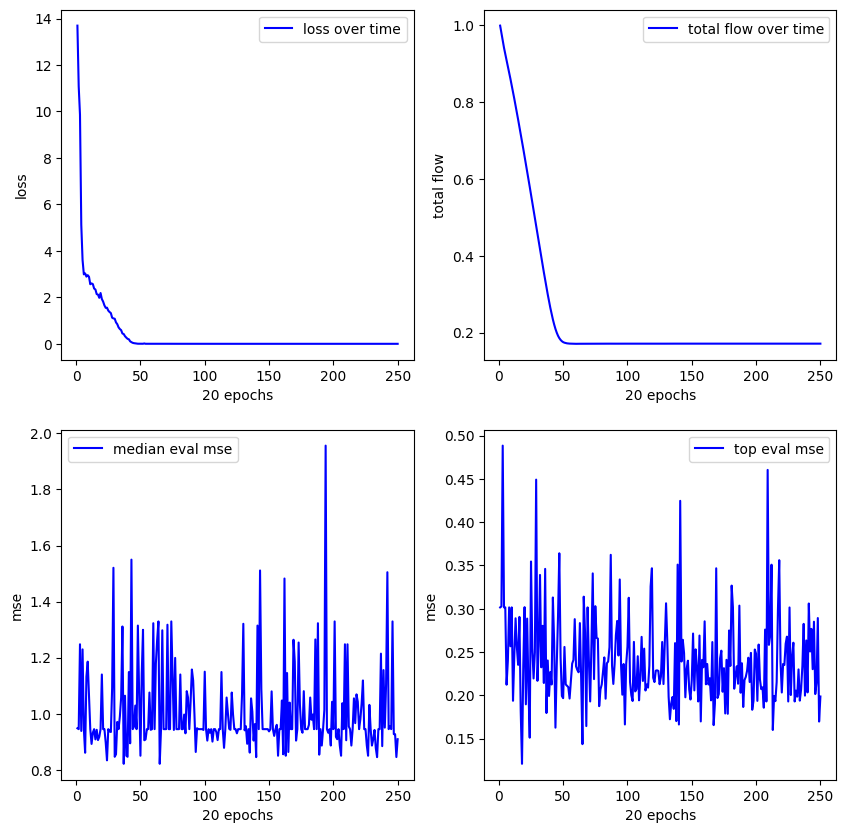

**************************************************
Experiment 11
training started with device cuda


13.973:   0%|          | 3/5000 [00:00<03:13, 25.77it/s]


new best reward (vanilla): 0.844051718711853
mse (pre/post optimized): 0.14256879687309265/0.06935541331768036
(square(x1)) + ((1.21) * (x1))
expr: 1.21*x1 + square(x1)

new best reward (vanilla): 0.8471763730049133
mse (pre/post optimized): 0.03358031436800957/0.03358031436800957
(x1) * (exp(x1))
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:34<00:00, 53.06it/s]


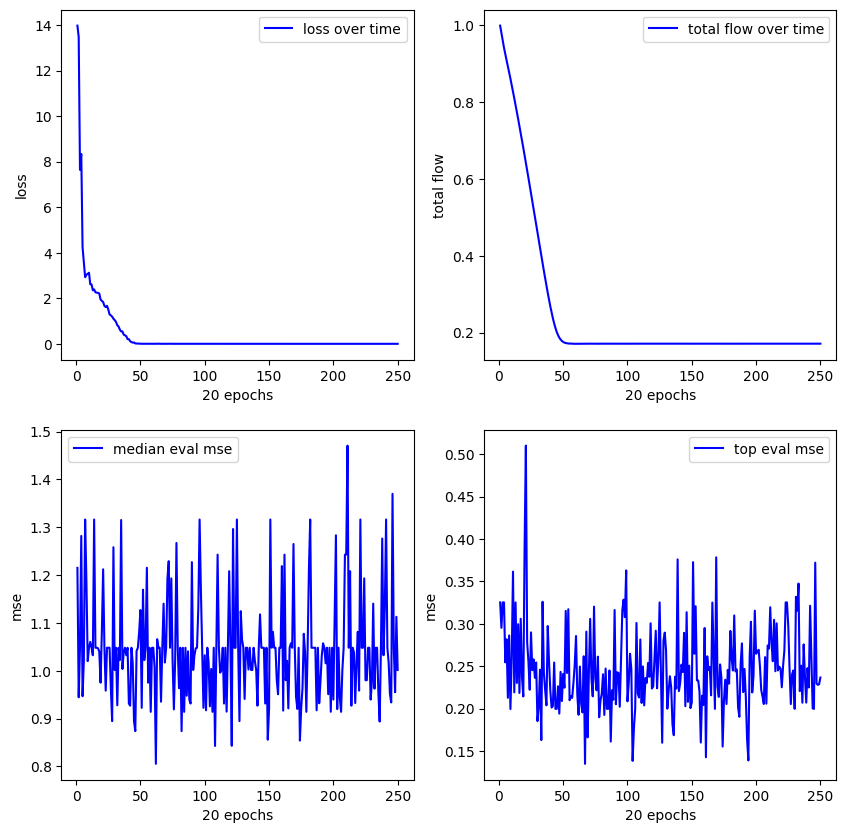

**************************************************
Experiment 12
training started with device cuda


9.751:   0%|          | 1/5000 [00:00<14:38,  5.69it/s]


new best reward (vanilla): 0.6527218818664551
mse (pre/post optimized): 0.3291577994823456/0.3291577994823456
x1
expr: x1

new best reward (vanilla): 0.7773672342300415
mse (pre/post optimized): 0.08705480396747589/0.06268862634897232
((0.31) + (x1)) / (cos(x1))
expr: (x1 + 0.31)/cos(x1)


0.000: 100%|██████████| 5000/5000 [01:15<00:00, 66.55it/s]


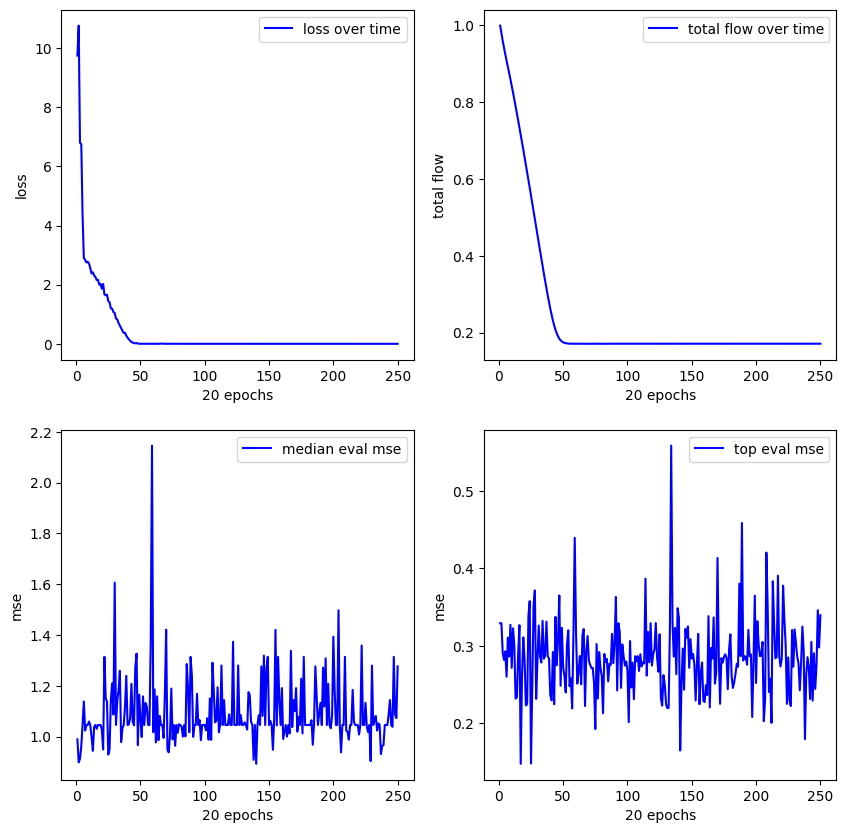

**************************************************
Experiment 13
training started with device cuda


12.108:   0%|          | 3/5000 [00:00<02:50, 29.36it/s]


new best reward (vanilla): 0.8978102207183838
mse (pre/post optimized): 0.11543325334787369/0.11543325334787369
(exp(x1)) - (cos(x1))
expr: exp(x1) - cos(x1)


0.000: 100%|██████████| 5000/5000 [01:20<00:00, 61.99it/s]


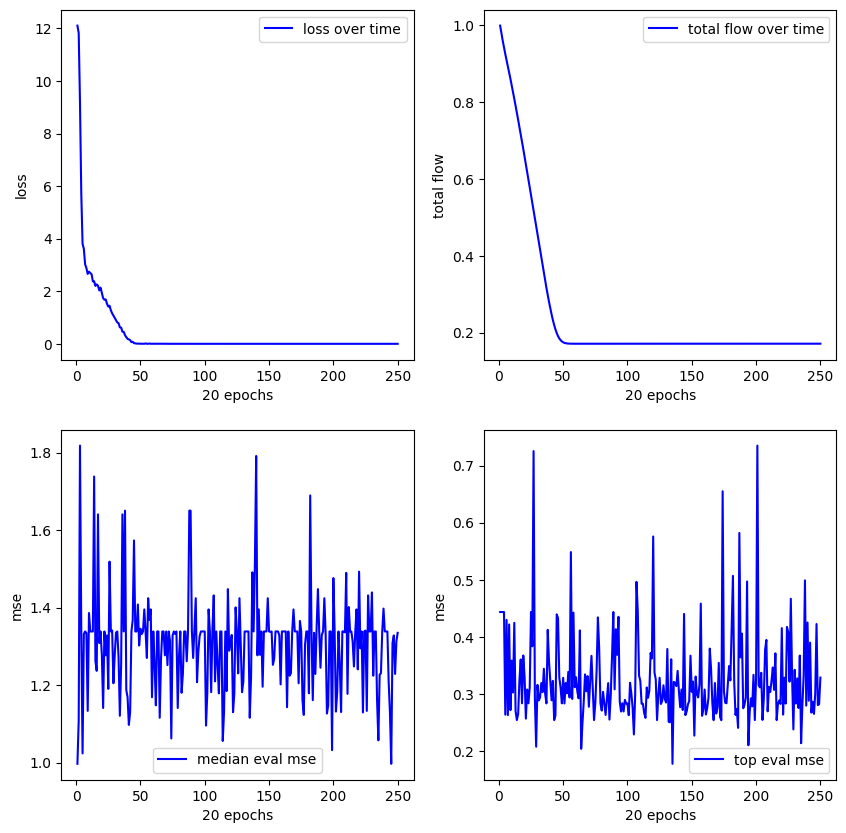

**************************************************
Experiment 14
training started with device cuda


15.681:   0%|          | 3/5000 [00:00<02:57, 28.18it/s]


new best reward (vanilla): 0.7612908482551575
mse (pre/post optimized): 0.20651012659072876/0.20706559717655182
((0.57) * (x1)) + (sin(x1))
expr: 0.57*x1 + sin(x1)


15.681:   0%|          | 7/5000 [00:00<02:29, 33.49it/s]


new best reward (vanilla): 0.7635550498962402
mse (pre/post optimized): 0.030011728405952454/0.2578735649585724
((0.75) * (x1)) + (square(x1))
expr: 0.75*x1 + square(x1)


0.000: 100%|██████████| 5000/5000 [01:28<00:00, 56.79it/s]


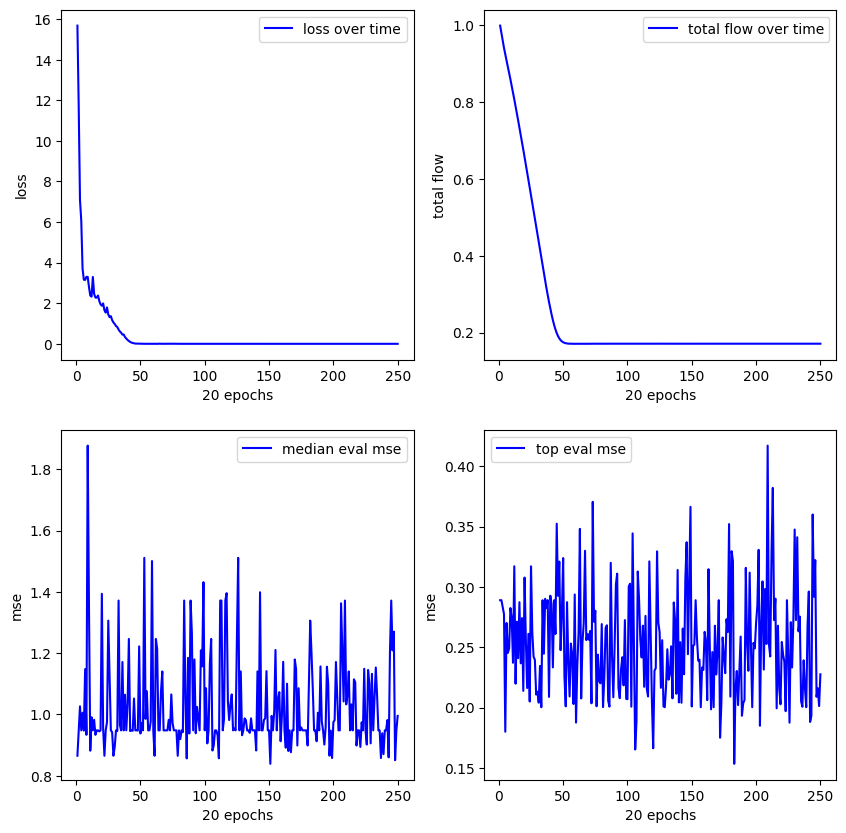

**************************************************
Experiment 15
training started with device cuda


15.846:   0%|          | 1/5000 [00:00<11:44,  7.09it/s]


new best reward (vanilla): 0.8513986468315125
mse (pre/post optimized): 0.13095144927501678/0.13095144927501678
(square(x1)) + (x1)
expr: x1 + square(x1)


0.000: 100%|██████████| 5000/5000 [01:56<00:00, 42.95it/s]


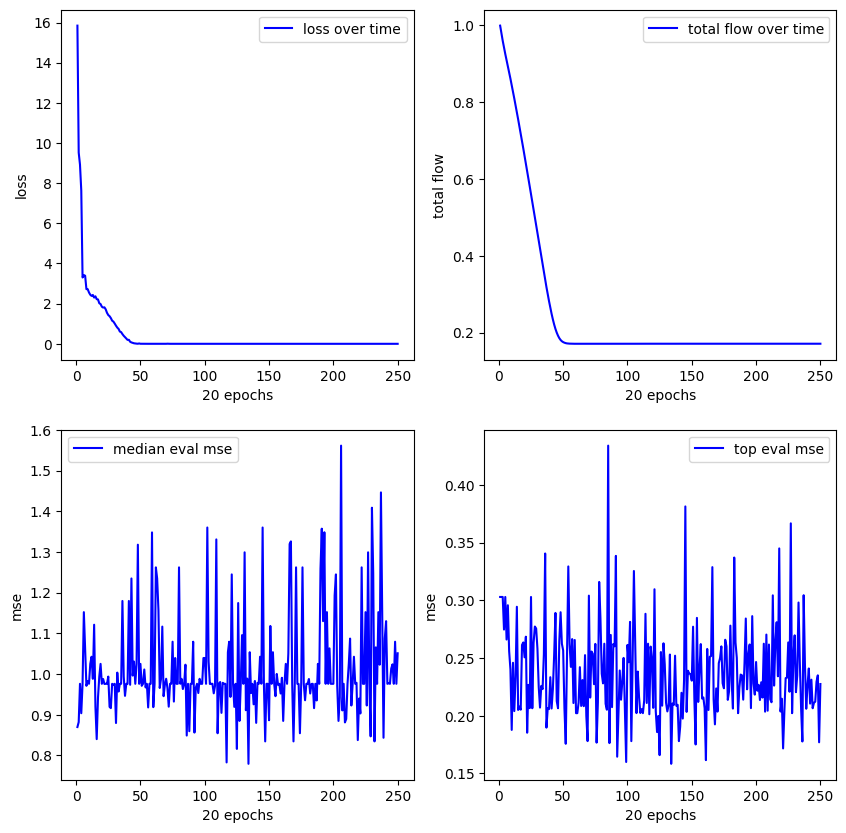

**************************************************
Experiment 16
training started with device cuda


13.407:   0%|          | 4/5000 [00:00<02:10, 38.36it/s]


new best reward (vanilla): 0.770208477973938
mse (pre/post optimized): 0.23711706697940826/0.14487773180007935
(sin(x1)) + ((0.35) + (x1))
expr: x1 + sin(x1) + 0.35


0.000: 100%|██████████| 5000/5000 [01:19<00:00, 62.65it/s]


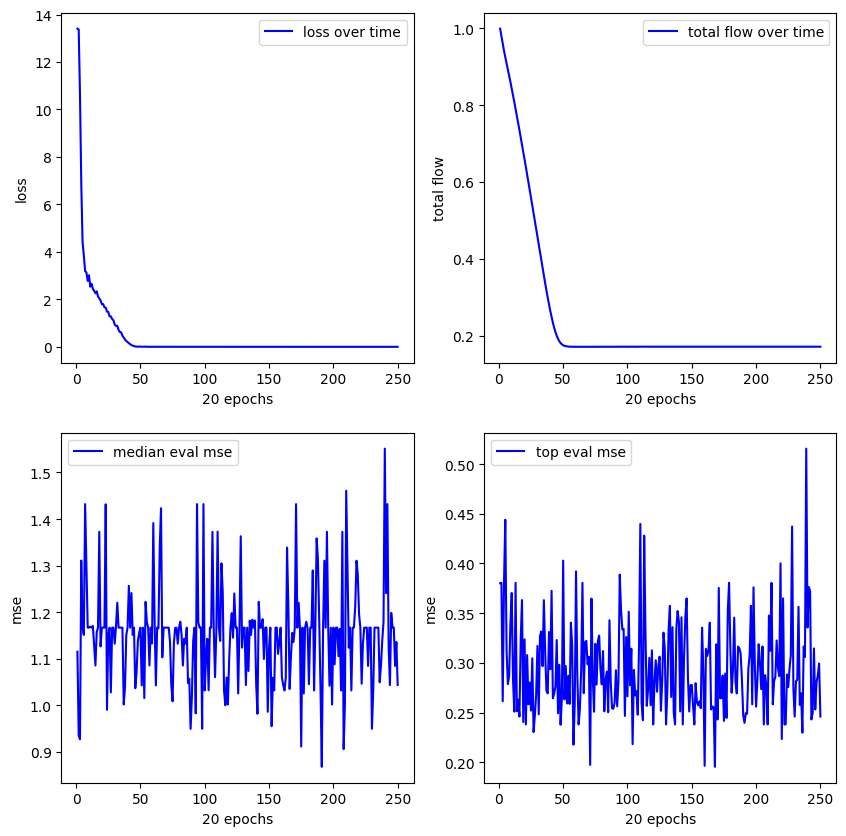

**************************************************
Experiment 17
training started with device cuda


18.123:   0%|          | 3/5000 [00:00<03:20, 24.88it/s]


new best reward (vanilla): 0.8521318435668945
mse (pre/post optimized): 0.18092872202396393/0.15456193685531616
((x1) + (0.38)) + (sin(x1))
expr: x1 + sin(x1) + 0.38


0.000: 100%|██████████| 5000/5000 [01:18<00:00, 63.72it/s]


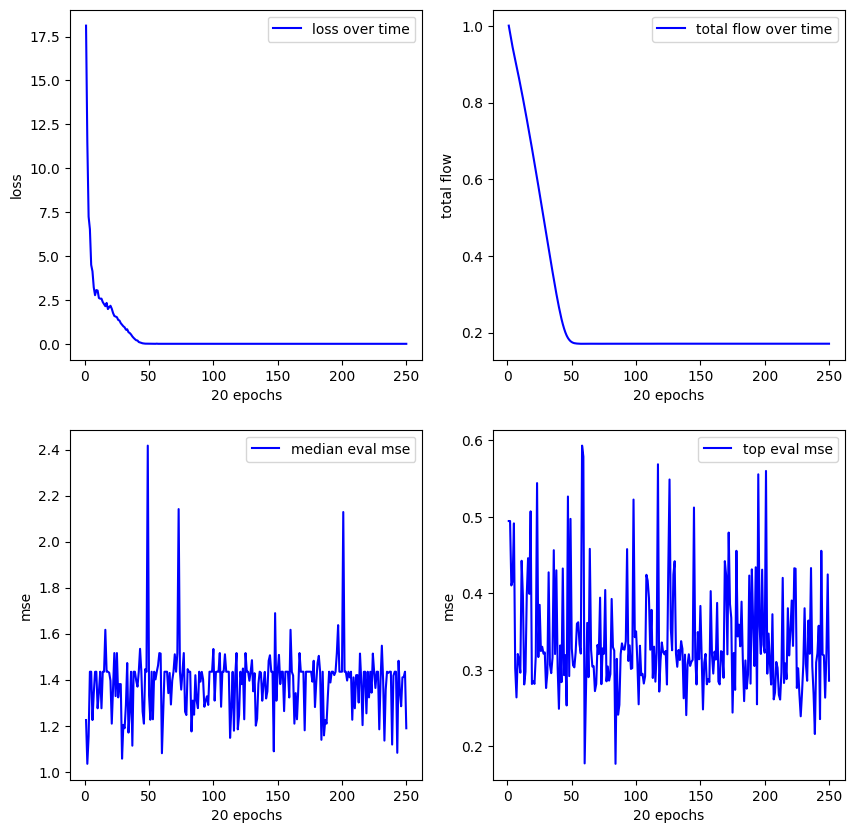

**************************************************
Experiment 18
training started with device cuda


17.381:   0%|          | 3/5000 [00:00<02:46, 29.98it/s]


new best reward (vanilla): 0.7737899422645569
mse (pre/post optimized): 0.21245607733726501/0.21077637374401093
((0.54) * (x1)) + (x1)
expr: 1.54*x1


0.000: 100%|██████████| 5000/5000 [01:19<00:00, 62.55it/s]


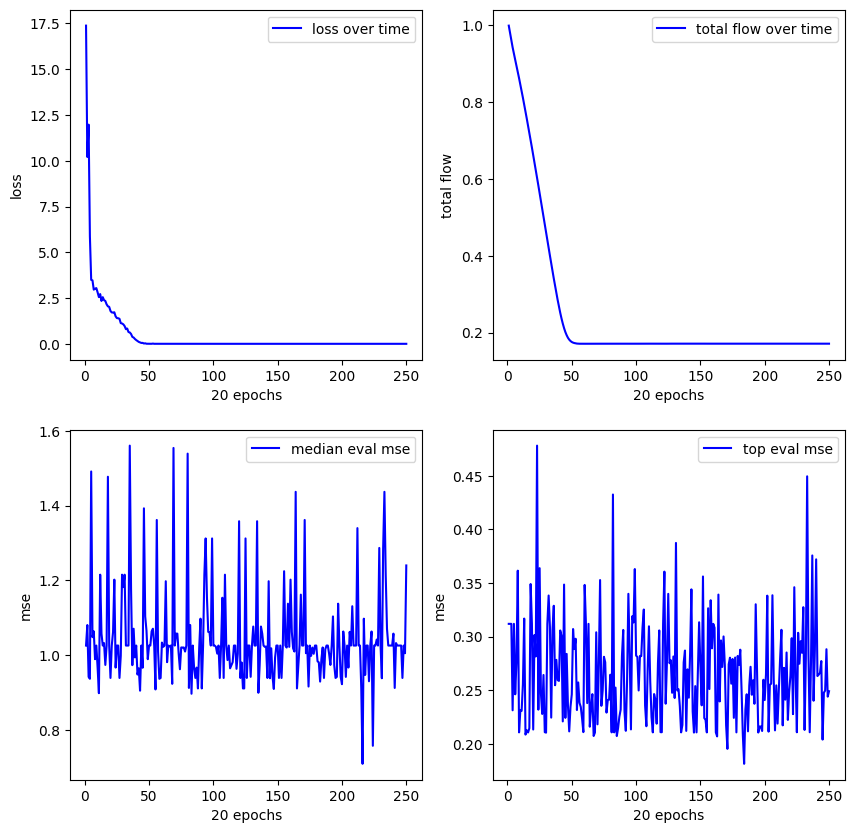

**************************************************
Experiment 19
training started with device cuda


11.312:   0%|          | 4/5000 [00:00<02:14, 37.21it/s]


new best reward (vanilla): 0.8524916172027588
mse (pre/post optimized): 0.15497085452079773/0.15497085452079773
(x1) + (square(x1))
expr: x1 + square(x1)

new best reward (vanilla): 0.8532319664955139
mse (pre/post optimized): 0.03588959574699402/0.03588959574699402
(x1) * (exp(x1))
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:09<00:00, 71.76it/s]


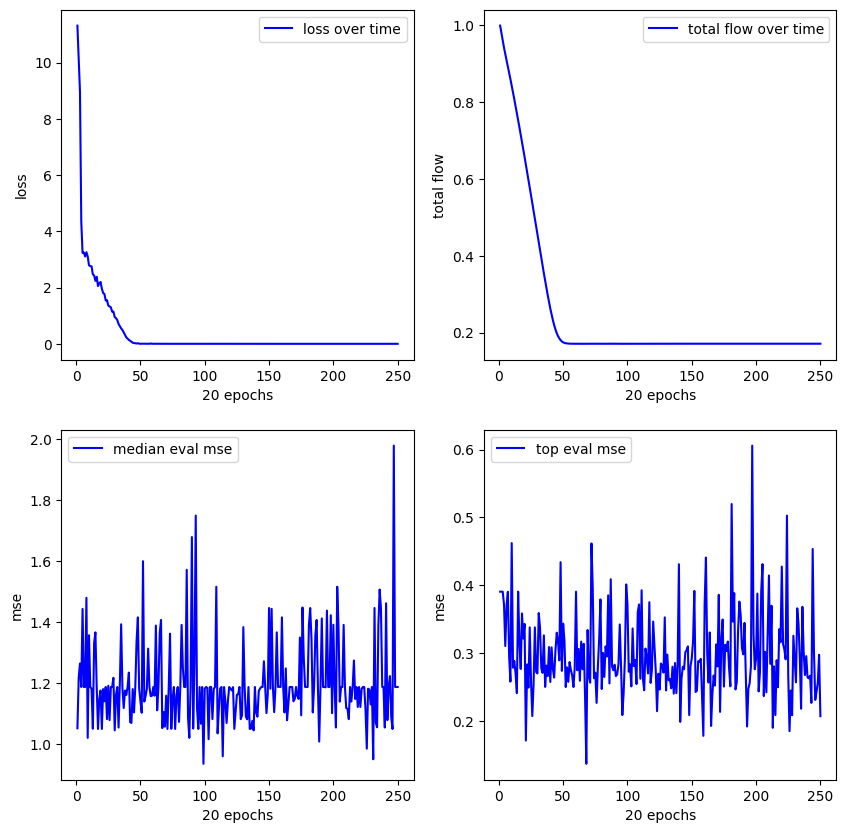

**************************************************
Experiment 20
training started with device cuda


17.060:   0%|          | 6/5000 [00:00<01:34, 52.73it/s]


new best reward (vanilla): 0.9710113406181335
mse (pre/post optimized): 0.027959652245044708/0.027959652245044708
(exp(x1)) * (x1)
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:14<00:00, 66.97it/s]


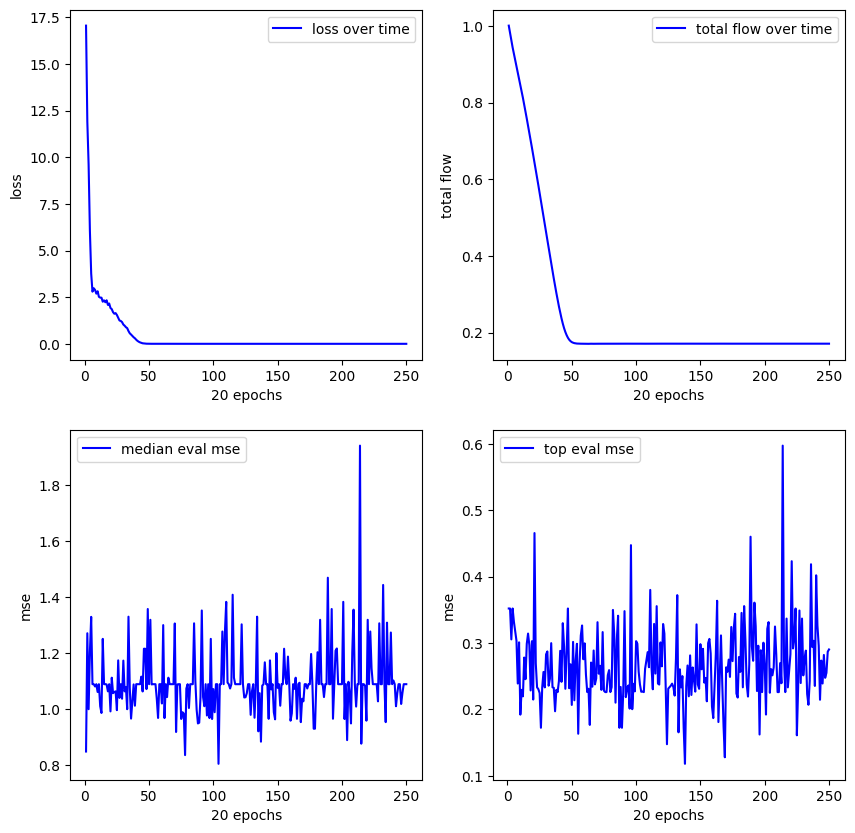

--------------------------------------------------
FUNCTION x**4 + x**3 + x**2 + x Interval considered: [-1, 1]
**************************************************
Experiment 1
training started with device cuda


13.245:   0%|          | 3/5000 [00:00<02:49, 29.55it/s]


new best reward (vanilla): 0.8500819206237793
mse (pre/post optimized): 0.1962796002626419/0.5258811712265015
((x1) - (0.3)) * (exp(x1))
expr: (x1 - 0.3)*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:05<00:00, 76.31it/s]


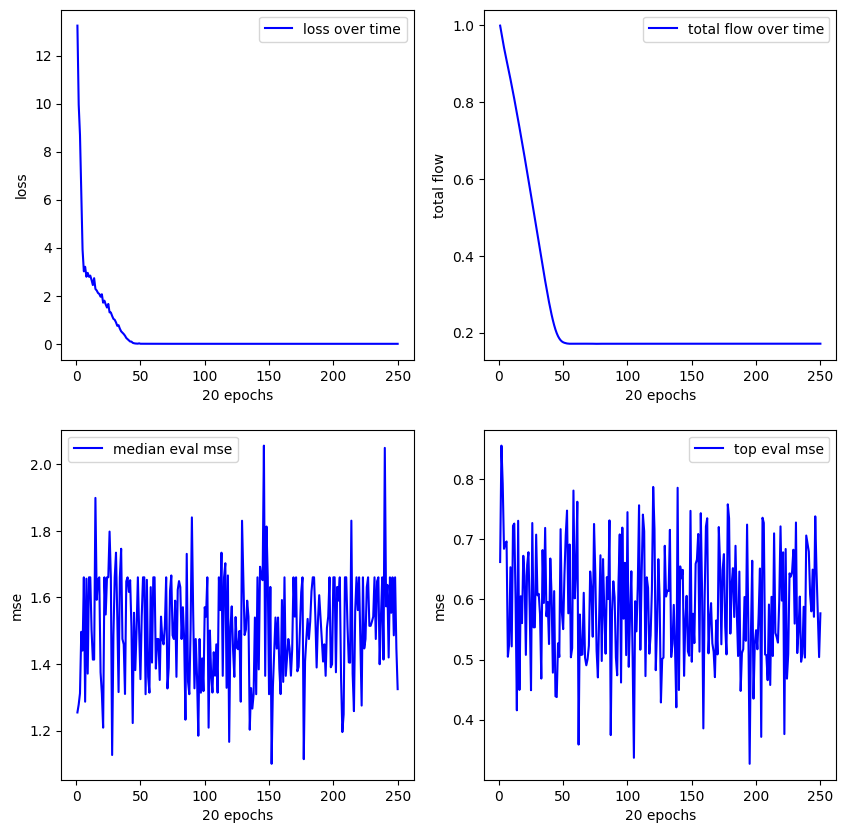

**************************************************
Experiment 2
training started with device cuda


14.901:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.6400747299194336
mse (pre/post optimized): 0.3617921471595764/0.35917893052101135
((x1) - (0.09)) + ((x1) + (0.59))
expr: 2*x1 + 0.5


14.901:   0%|          | 10/5000 [00:00<02:56, 28.29it/s]


new best reward (vanilla): 0.6416611075401306
mse (pre/post optimized): 0.08290188014507294/0.08290188014507294
(x1) * (exp(x1))
expr: x1*exp(x1)


13.306:   0%|          | 22/5000 [00:00<02:30, 32.98it/s]


new best reward (vanilla): 0.7838586568832397
mse (pre/post optimized): 0.021127115935087204/0.036597564816474915
(exp(x1)) * ((x1) / (0.69))
expr: 1.44927536231884*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:09<00:00, 72.36it/s]


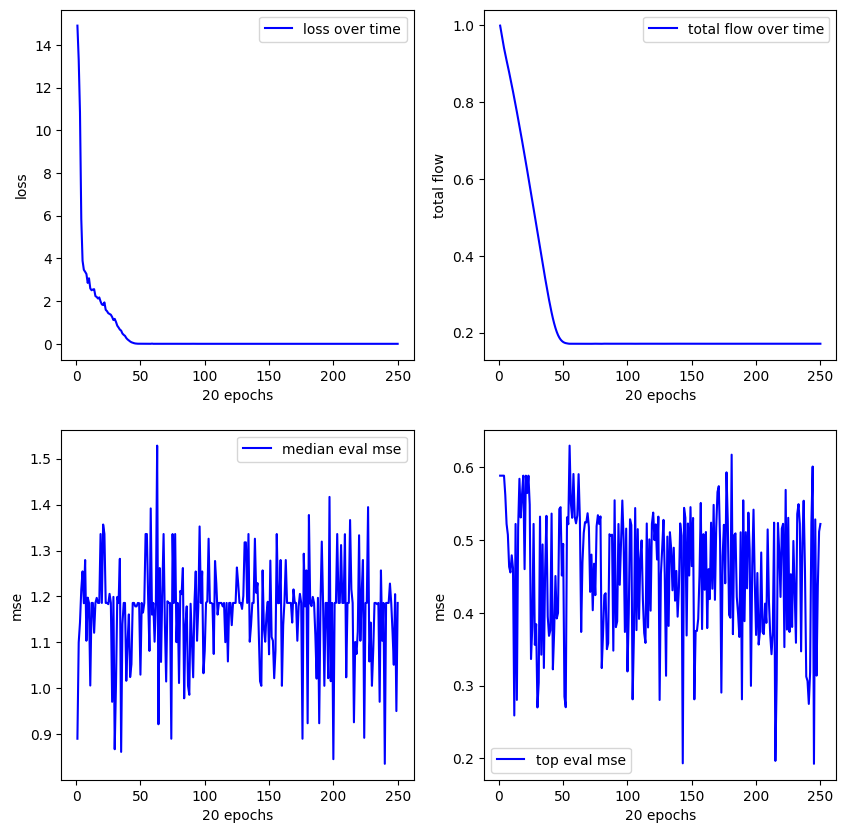

**************************************************
Experiment 3
training started with device cuda


17.559:   0%|          | 3/5000 [00:00<03:09, 26.35it/s]


new best reward (vanilla): 0.7230837345123291
mse (pre/post optimized): 0.3894045352935791/0.3894045352935791
(square(x1)) + (sin(x1))
expr: square(x1) + sin(x1)


0.000: 100%|██████████| 5000/5000 [01:22<00:00, 60.35it/s]


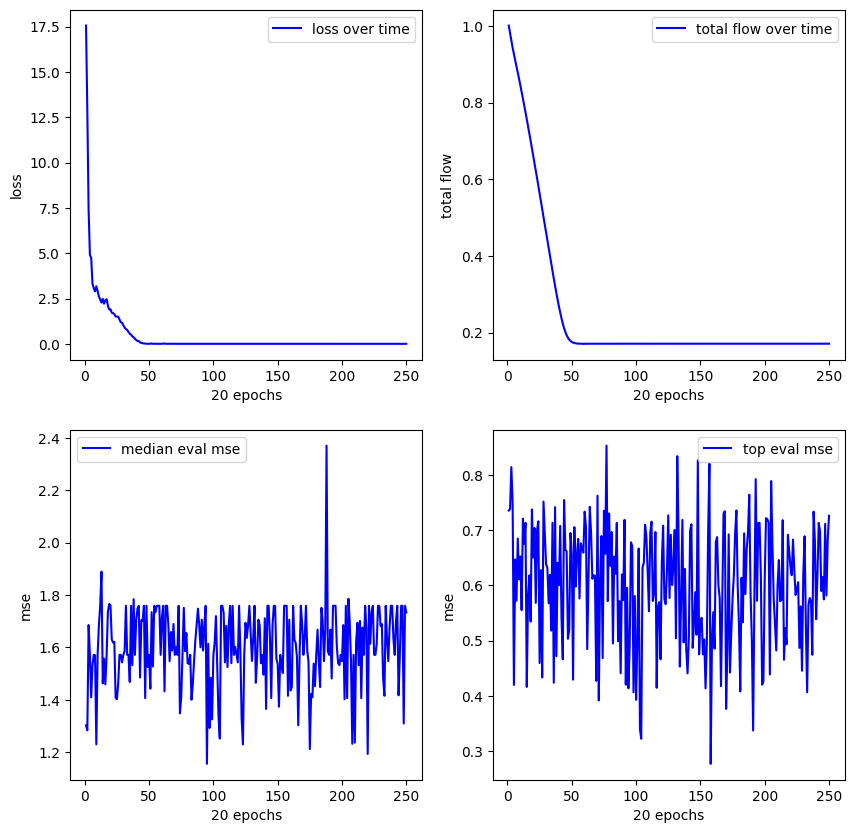

**************************************************
Experiment 4
training started with device cuda


13.008:   0%|          | 3/5000 [00:00<02:51, 29.17it/s]


new best reward (vanilla): 0.7440555095672607
mse (pre/post optimized): 0.2517021894454956/0.15671245753765106
square((0.59) + (x1))
expr: square(x1 + 0.59)


0.000: 100%|██████████| 5000/5000 [01:27<00:00, 56.97it/s]


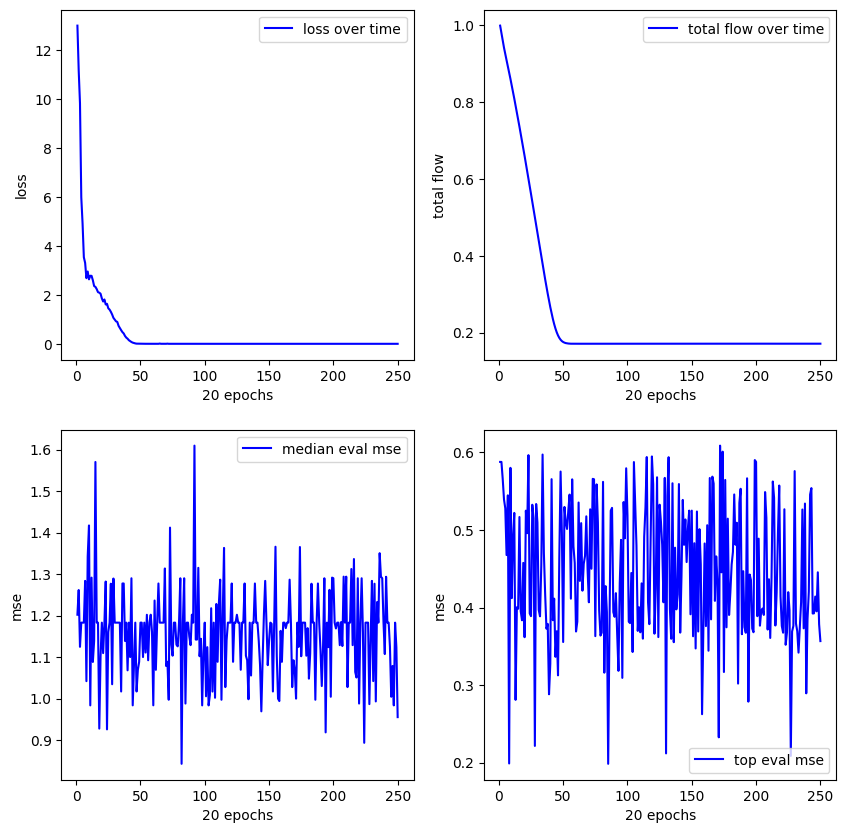

**************************************************
Experiment 5
training started with device cuda


11.350:   0%|          | 3/5000 [00:00<02:47, 29.87it/s]


new best reward (vanilla): 0.5468759536743164
mse (pre/post optimized): 0.51460862159729/0.48609527945518494
(sin(x1)) + (0.52)
expr: sin(x1) + 0.52

new best reward (vanilla): 0.548109769821167
mse (pre/post optimized): 0.1759786754846573/0.1759786754846573
(sin(x1)) * (exp(x1))
expr: exp(x1)*sin(x1)


11.350:   0%|          | 8/5000 [00:00<02:09, 38.69it/s]


new best reward (vanilla): 0.7464338541030884
mse (pre/post optimized): 0.04783696308732033/0.05792449787259102
(exp(x1)) * ((0.25) + (x1))
expr: (x1 + 0.25)*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:22<00:00, 60.30it/s]


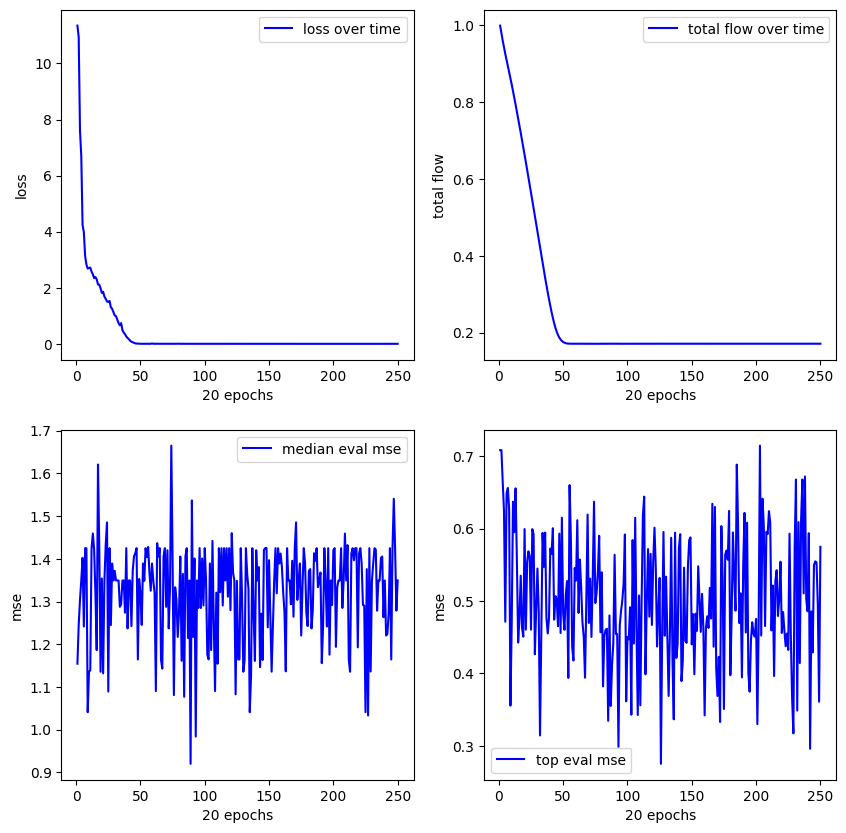

**************************************************
Experiment 6
training started with device cuda


13.284:   0%|          | 2/5000 [00:00<04:47, 17.36it/s]


new best reward (vanilla): 0.7854841947555542
mse (pre/post optimized): 0.23015139997005463/0.16148923337459564
(square(x1)) + ((1.22) * (x1))
expr: 1.22*x1 + square(x1)


0.000: 100%|██████████| 5000/5000 [01:19<00:00, 63.00it/s]


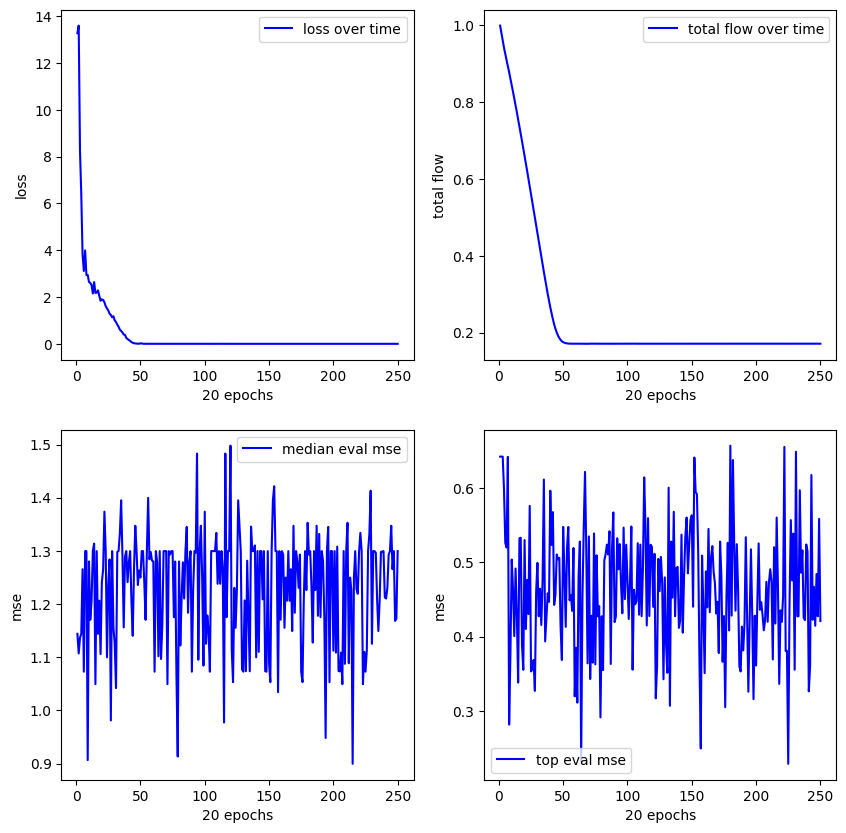

**************************************************
Experiment 7
training started with device cuda


11.169:   0%|          | 4/5000 [00:00<02:09, 38.53it/s]


new best reward (vanilla): 0.8251931667327881
mse (pre/post optimized): 0.20401012897491455/0.20401012897491455
(exp(x1)) - (cos(x1))
expr: exp(x1) - cos(x1)


0.000: 100%|██████████| 5000/5000 [01:18<00:00, 64.09it/s]


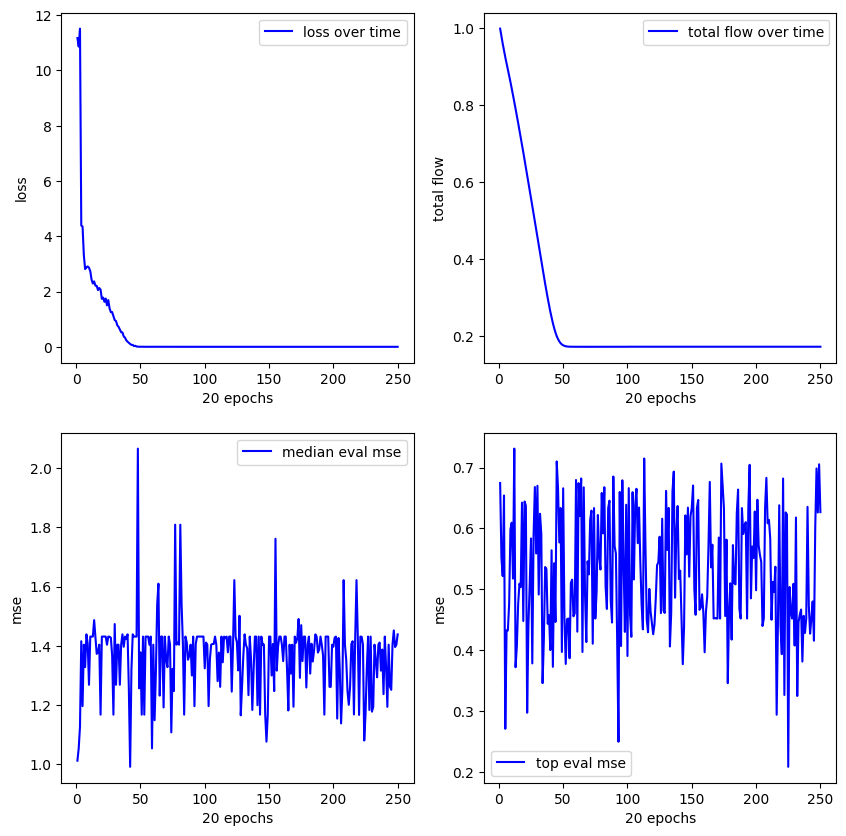

**************************************************
Experiment 8
training started with device cuda


15.662:   0%|          | 5/5000 [00:00<01:45, 47.53it/s]


new best reward (vanilla): 0.7899248600006104
mse (pre/post optimized): 0.2172313630580902/0.2172313630580902
(square(x1)) + (x1)
expr: x1 + square(x1)


0.000: 100%|██████████| 5000/5000 [01:27<00:00, 57.39it/s]


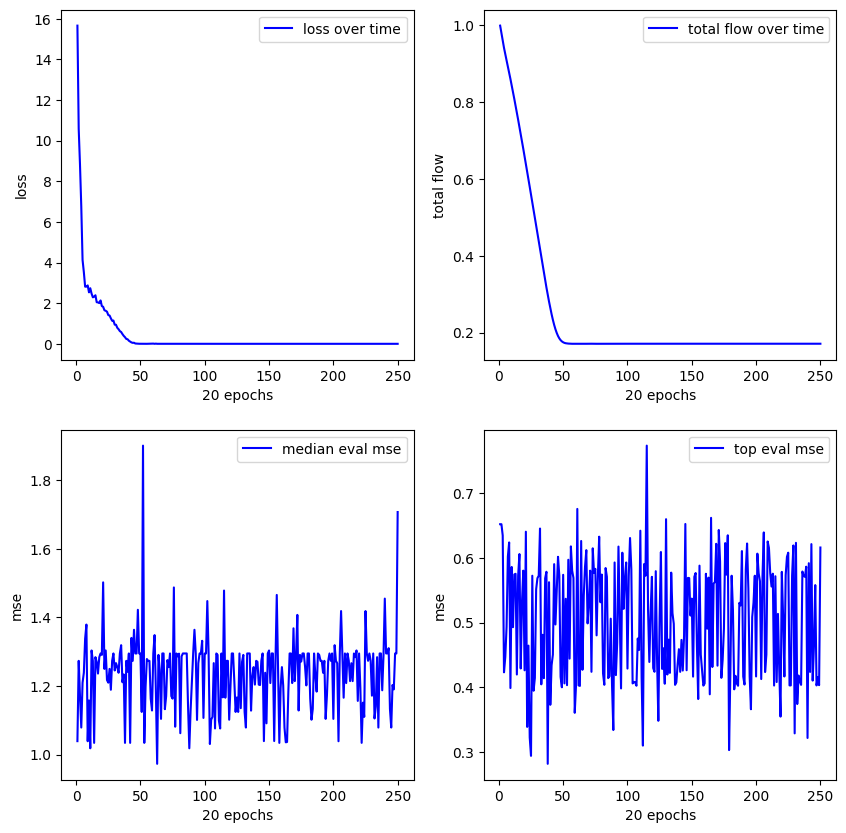

**************************************************
Experiment 9
training started with device cuda


16.805:   0%|          | 3/5000 [00:00<03:10, 26.29it/s]


new best reward (vanilla): 0.7233114242553711
mse (pre/post optimized): 0.3555898666381836/0.3568781018257141
((x1) + (0.52)) + (sin(x1))
expr: x1 + sin(x1) + 0.52


0.000: 100%|██████████| 5000/5000 [01:29<00:00, 55.98it/s]


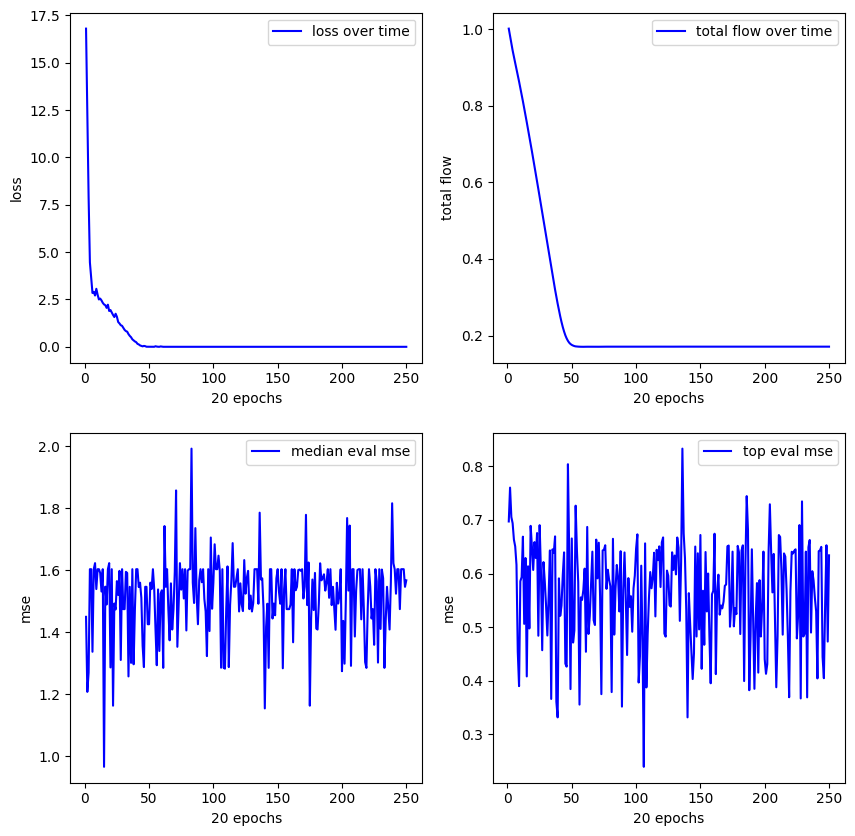

**************************************************
Experiment 10
training started with device cuda


10.308:   0%|          | 2/5000 [00:00<04:43, 17.65it/s]


new best reward (vanilla): 0.8001710176467896
mse (pre/post optimized): 0.21672385931015015/0.21672385931015015
(x1) + (square(x1))
expr: x1 + square(x1)


0.000: 100%|██████████| 5000/5000 [01:21<00:00, 61.20it/s]


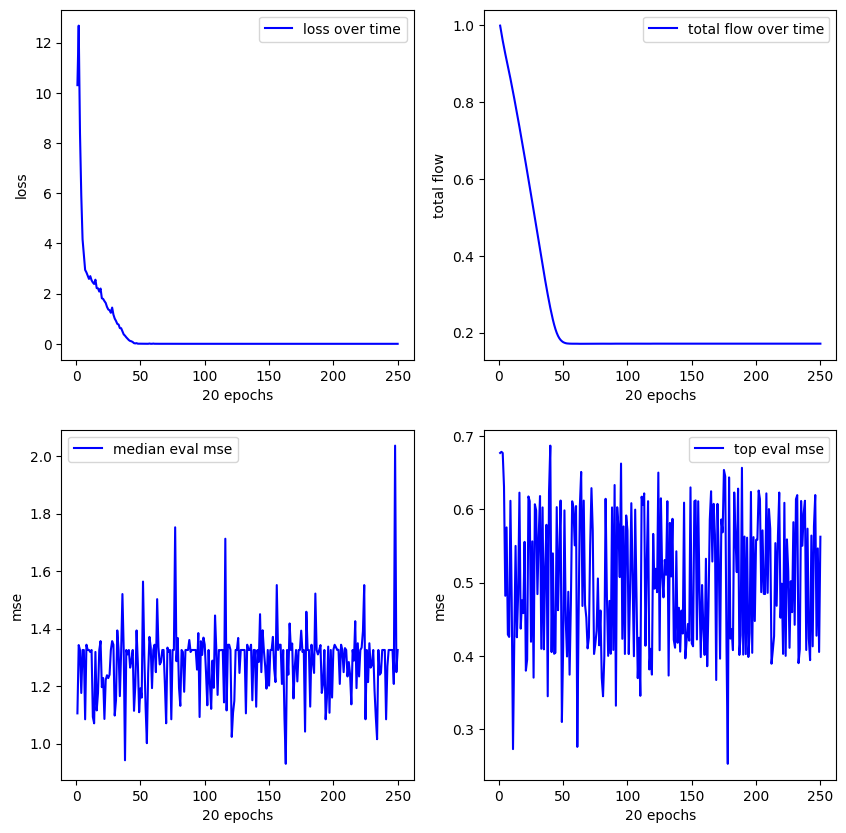

**************************************************
Experiment 11
training started with device cuda


13.816:   0%|          | 3/5000 [00:00<02:59, 27.89it/s]


new best reward (vanilla): 0.8214199542999268
mse (pre/post optimized): 0.210309237241745/0.21028125286102295
((0.2) + (x1)) + (square(x1))
expr: x1 + square(x1) + 0.2


0.000: 100%|██████████| 5000/5000 [01:21<00:00, 61.11it/s]


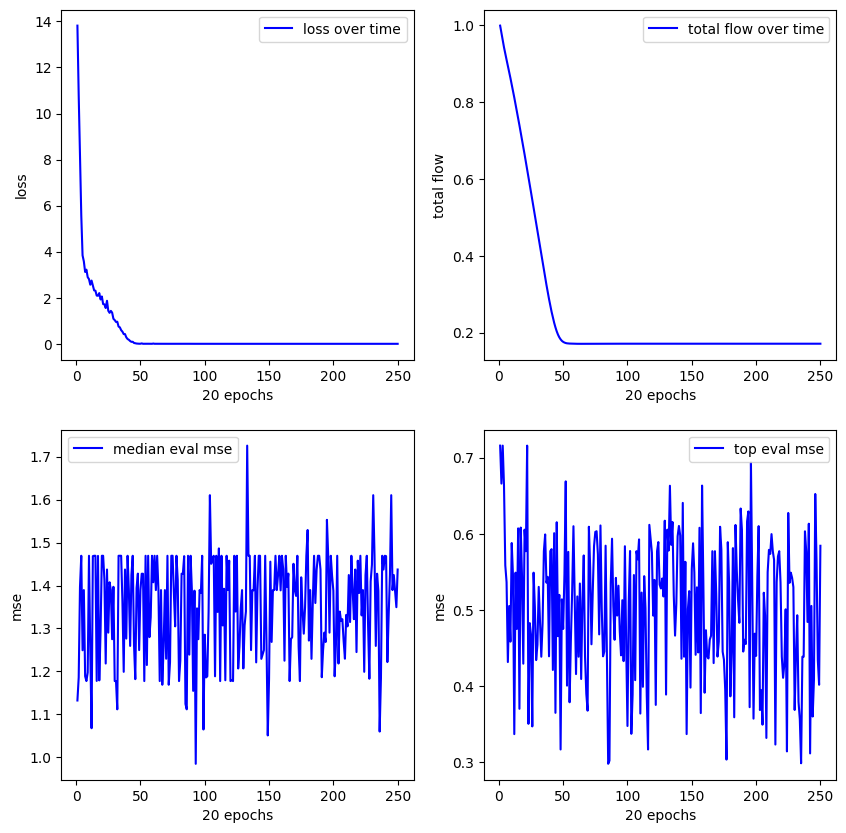

**************************************************
Experiment 12
training started with device cuda


16.134:   0%|          | 1/5000 [00:00<10:50,  7.68it/s]


new best reward (vanilla): 0.8733224272727966
mse (pre/post optimized): 0.1333407163619995/0.1243305429816246
(square(x1)) + ((x1) / (0.65))
expr: 1.53846153846154*x1 + square(x1)


0.000: 100%|██████████| 5000/5000 [01:27<00:00, 57.45it/s]


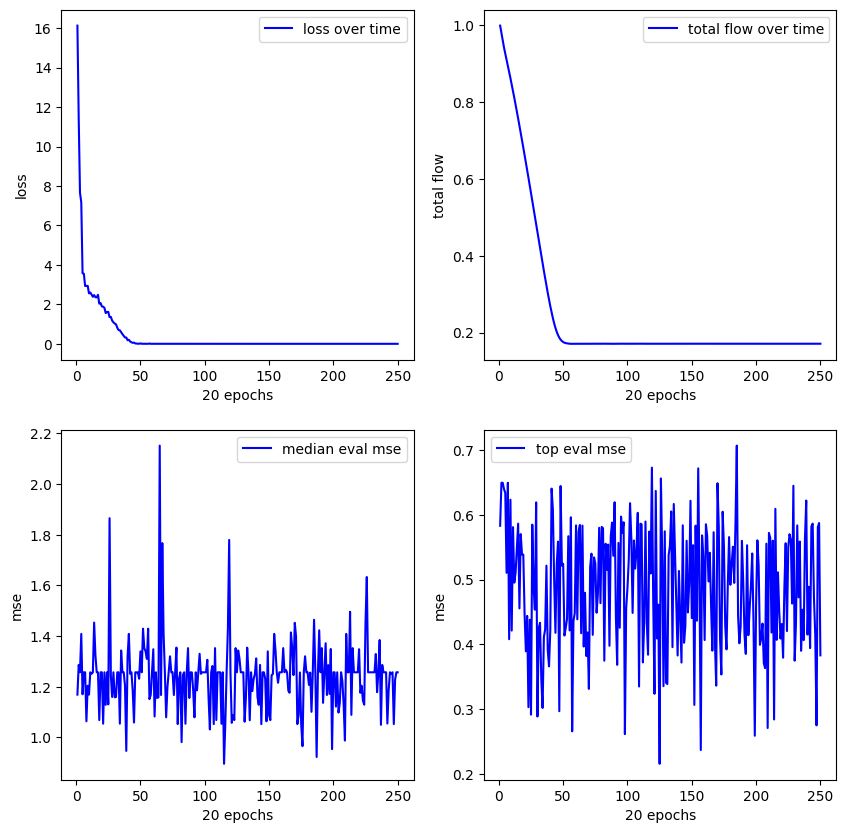

**************************************************
Experiment 13
training started with device cuda


14.702:   0%|          | 1/5000 [00:00<08:24,  9.92it/s]


new best reward (vanilla): 0.52399742603302
mse (pre/post optimized): 0.60243821144104/0.5652437806129456
(exp(x1)) + ((0.47) * (x1))
expr: 0.47*x1 + exp(x1)


14.702:   0%|          | 12/5000 [00:00<02:57, 28.15it/s]


new best reward (vanilla): 0.5946022868156433
mse (pre/post optimized): 0.08542224019765854/0.048396043479442596
((x1) + (0.19)) * (exp(x1))
expr: (x1 + 0.19)*exp(x1)

new best reward (vanilla): 0.6186245679855347
mse (pre/post optimized): 0.037356194108724594/0.03581440821290016
((x1) + (0.93)) / ((0.58) / (x1))
expr: 1.72413793103448*x1*(x1 + 0.93)


0.000: 100%|██████████| 5000/5000 [01:34<00:00, 52.82it/s]


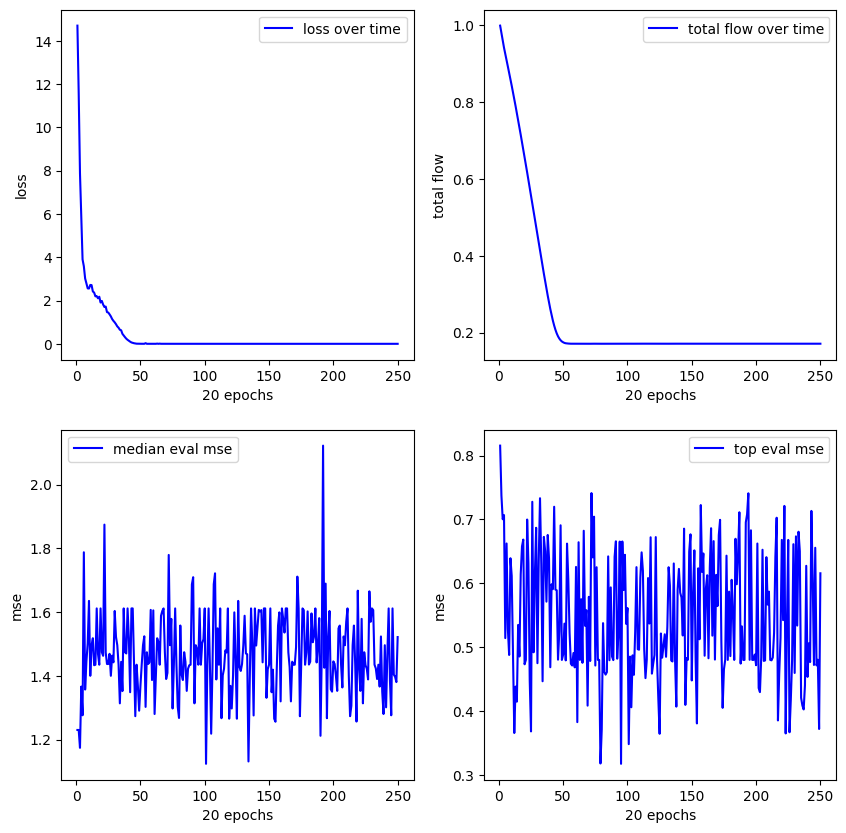

**************************************************
Experiment 14
training started with device cuda


14.610:   0%|          | 2/5000 [00:00<04:47, 17.36it/s]


new best reward (vanilla): 0.7717400789260864
mse (pre/post optimized): 0.2975989580154419/0.2975989580154419
((x1) * (x1)) + (x1)
expr: x1*(x1 + 1)


0.000: 100%|██████████| 5000/5000 [01:31<00:00, 54.93it/s]


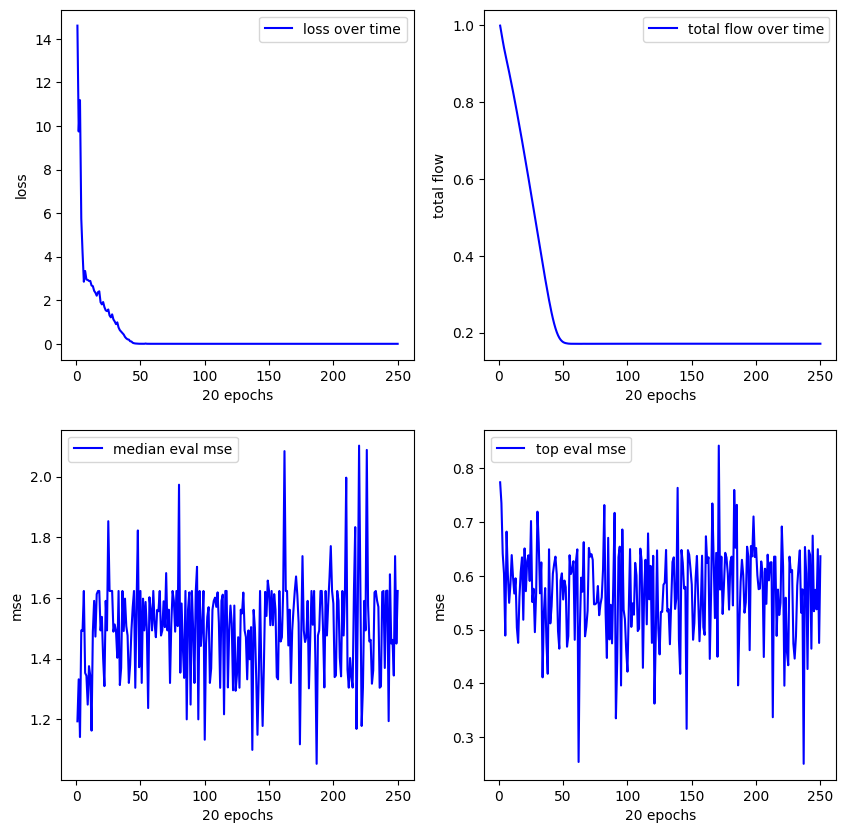

**************************************************
Experiment 15
training started with device cuda


13.463:   0%|          | 2/5000 [00:00<04:20, 19.18it/s]


new best reward (vanilla): 0.5371626615524292
mse (pre/post optimized): 0.4048583507537842/0.03348521888256073
(exp(x1)) * ((0.16) + (x1))
expr: (x1 + 0.16)*exp(x1)

new best reward (vanilla): 0.5518477559089661
mse (pre/post optimized): 0.1538844108581543/0.1538844108581543
(x1) + (square(x1))
expr: x1 + square(x1)

new best reward (vanilla): 0.6011427640914917
mse (pre/post optimized): 0.06893590092658997/0.06893590092658997
(x1) * (exp(x1))
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [02:10<00:00, 38.27it/s]


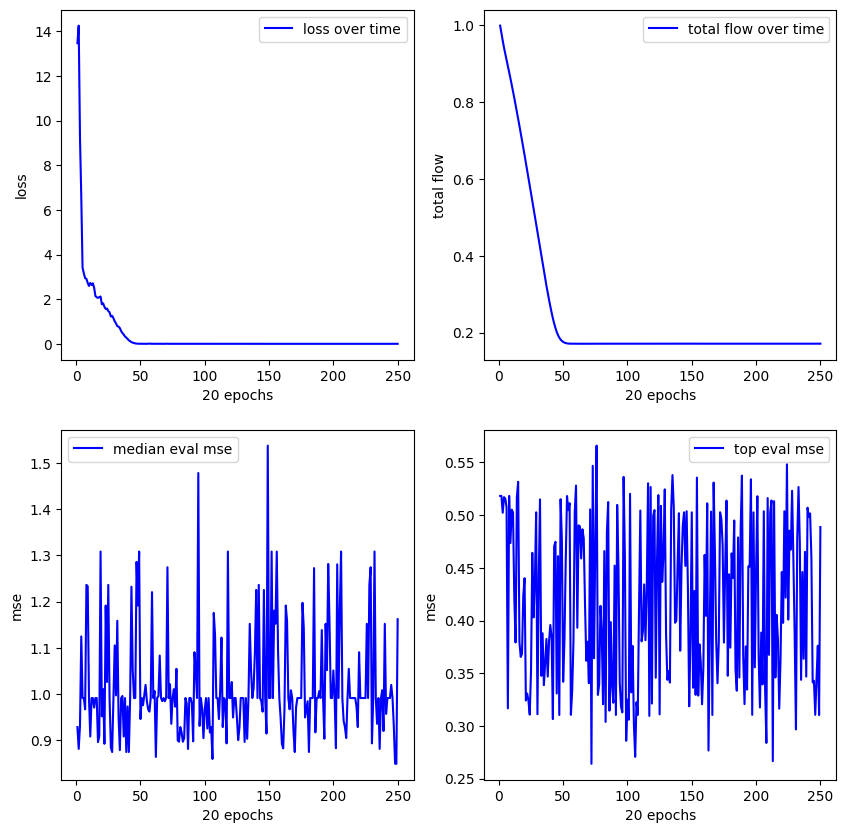

**************************************************
Experiment 16
training started with device cuda


15.007:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.9095552563667297
mse (pre/post optimized): 0.10217799991369247/0.10217799991369247
(x1) * (exp(x1))
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:43<00:00, 48.09it/s]


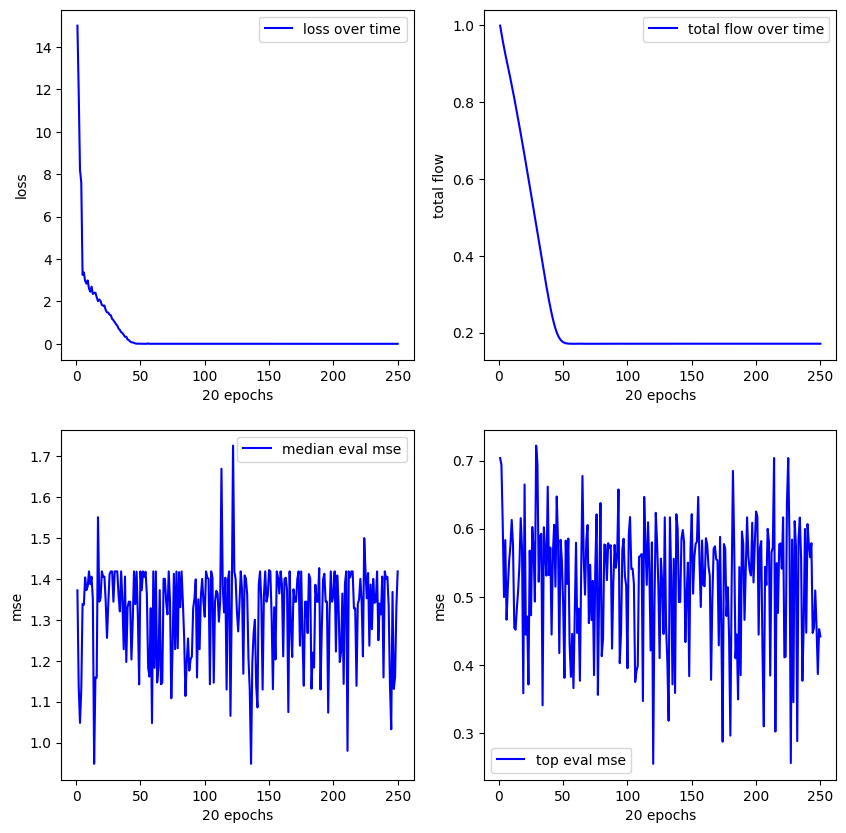

**************************************************
Experiment 17
training started with device cuda


12.505:   0%|          | 2/5000 [00:00<04:21, 19.09it/s]


new best reward (vanilla): 0.8503932952880859
mse (pre/post optimized): 0.1749117076396942/0.1749117076396942
(sin(x1)) * (exp(x1))
expr: exp(x1)*sin(x1)


0.000: 100%|██████████| 5000/5000 [01:42<00:00, 48.98it/s]


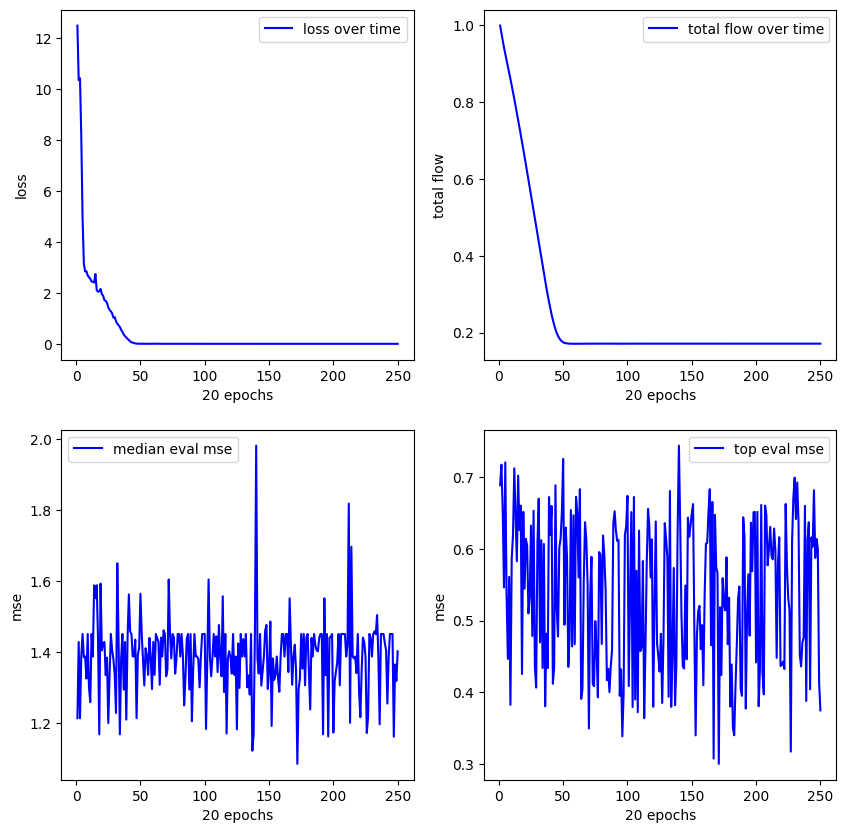

**************************************************
Experiment 18
training started with device cuda


15.334:   0%|          | 1/5000 [00:00<09:23,  8.87it/s]


new best reward (vanilla): 0.8193899393081665
mse (pre/post optimized): 0.19996698200702667/0.16334031522274017
square((x1) + (0.61))
expr: square(x1 + 0.61)


0.000: 100%|██████████| 5000/5000 [01:45<00:00, 47.25it/s]


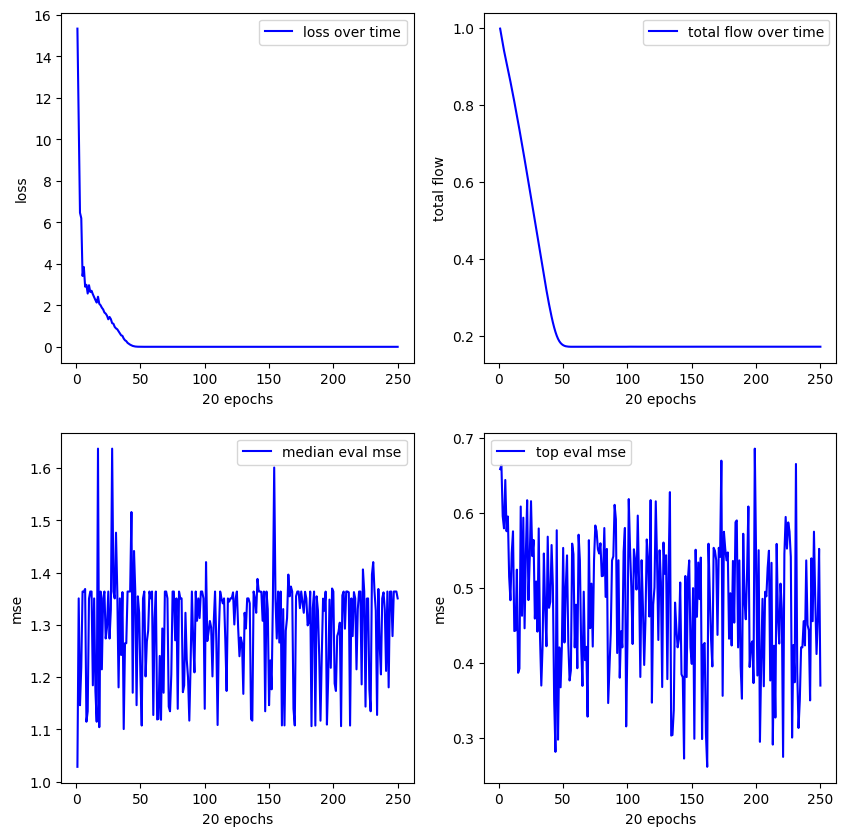

**************************************************
Experiment 19
training started with device cuda


13.379:   0%|          | 2/5000 [00:00<04:11, 19.91it/s]


new best reward (vanilla): 0.8584208488464355
mse (pre/post optimized): 0.17705120146274567/0.17292603850364685
square((0.63) + (x1))
expr: square(x1 + 0.63)


0.000: 100%|██████████| 5000/5000 [02:03<00:00, 40.33it/s]


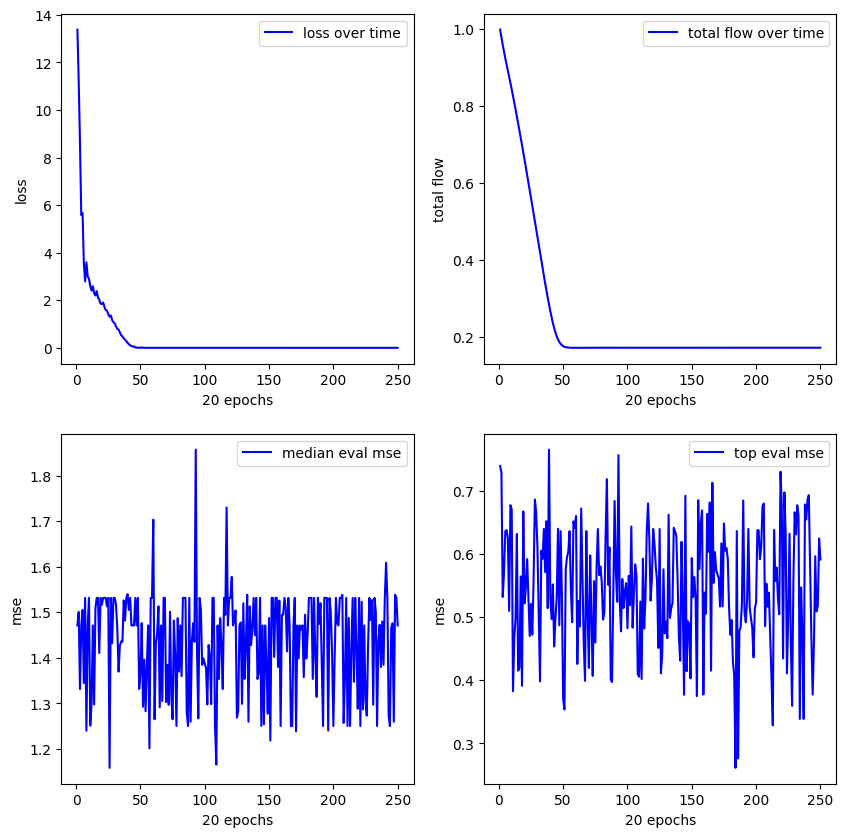

**************************************************
Experiment 20
training started with device cuda


12.975:   0%|          | 2/5000 [00:00<04:50, 17.23it/s]


new best reward (vanilla): 0.8557568192481995
mse (pre/post optimized): 0.18913203477859497/0.18913203477859497
((x1) * (x1)) + ((x1) + (x1))
expr: x1*(x1 + 2)


0.000: 100%|██████████| 5000/5000 [02:04<00:00, 40.25it/s]


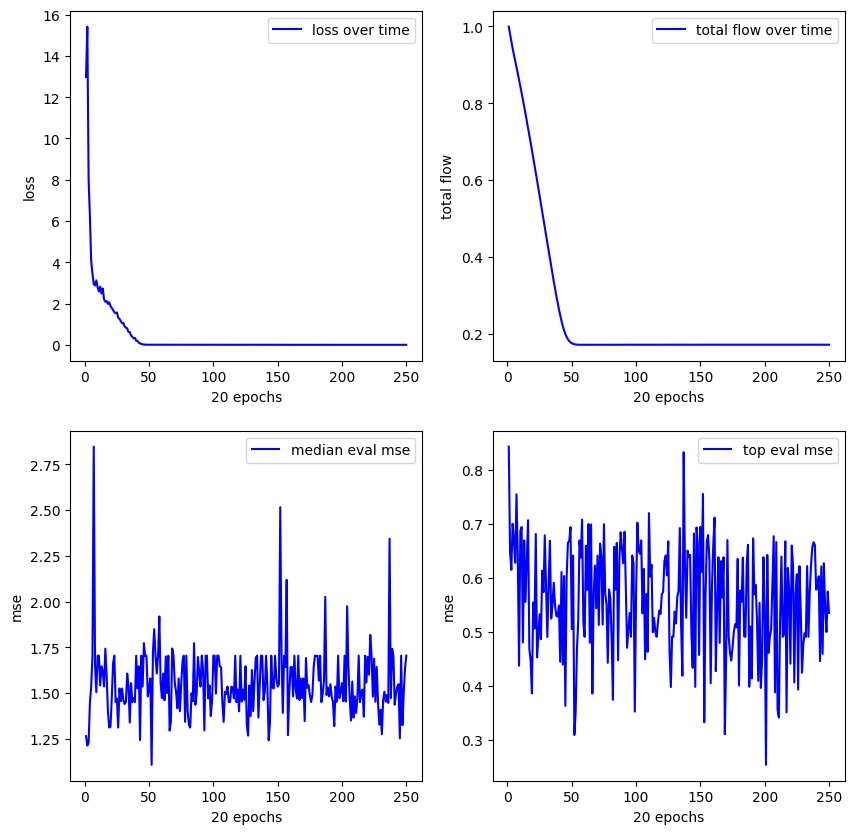

--------------------------------------------------
FUNCTION x**5 + x**4 + x**3 + x**2 + x Interval considered: [-1, 1]
**************************************************
Experiment 1
training started with device cuda


13.073:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.7826655507087708
mse (pre/post optimized): 0.39010947942733765/0.7535716891288757
((x1) - (0.29)) * (exp(x1))
expr: (x1 - 0.29)*exp(x1)


0.000: 100%|██████████| 5000/5000 [03:20<00:00, 24.96it/s]


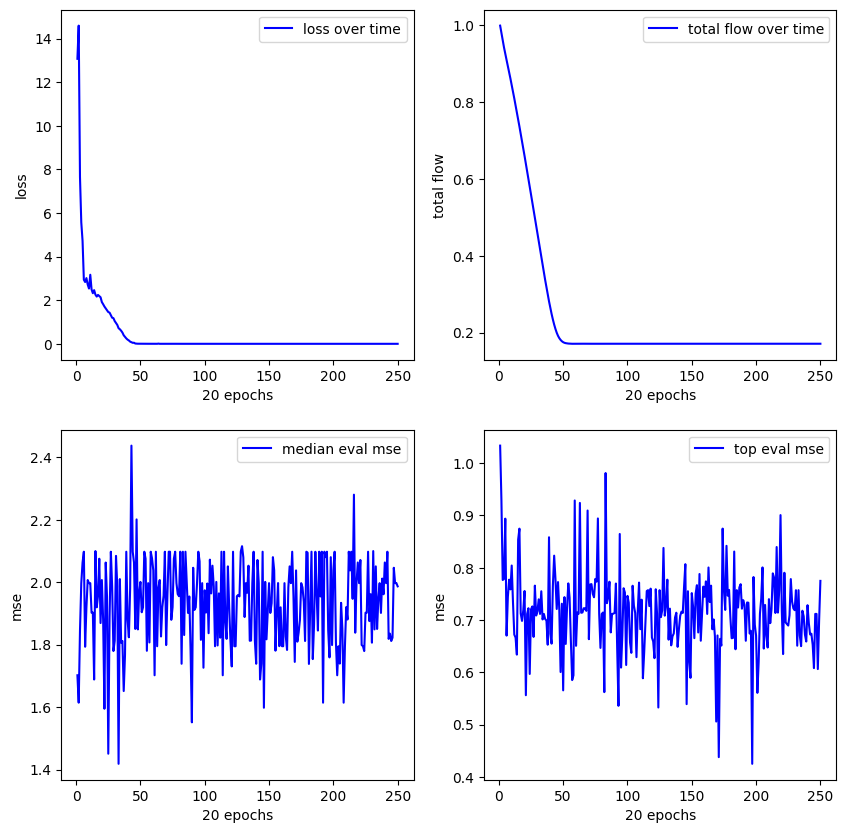

**************************************************
Experiment 2
training started with device cuda


16.367:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.8699408173561096
mse (pre/post optimized): 0.20216649770736694/0.14550642669200897
((x1) + (0.25)) * (exp(x1))
expr: (x1 + 0.25)*exp(x1)


0.000: 100%|██████████| 5000/5000 [02:46<00:00, 30.06it/s]


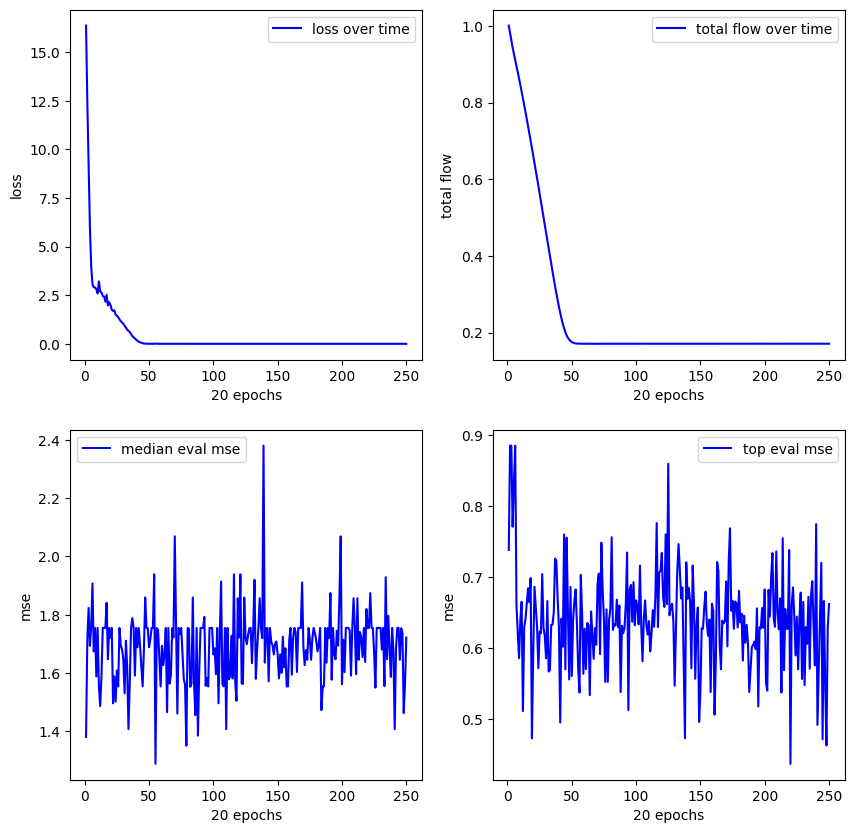

**************************************************
Experiment 3
training started with device cuda


13.158:   0%|          | 2/5000 [00:00<05:07, 16.25it/s]


new best reward (vanilla): 0.6796908378601074
mse (pre/post optimized): 0.500637948513031/0.3656504452228546
square((0.68) + (x1))
expr: square(x1 + 0.68)


13.158:   0%|          | 17/5000 [00:00<02:58, 27.88it/s]


new best reward (vanilla): 0.8165282011032104
mse (pre/post optimized): 0.038040921092033386/0.038040924817323685
(exp(x1)) / ((0.64) / (x1))
expr: 1.5625*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [02:01<00:00, 41.18it/s]


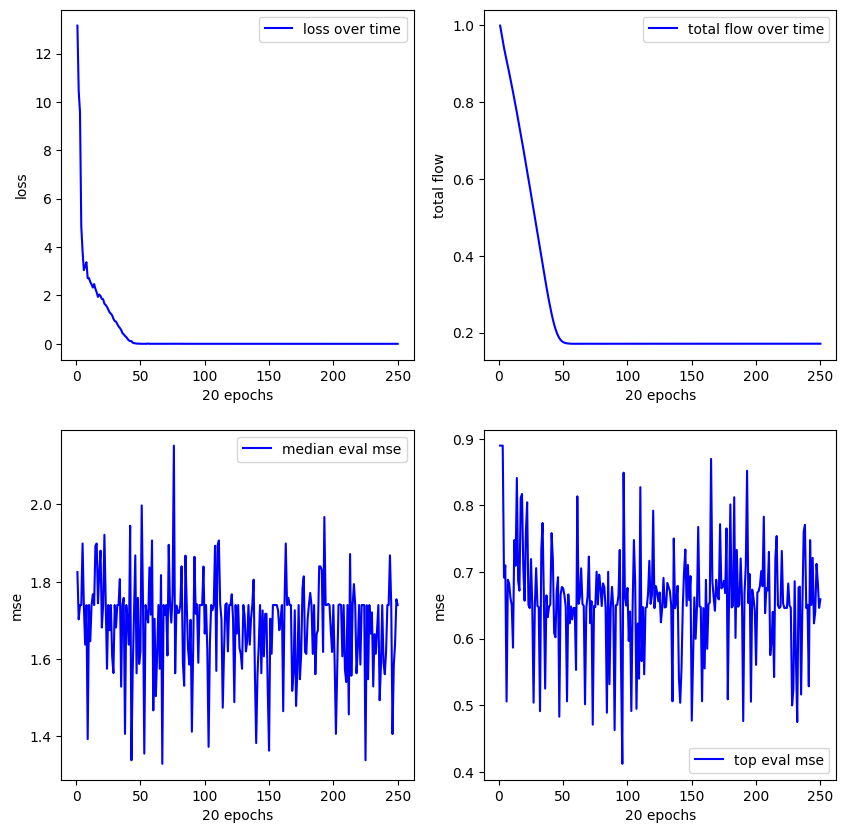

**************************************************
Experiment 4
training started with device cuda


12.892:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.4396779537200928
mse (pre/post optimized): 0.9422964453697205/0.9422964453697205
exp(x1)
expr: exp(x1)


12.892:   0%|          | 1/5000 [00:00<23:20,  3.57it/s]


new best reward (vanilla): 0.8859793543815613
mse (pre/post optimized): 0.11587204039096832/0.14955507218837738
(exp(x1)) / ((0.53) / (x1))
expr: 1.88679245283019*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [03:18<00:00, 25.20it/s]


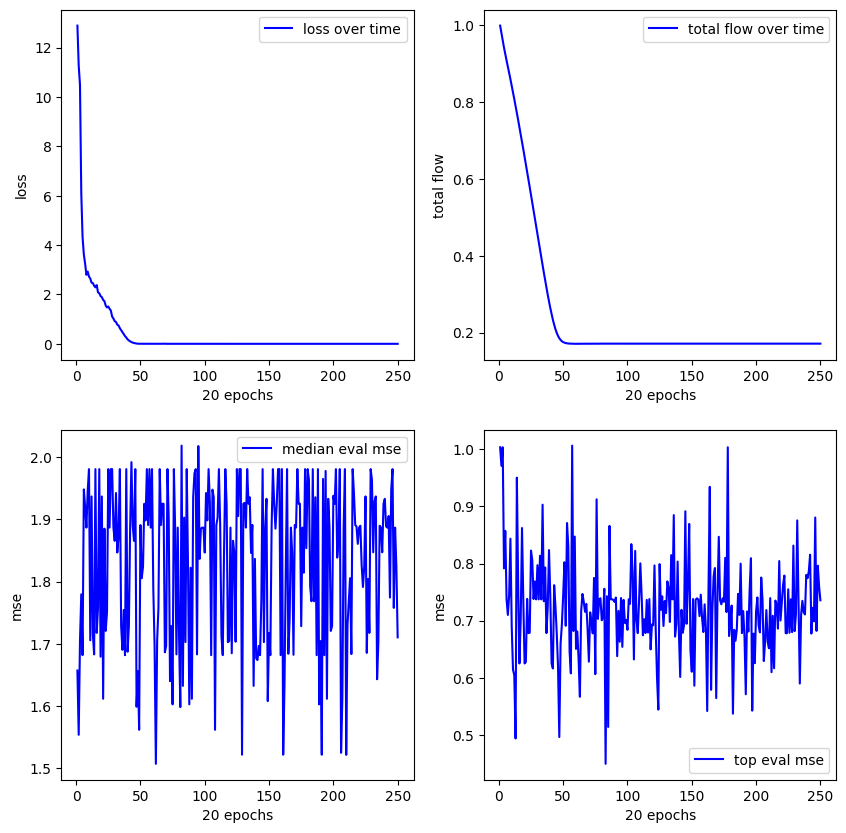

**************************************************
Experiment 5
training started with device cuda


11.575:   0%|          | 1/5000 [00:00<11:50,  7.03it/s]


new best reward (vanilla): 0.741840124130249
mse (pre/post optimized): 0.4018738865852356/0.4018738865852356
(exp(x1)) - (cos(x1))
expr: exp(x1) - cos(x1)


11.575:   0%|          | 11/5000 [00:00<04:58, 16.73it/s]


new best reward (vanilla): 0.7892345190048218
mse (pre/post optimized): 0.043789252638816833/0.04025841876864433
(exp(x1)) * ((x1) / (0.66))
expr: 1.51515151515152*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [02:09<00:00, 38.52it/s]


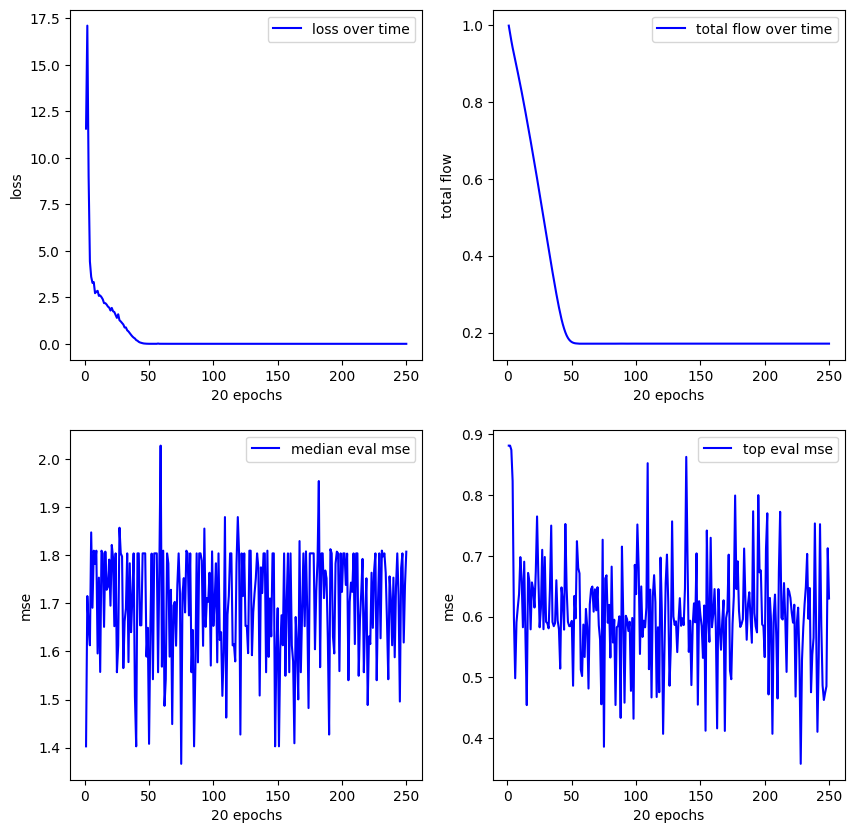

**************************************************
Experiment 6
training started with device cuda


12.627:   0%|          | 1/5000 [00:00<10:09,  8.20it/s]


new best reward (vanilla): 0.6220409870147705
mse (pre/post optimized): 0.5970208048820496/0.42187920212745667
(sin(x1)) + ((0.46) + (x1))
expr: x1 + sin(x1) + 0.46

new best reward (vanilla): 0.6567952036857605
mse (pre/post optimized): 0.17839601635932922/0.1621408462524414
(exp(x1)) * ((x1) + (0.24))
expr: (x1 + 0.24)*exp(x1)


6.067:   1%|          | 60/5000 [00:02<02:57, 27.86it/s] 


new best reward (vanilla): 0.7404247522354126
mse (pre/post optimized): 0.046586427837610245/0.14379380643367767
(exp(x1)) / ((0.53) / (x1))
expr: 1.88679245283019*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [02:00<00:00, 41.51it/s]


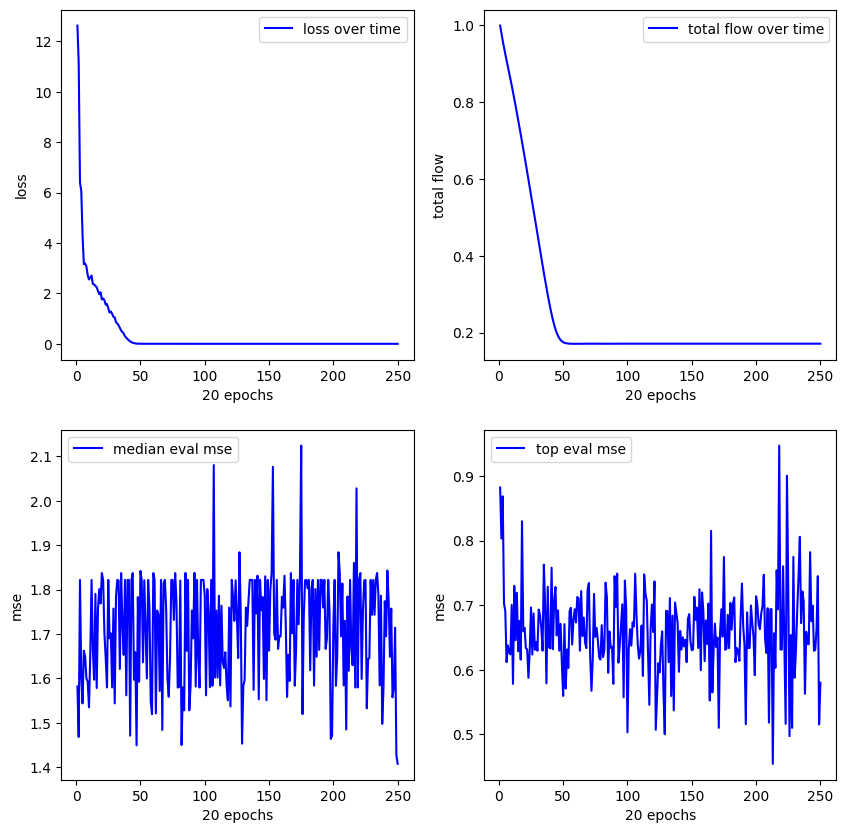

**************************************************
Experiment 7
training started with device cuda


11.266:   0%|          | 1/5000 [00:00<08:48,  9.46it/s]


new best reward (vanilla): 0.7234500646591187
mse (pre/post optimized): 0.6200577616691589/0.6200577616691589
(x1) + (exp(x1))
expr: x1 + exp(x1)


13.598:   1%|          | 29/5000 [00:01<02:05, 39.57it/s]


new best reward (vanilla): 0.7904770374298096
mse (pre/post optimized): 0.04843129962682724/0.04843129217624664
((x1) / (0.63)) * (exp(x1))
expr: 1.58730158730159*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:29<00:00, 55.70it/s]


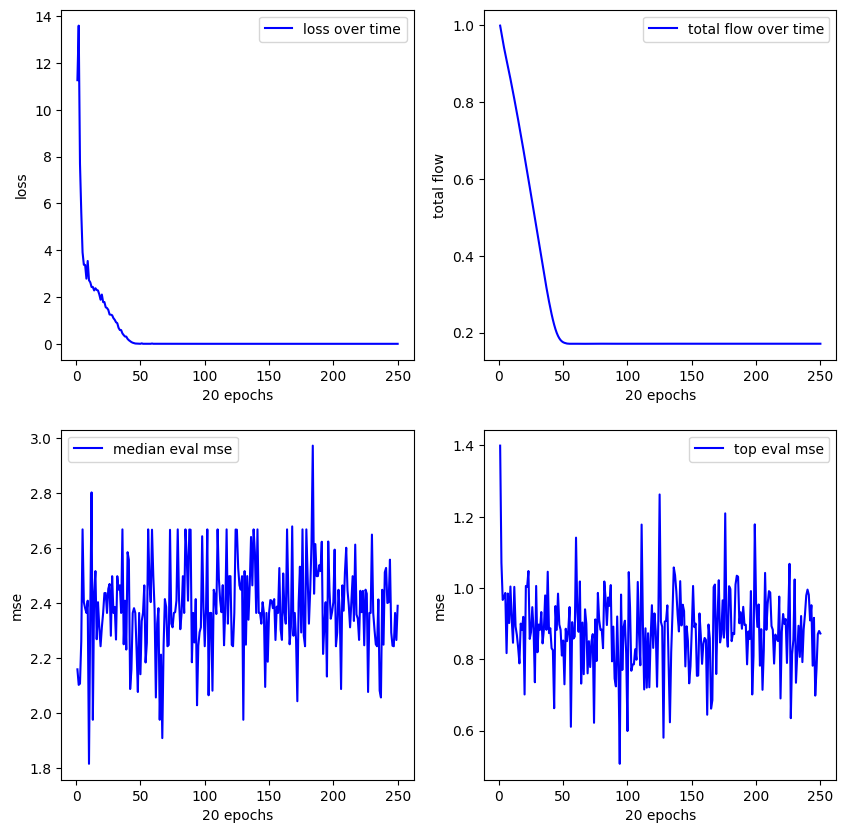

**************************************************
Experiment 8
training started with device cuda


12.984:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.6427332162857056
mse (pre/post optimized): 0.6381790637969971/0.6381790637969971
(exp(x1)) * (square(x1))
expr: square(x1)*exp(x1)


11.309:   1%|          | 33/5000 [00:01<02:24, 34.31it/s]


new best reward (vanilla): 0.6690958738327026
mse (pre/post optimized): 0.05537688359618187/6.002857685089111
(exp(x1)) * ((x1) / (0.24))
expr: 4.16666666666667*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:25<00:00, 58.30it/s]


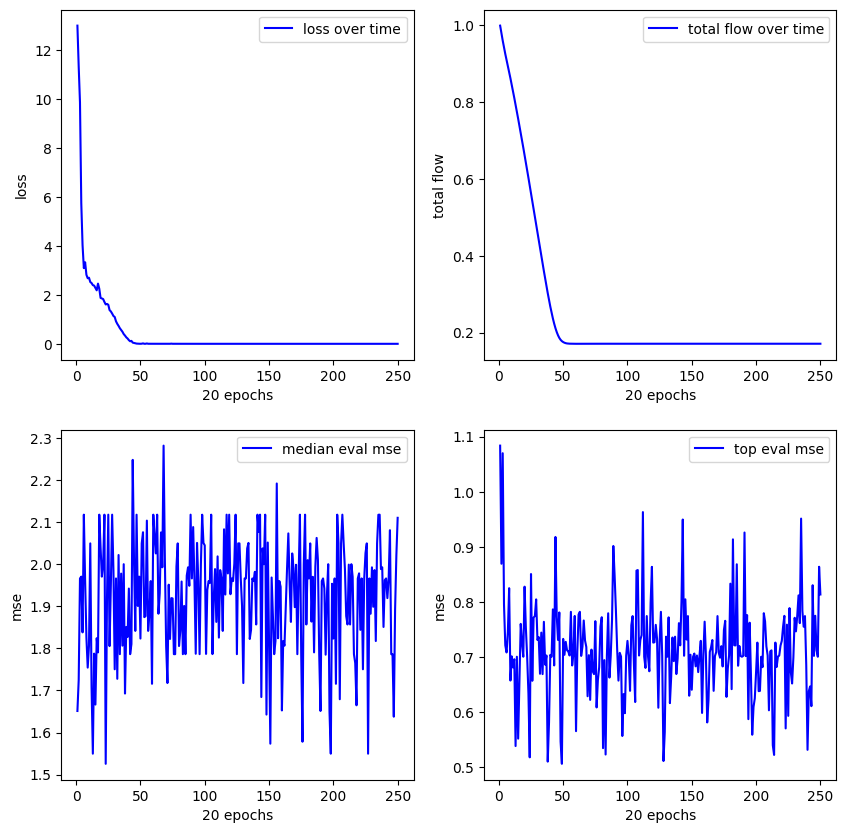

**************************************************
Experiment 9
training started with device cuda


14.277:   0%|          | 1/5000 [00:00<10:00,  8.32it/s]


new best reward (vanilla): 0.5829019546508789
mse (pre/post optimized): 0.6246996521949768/0.6598851084709167
((x1) / (0.32)) - (x1)
expr: 2.125*x1


3.807:   2%|▏         | 84/5000 [00:02<01:59, 41.19it/s] 


new best reward (vanilla): 0.6829284429550171
mse (pre/post optimized): 0.039394527673721313/0.0526118166744709
((x1) / (0.59)) * (exp(x1))
expr: 1.69491525423729*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:29<00:00, 56.08it/s]


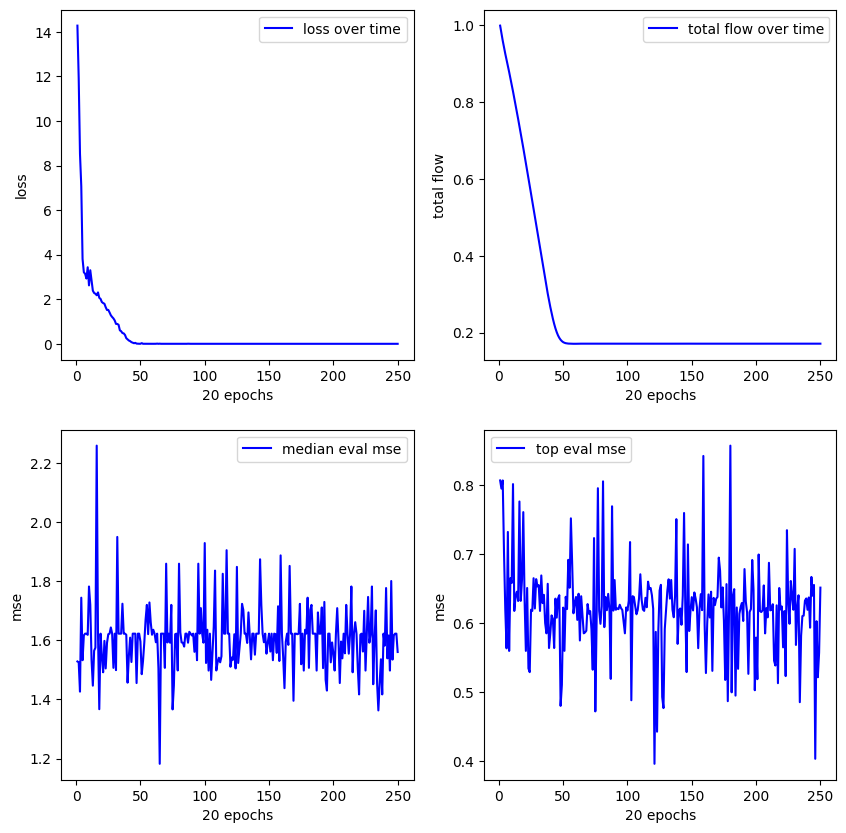

**************************************************
Experiment 10
training started with device cuda


13.855:   0%|          | 2/5000 [00:00<05:23, 15.45it/s]


new best reward (vanilla): 0.6589854955673218
mse (pre/post optimized): 0.6857556700706482/0.6857556700706482
(x1) + (exp(x1))
expr: x1 + exp(x1)


11.383:   0%|          | 20/5000 [00:00<02:01, 40.82it/s]


new best reward (vanilla): 0.7863138318061829
mse (pre/post optimized): 0.042660702019929886/0.04239090904593468
(exp(x1)) / ((0.63) / (x1))
expr: 1.58730158730159*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:28<00:00, 56.72it/s]


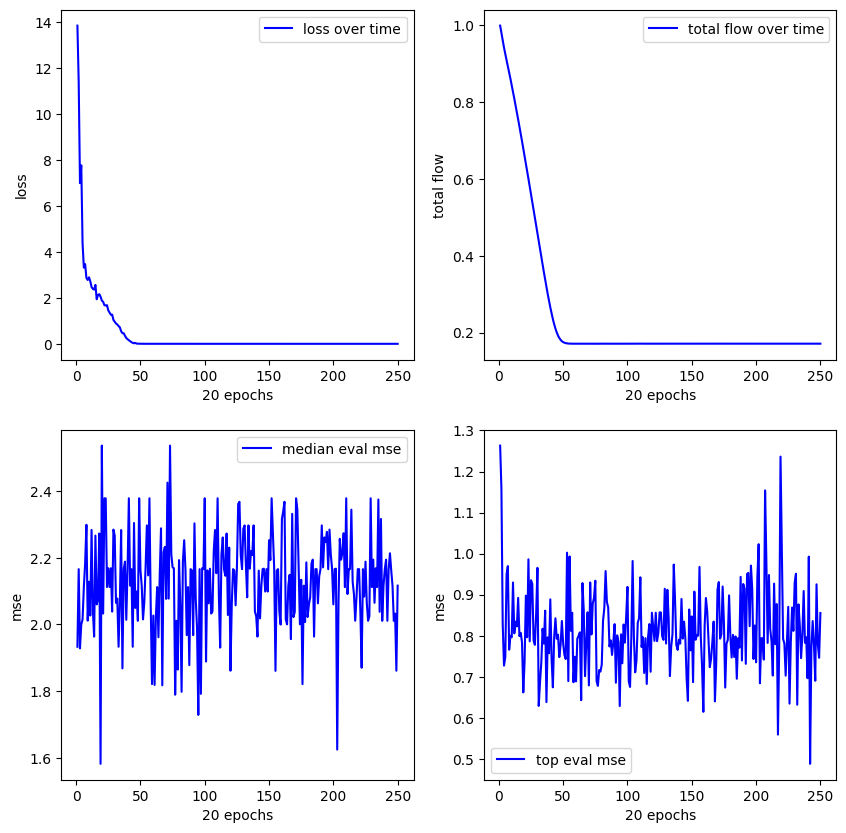

**************************************************
Experiment 11
training started with device cuda


14.867:   0%|          | 1/5000 [00:00<10:31,  7.92it/s]


new best reward (vanilla): 0.8797942399978638
mse (pre/post optimized): 0.2584000825881958/0.2584000825881958
(exp(x1)) * ((x1) + (x1))
expr: 2*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:28<00:00, 56.37it/s]


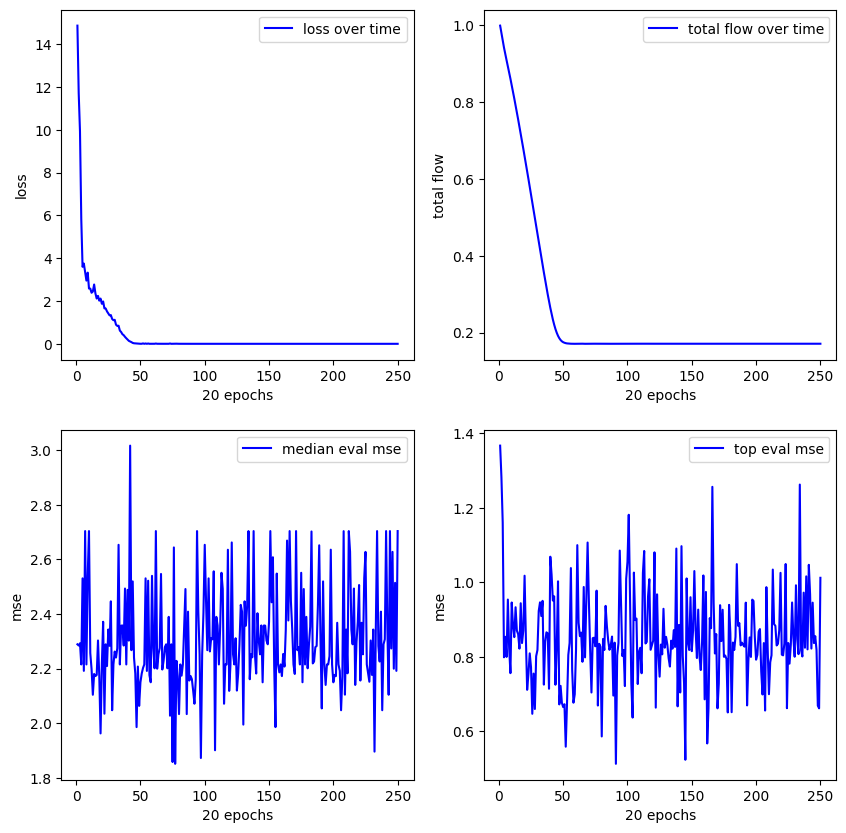

**************************************************
Experiment 12
training started with device cuda


14.702:   0%|          | 1/5000 [00:00<10:34,  7.88it/s]


new best reward (vanilla): 0.8756842613220215
mse (pre/post optimized): 0.2171955555677414/0.14342737197875977
((0.9) + (x1)) * ((x1) / (0.5))
expr: 2.0*x1*(x1 + 0.9)


0.000: 100%|██████████| 5000/5000 [01:29<00:00, 56.05it/s]


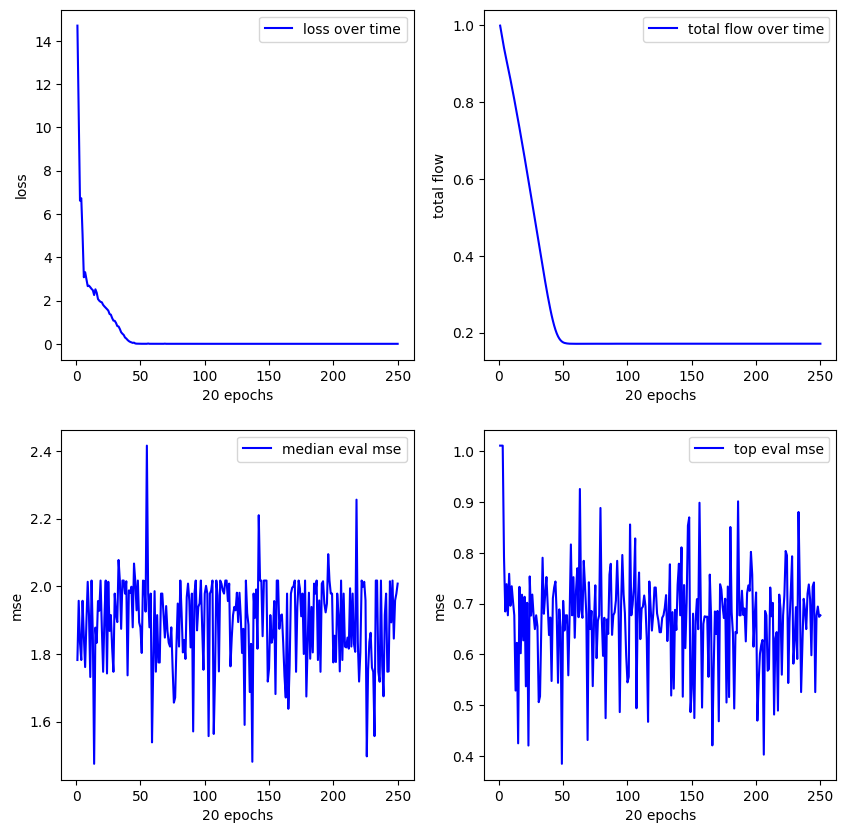

**************************************************
Experiment 13
training started with device cuda


13.029:   0%|          | 1/5000 [00:00<09:36,  8.67it/s]


new best reward (vanilla): 0.7832949161529541
mse (pre/post optimized): 0.34146755933761597/0.3414207100868225
square((0.67) + (x1))
expr: square(x1 + 0.67)


13.029:   0%|          | 19/5000 [00:00<03:32, 23.44it/s]


new best reward (vanilla): 0.8022440671920776
mse (pre/post optimized): 0.03813888877630234/0.035886503756046295
((x1) / (0.65)) * (exp(x1))
expr: 1.53846153846154*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:32<00:00, 53.89it/s]


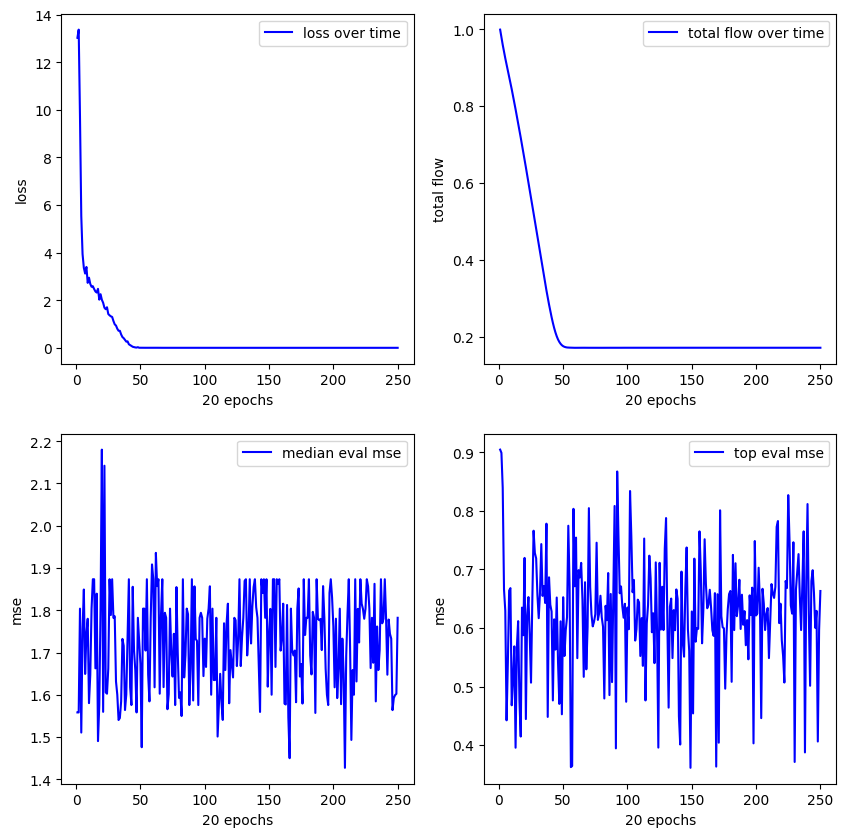

**************************************************
Experiment 14
training started with device cuda


11.182:   0%|          | 2/5000 [00:00<04:48, 17.31it/s]


new best reward (vanilla): 0.4748106002807617
mse (pre/post optimized): 1.033678412437439/1.033678412437439
exp(sin(x1))
expr: exp(sin(x1))

new best reward (vanilla): 0.9571551084518433
mse (pre/post optimized): 0.048291802406311035/0.09581871330738068
((x1) / (0.56)) * (exp(x1))
expr: 1.78571428571429*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:32<00:00, 54.12it/s]


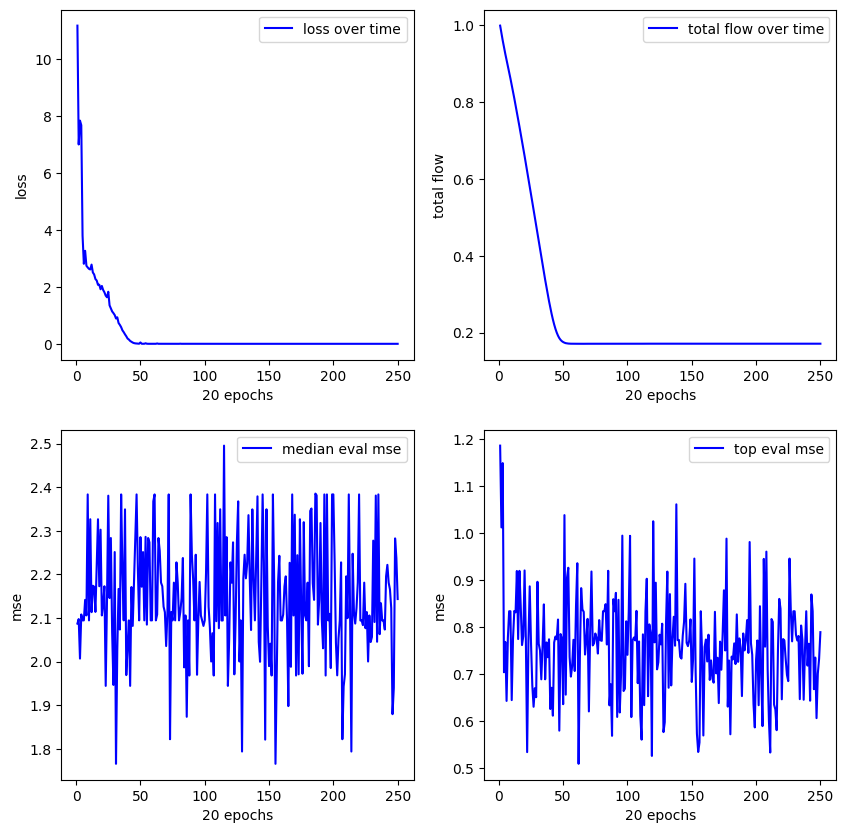

**************************************************
Experiment 15
training started with device cuda


12.632:   0%|          | 1/5000 [00:00<14:09,  5.88it/s]


new best reward (vanilla): 0.7717968225479126
mse (pre/post optimized): 0.3596022129058838/0.3542853593826294
square((0.65) + (x1))
expr: square(x1 + 0.65)


0.000: 100%|██████████| 5000/5000 [01:35<00:00, 52.26it/s]


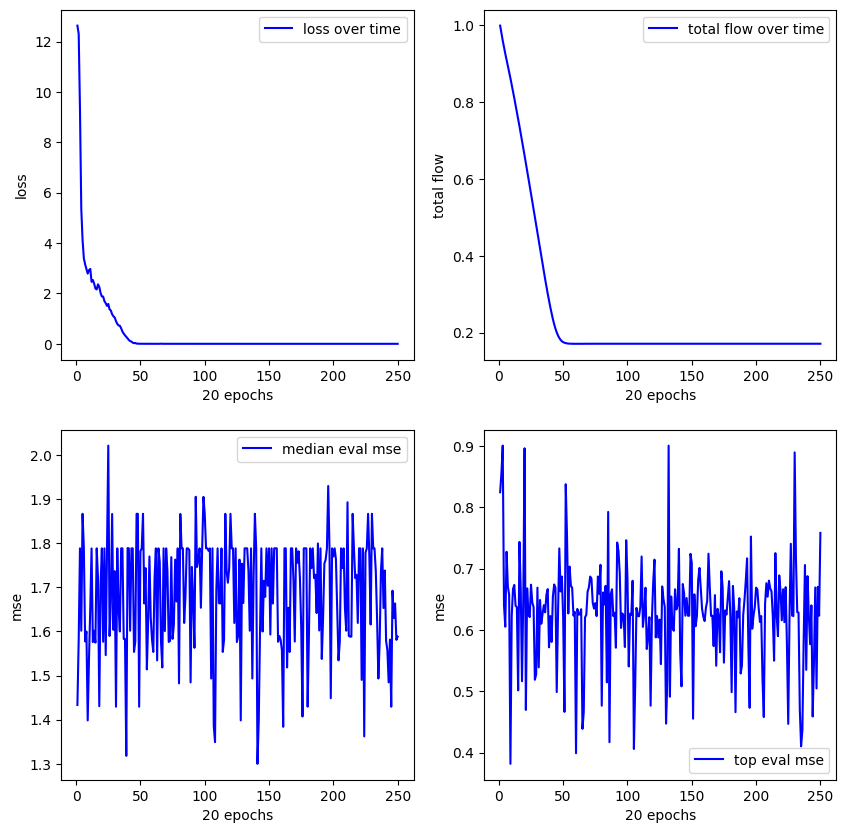

**************************************************
Experiment 16
training started with device cuda


12.471:   0%|          | 1/5000 [00:00<08:37,  9.66it/s]


new best reward (vanilla): 0.644641637802124
mse (pre/post optimized): 0.6373419165611267/0.6373419165611267
(sin(x1)) + (exp(x1))
expr: exp(x1) + sin(x1)


2.963:   2%|▏         | 118/5000 [00:03<02:04, 39.19it/s]


new best reward (vanilla): 0.6718297600746155
mse (pre/post optimized): 0.04148872196674347/0.041082218289375305
(exp(x1)) / ((0.63) / (x1))
expr: 1.58730158730159*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:27<00:00, 57.38it/s]


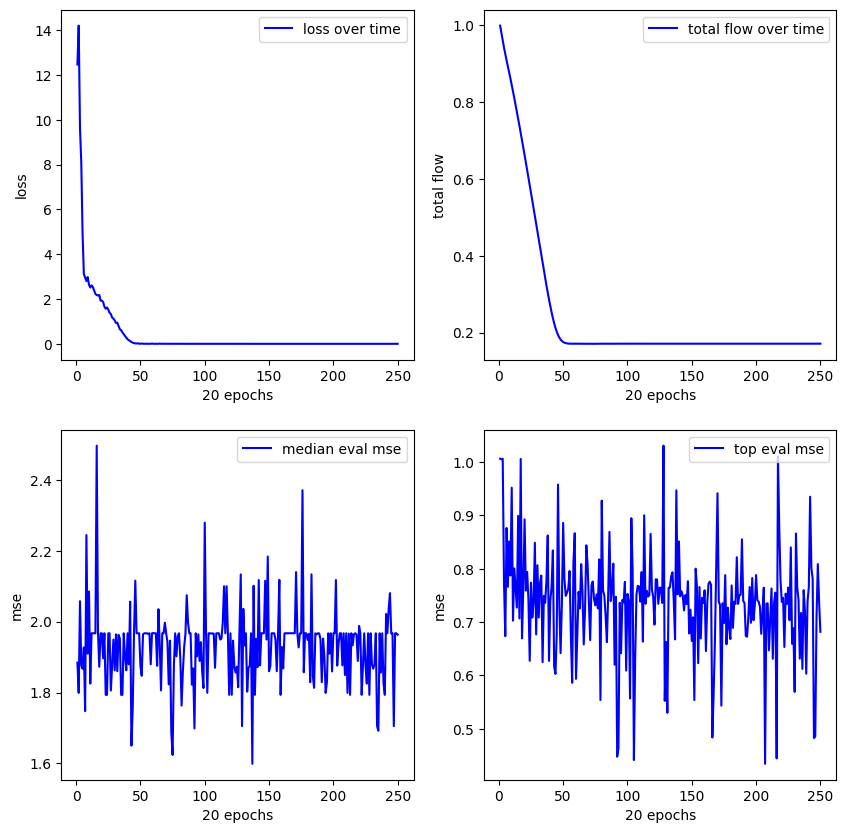

**************************************************
Experiment 17
training started with device cuda


11.267:   0%|          | 2/5000 [00:00<04:16, 19.46it/s]


new best reward (vanilla): 0.48698949813842773
mse (pre/post optimized): 0.9871506690979004/0.9871506690979004
exp(sin(x1))
expr: exp(sin(x1))

new best reward (vanilla): 0.5679508447647095
mse (pre/post optimized): 0.4669840931892395/0.4669840931892395
(exp(x1)) * (sin(x1))
expr: exp(x1)*sin(x1)


10.662:   0%|          | 25/5000 [00:00<01:46, 46.67it/s]


new best reward (vanilla): 0.5897592306137085
mse (pre/post optimized): 0.13472793996334076/0.27507859468460083
(exp(x1)) / ((0.49) / (x1))
expr: 2.04081632653061*x1*exp(x1)


8.325:   1%|          | 49/5000 [00:01<01:41, 48.84it/s] 


new best reward (vanilla): 0.691889762878418
mse (pre/post optimized): 0.04157073423266411/0.04157073423266411
(exp(x1)) * ((x1) / (0.65))
expr: 1.53846153846154*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:33<00:00, 53.65it/s]


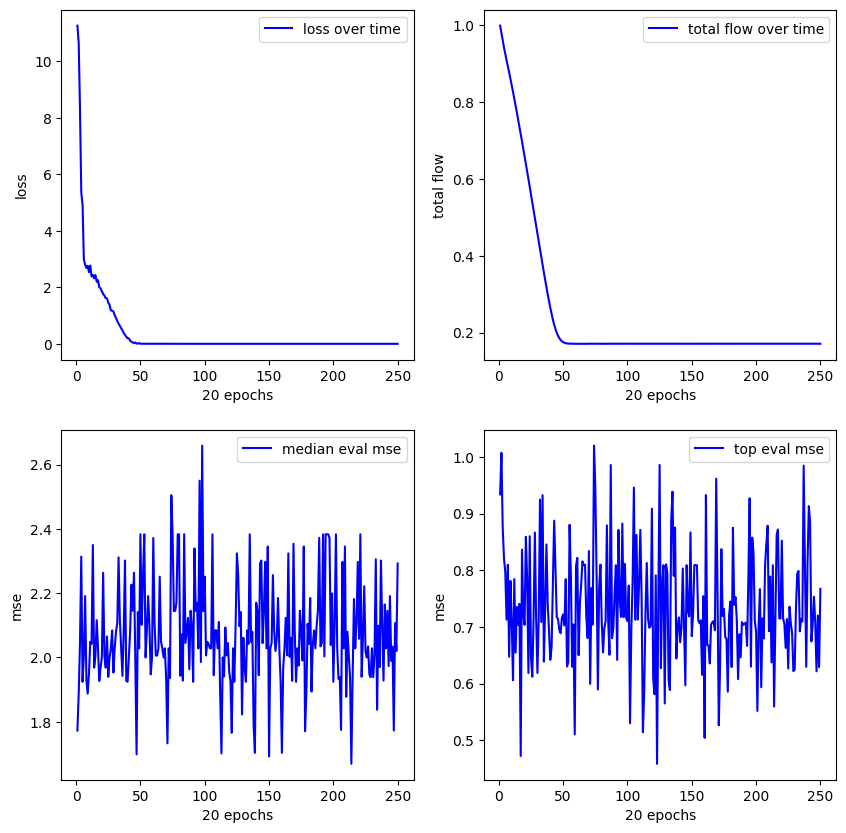

**************************************************
Experiment 18
training started with device cuda


13.224:   0%|          | 6/5000 [00:00<04:53, 17.03it/s]


new best reward (vanilla): 0.899786114692688
mse (pre/post optimized): 0.1491193175315857/0.14387467503547668
(exp(x1)) * ((x1) + (0.23))
expr: (x1 + 0.23)*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:29<00:00, 55.77it/s]


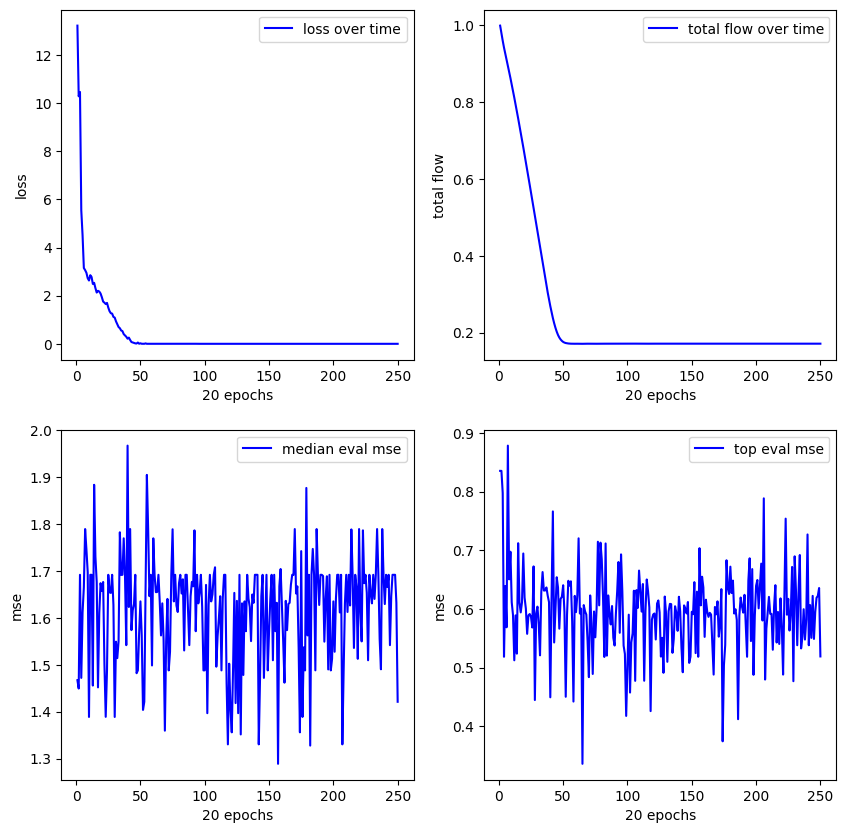

**************************************************
Experiment 19
training started with device cuda


13.172:   0%|          | 2/5000 [00:00<04:15, 19.59it/s]


new best reward (vanilla): 0.5476119518280029
mse (pre/post optimized): 0.7230736613273621/0.48165854811668396
(square(x1)) + ((0.21) + (x1))
expr: x1 + square(x1) + 0.21

new best reward (vanilla): 0.6479557752609253
mse (pre/post optimized): 0.17546722292900085/0.16203494369983673
(exp(x1)) * ((x1) + (0.28))
expr: (x1 + 0.28)*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:34<00:00, 52.72it/s]


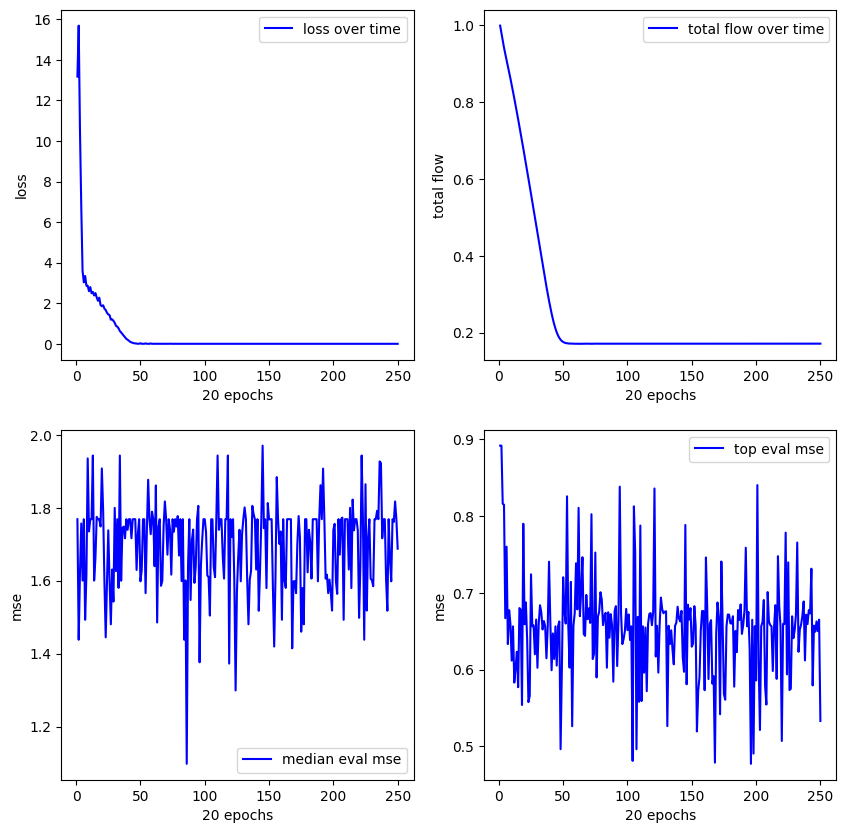

**************************************************
Experiment 20
training started with device cuda


10.703:   0%|          | 2/5000 [00:00<04:58, 16.73it/s]


new best reward (vanilla): 0.7099848985671997
mse (pre/post optimized): 0.3955670893192291/0.3955670893192291
(x1) + (square(x1))
expr: x1 + square(x1)


0.000: 100%|██████████| 5000/5000 [01:25<00:00, 58.30it/s]


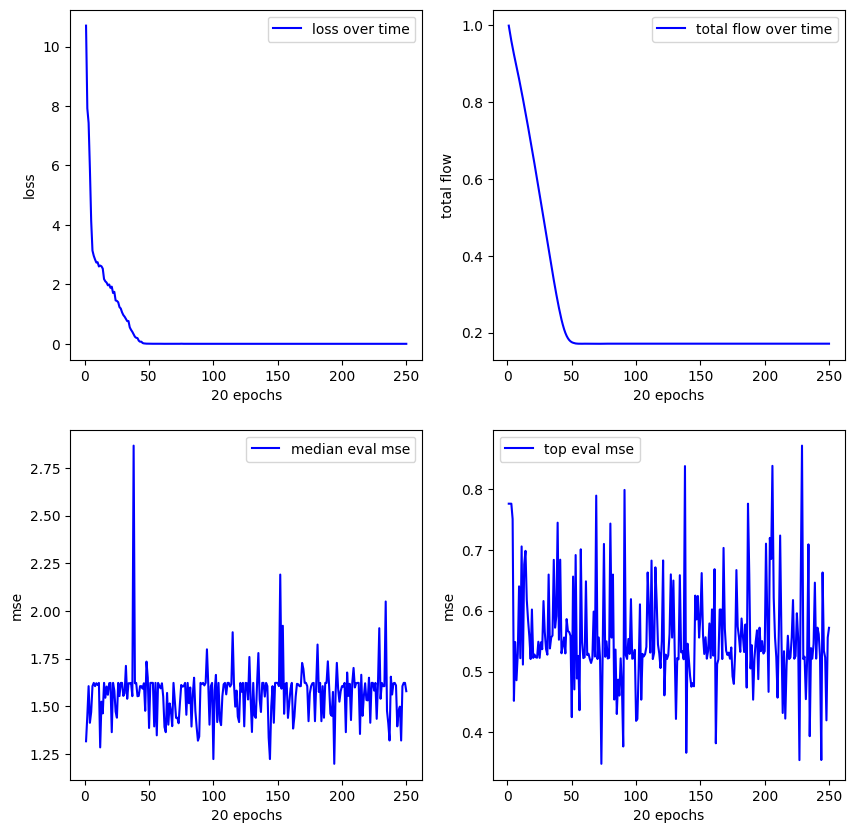

--------------------------------------------------
FUNCTION x**6 + x**5 + x**4 + x**3 + x**2 + x Interval considered: [-1, 1]
**************************************************
Experiment 1
training started with device cuda


12.907:   0%|          | 1/5000 [00:00<08:34,  9.71it/s]


new best reward (vanilla): 0.7021318674087524
mse (pre/post optimized): 0.5260998010635376/0.8749935626983643
((x1) - (0.29)) * (exp(x1))
expr: (x1 - 0.29)*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:29<00:00, 55.63it/s]


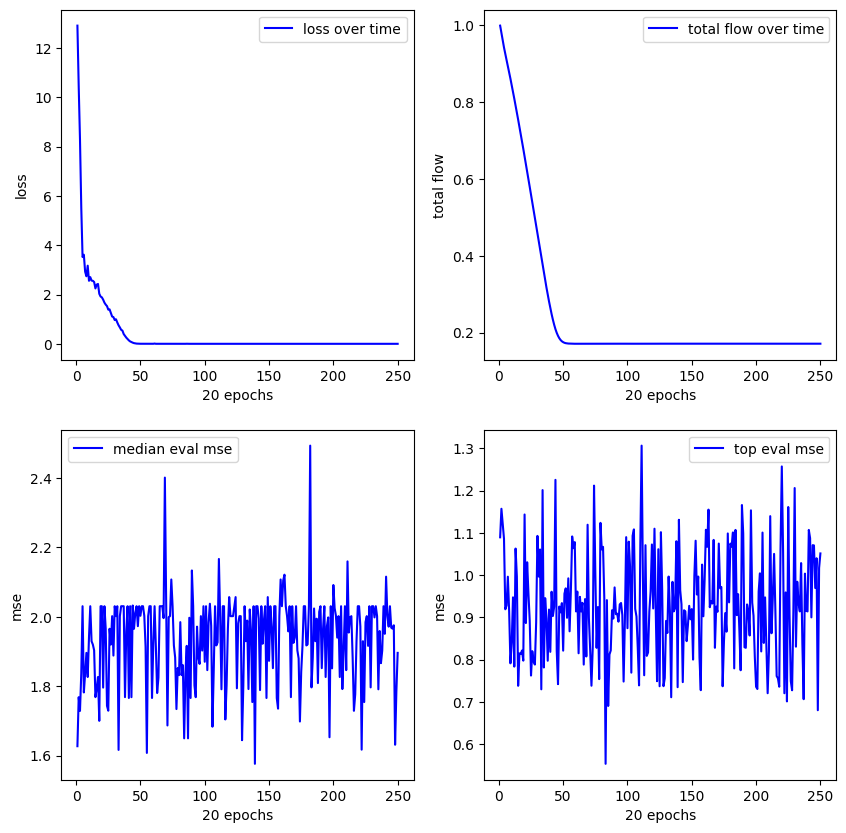

**************************************************
Experiment 2
training started with device cuda


17.174:   0%|          | 3/5000 [00:00<02:58, 27.93it/s]


new best reward (vanilla): 0.5972349047660828
mse (pre/post optimized): 0.727745771408081/0.727745771408081
(x1) + (exp(x1))
expr: x1 + exp(x1)


11.567:   0%|          | 20/5000 [00:00<01:53, 43.92it/s]


new best reward (vanilla): 0.7293551564216614
mse (pre/post optimized): 0.09713540971279144/0.09601830691099167
(exp(x1)) / ((0.59) / (x1))
expr: 1.69491525423729*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:22<00:00, 60.72it/s]


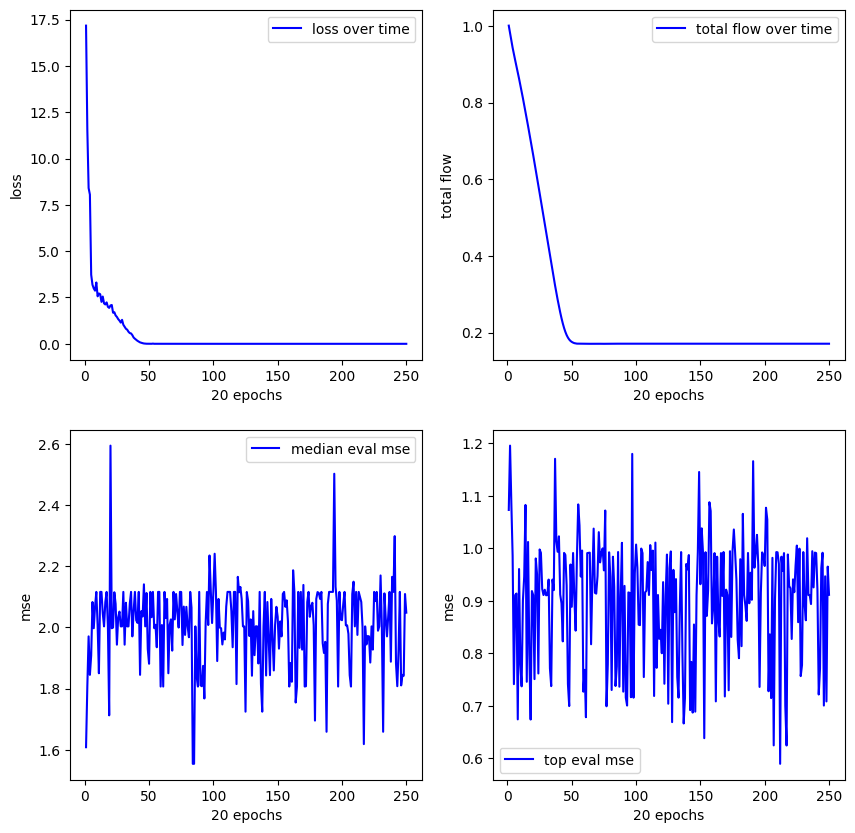

**************************************************
Experiment 3
training started with device cuda


12.056:   0%|          | 2/5000 [00:00<05:06, 16.28it/s]


new best reward (vanilla): 0.49656516313552856
mse (pre/post optimized): 0.9016096591949463/0.5939870476722717
((0.28) + (x1)) + (square(x1))
expr: x1 + square(x1) + 0.28


12.056:   0%|          | 8/5000 [00:00<02:10, 38.23it/s]


new best reward (vanilla): 0.5860729217529297
mse (pre/post optimized): 0.17373697459697723/0.17373697459697723
(exp(x1)) * ((x1) + (x1))
expr: 2*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:27<00:00, 57.00it/s]


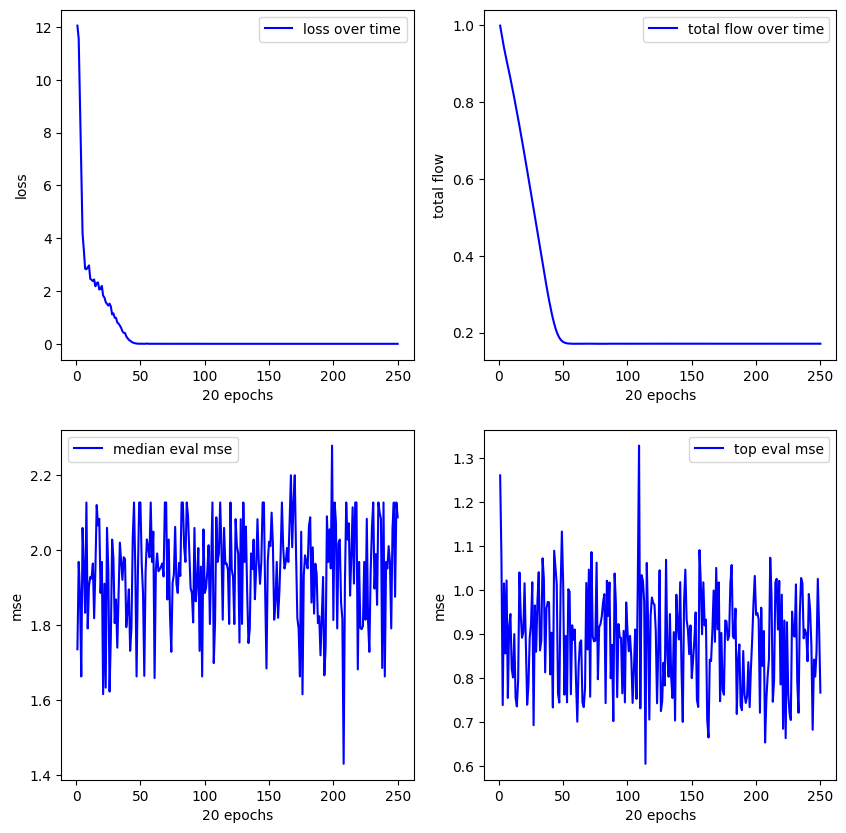

**************************************************
Experiment 4
training started with device cuda


10.833:   0%|          | 1/5000 [00:00<10:33,  7.89it/s]


new best reward (vanilla): 0.6536847352981567
mse (pre/post optimized): 0.6545892357826233/0.6545892357826233
(exp(x1)) - (cos(x1))
expr: exp(x1) - cos(x1)


0.000: 100%|██████████| 5000/5000 [01:31<00:00, 54.63it/s]


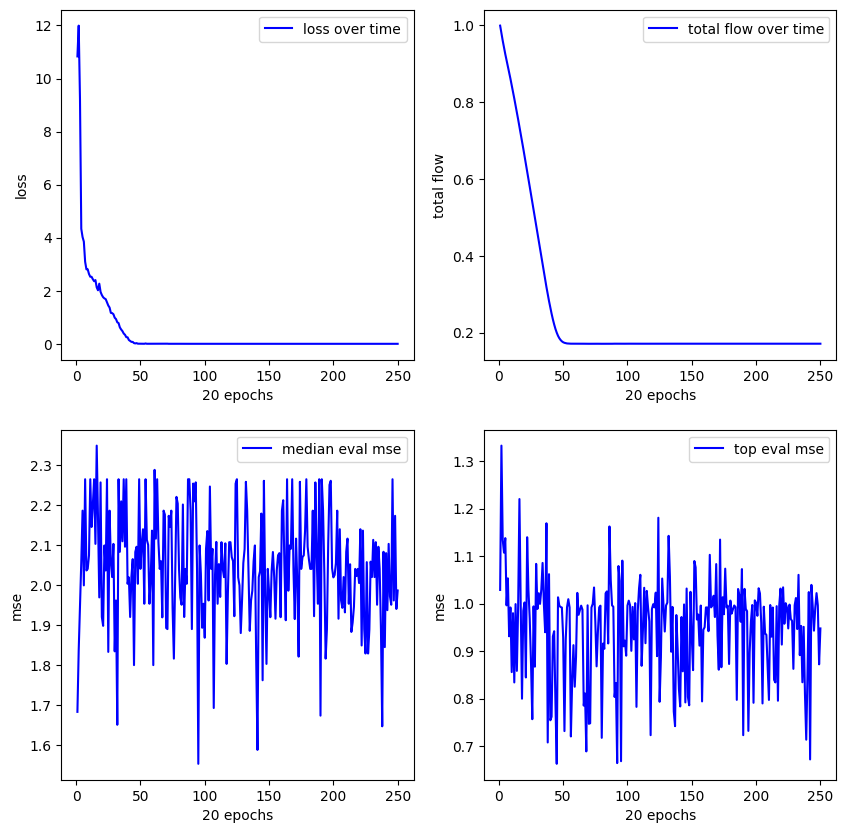

**************************************************
Experiment 5
training started with device cuda


15.467:   0%|          | 1/5000 [00:00<08:35,  9.69it/s]


new best reward (vanilla): 0.5985668897628784
mse (pre/post optimized): 0.7465728521347046/0.7457730174064636
((x1) + (0.55)) + (sin(x1))
expr: x1 + sin(x1) + 0.55

new best reward (vanilla): 0.6117185950279236
mse (pre/post optimized): 0.3331036865711212/0.2563694715499878
(exp(x1)) * ((x1) + (0.34))
expr: (x1 + 0.34)*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:22<00:00, 60.34it/s]


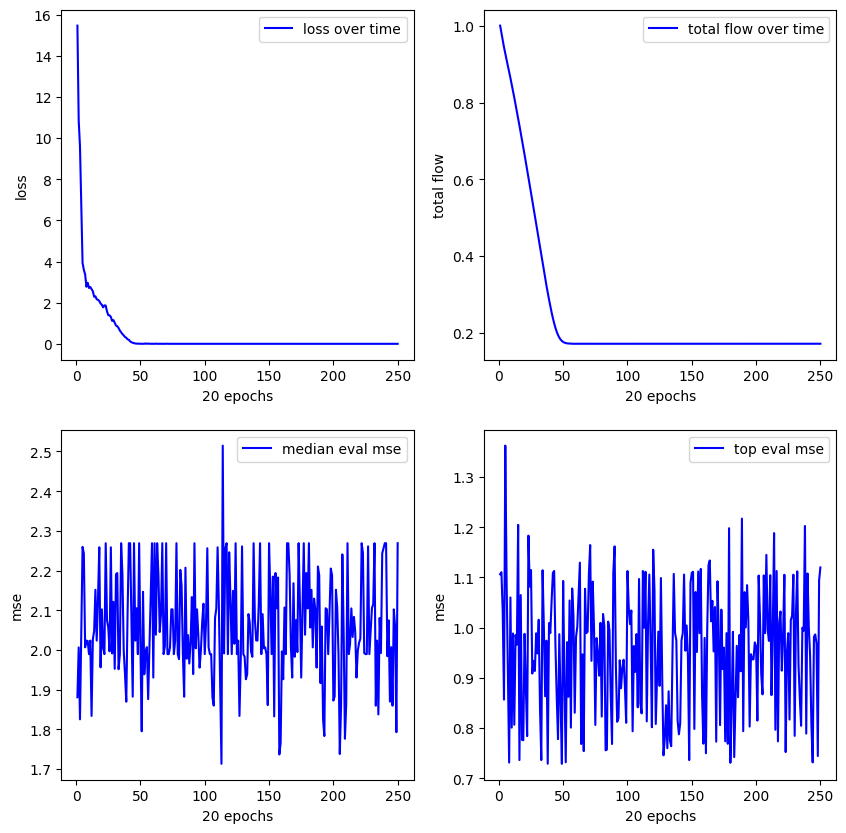

**************************************************
Experiment 6
training started with device cuda


13.547:   0%|          | 1/5000 [00:00<09:26,  8.82it/s]


new best reward (vanilla): 0.6697657108306885
mse (pre/post optimized): 0.6364390850067139/0.6193601489067078
((0.32) + (x1)) + (square(x1))
expr: x1 + square(x1) + 0.32


0.000: 100%|██████████| 5000/5000 [01:28<00:00, 56.40it/s]


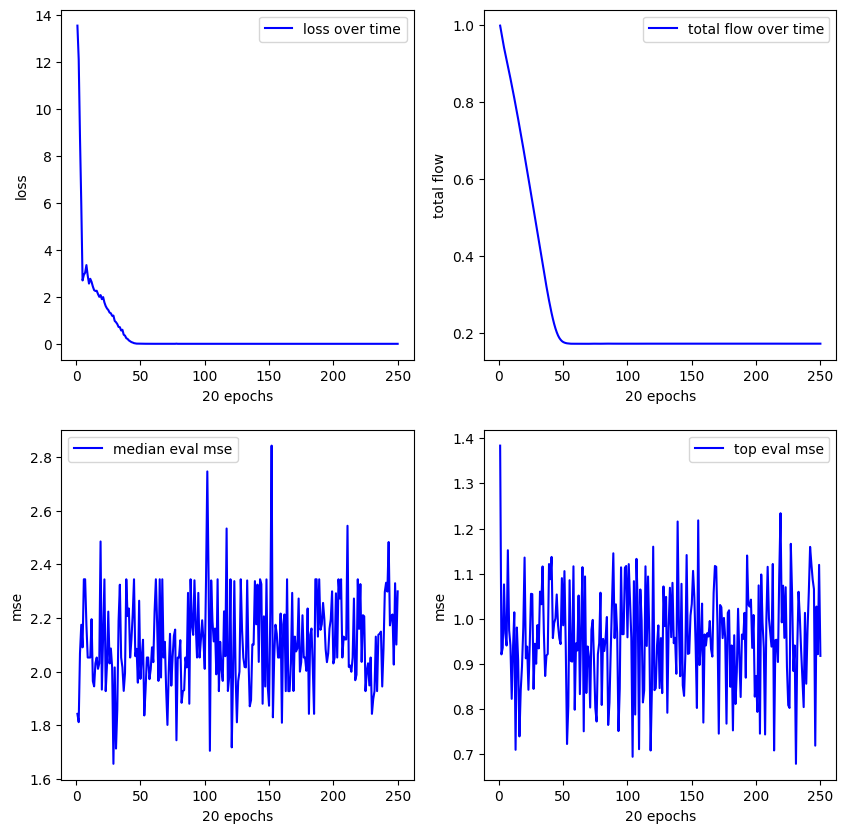

**************************************************
Experiment 7
training started with device cuda


14.459:   0%|          | 2/5000 [00:00<04:16, 19.47it/s]


new best reward (vanilla): 0.6166141033172607
mse (pre/post optimized): 0.7747437953948975/0.782075822353363
(exp(x1)) + ((0.73) * (x1))
expr: 0.73*x1 + exp(x1)


0.000: 100%|██████████| 5000/5000 [01:34<00:00, 53.13it/s]


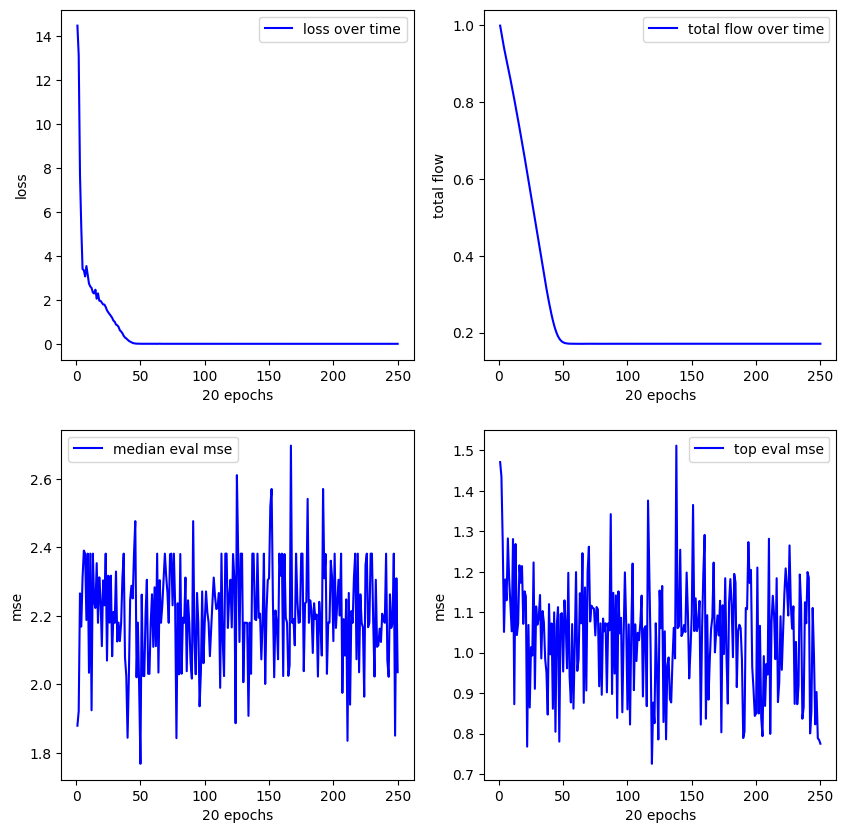

**************************************************
Experiment 8
training started with device cuda


12.296:   0%|          | 2/5000 [00:00<04:37, 18.00it/s]


new best reward (vanilla): 0.8253657221794128
mse (pre/post optimized): 0.41783806681632996/0.3105089068412781
(exp(x1)) * ((0.42) + (x1))
expr: (x1 + 0.42)*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:29<00:00, 55.64it/s]


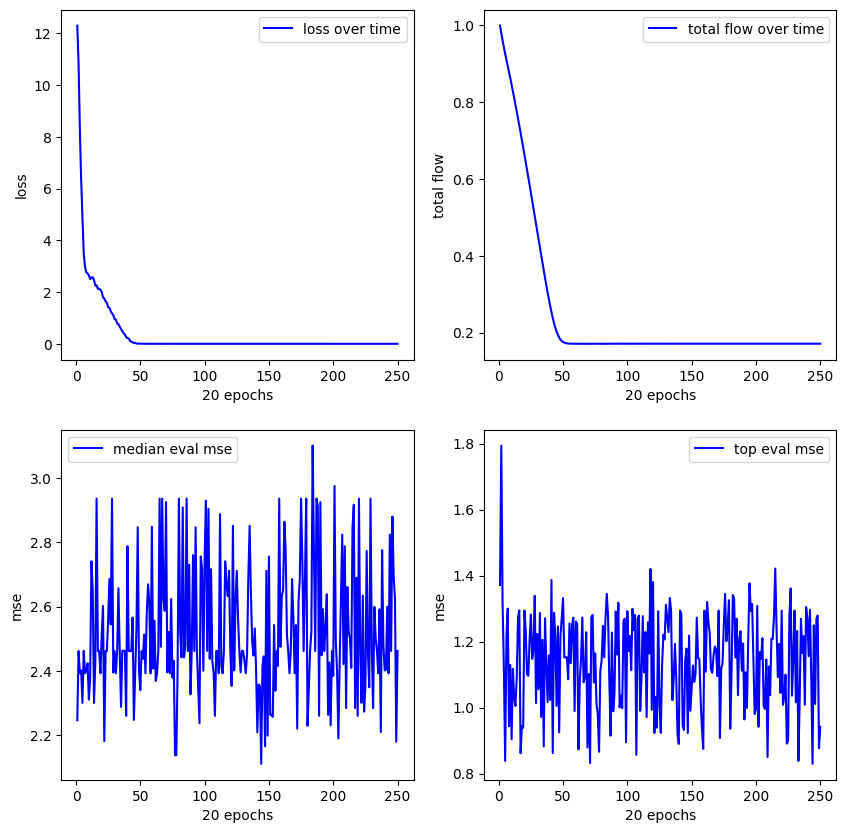

**************************************************
Experiment 9
training started with device cuda


12.237:   0%|          | 1/5000 [00:00<09:19,  8.94it/s]


new best reward (vanilla): 0.6767524480819702
mse (pre/post optimized): 0.6990292072296143/0.6114879250526428
((x1) + (0.66)) / (cos(x1))
expr: (x1 + 0.66)/cos(x1)


0.000: 100%|██████████| 5000/5000 [01:25<00:00, 58.20it/s]


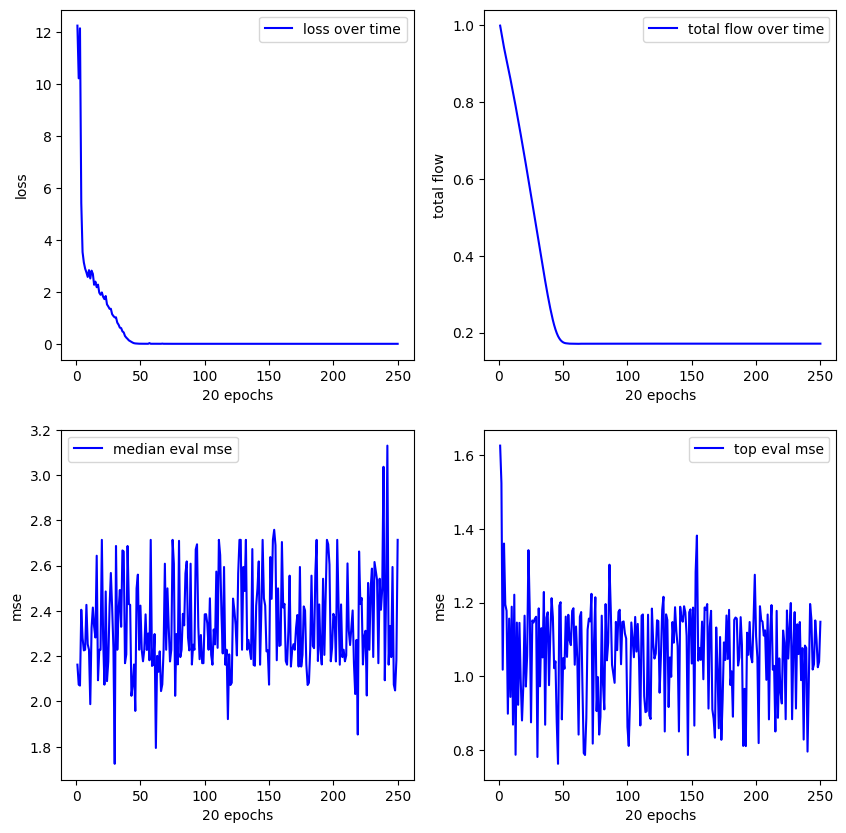

**************************************************
Experiment 10
training started with device cuda


13.897:   0%|          | 2/5000 [00:00<04:47, 17.38it/s]


new best reward (vanilla): 0.7476030588150024
mse (pre/post optimized): 0.536329984664917/0.5104033350944519
square((0.74) + (x1))
expr: square(x1 + 0.74)


0.000: 100%|██████████| 5000/5000 [01:25<00:00, 58.29it/s]


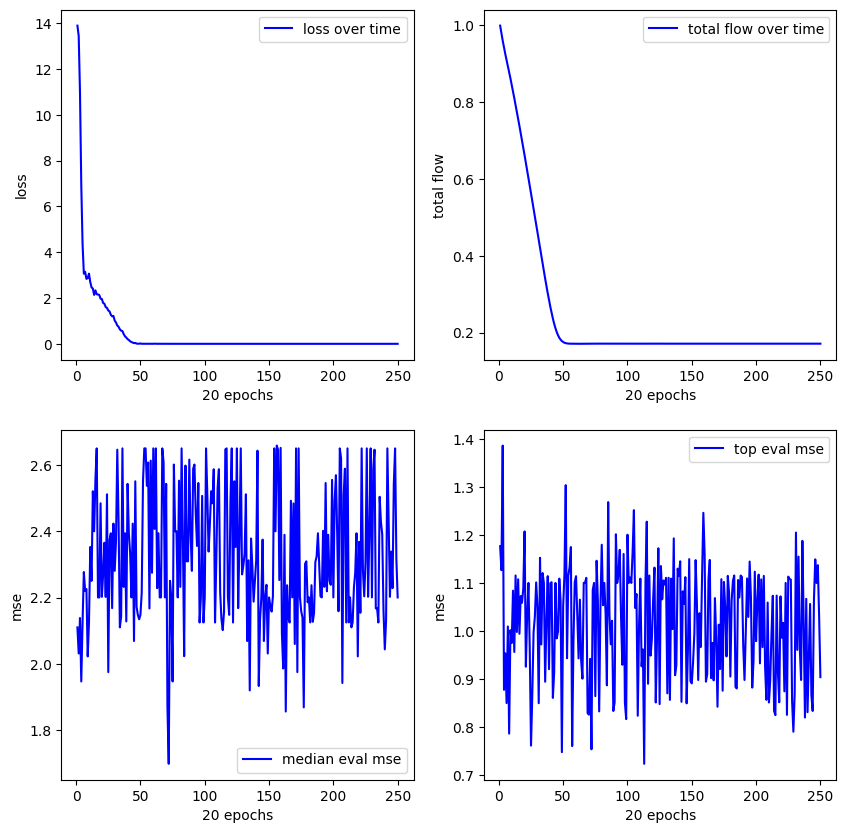

**************************************************
Experiment 11
training started with device cuda


13.258:   0%|          | 3/5000 [00:00<03:07, 26.72it/s]


new best reward (vanilla): 0.5580323934555054
mse (pre/post optimized): 1.0409114360809326/1.0409114360809326
exp(x1)
expr: exp(x1)


14.050:   1%|          | 27/5000 [00:00<01:58, 42.03it/s]


new best reward (vanilla): 0.6191626787185669
mse (pre/post optimized): 0.2064487785100937/0.16671966016292572
((x1) + (0.87)) * ((x1) / (0.43))
expr: 2.32558139534884*x1*(x1 + 0.87)


0.000: 100%|██████████| 5000/5000 [01:27<00:00, 57.35it/s]


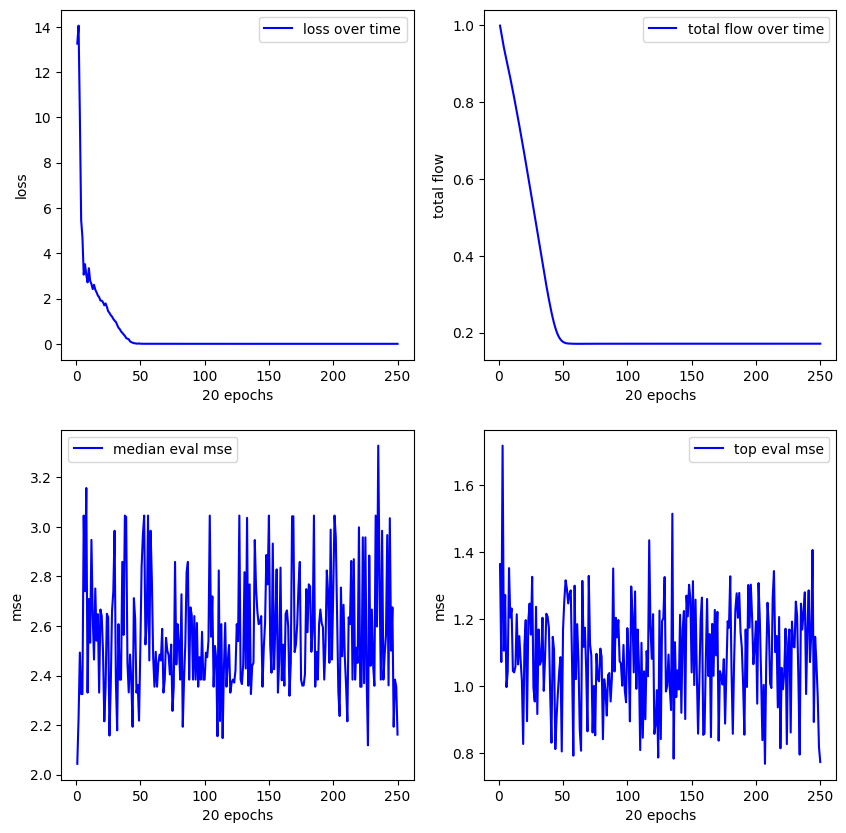

**************************************************
Experiment 12
training started with device cuda


13.300:   0%|          | 1/5000 [00:00<09:12,  9.06it/s]


new best reward (vanilla): 0.7184198498725891
mse (pre/post optimized): 0.7104353904724121/0.7104353904724121
(exp(x1)) * (x1)
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:26<00:00, 57.62it/s]


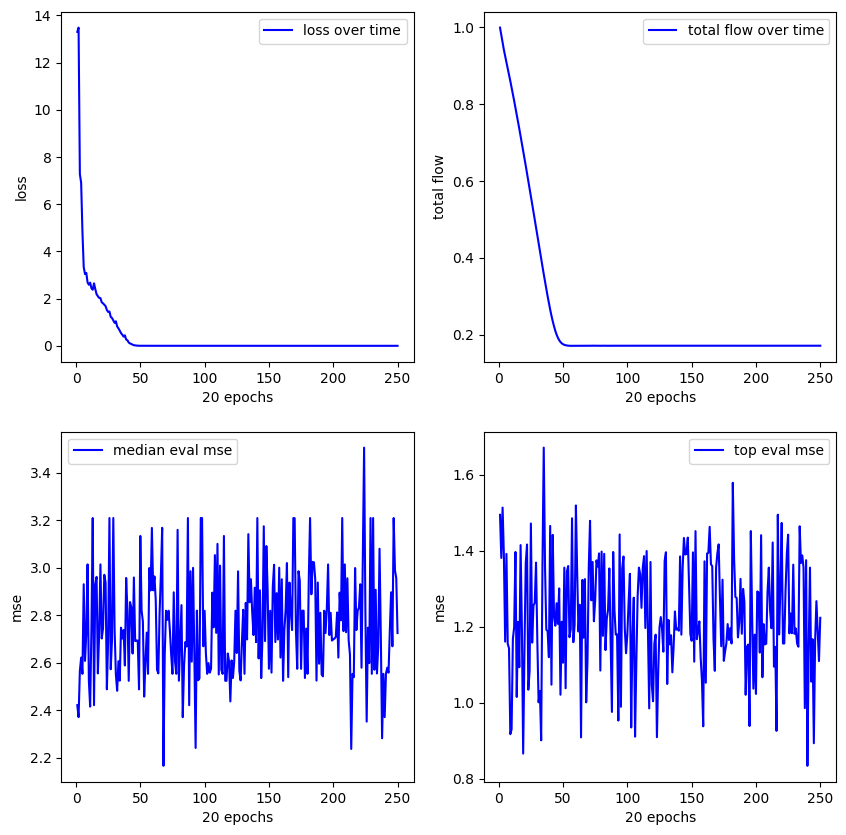

**************************************************
Experiment 13
training started with device cuda


11.057:   0%|          | 2/5000 [00:00<05:04, 16.41it/s]


new best reward (vanilla): 0.5052748918533325
mse (pre/post optimized): 1.219670057296753/1.219670057296753
(square(x1)) + (exp(x1))
expr: square(x1) + exp(x1)


0.000: 100%|██████████| 5000/5000 [02:00<00:00, 41.33it/s]


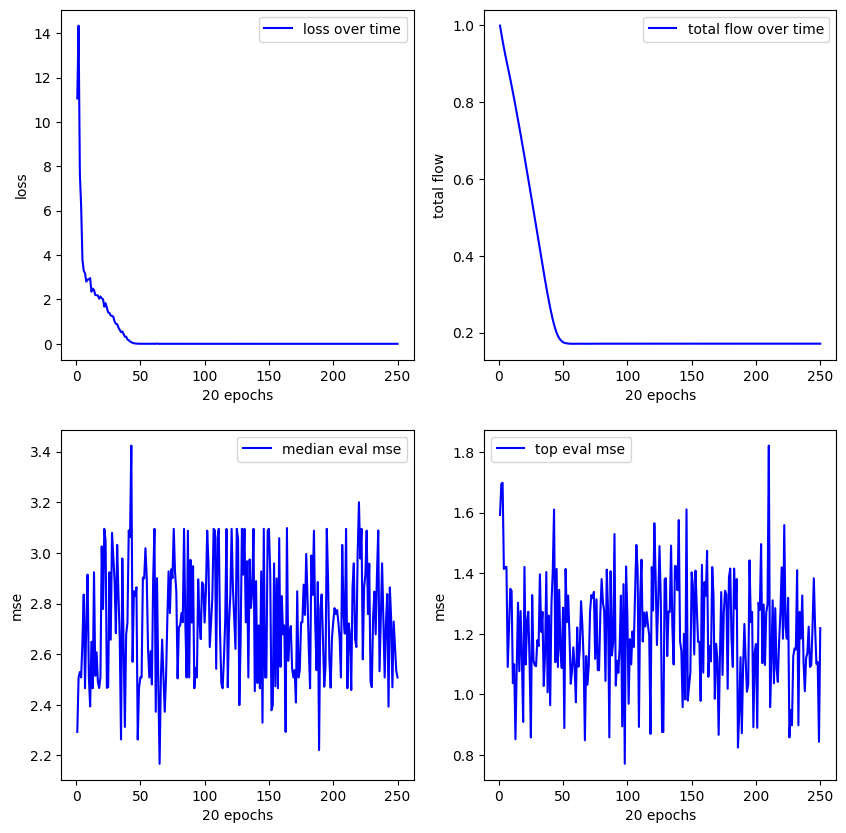

**************************************************
Experiment 14
training started with device cuda


13.401:   0%|          | 1/5000 [00:00<13:33,  6.15it/s]


new best reward (vanilla): 0.6170722246170044
mse (pre/post optimized): 0.6364258527755737/0.6113139986991882
((x1) + (0.59)) + (sin(x1))
expr: x1 + sin(x1) + 0.59


0.000: 100%|██████████| 5000/5000 [03:37<00:00, 22.95it/s]


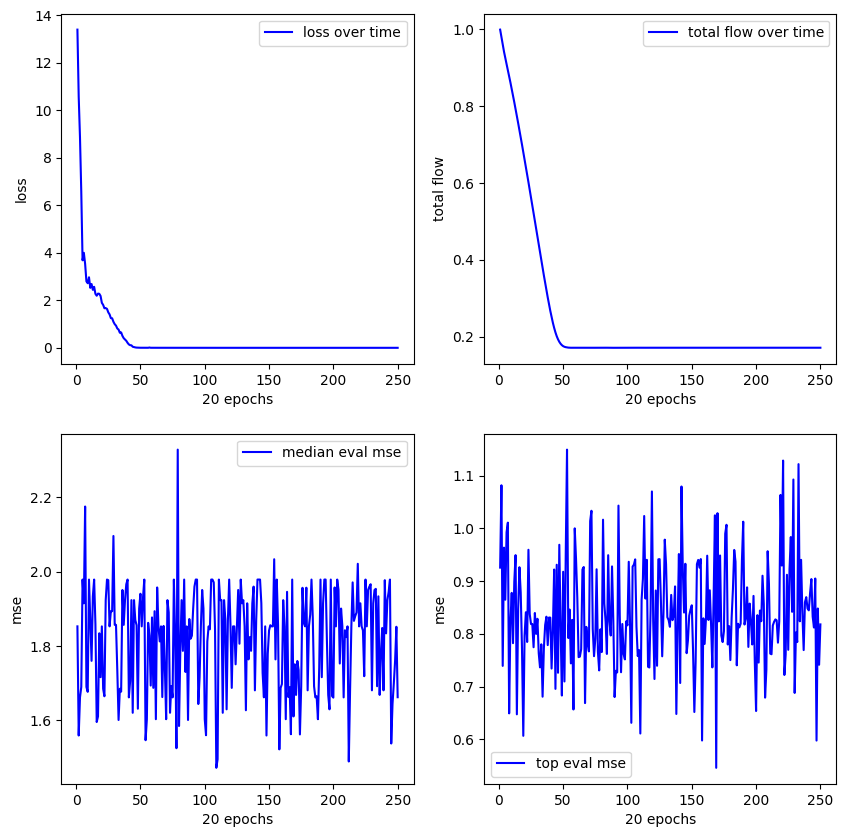

**************************************************
Experiment 15
training started with device cuda


14.974:   0%|          | 1/5000 [00:00<14:12,  5.86it/s]


new best reward (vanilla): 0.5645817518234253
mse (pre/post optimized): 0.7963626384735107/0.7963626384735107
((x1) / (x1)) + ((x1) + (x1))
expr: 2*x1 + 1


14.974:   0%|          | 11/5000 [00:00<05:11, 16.01it/s]


new best reward (vanilla): 0.7386671304702759
mse (pre/post optimized): 0.14984744787216187/0.14450615644454956
((x1) + (x1)) * ((1.0) + (x1))
expr: 2*x1*(x1 + 1.0)


0.000: 100%|██████████| 5000/5000 [01:49<00:00, 45.84it/s]


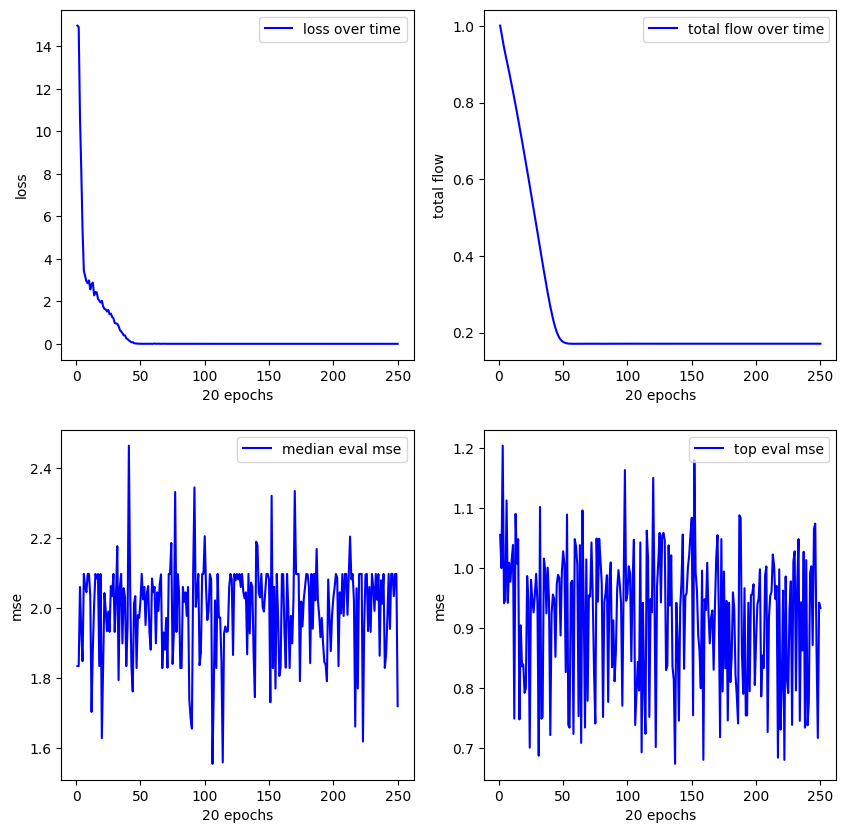

**************************************************
Experiment 16
training started with device cuda


12.671:   0%|          | 1/5000 [00:00<09:34,  8.71it/s]


new best reward (vanilla): 0.5550638437271118
mse (pre/post optimized): 1.0331577062606812/1.0331577062606812
(sin(x1)) + (square(x1))
expr: square(x1) + sin(x1)


0.000: 100%|██████████| 5000/5000 [01:24<00:00, 59.03it/s]


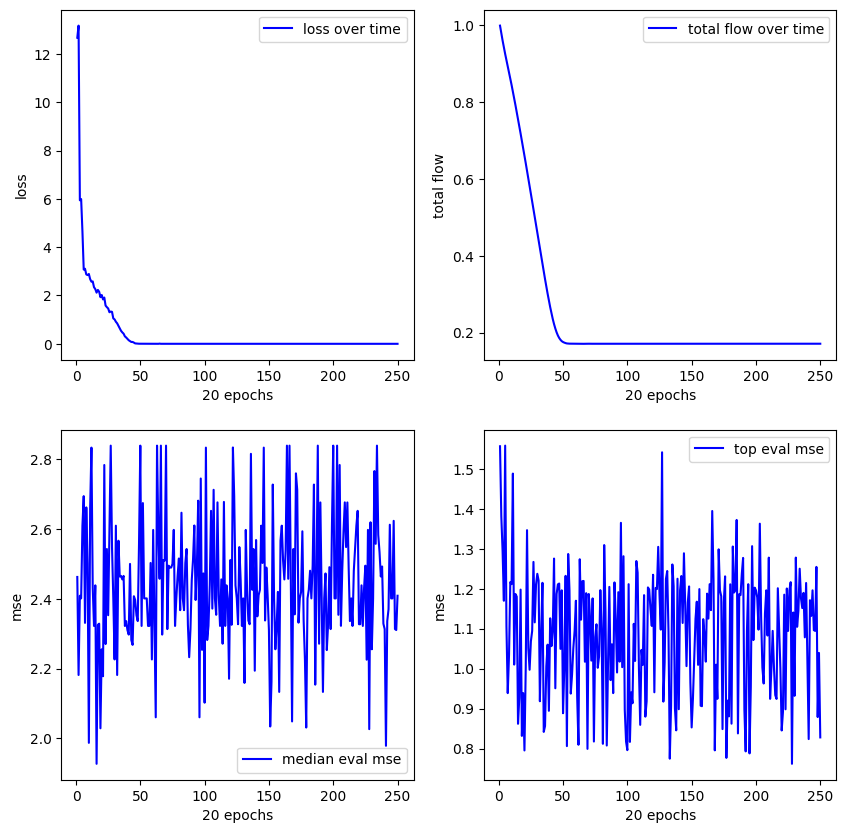

**************************************************
Experiment 17
training started with device cuda


12.352:   0%|          | 1/5000 [00:00<08:50,  9.43it/s]


new best reward (vanilla): 0.5283830165863037
mse (pre/post optimized): 1.0184177160263062/0.7765981554985046
(sin(x1)) + ((0.67) + (x1))
expr: x1 + sin(x1) + 0.67


0.000: 100%|██████████| 5000/5000 [01:33<00:00, 53.71it/s]


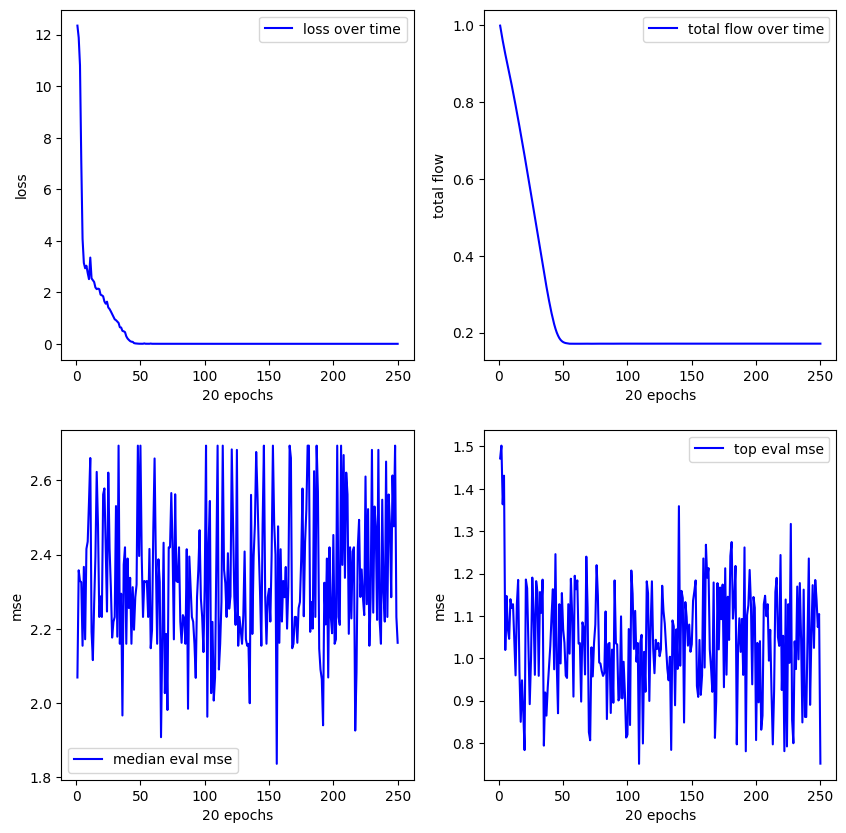

**************************************************
Experiment 18
training started with device cuda


12.801:   0%|          | 1/5000 [00:00<14:41,  5.67it/s]


new best reward (vanilla): 0.6175508499145508
mse (pre/post optimized): 0.917868971824646/0.8629162311553955
(square(x1)) + ((x1) + (0.39))
expr: x1 + square(x1) + 0.39


12.419:   0%|          | 24/5000 [00:00<02:59, 27.67it/s]


new best reward (vanilla): 0.6934410333633423
mse (pre/post optimized): 0.12306229770183563/0.12191016227006912
(exp(x1)) * ((x1) / (0.57))
expr: 1.75438596491228*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:41<00:00, 49.18it/s]


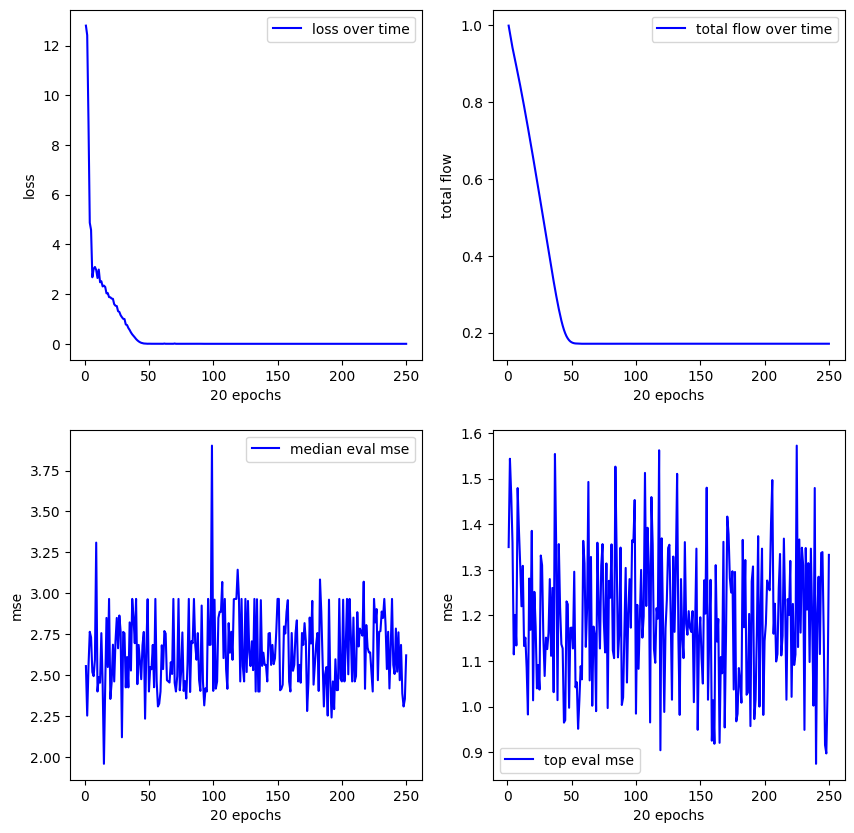

**************************************************
Experiment 19
training started with device cuda


13.545:   0%|          | 2/5000 [00:00<07:15, 11.47it/s]


new best reward (vanilla): 0.8169503211975098
mse (pre/post optimized): 0.4538153409957886/1.9023669958114624
(exp(x1)) / ((0.32) / (x1))
expr: 3.125*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [01:30<00:00, 55.13it/s]


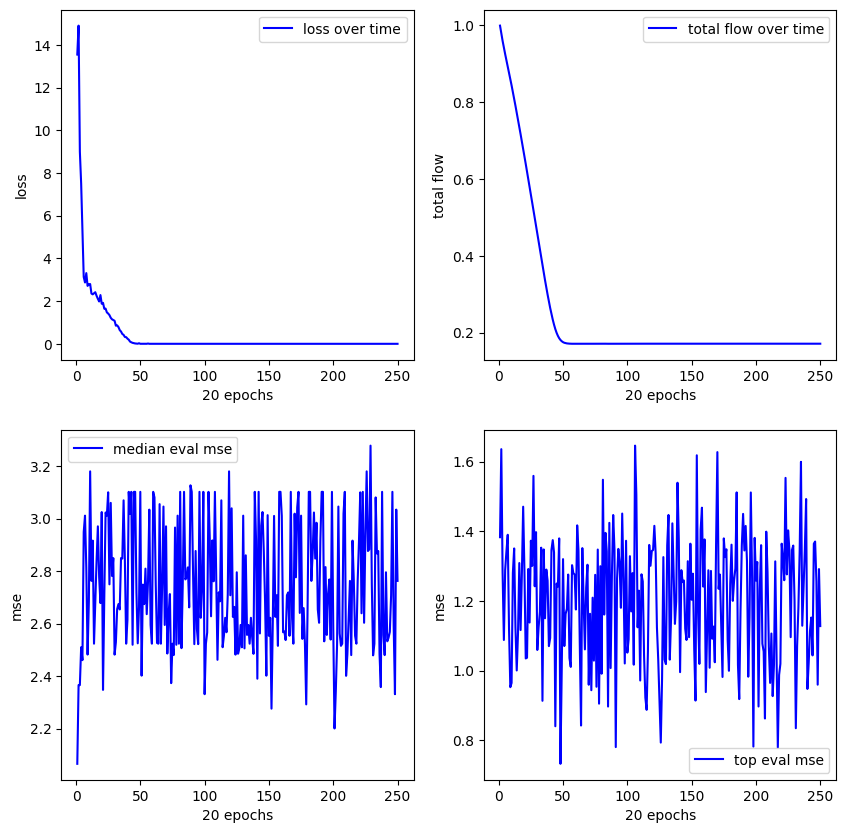

**************************************************
Experiment 20
training started with device cuda


19.983:   0%|          | 3/5000 [00:00<02:59, 27.86it/s]


new best reward (vanilla): 0.7923315763473511
mse (pre/post optimized): 0.37783047556877136/0.37783047556877136
(square(x1)) + ((x1) + (x1))
expr: 2*x1 + square(x1)


0.000: 100%|██████████| 5000/5000 [01:27<00:00, 56.87it/s]


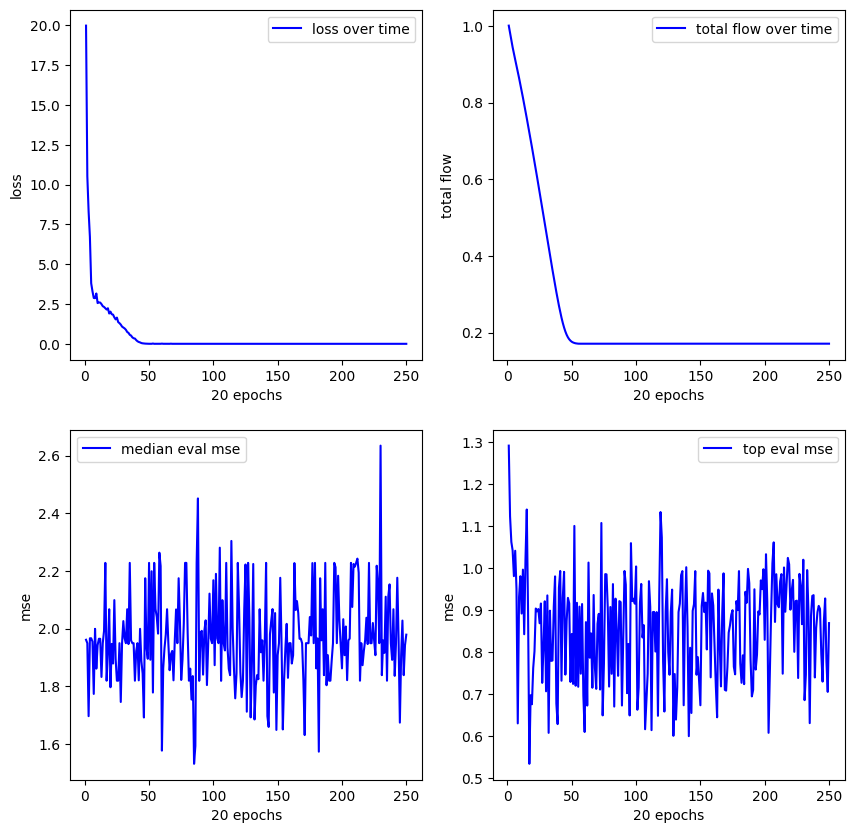

--------------------------------------------------
FUNCTION sin(x**2)cos(x) - 1 Interval considered: [-1, 1]
**************************************************
Experiment 1
training started with device cuda


15.701:   0%|          | 2/5000 [00:00<04:34, 18.19it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 1.2157948017120361/1.2157948017120361
sin(square(x1))
expr: sin(square(x1))

new best reward (vanilla): 0.7395496368408203
mse (pre/post optimized): 0.007278625853359699/0.03214234113693237
((x1) * (0.27)) - (cos(x1))
expr: 0.27*x1 - cos(x1)


0.000: 100%|██████████| 5000/5000 [01:34<00:00, 53.12it/s]


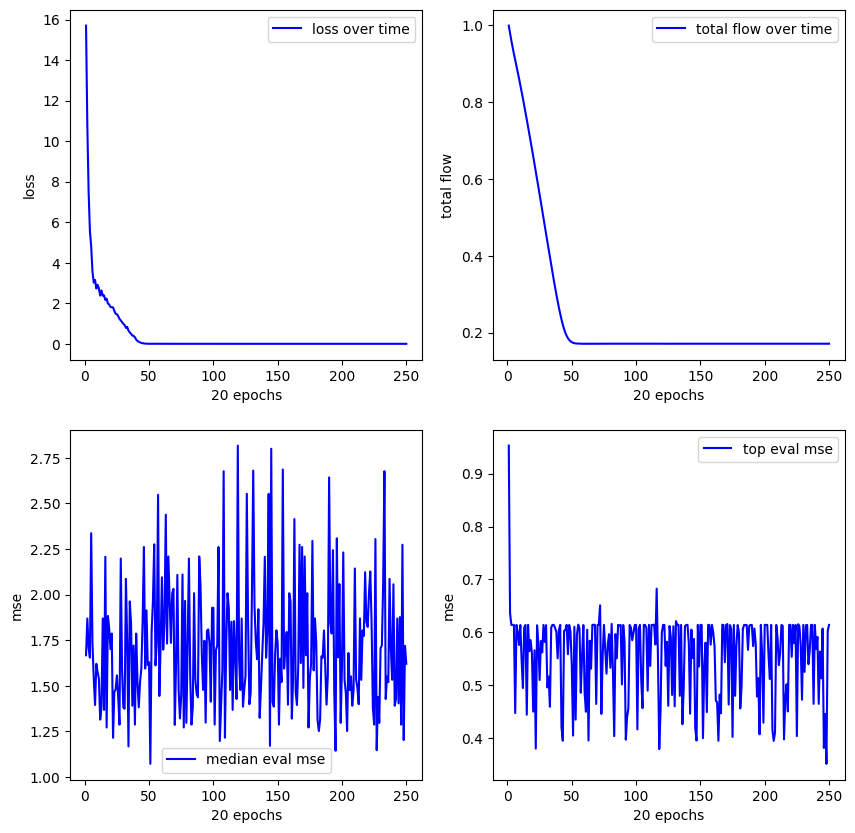

**************************************************
Experiment 2
training started with device cuda


14.169:   0%|          | 1/5000 [00:00<08:56,  9.31it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 0.8758378624916077/0.8758378624916077
sin(x1)
expr: sin(x1)

new best reward (vanilla): 0.7350014448165894
mse (pre/post optimized): 0.006558087654411793/0.006558087654411793
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [01:27<00:00, 57.31it/s]


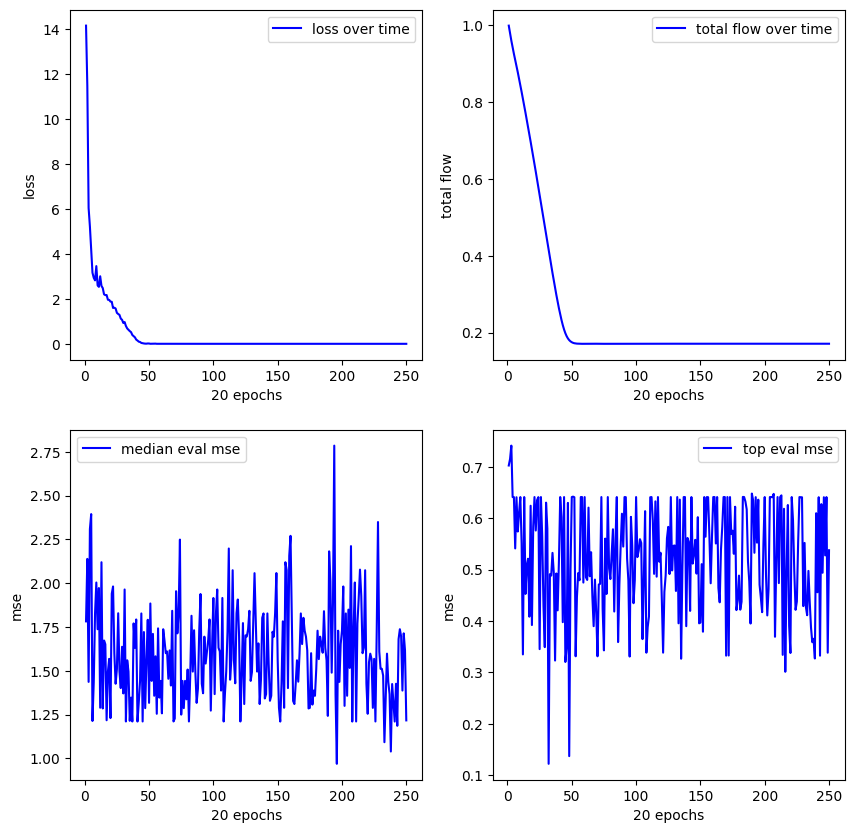

**************************************************
Experiment 3
training started with device cuda


12.264:   0%|          | 4/5000 [00:00<02:17, 36.34it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): inf/nan
((0.58) / (x1)) / (log(x1))
expr: 0.58/(x1*log(x1))


11.100:   0%|          | 16/5000 [00:00<01:57, 42.33it/s]


new best reward (vanilla): 0.876776933670044
mse (pre/post optimized): 0.002777555026113987/0.0016186782158911228
(0.07) - (cos(x1))
expr: 0.07 - cos(x1)


0.000: 100%|██████████| 5000/5000 [01:26<00:00, 57.99it/s]


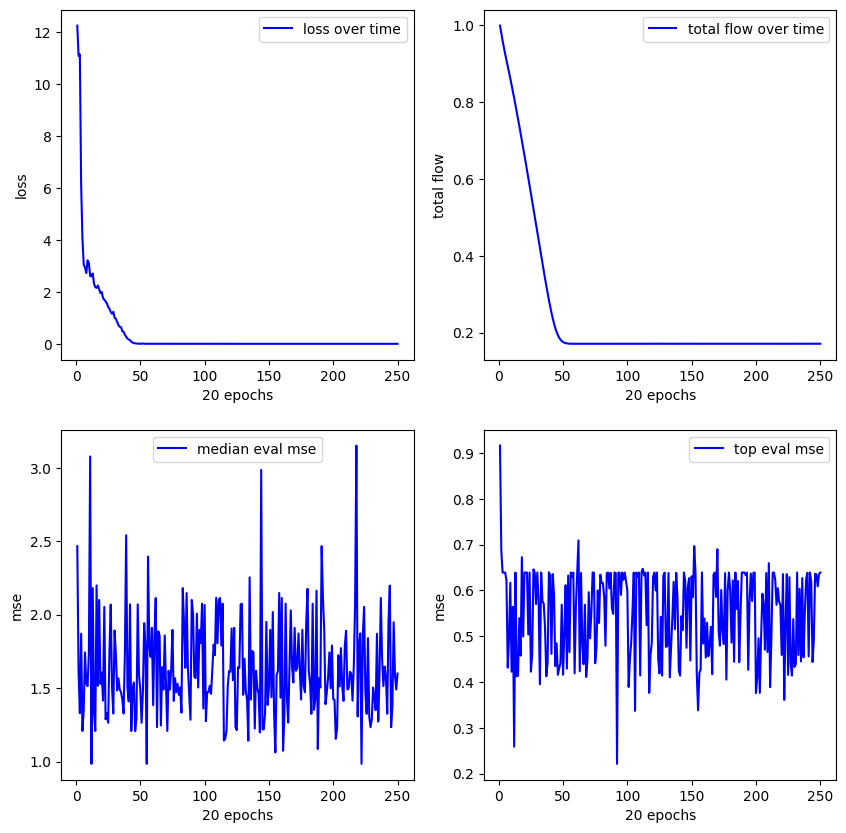

**************************************************
Experiment 4
training started with device cuda


13.618:   0%|          | 3/5000 [00:00<02:52, 29.05it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): inf/nan
sqrt(log(x1))
expr: sqrt(log(x1))


7.847:   1%|          | 41/5000 [00:00<01:42, 48.44it/s] 


new best reward (vanilla): 0.00452268123626709
mse (pre/post optimized): 0.025769593194127083/0.02583574689924717
((x1) - (0.77)) - ((x1) / (0.98))
expr: -0.0204081632653061*x1 - 0.77


5.530:   1%|          | 59/5000 [00:01<02:04, 39.73it/s]


new best reward (vanilla): 0.6080020666122437
mse (pre/post optimized): 0.010106219910085201/0.006203908938914537
((0.02) * (x1)) - (cos(x1))
expr: 0.02*x1 - cos(x1)


0.000: 100%|██████████| 5000/5000 [01:28<00:00, 56.66it/s]


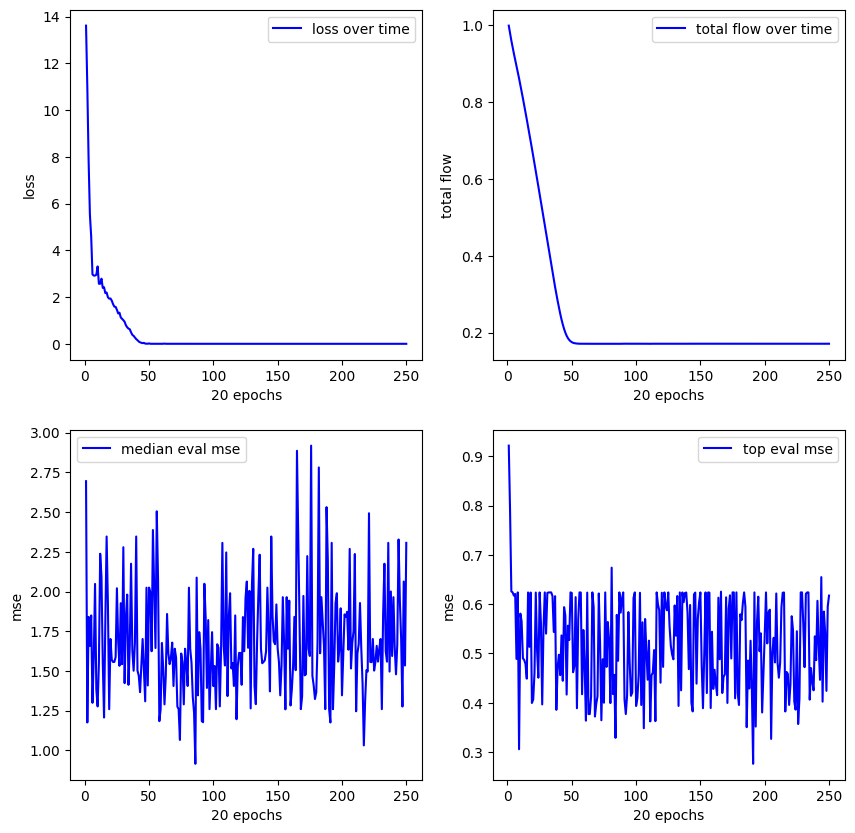

**************************************************
Experiment 5
training started with device cuda


15.360:   0%|          | 3/5000 [00:00<03:25, 24.37it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 1.2138015031814575/1.2138015031814575
sin(square(x1))
expr: sin(square(x1))


11.884:   1%|          | 33/5000 [00:00<02:03, 40.14it/s]


new best reward (vanilla): 0.7633183002471924
mse (pre/post optimized): 0.006329922471195459/0.006329922471195459
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [02:56<00:00, 28.40it/s]


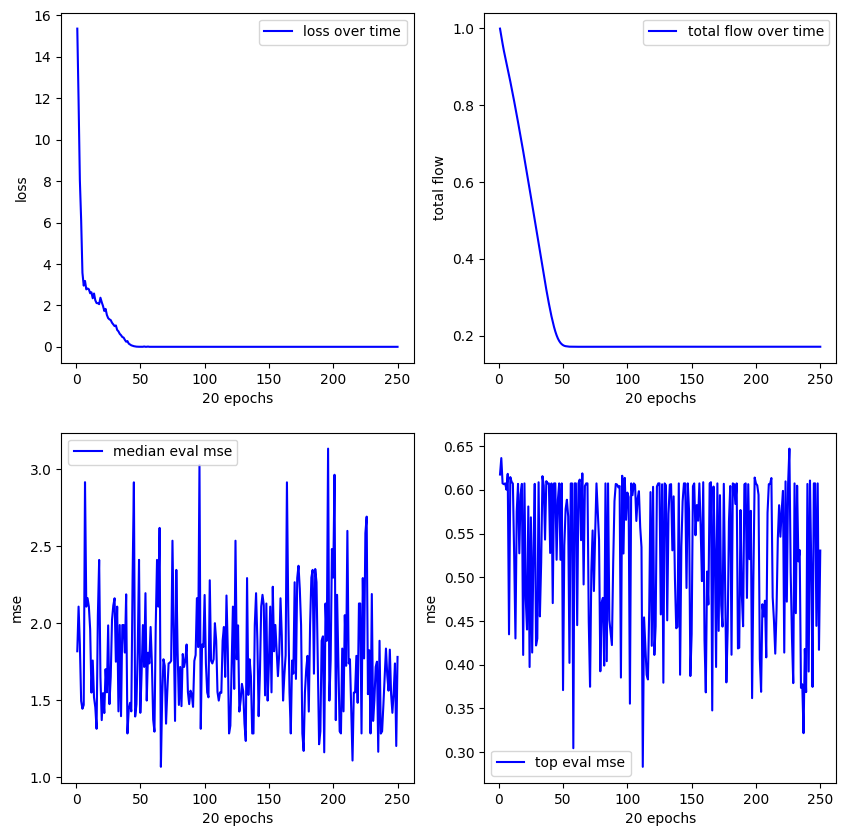

**************************************************
Experiment 6
training started with device cuda


15.722:   0%|          | 1/5000 [00:00<15:30,  5.37it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 1.324426531791687/1.2487987279891968
((0.11) + (x1)) * (x1)
expr: x1*(x1 + 0.11)


15.722:   0%|          | 17/5000 [00:00<03:41, 22.47it/s]


new best reward (vanilla): 0.00041109323501586914
mse (pre/post optimized): 0.027332132682204247/0.0875304639339447
((x1) * (0.63)) - ((x1) + (0.66))
expr: -0.37*x1 - 0.66


7.281:   1%|          | 61/5000 [00:02<03:30, 23.44it/s] 


new best reward (vanilla): 0.7977726459503174
mse (pre/post optimized): 0.005527534056454897/0.005527534056454897
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [03:20<00:00, 24.90it/s]


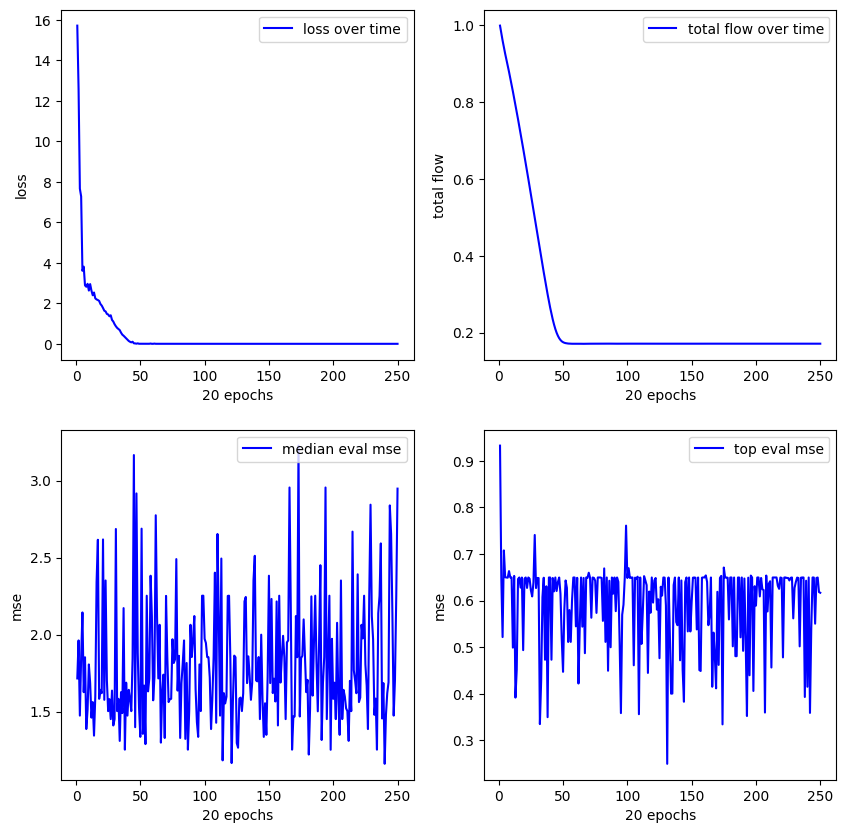

**************************************************
Experiment 7
training started with device cuda


13.678:   0%|          | 1/5000 [00:00<14:38,  5.69it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): inf/nan
exp(sqrt(x1))
expr: exp(sqrt(x1))


13.678:   0%|          | 9/5000 [00:00<07:00, 11.87it/s]


new best reward (vanilla): 0.686050295829773
mse (pre/post optimized): 0.00850881077349186/0.006258651614189148
((-0.0) * (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [05:14<00:00, 15.88it/s]


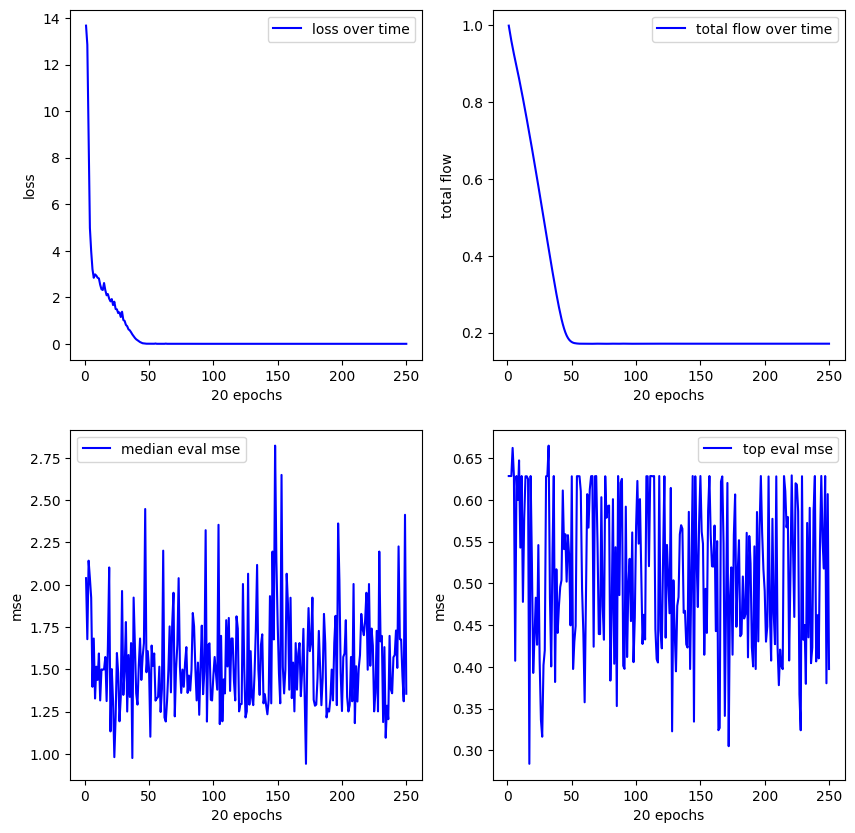

**************************************************
Experiment 8
training started with device cuda


  0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 2.1624443531036377/1.271699070930481
(cos(x1)) * ((0.29) - (x1))


10.579:   0%|          | 0/5000 [00:00<?, ?it/s]

expr: (0.29 - x1)*cos(x1)


14.676:   1%|          | 40/5000 [00:04<10:11,  8.12it/s]


new best reward (vanilla): 0.9342279434204102
mse (pre/post optimized): 0.0016775033436715603/0.08406002074480057
(0.35) - (cos(x1))
expr: 0.35 - cos(x1)


0.000: 100%|██████████| 5000/5000 [05:08<00:00, 16.20it/s]


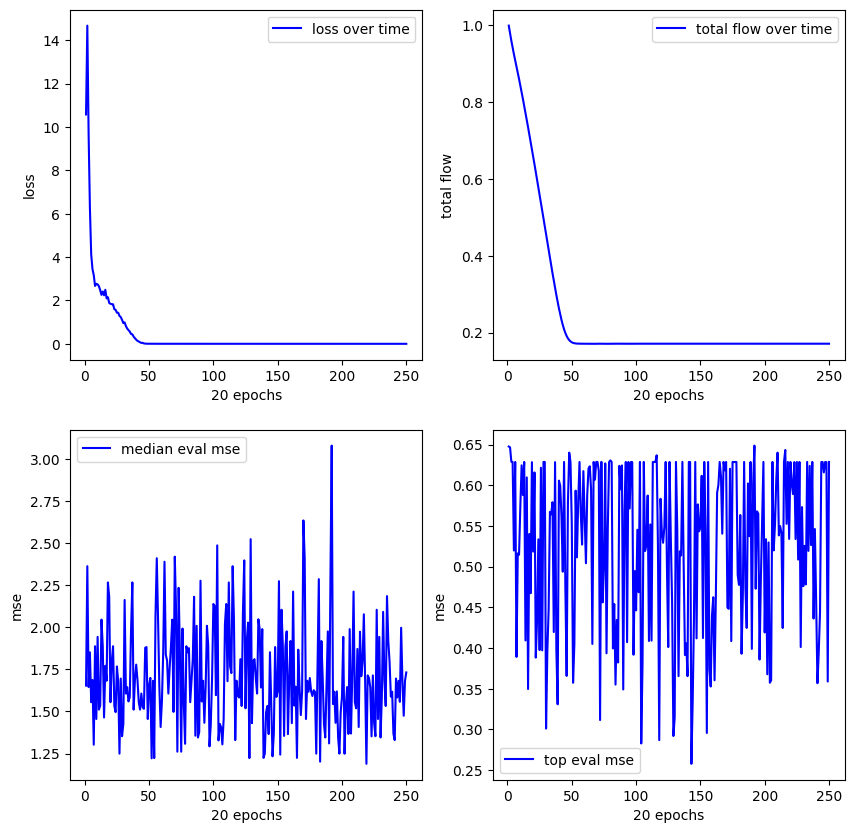

**************************************************
Experiment 9
training started with device cuda


11.113:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 1.1657493114471436/0.6222454905509949
square((0.0) * (x1))
expr: square(0)


11.113:   0%|          | 13/5000 [00:01<06:34, 12.65it/s]


new best reward (vanilla): 0.2808009386062622
mse (pre/post optimized): 0.018619604408740997/0.00652350066229701
((0.0) * (x1)) - (cos(x1))
expr: -cos(x1)


10.525:   0%|          | 21/5000 [00:02<09:18,  8.92it/s]


new best reward (vanilla): 0.6628004312515259
mse (pre/post optimized): 0.006523660384118557/0.006523660384118557
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


10.525:   1%|          | 33/5000 [00:03<06:32, 12.66it/s]


new best reward (vanilla): 0.7008690237998962
mse (pre/post optimized): 0.0019897890742868185/0.0018648526165634394
(0.07) - (cos(x1))
expr: 0.07 - cos(x1)


0.000: 100%|██████████| 5000/5000 [04:59<00:00, 16.67it/s]


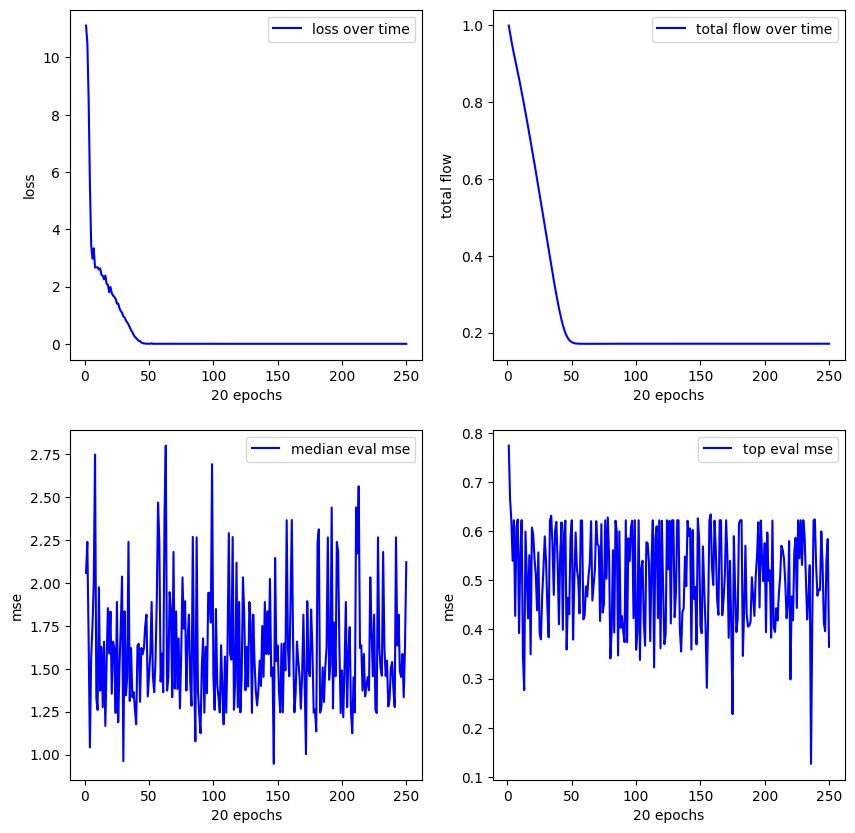

**************************************************
Experiment 10
training started with device cuda


13.662:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): inf/nan
(sin(x1)) - (sqrt(x1))
expr: -sqrt(x1) + sin(x1)


13.589:   0%|          | 21/5000 [00:01<05:30, 15.08it/s]


new best reward (vanilla): 0.01459968090057373
mse (pre/post optimized): 0.027974272146821022/0.06628111749887466
((x1) * (0.38)) - (0.81)
expr: 0.38*x1 - 0.81


6.971:   1%|          | 47/5000 [00:03<05:14, 15.76it/s] 


new best reward (vanilla): 0.789986789226532
mse (pre/post optimized): 0.0058836727403104305/0.0058836727403104305
((x1) * (0.02)) - (cos(x1))
expr: 0.02*x1 - cos(x1)


0.000: 100%|██████████| 5000/5000 [03:33<00:00, 23.45it/s]


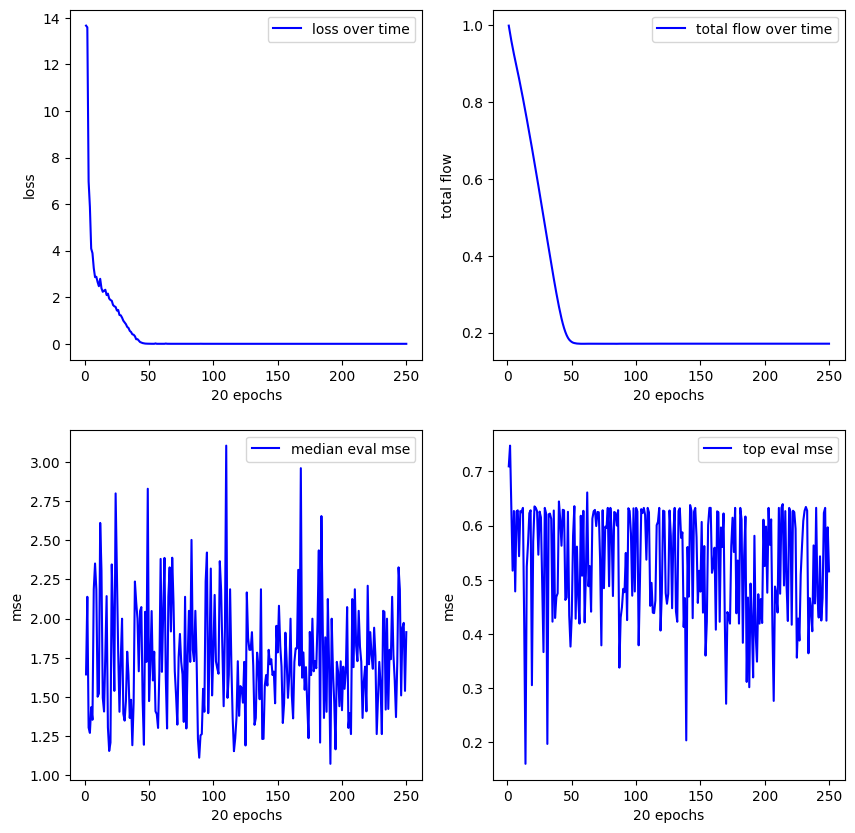

**************************************************
Experiment 11
training started with device cuda


13.492:   0%|          | 1/5000 [00:00<12:52,  6.47it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): inf/nan
(cos(x1)) + (log(x1))
expr: log(x1) + cos(x1)


10.620:   1%|          | 30/5000 [00:01<04:32, 18.24it/s]


new best reward (vanilla): 0.03391605615615845
mse (pre/post optimized): 0.026538269594311714/0.02111952379345894
(exp(x1)) * ((x1) - (1.02))
expr: (x1 - 1.02)*exp(x1)

new best reward (vanilla): 0.7475789785385132
mse (pre/post optimized): 0.0067223357036709785/0.0067223357036709785
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [03:30<00:00, 23.75it/s]


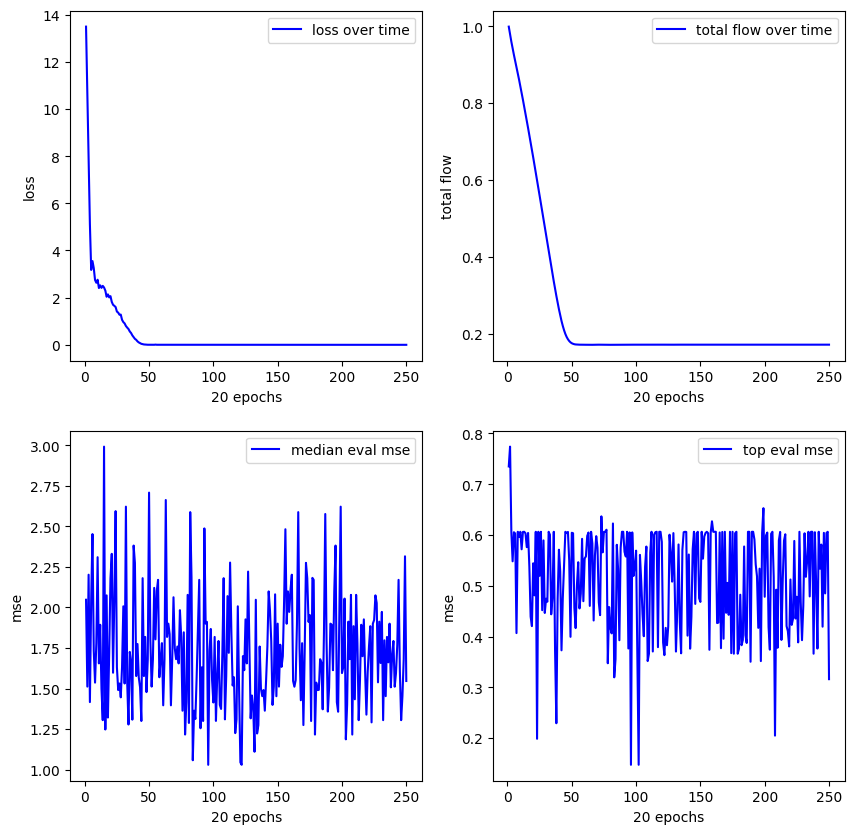

**************************************************
Experiment 12
training started with device cuda


13.660:   0%|          | 1/5000 [00:00<15:25,  5.40it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 3.3326642513275146/3.702106237411499
(cos(x1)) / (0.71)
expr: 1.40845070422535*cos(x1)


13.660:   0%|          | 13/5000 [00:00<04:59, 16.63it/s]


new best reward (vanilla): 0.9307836294174194
mse (pre/post optimized): 0.001774369738996029/0.0017741690389811993
(0.07) - (cos(x1))
expr: 0.07 - cos(x1)


0.000: 100%|██████████| 5000/5000 [03:32<00:00, 23.51it/s]


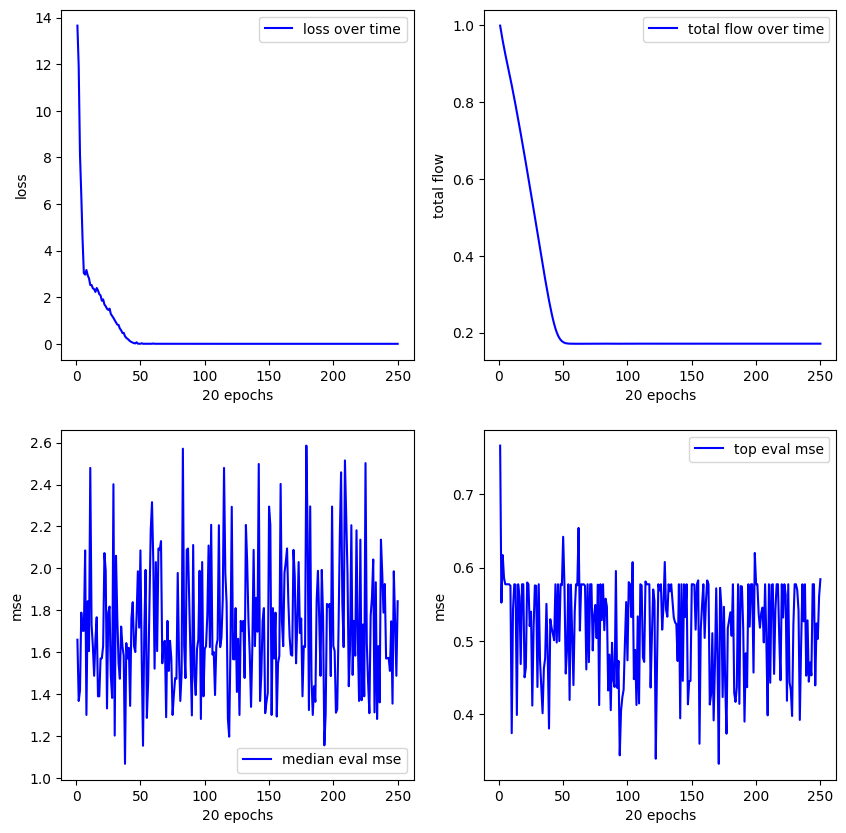

**************************************************
Experiment 13
training started with device cuda


14.948:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 1.0945861339569092/1.0945861339569092
square(sin(x1))
expr: square(sin(x1))


14.948:   0%|          | 18/5000 [00:01<04:35, 18.06it/s]


new best reward (vanilla): 0.927885115146637
mse (pre/post optimized): 0.001888088881969452/0.001888088881969452
(0.06) - (cos(x1))
expr: 0.06 - cos(x1)


0.000: 100%|██████████| 5000/5000 [03:35<00:00, 23.17it/s]


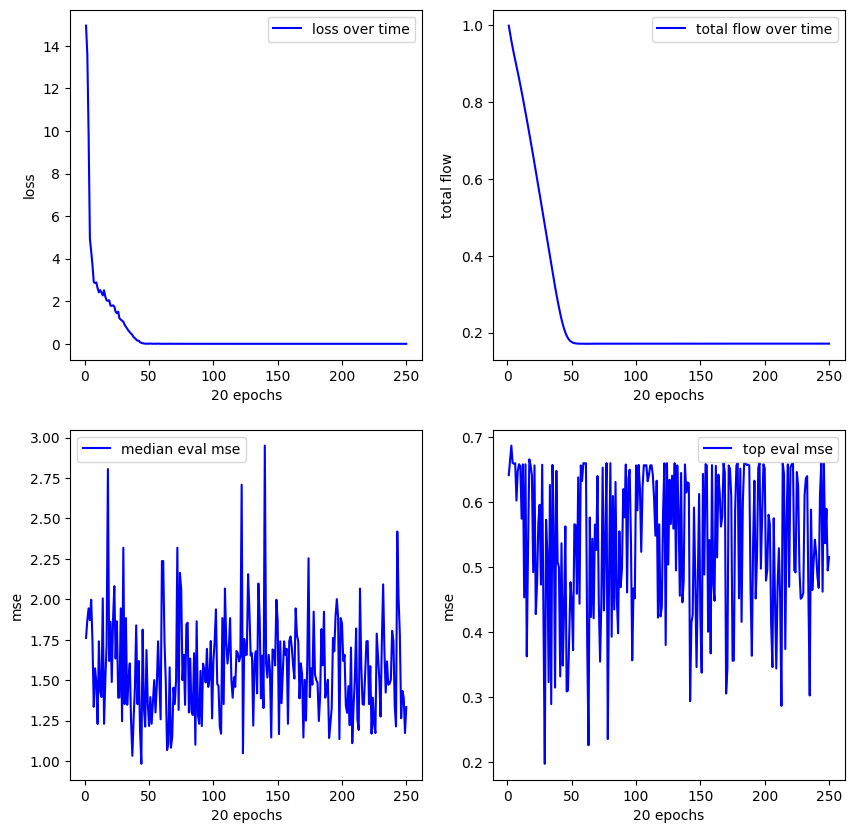

**************************************************
Experiment 14
training started with device cuda


12.084:   0%|          | 1/5000 [00:00<12:11,  6.83it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): inf/nan
(sin(x1)) * (sqrt(x1))
expr: sqrt(x1)*sin(x1)


9.317:   1%|          | 36/5000 [00:01<04:38, 17.83it/s] 


new best reward (vanilla): 0.12960779666900635
mse (pre/post optimized): 0.023945098742842674/0.020759131759405136
(exp(x1)) * ((x1) - (1.03))
expr: (x1 - 1.03)*exp(x1)


7.270:   1%|          | 41/5000 [00:02<05:57, 13.86it/s]


new best reward (vanilla): 0.7508653402328491
mse (pre/post optimized): 0.0060543883591890335/0.0060543883591890335
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [03:22<00:00, 24.64it/s]


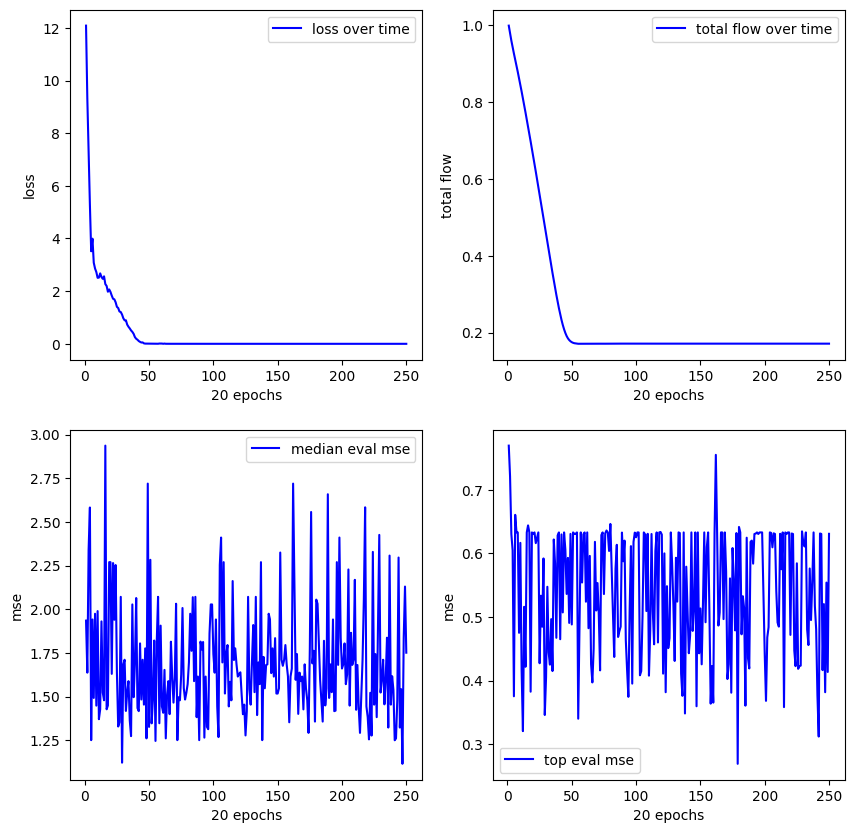

**************************************************
Experiment 15
training started with device cuda


12.513:   0%|          | 1/5000 [00:00<13:43,  6.07it/s]


new best reward (vanilla): 0.8959300518035889
mse (pre/post optimized): 0.002849102718755603/0.0987880676984787
(0.38) - (cos(x1))
expr: 0.38 - cos(x1)


0.000: 100%|██████████| 5000/5000 [03:05<00:00, 26.88it/s]


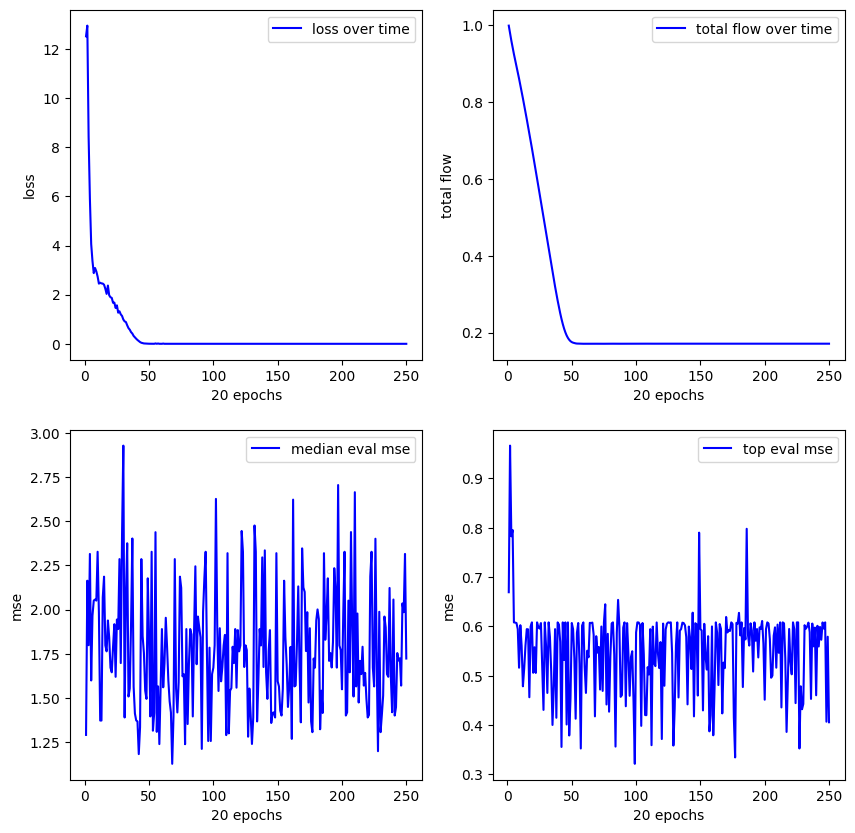

**************************************************
Experiment 16
training started with device cuda


13.539:   0%|          | 1/5000 [00:00<10:50,  7.69it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): inf/nan
square(log(x1))
expr: square(log(x1))


13.539:   0%|          | 16/5000 [00:00<02:54, 28.48it/s]


new best reward (vanilla): 0.325623095035553
mse (pre/post optimized): 0.020399928092956543/0.00526350038126111
((x1) * (0.0)) - (cos(x1))
expr: -cos(x1)


3.087:   2%|▏         | 111/5000 [00:04<03:34, 22.82it/s]


new best reward (vanilla): 0.6694700717926025
mse (pre/post optimized): 0.005266047082841396/0.005266047082841396
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [03:07<00:00, 26.73it/s]


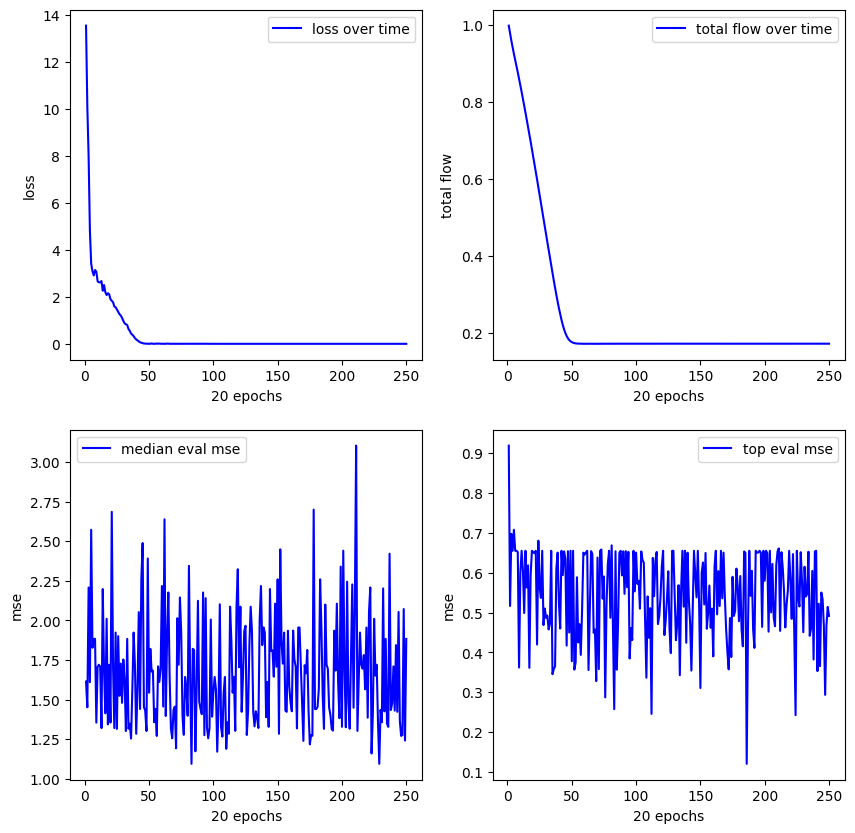

**************************************************
Experiment 17
training started with device cuda


14.787:   0%|          | 1/5000 [00:00<08:32,  9.75it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 1.0009255409240723/1.0009255409240723
x1
expr: x1


14.787:   0%|          | 12/5000 [00:00<03:35, 23.11it/s]


new best reward (vanilla): 0.03426241874694824
mse (pre/post optimized): 0.027133412659168243/0.027133412659168243
((x1) * (x1)) - ((x1) / (x1))
expr: x1**2 - 1


12.337:   1%|          | 38/5000 [00:01<03:47, 21.77it/s]


new best reward (vanilla): 0.7809505462646484
mse (pre/post optimized): 0.005964647978544235/0.005964647978544235
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [03:08<00:00, 26.49it/s]


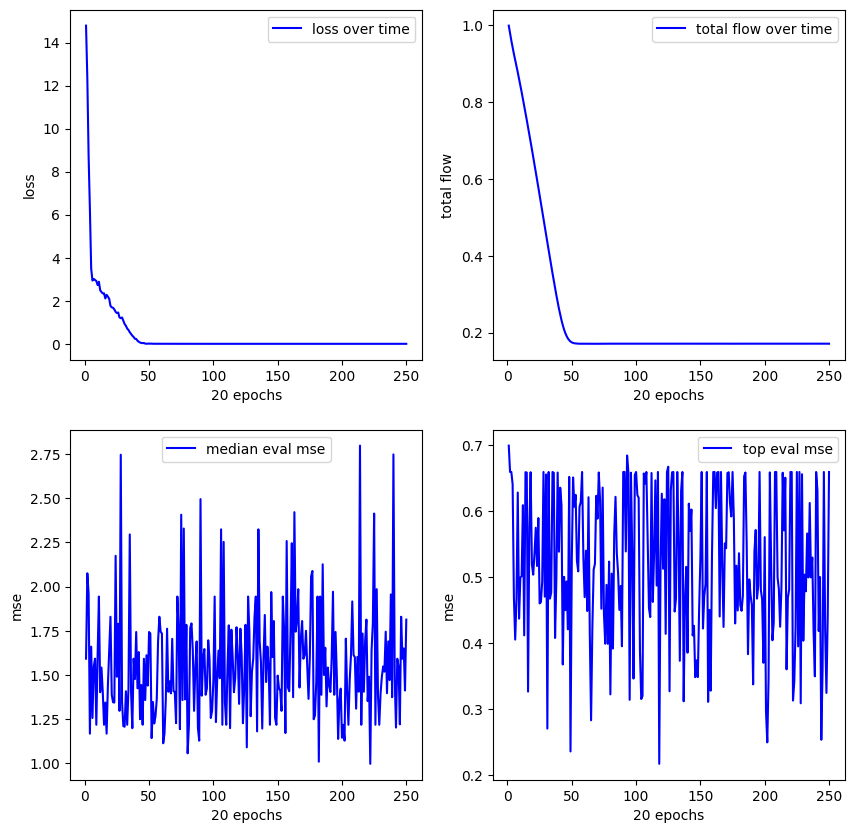

**************************************************
Experiment 18
training started with device cuda


15.710:   0%|          | 1/5000 [00:00<11:37,  7.16it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): inf/nan
exp(sqrt(x1))
expr: exp(sqrt(x1))


15.710:   0%|          | 16/5000 [00:00<04:54, 16.95it/s]


new best reward (vanilla): 0.18472230434417725
mse (pre/post optimized): 0.02380763553082943/0.0235558170825243
((x1) * (x1)) - (1.1)
expr: x1**2 - 1.1


15.710:   0%|          | 18/5000 [00:01<05:29, 15.10it/s]


new best reward (vanilla): 0.7186031341552734
mse (pre/post optimized): 0.006851188372820616/0.0019585348200052977
(0.06) - (cos(x1))
expr: 0.06 - cos(x1)


0.000: 100%|██████████| 5000/5000 [03:09<00:00, 26.33it/s]


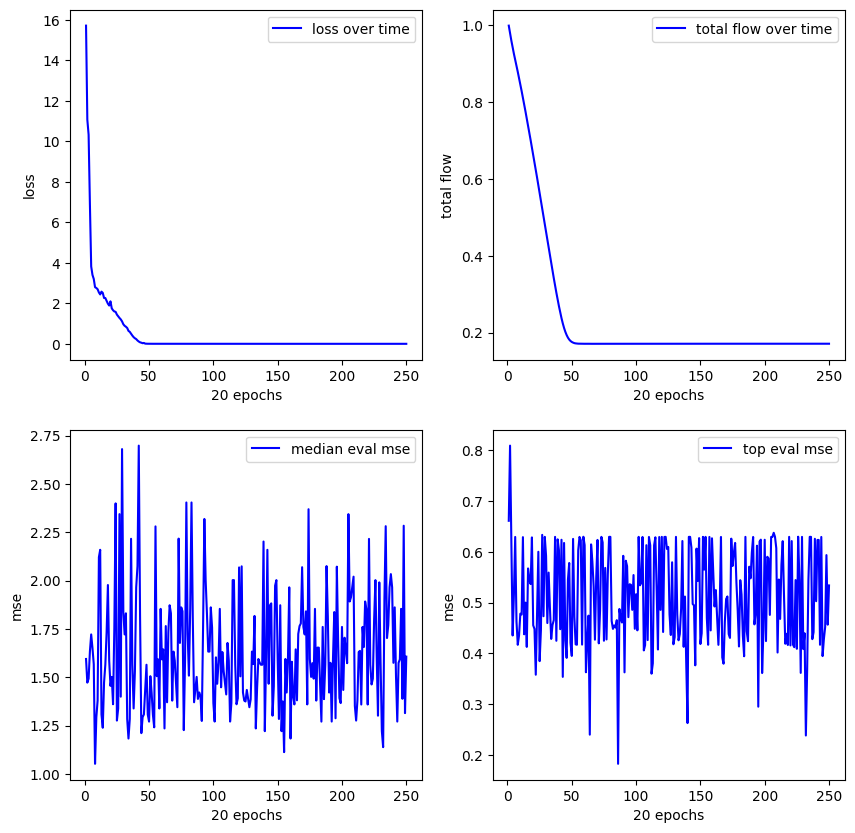

**************************************************
Experiment 19
training started with device cuda


16.645:   0%|          | 1/5000 [00:00<08:38,  9.64it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 2.270930767059326/2.270930767059326
sin(cos(x1))
expr: sin(cos(x1))


9.494:   1%|          | 31/5000 [00:01<02:59, 27.74it/s] 


new best reward (vanilla): 0.7942639589309692
mse (pre/post optimized): 0.005920849274843931/0.005920849274843931
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [03:06<00:00, 26.76it/s]


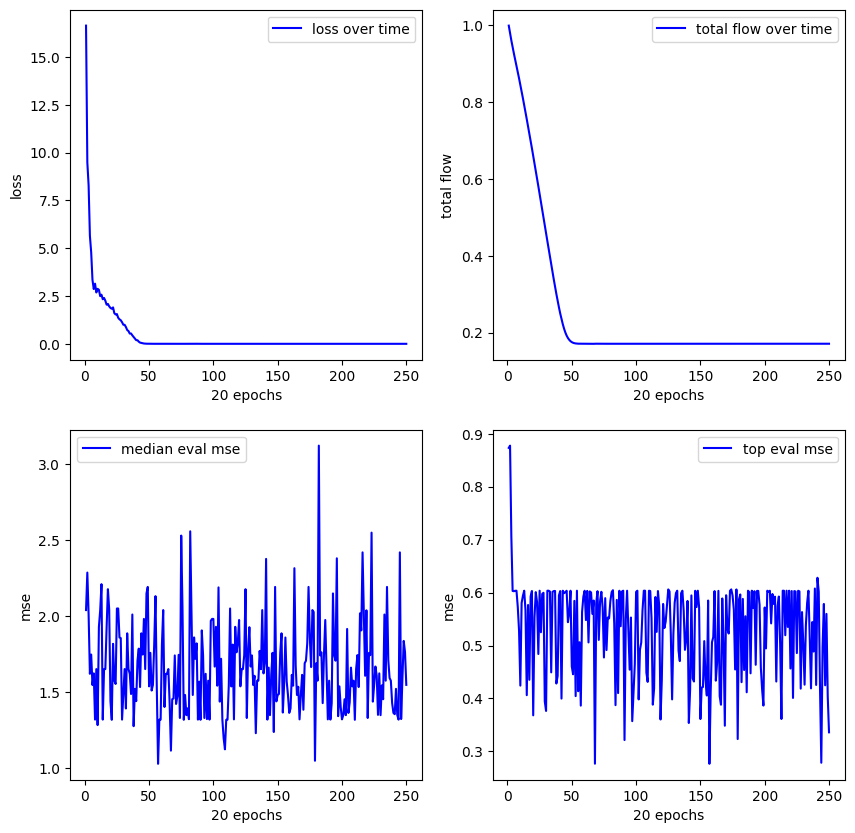

**************************************************
Experiment 20
training started with device cuda


11.878:   0%|          | 1/5000 [00:00<10:34,  7.88it/s]


new best reward (vanilla): 9.999999747378752e-05
mse (pre/post optimized): 5.752453804016113/3.560214042663574
((0.06) - (x1)) - ((x1) + (x1))
expr: 0.06 - 3*x1


8.394:   1%|          | 45/5000 [00:02<04:29, 18.41it/s] 


new best reward (vanilla): 0.7834681868553162
mse (pre/post optimized): 0.005870144348591566/0.005870144348591566
((x1) - (x1)) - (cos(x1))
expr: -cos(x1)


0.000: 100%|██████████| 5000/5000 [03:06<00:00, 26.83it/s]


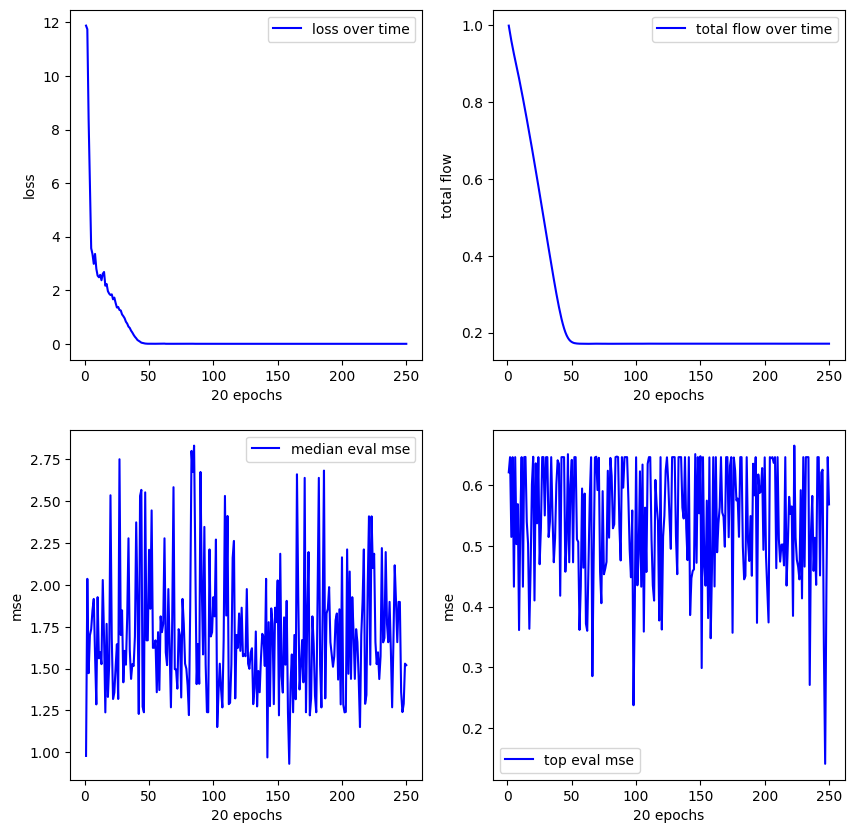

--------------------------------------------------
FUNCTION sin(x) + sin(x + x**2) Interval considered: [-1, 1]
**************************************************
Experiment 1
training started with device cuda


13.588:   0%|          | 1/5000 [00:00<15:29,  5.38it/s]


new best reward (vanilla): 0.8695284724235535
mse (pre/post optimized): 0.11826107650995255/0.2821560204029083
((x1) - (0.34)) * (exp(x1))
expr: (x1 - 0.34)*exp(x1)


0.000: 100%|██████████| 5000/5000 [03:09<00:00, 26.45it/s]


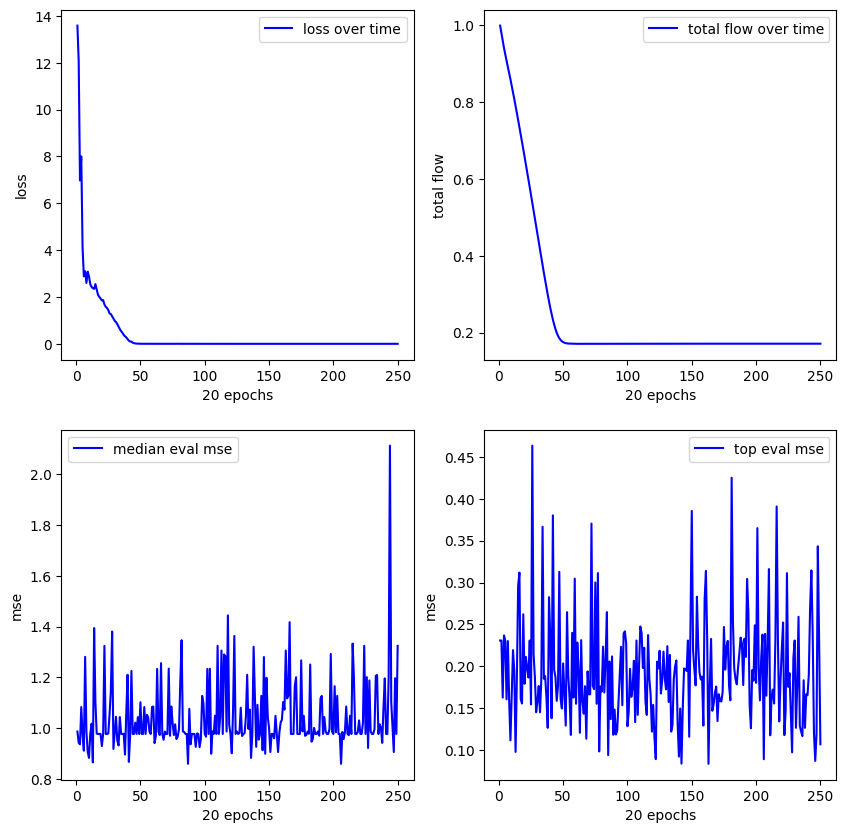

**************************************************
Experiment 2
training started with device cuda


15.130:   0%|          | 1/5000 [00:00<15:05,  5.52it/s]


new best reward (vanilla): 0.772327184677124
mse (pre/post optimized): 0.19751782715320587/0.19751782715320587
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [03:09<00:00, 26.39it/s]


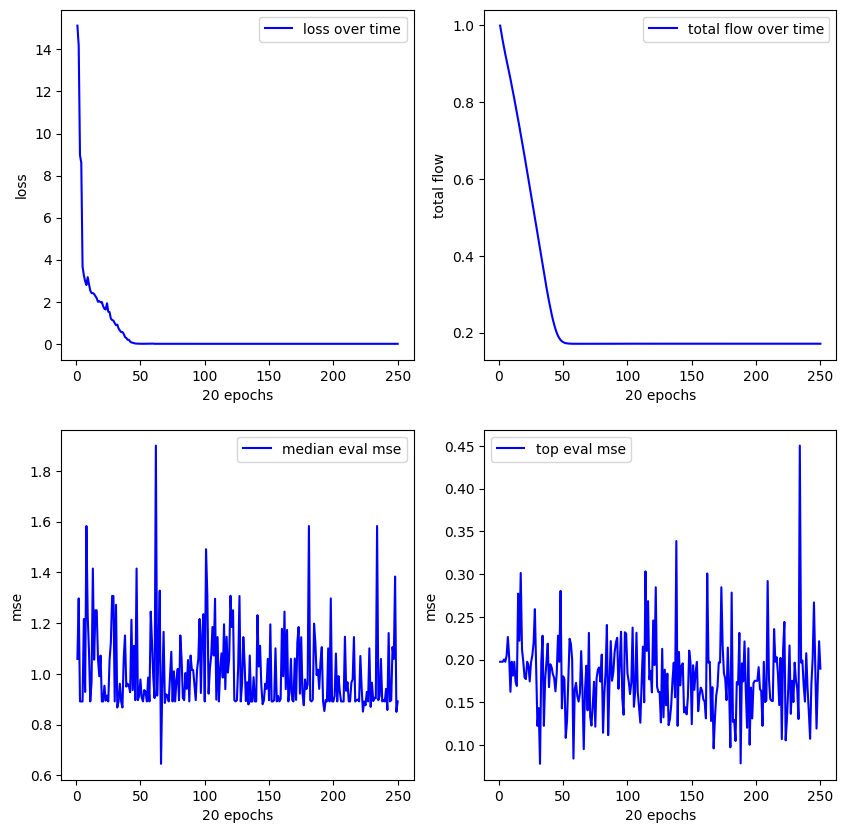

**************************************************
Experiment 3
training started with device cuda


13.148:   0%|          | 1/5000 [00:00<13:36,  6.12it/s]


new best reward (vanilla): 0.8283700942993164
mse (pre/post optimized): 0.15243853628635406/0.15243853628635406
(exp(x1)) - (cos(x1))
expr: exp(x1) - cos(x1)


0.000: 100%|██████████| 5000/5000 [03:10<00:00, 26.22it/s]


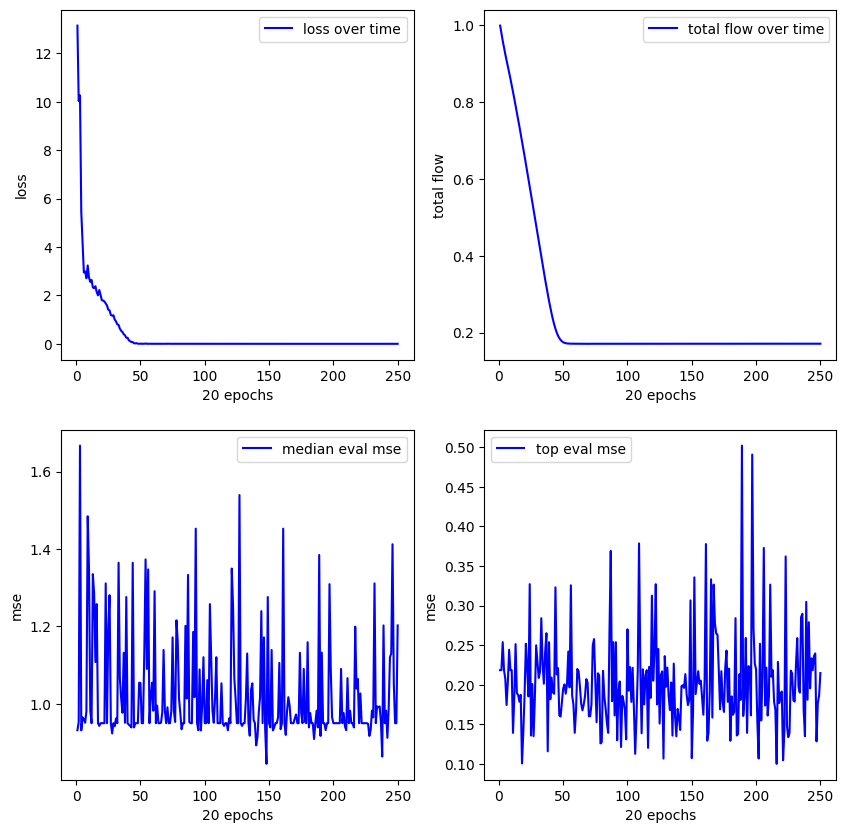

**************************************************
Experiment 4
training started with device cuda


11.659:   0%|          | 1/5000 [00:00<11:22,  7.32it/s]


new best reward (vanilla): 0.810032844543457
mse (pre/post optimized): 0.16549405455589294/0.16549405455589294
(x1) / (cos(x1))
expr: x1/cos(x1)


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.15it/s]


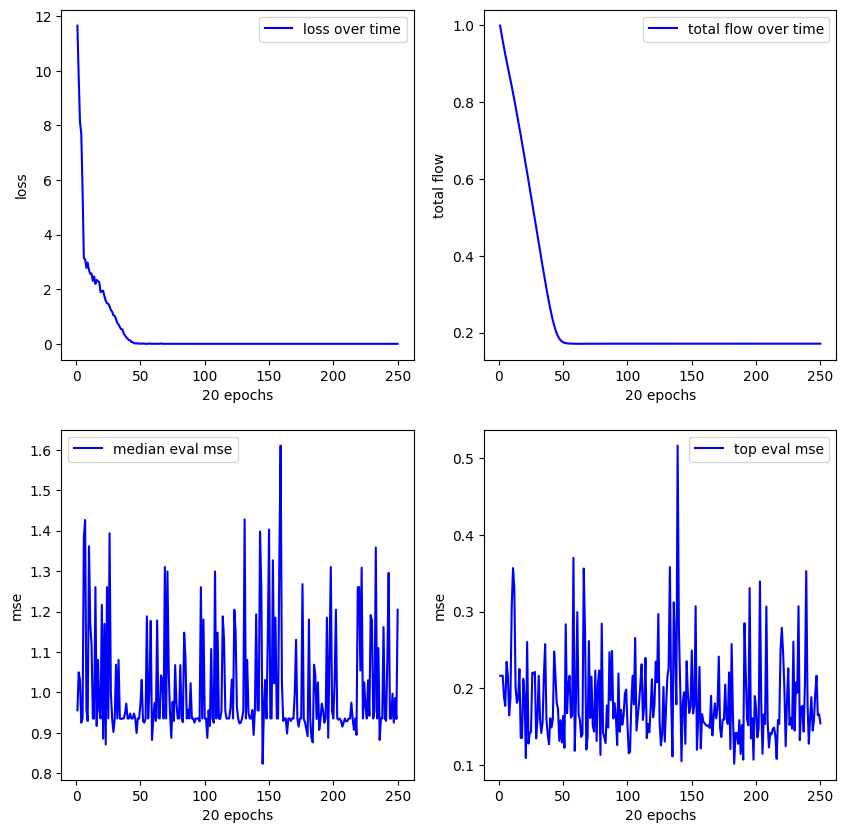

**************************************************
Experiment 5
training started with device cuda


15.250:   0%|          | 1/5000 [00:00<08:43,  9.56it/s]


new best reward (vanilla): 0.8950434327125549
mse (pre/post optimized): 0.09946959465742111/0.13780926167964935
((x1) / (0.33)) - (x1)
expr: 2.03030303030303*x1


0.000: 100%|██████████| 5000/5000 [03:08<00:00, 26.47it/s]


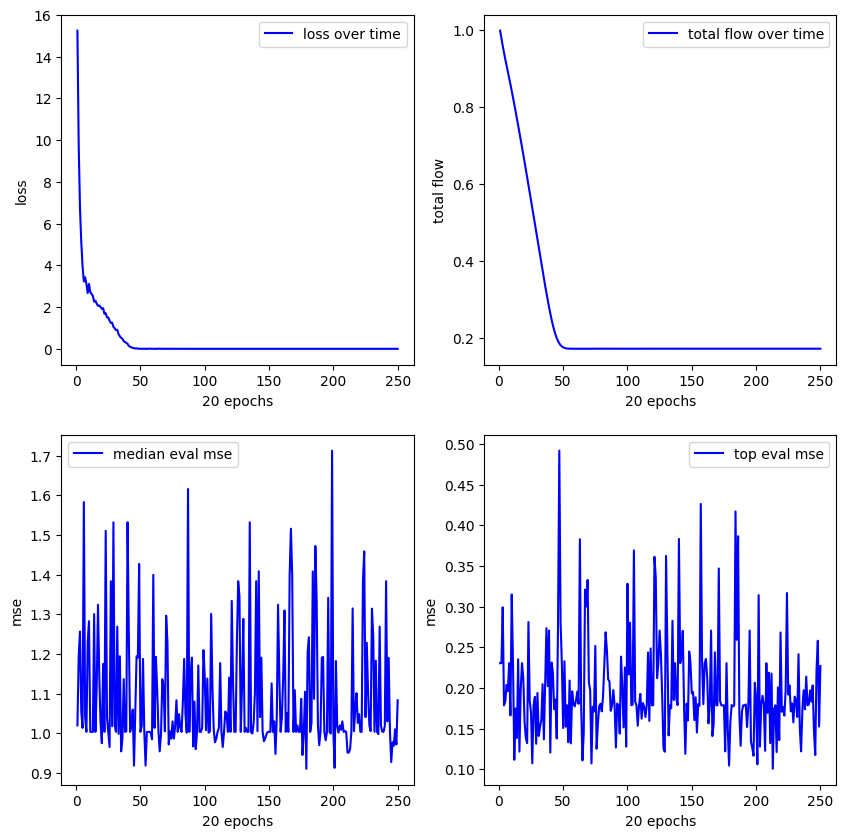

**************************************************
Experiment 6
training started with device cuda


17.271:   0%|          | 1/5000 [00:00<09:29,  8.78it/s]


new best reward (vanilla): 0.8531333208084106
mse (pre/post optimized): 0.13251453638076782/0.13251453638076782
(x1) * (exp(x1))
expr: x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.17it/s]


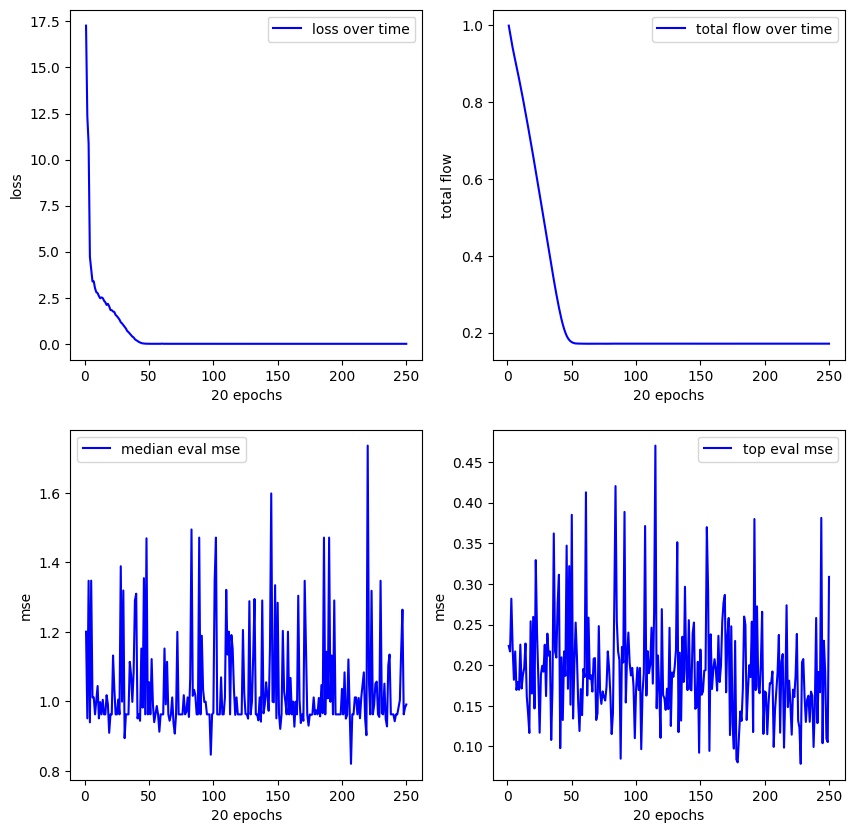

**************************************************
Experiment 7
training started with device cuda


13.258:   0%|          | 1/5000 [00:00<12:08,  6.86it/s]


new best reward (vanilla): 0.8794950246810913
mse (pre/post optimized): 0.11242992430925369/0.11242992430925369
(x1) + (sin(x1))
expr: x1 + sin(x1)


0.000: 100%|██████████| 5000/5000 [03:09<00:00, 26.41it/s]


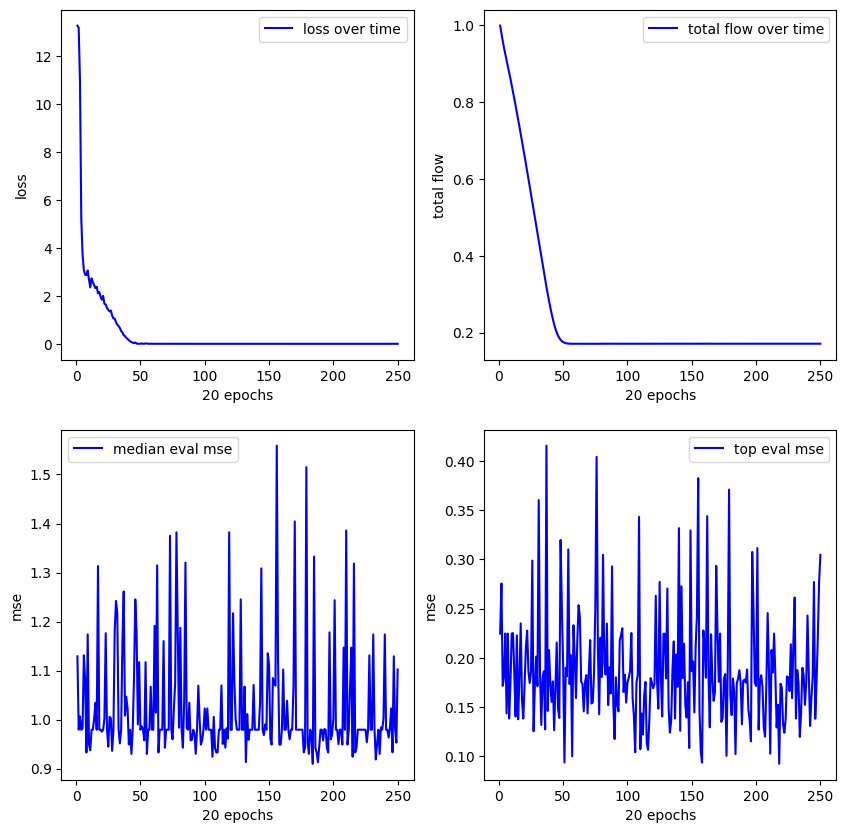

**************************************************
Experiment 8
training started with device cuda


12.775:   0%|          | 1/5000 [00:00<09:16,  8.99it/s]


new best reward (vanilla): 0.8891635537147522
mse (pre/post optimized): 0.11010510474443436/0.11010510474443436
(x1) + (sin(x1))
expr: x1 + sin(x1)


0.000: 100%|██████████| 5000/5000 [03:08<00:00, 26.48it/s]


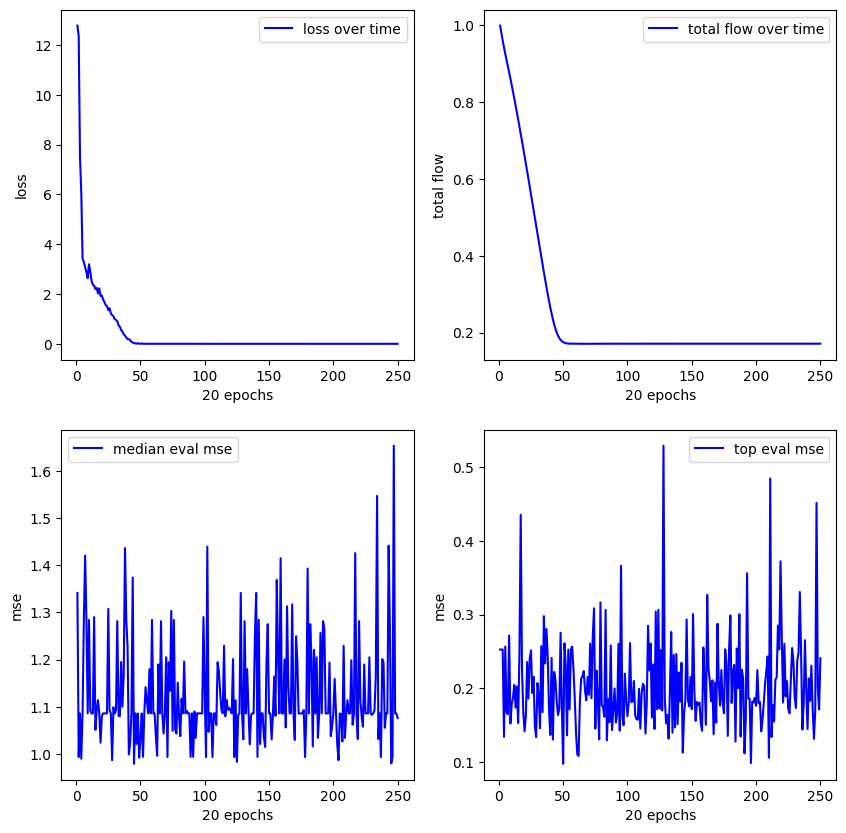

**************************************************
Experiment 9
training started with device cuda


13.355:   0%|          | 2/5000 [00:00<05:02, 16.53it/s]


new best reward (vanilla): 0.7887814044952393
mse (pre/post optimized): 0.18797501921653748/0.18797501921653748
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.07it/s]


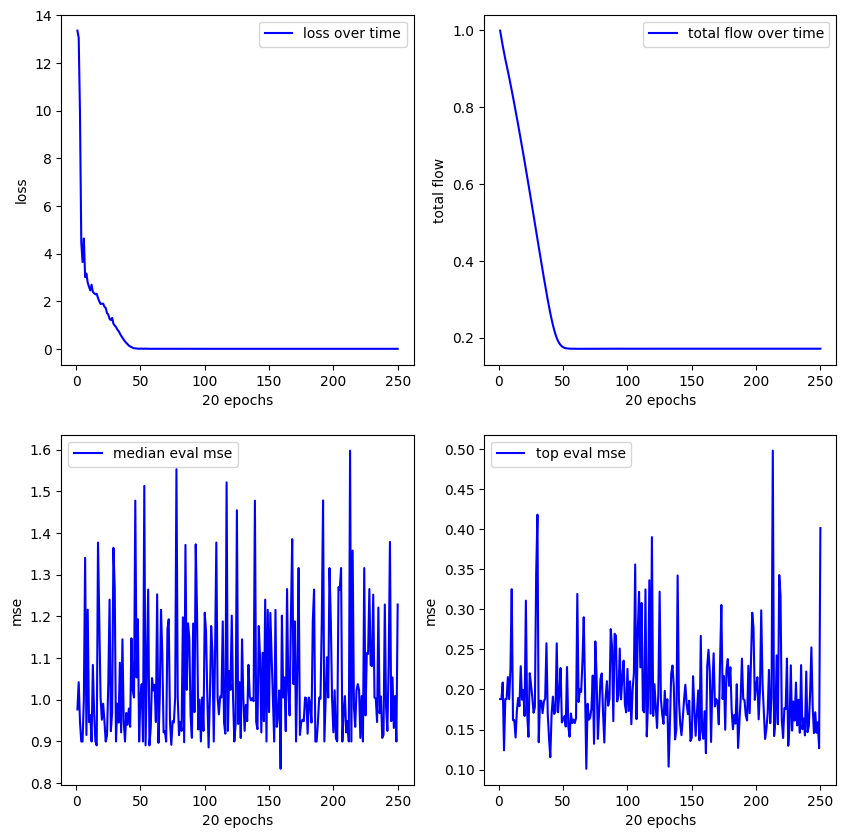

**************************************************
Experiment 10
training started with device cuda


14.409:   0%|          | 2/5000 [00:00<04:50, 17.22it/s]


new best reward (vanilla): 0.7599910497665405
mse (pre/post optimized): 0.20885610580444336/0.20885610580444336
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.16it/s]


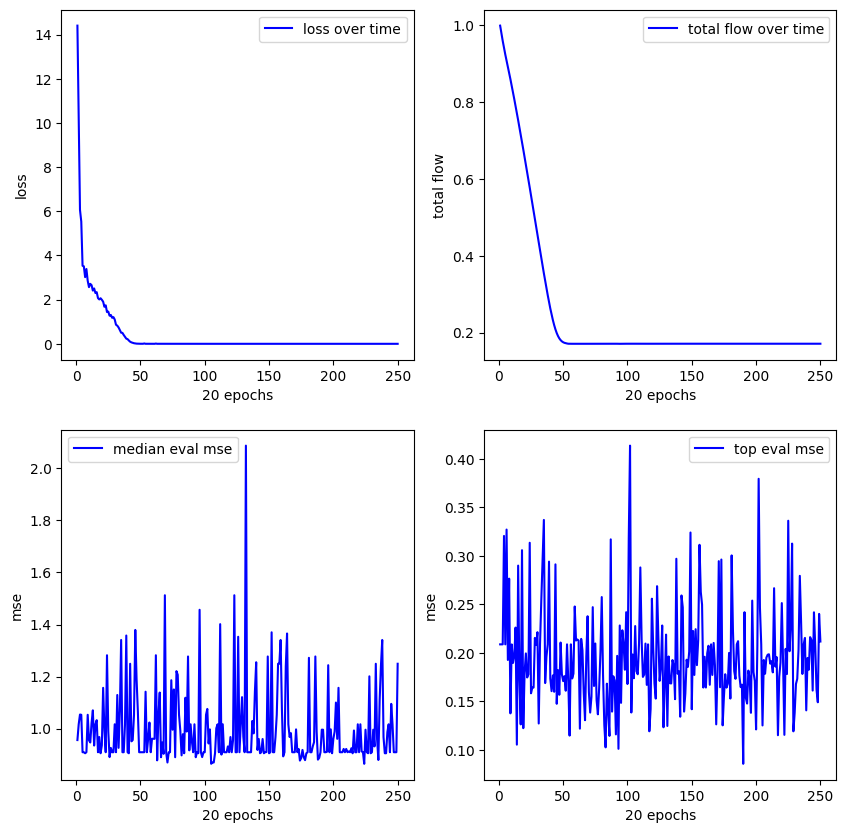

**************************************************
Experiment 11
training started with device cuda


13.897:   0%|          | 1/5000 [00:00<11:26,  7.28it/s]


new best reward (vanilla): 0.8259671330451965
mse (pre/post optimized): 0.1509246528148651/0.1509246528148651
(x1) / (cos(x1))
expr: x1/cos(x1)


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.13it/s]


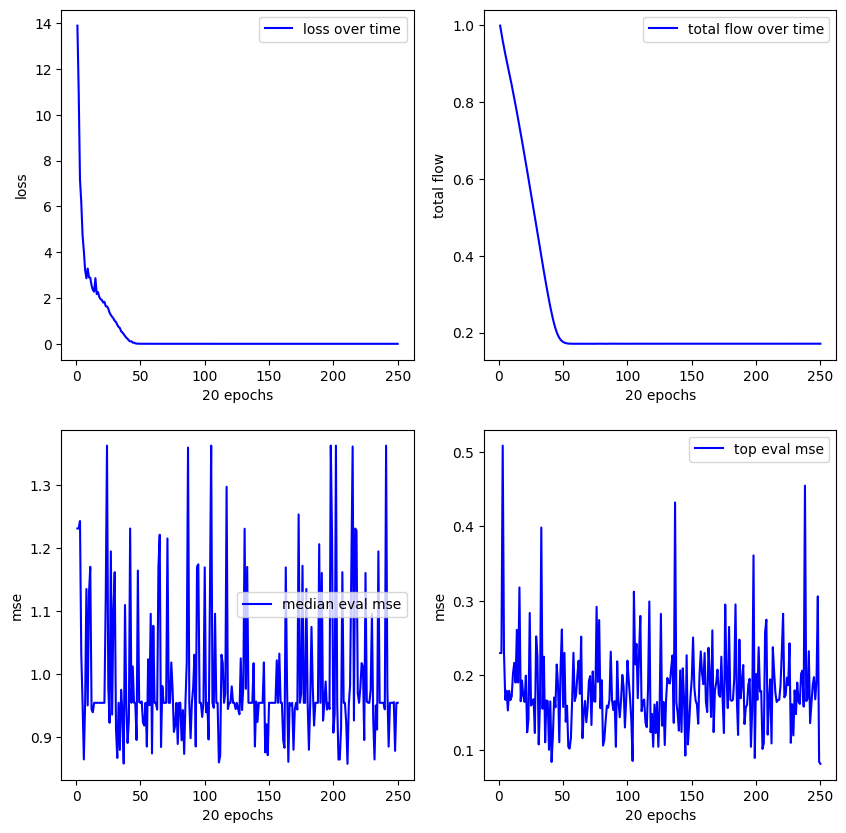

**************************************************
Experiment 12
training started with device cuda


12.312:   0%|          | 1/5000 [00:00<10:31,  7.92it/s]


new best reward (vanilla): 0.9077115058898926
mse (pre/post optimized): 0.08332932740449905/0.08205390721559525
(sin(x1)) + ((0.76) * (x1))
expr: 0.76*x1 + sin(x1)


0.000: 100%|██████████| 5000/5000 [03:10<00:00, 26.26it/s]


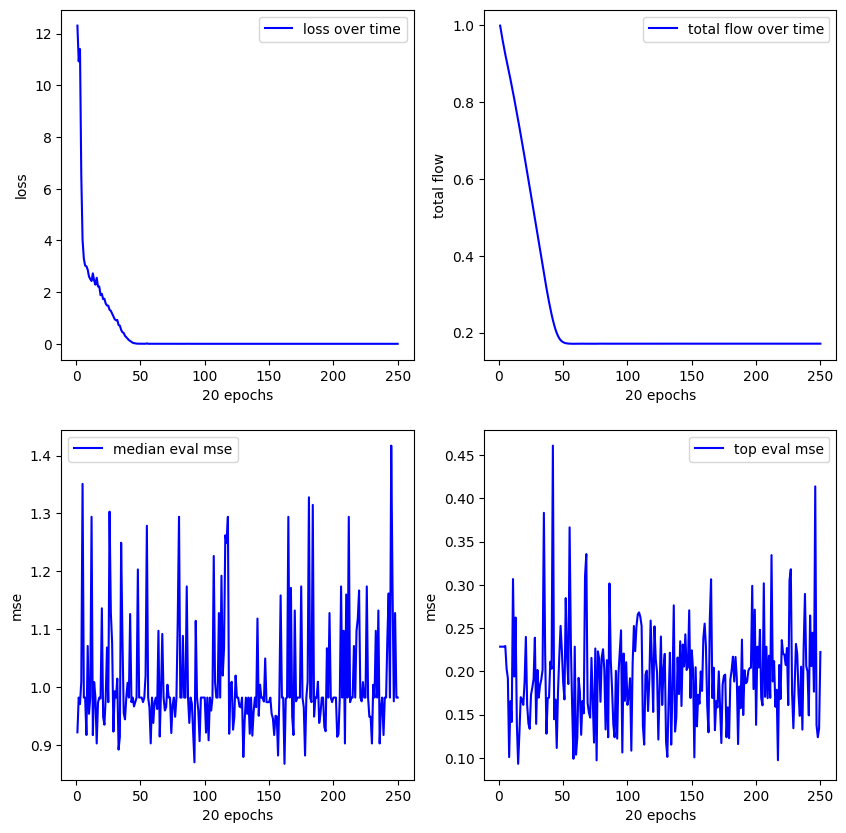

**************************************************
Experiment 13
training started with device cuda


13.395:   0%|          | 1/5000 [00:00<14:16,  5.83it/s]


new best reward (vanilla): 0.8364007472991943
mse (pre/post optimized): 0.15051880478858948/3.092404842376709
(exp(x1)) / ((0.34) / (x1))
expr: 2.94117647058824*x1*exp(x1)


0.000: 100%|██████████| 5000/5000 [03:08<00:00, 26.48it/s]


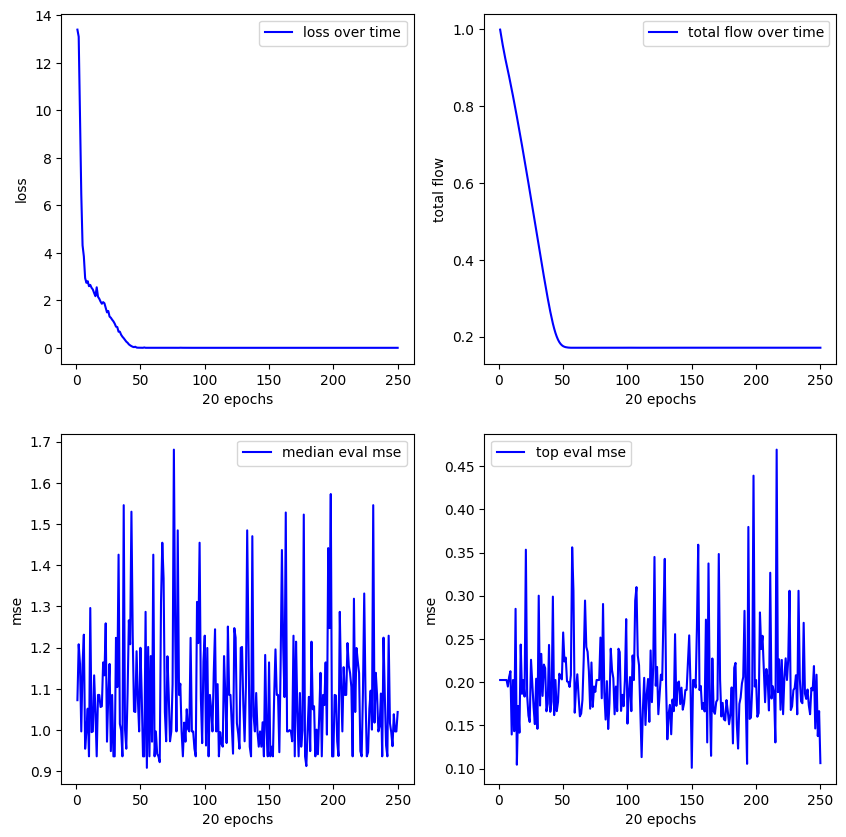

**************************************************
Experiment 14
training started with device cuda


14.618:   0%|          | 1/5000 [00:00<11:09,  7.47it/s]


new best reward (vanilla): 0.7611591815948486
mse (pre/post optimized): 0.21605825424194336/0.11053194105625153
sin((x1) / (0.5))
expr: sin(2.0*x1)


0.000: 100%|██████████| 5000/5000 [03:10<00:00, 26.25it/s]


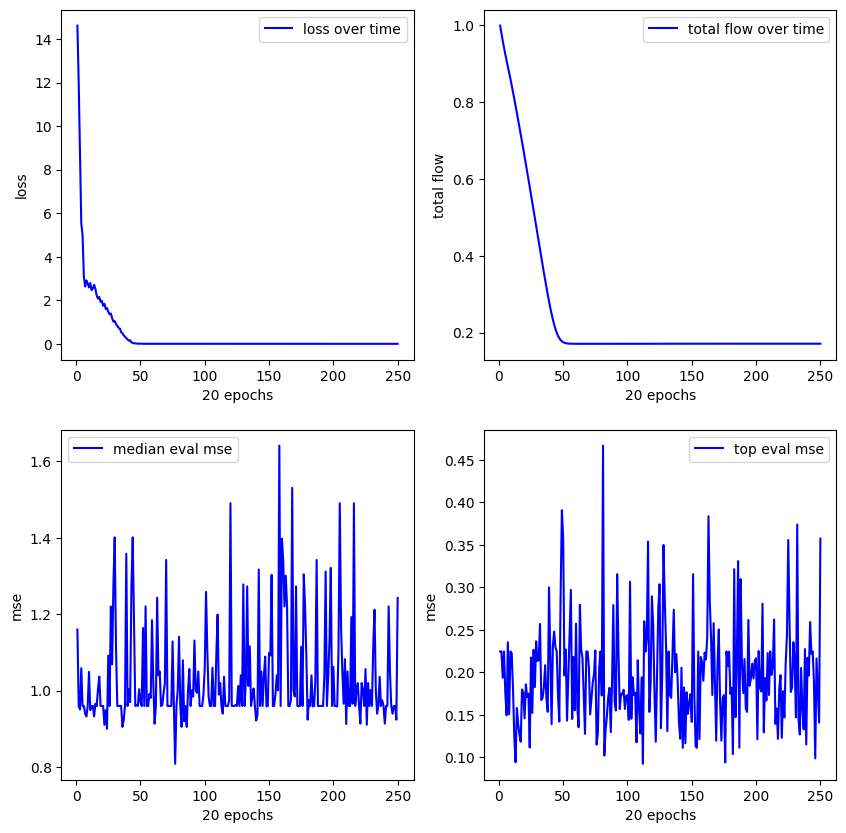

**************************************************
Experiment 15
training started with device cuda


15.420:   0%|          | 1/5000 [00:00<11:18,  7.37it/s]


new best reward (vanilla): 0.893444299697876
mse (pre/post optimized): 0.09441222995519638/0.09314356744289398
((0.19) + (x1)) / (cos(x1))
expr: (x1 + 0.19)/cos(x1)


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.16it/s]


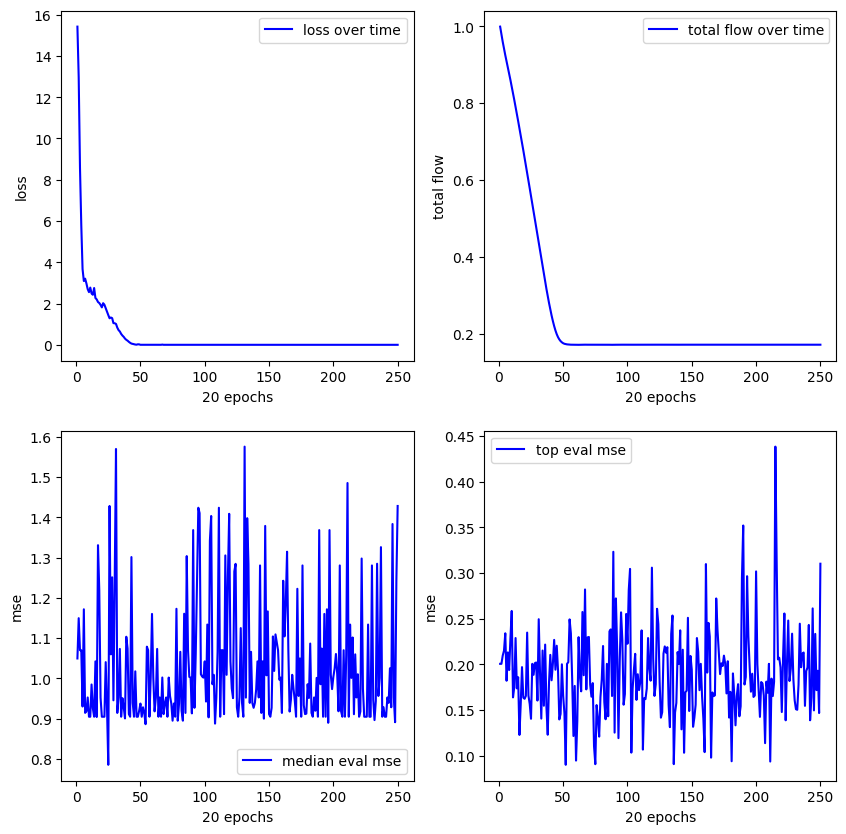

**************************************************
Experiment 16
training started with device cuda


10.546:   0%|          | 2/5000 [00:00<05:07, 16.26it/s]


new best reward (vanilla): 0.7441206574440002
mse (pre/post optimized): 0.22938093543052673/0.22938093543052673
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [03:08<00:00, 26.48it/s]


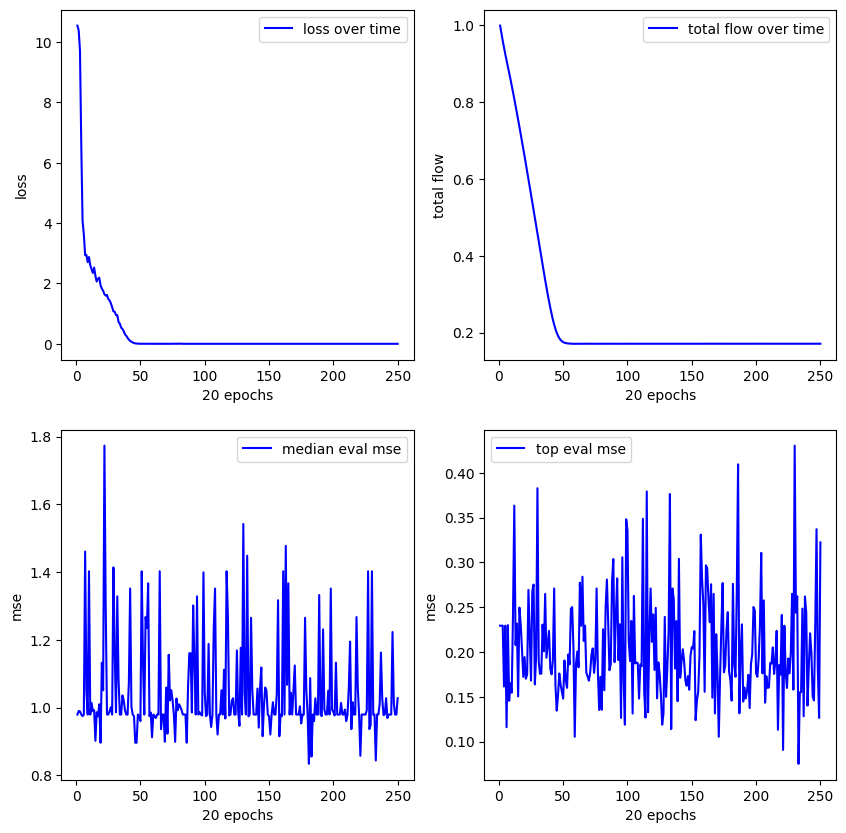

**************************************************
Experiment 17
training started with device cuda


15.500:   0%|          | 1/5000 [00:00<11:26,  7.28it/s]


new best reward (vanilla): 0.8736101388931274
mse (pre/post optimized): 0.11388938874006271/0.11388938874006271
sin((x1) + (x1))
expr: sin(2*x1)


0.000: 100%|██████████| 5000/5000 [03:09<00:00, 26.44it/s]


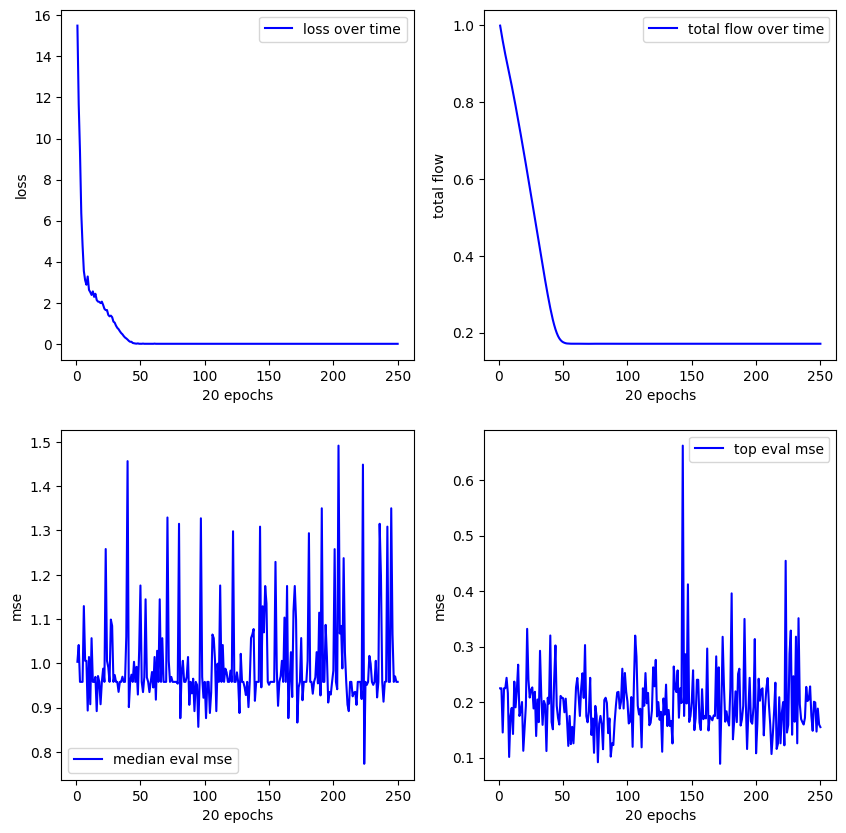

**************************************************
Experiment 18
training started with device cuda


12.824:   0%|          | 1/5000 [00:00<14:13,  5.86it/s]


new best reward (vanilla): 0.821191668510437
mse (pre/post optimized): 0.1526915431022644/0.21939551830291748
((x1) - (0.34)) + (square(x1))
expr: x1 + square(x1) - 0.34


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.12it/s]


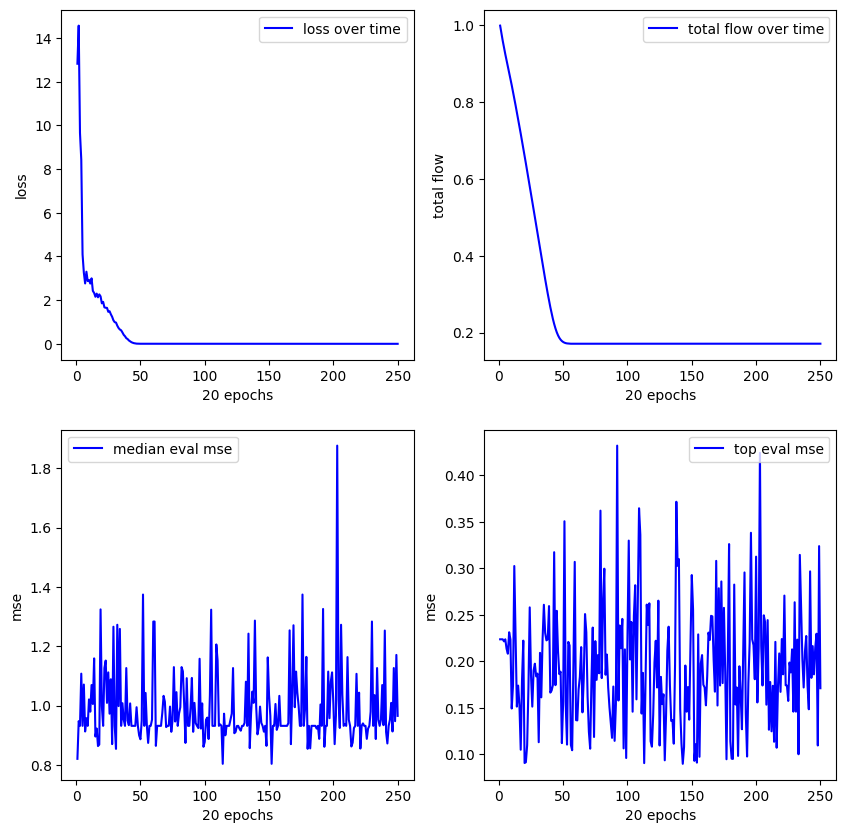

**************************************************
Experiment 19
training started with device cuda


17.611:   0%|          | 2/5000 [00:00<05:04, 16.43it/s]


new best reward (vanilla): 0.9094085693359375
mse (pre/post optimized): 0.07318788766860962/0.07318788766860962
((x1) + (x1)) * (cos(x1))
expr: 2*x1*cos(x1)


0.000: 100%|██████████| 5000/5000 [03:12<00:00, 25.96it/s]


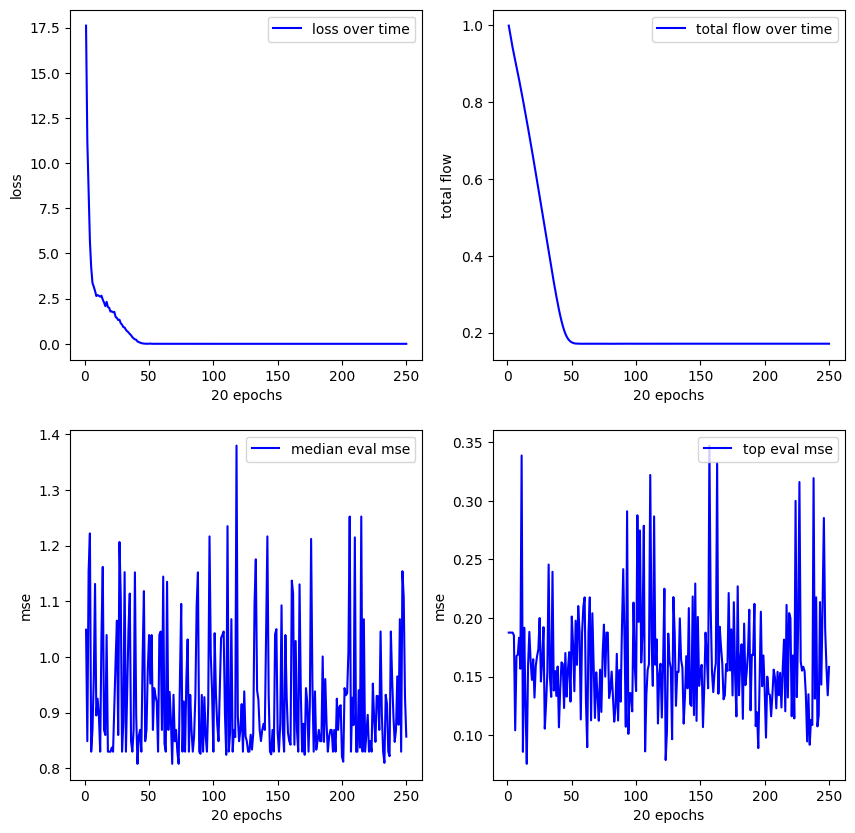

**************************************************
Experiment 20
training started with device cuda


14.149:   0%|          | 1/5000 [00:00<10:49,  7.69it/s]


new best reward (vanilla): 0.9365613460540771
mse (pre/post optimized): 0.062301259487867355/0.20228581130504608
((x1) / (0.43)) + (0.36)
expr: 2.32558139534884*x1 + 0.36


0.000: 100%|██████████| 5000/5000 [03:14<00:00, 25.68it/s]


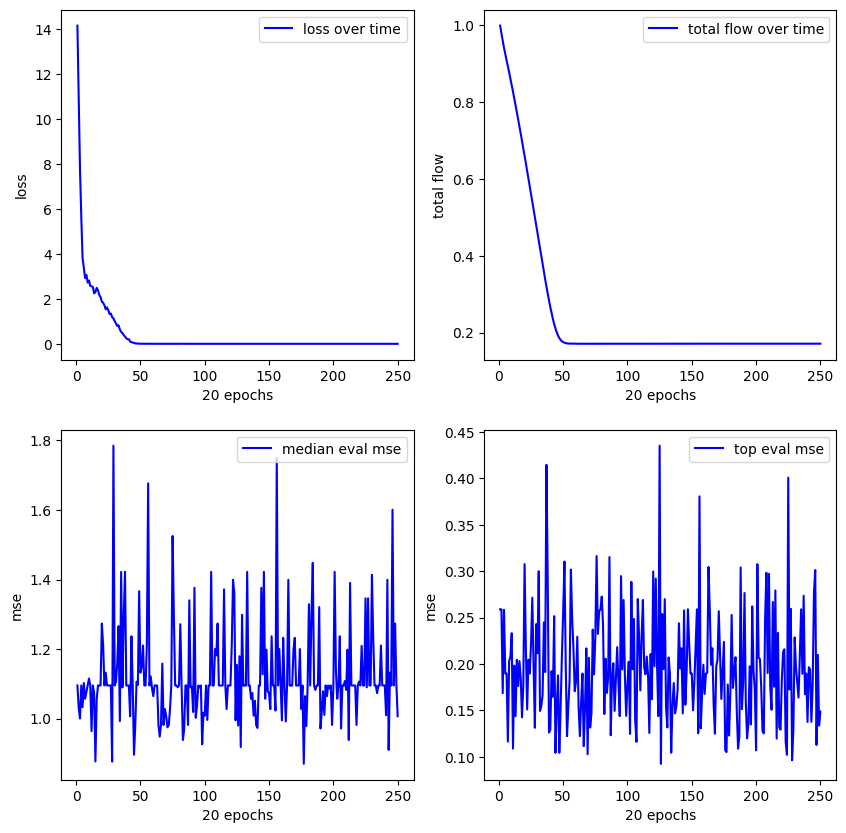

--------------------------------------------------
FUNCTION log(x + 1) + log(x**2 + 1) Interval considered: [0, 2]
**************************************************
Experiment 1
training started with device cuda


13.301:   0%|          | 1/5000 [00:00<12:09,  6.85it/s]


new best reward (vanilla): 0.7948368191719055
mse (pre/post optimized): 0.13977812230587006/0.02642734721302986
(sin(x1)) / ((0.68) / (x1))
expr: 1.47058823529412*x1*sin(x1)


13.301:   0%|          | 5/5000 [00:00<06:21, 13.08it/s]


new best reward (vanilla): 0.9795772433280945
mse (pre/post optimized): 0.0013240145053714514/0.0013240133412182331
((x1) / (0.37)) - ((x1) / (0.76))
expr: 1.38691322901849*x1


0.000: 100%|██████████| 5000/5000 [03:14<00:00, 25.72it/s]


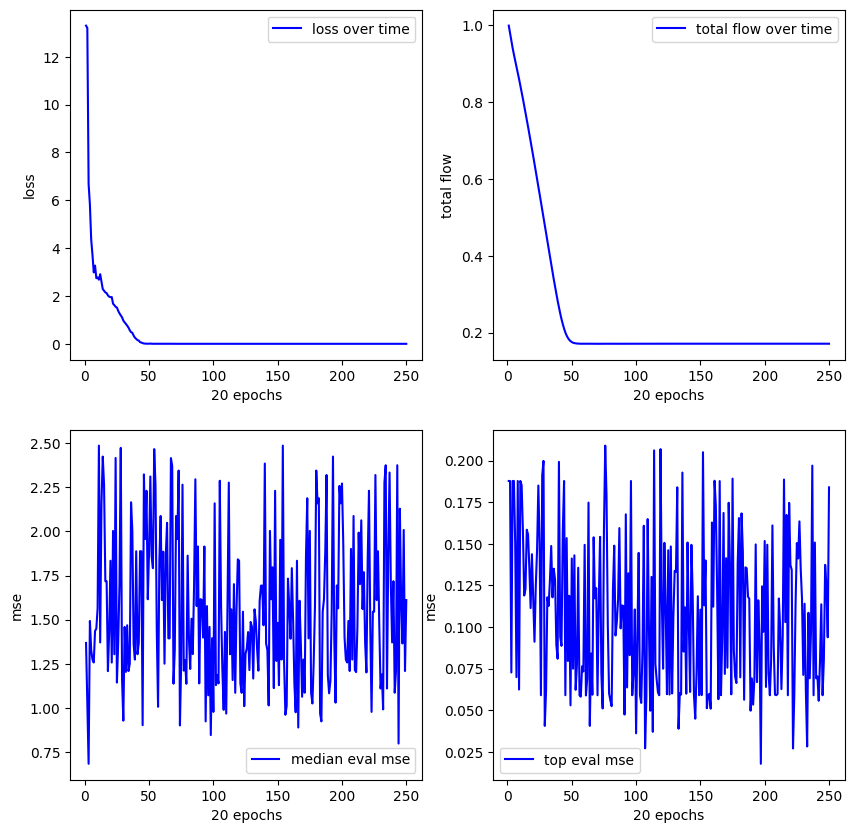

**************************************************
Experiment 2
training started with device cuda


15.814:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.9919008016586304
mse (pre/post optimized): 0.005017539486289024/0.005018264055252075
(sin(x1)) * ((0.67) + (x1))
expr: (x1 + 0.67)*sin(x1)


0.000: 100%|██████████| 5000/5000 [03:14<00:00, 25.74it/s]


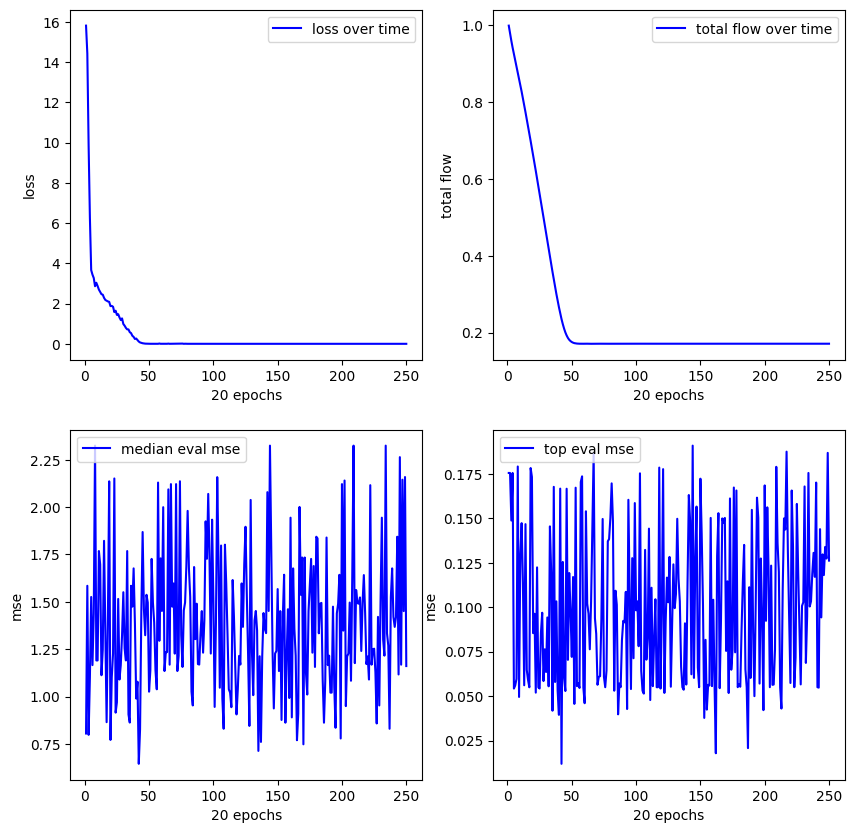

**************************************************
Experiment 3
training started with device cuda


13.292:   0%|          | 2/5000 [00:00<05:41, 14.65it/s]


new best reward (vanilla): 0.7130462527275085
mse (pre/post optimized): 0.19273369014263153/0.19273369014263153
x1
expr: x1

new best reward (vanilla): 0.7515808343887329
mse (pre/post optimized): 0.059776049107313156/0.0012542590266093612
((x1) / (0.3)) * (0.41)
expr: 1.36666666666667*x1


13.292:   0%|          | 7/5000 [00:00<05:02, 16.52it/s]


new best reward (vanilla): 0.9595624208450317
mse (pre/post optimized): 0.0012542566983029246/0.0012542558833956718
((1.15) * (x1)) + ((x1) * (0.23))
expr: 1.38*x1


0.000: 100%|██████████| 5000/5000 [03:12<00:00, 26.04it/s]


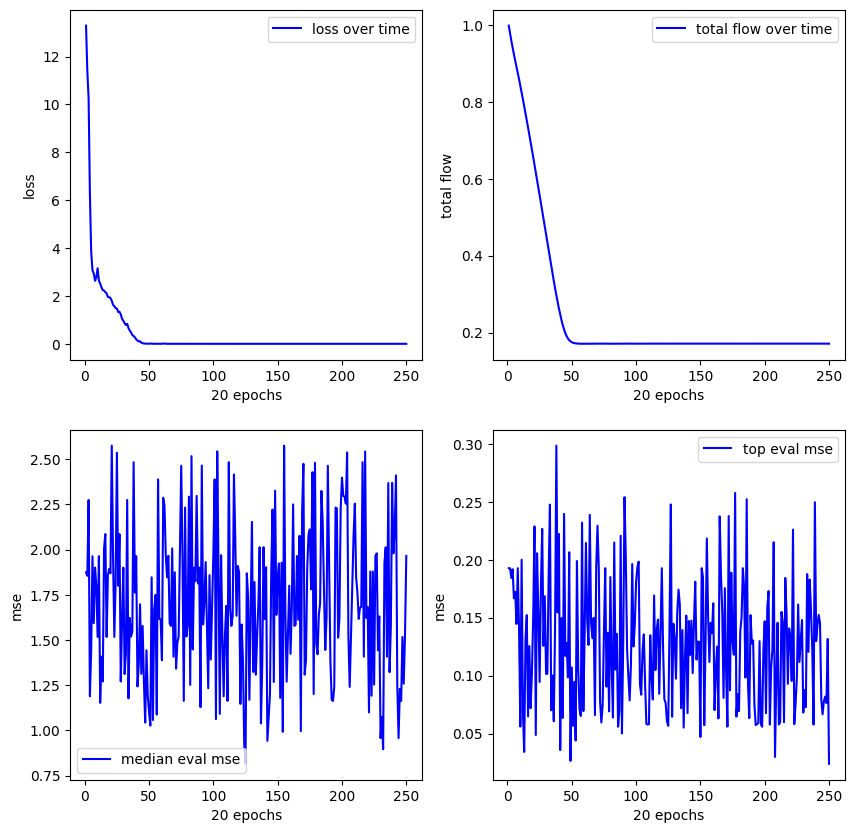

**************************************************
Experiment 4
training started with device cuda


15.360:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.785014271736145
mse (pre/post optimized): 0.14915242791175842/0.03772523254156113
(1.09) * ((x1) + (0.28))
expr: 1.09*x1 + 0.3052


15.360:   0%|          | 1/5000 [00:00<24:19,  3.43it/s]


new best reward (vanilla): 0.9931803345680237
mse (pre/post optimized): 0.0013885879889130592/0.0013885877560824156
((1.1) * (x1)) + ((x1) * (0.28))
expr: 1.38*x1


0.000: 100%|██████████| 5000/5000 [03:13<00:00, 25.80it/s]


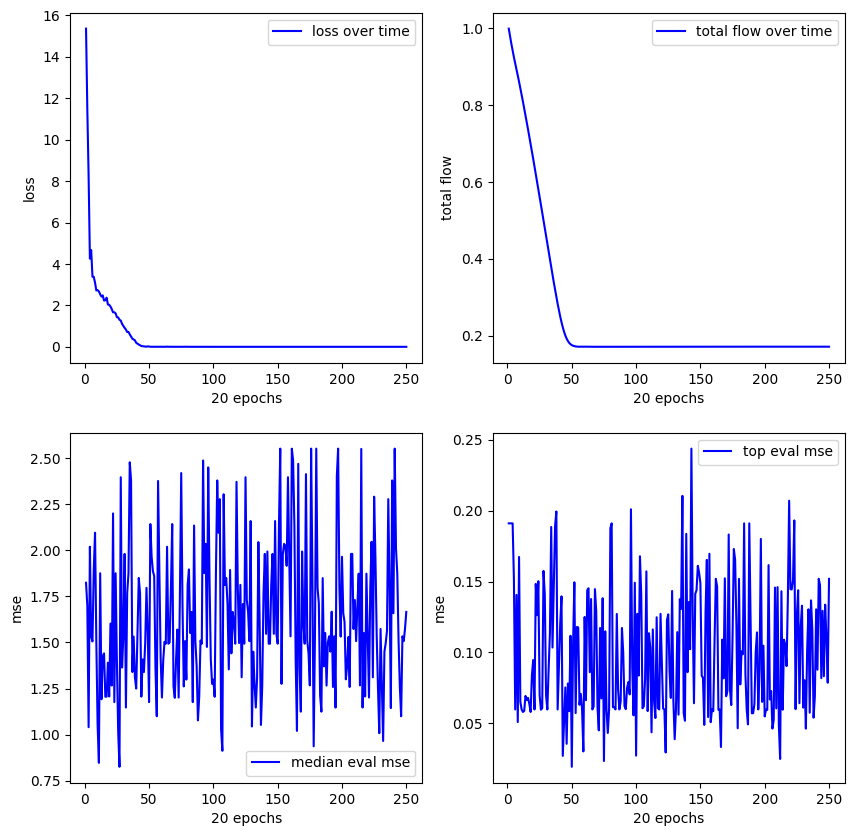

**************************************************
Experiment 5
training started with device cuda


13.453:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.7603296637535095
mse (pre/post optimized): 0.15349210798740387/0.14714594185352325
(0.87) * (square(x1))
expr: 0.87*square(x1)


13.453:   0%|          | 1/5000 [00:00<19:20,  4.31it/s]


new best reward (vanilla): 0.9346237182617188
mse (pre/post optimized): 0.013218161650002003/0.014135296456515789
(sqrt(x1)) - ((0.54) - (x1))
expr: sqrt(x1) + x1 - 0.54


0.000: 100%|██████████| 5000/5000 [03:13<00:00, 25.78it/s]


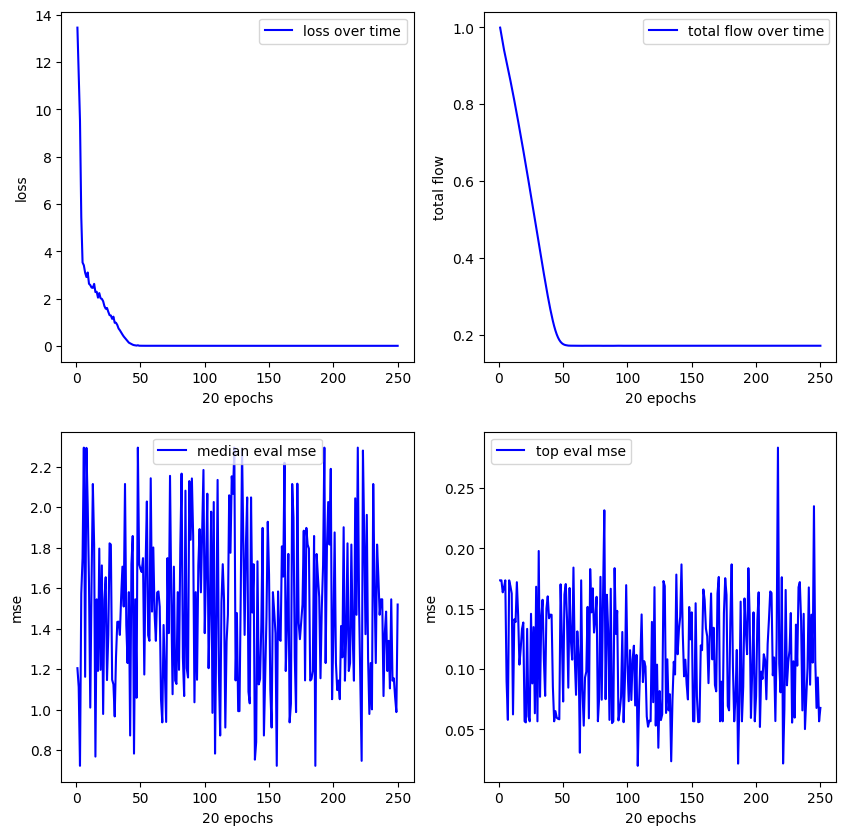

**************************************************
Experiment 6
training started with device cuda


12.059:   0%|          | 1/5000 [00:00<14:23,  5.79it/s]


new best reward (vanilla): 0.7889112234115601
mse (pre/post optimized): 0.12910181283950806/0.018358059227466583
((0.65) * (x1)) + ((x1) - (0.32))
expr: 1.65*x1 - 0.32

new best reward (vanilla): 0.8518282175064087
mse (pre/post optimized): 0.026278505101799965/0.0056800986640155315
((0.68) + (x1)) * (sin(x1))
expr: (x1 + 0.68)*sin(x1)


12.059:   0%|          | 4/5000 [00:00<08:13, 10.12it/s]


new best reward (vanilla): 0.9706106781959534
mse (pre/post optimized): 0.0012163009960204363/32.8218879699707
((x1) * (x1)) / ((x1) * (0.16))
expr: 6.25*x1


0.000: 100%|██████████| 5000/5000 [03:12<00:00, 25.92it/s]


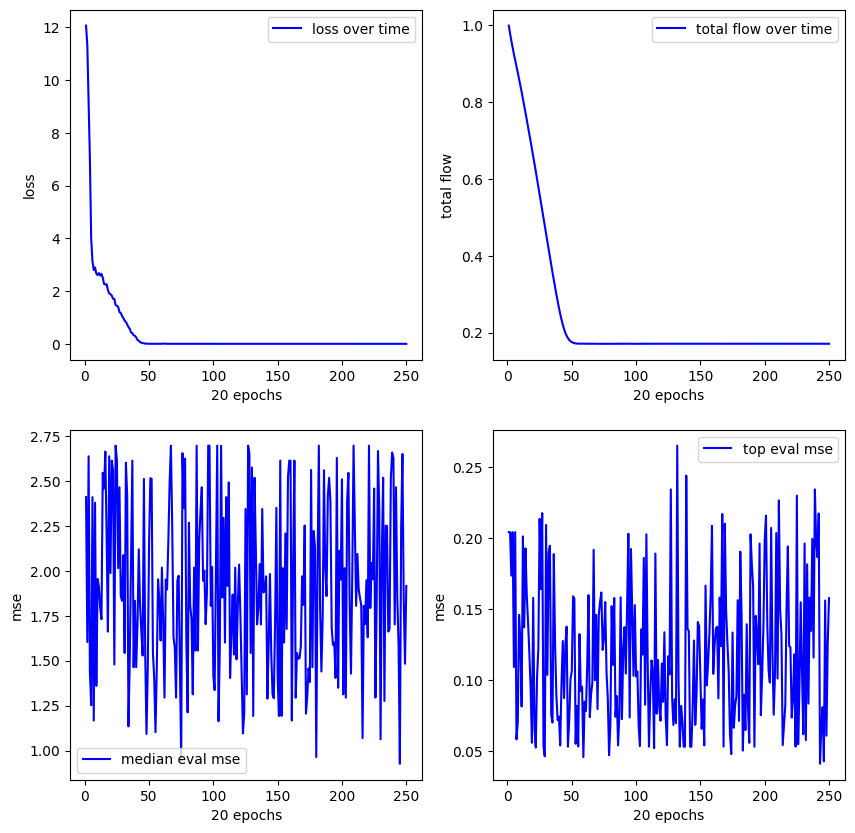

**************************************************
Experiment 7
training started with device cuda


  0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.9556976556777954
mse (pre/post optimized): 0.02970532327890396/2.219547986984253
(sin(x1)) / ((0.35) / (x1))
expr: 2.85714285714286*x1*sin(x1)


0.000: 100%|██████████| 5000/5000 [03:12<00:00, 26.03it/s]


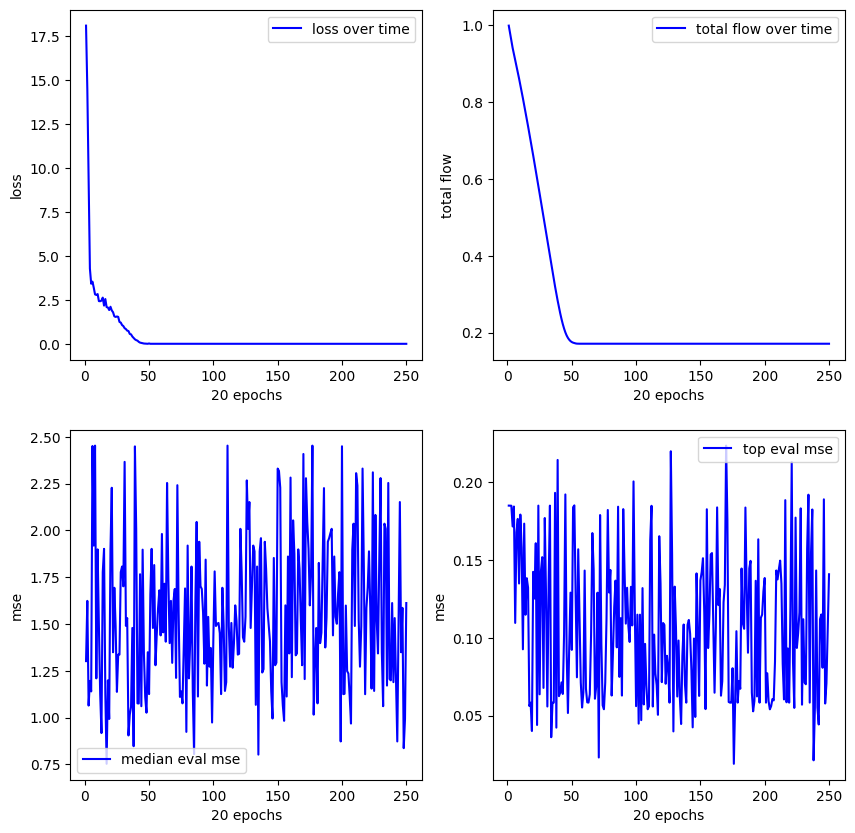

**************************************************
Experiment 8
training started with device cuda


11.383:   0%|          | 1/5000 [00:00<13:43,  6.07it/s]


new best reward (vanilla): 0.7509622573852539
mse (pre/post optimized): 0.17369835078716278/0.17369835078716278
x1
expr: x1

new best reward (vanilla): 0.9287676215171814
mse (pre/post optimized): 0.01610395312309265/0.07070901244878769
((-0.1) + (x1)) + (sin(x1))
expr: x1 + sin(x1) - 0.1


0.000: 100%|██████████| 5000/5000 [03:12<00:00, 26.04it/s]


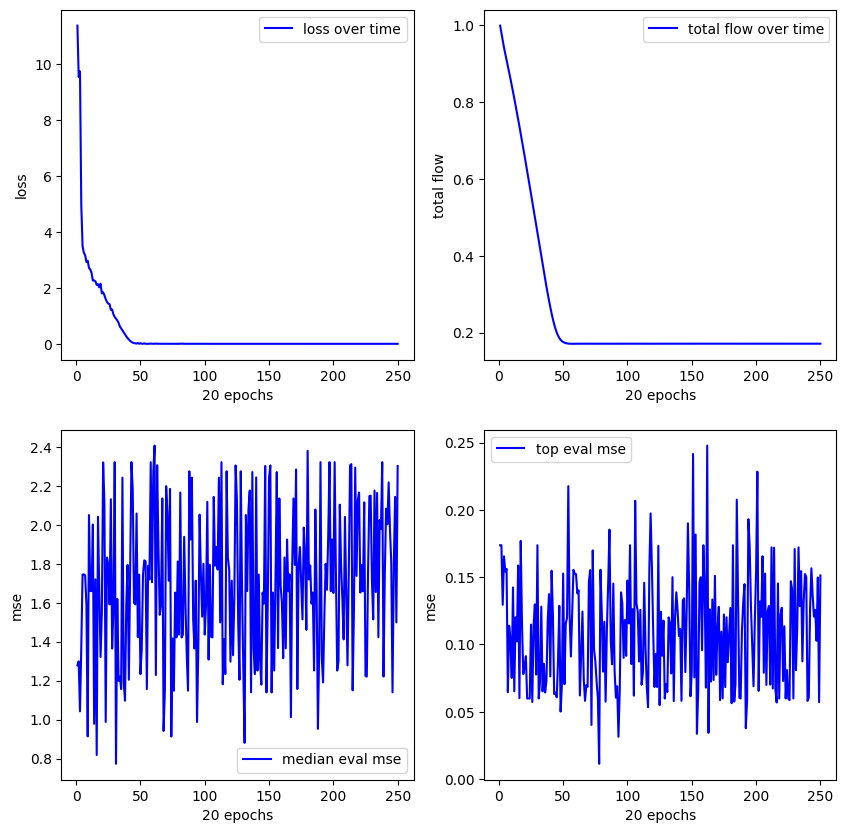

**************************************************
Experiment 9
training started with device cuda


15.398:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.7625703811645508
mse (pre/post optimized): 0.1495831459760666/0.05303356796503067
(sqrt(x1)) + ((0.51) * (x1))
expr: sqrt(x1) + 0.51*x1


15.398:   0%|          | 6/5000 [00:00<08:44,  9.51it/s]


new best reward (vanilla): 0.8205888271331787
mse (pre/post optimized): 0.005403510294854641/0.0771176740527153
(x1) - ((-0.12) * (x1))
expr: 1.12*x1


15.398:   0%|          | 10/5000 [00:01<09:21,  8.89it/s]


new best reward (vanilla): 0.8242422938346863
mse (pre/post optimized): 0.0013840869069099426/0.026527250185608864
((0.69) * (x1)) - ((0.36) - (x1))
expr: 1.69*x1 - 0.36


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.08it/s]


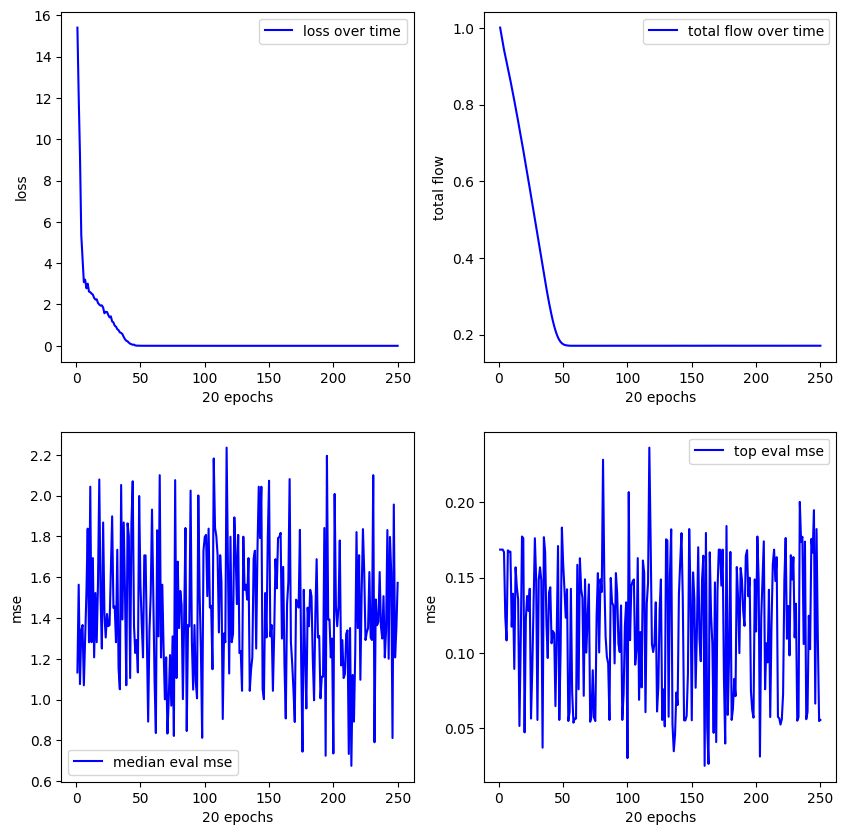

**************************************************
Experiment 10
training started with device cuda


  0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.946439802646637
mse (pre/post optimized): 0.03437933698296547/0.0496993362903595
((x1) / (0.46)) + ((0.36) - (x1))
expr: 1.17391304347826*x1 + 0.36


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.13it/s]


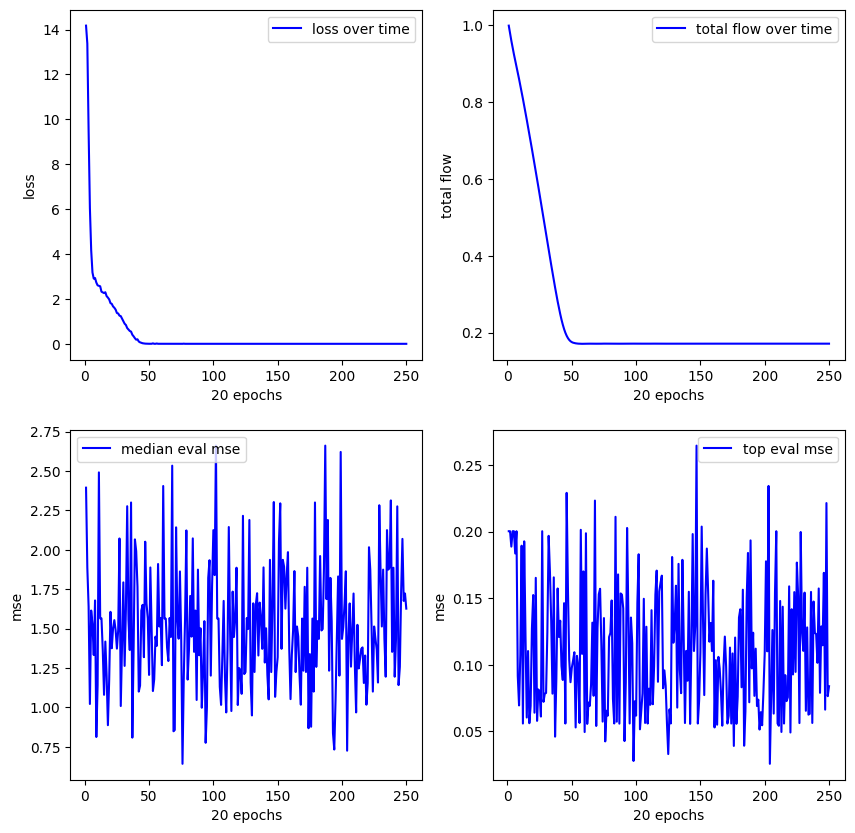

**************************************************
Experiment 11
training started with device cuda


16.753:   0%|          | 1/5000 [00:00<11:39,  7.14it/s]


new best reward (vanilla): 0.9972845911979675
mse (pre/post optimized): 0.0018402194837108254/0.00153130863327533
((x1) + (x1)) - ((0.63) * (x1))
expr: 1.37*x1


0.000: 100%|██████████| 5000/5000 [03:08<00:00, 26.51it/s]


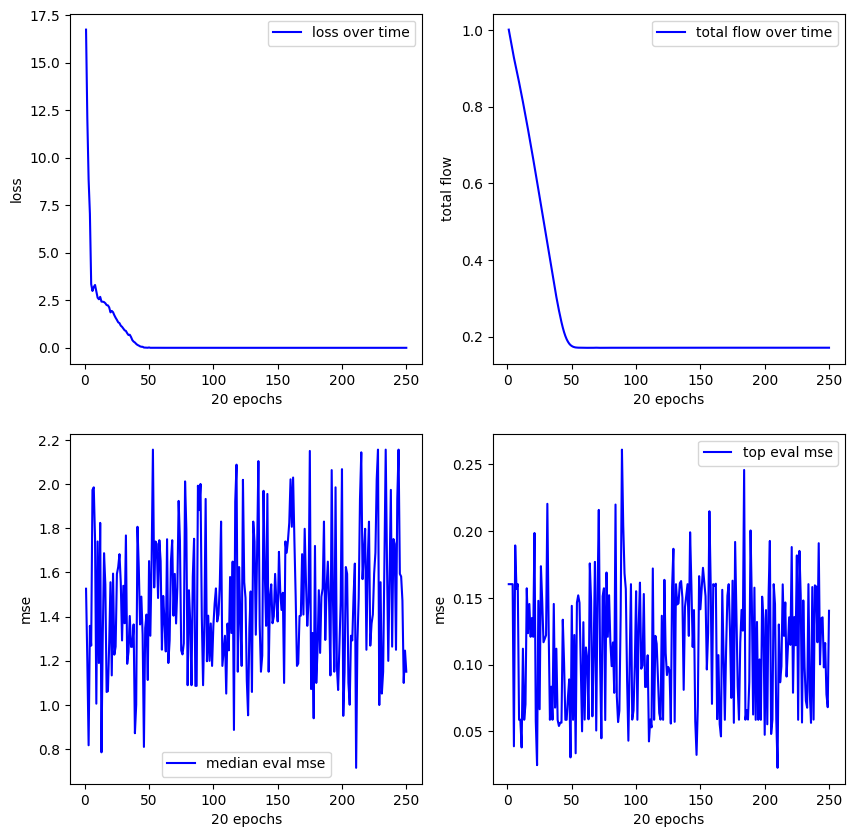

**************************************************
Experiment 12
training started with device cuda


14.777:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.9527075886726379
mse (pre/post optimized): 0.03014802746474743/0.030148034915328026
(sin(x1)) + ((0.73) * (x1))
expr: 0.73*x1 + sin(x1)


14.777:   0%|          | 1/5000 [00:00<18:49,  4.42it/s]


new best reward (vanilla): 0.9614942073822021
mse (pre/post optimized): 0.0034994613379240036/0.001194944721646607
((x1) * (0.18)) + ((x1) / (0.84))
expr: 1.37047619047619*x1


0.000: 100%|██████████| 5000/5000 [03:12<00:00, 25.99it/s]


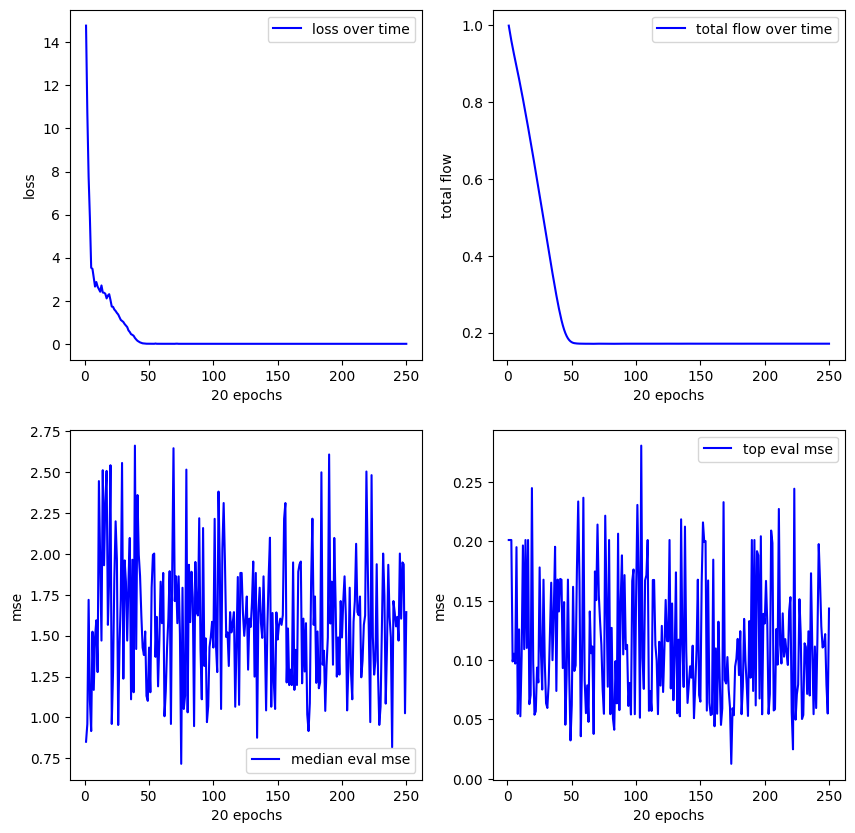

**************************************************
Experiment 13
training started with device cuda


12.327:   0%|          | 1/5000 [00:00<10:11,  8.17it/s]


new best reward (vanilla): 0.7073174715042114
mse (pre/post optimized): 0.18296968936920166/0.18296968936920166
square(x1)
expr: square(x1)

new best reward (vanilla): 0.7315801382064819
mse (pre/post optimized): 0.0609816275537014/0.05582783743739128
((x1) - (-0.06)) + (0.31)
expr: x1 + 0.37


12.327:   0%|          | 7/5000 [00:00<06:28, 12.85it/s]


new best reward (vanilla): 0.9518206119537354
mse (pre/post optimized): 0.001437064609490335/0.0014440587256103754
((x1) * (0.38)) + (x1)
expr: 1.38*x1


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.12it/s]


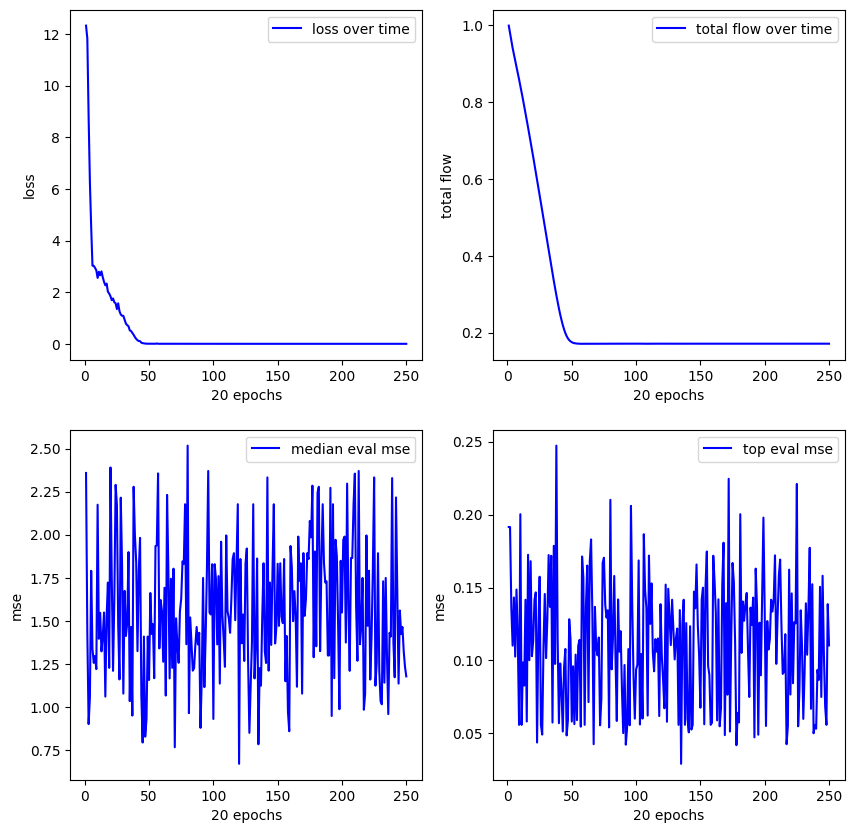

**************************************************
Experiment 14
training started with device cuda


16.628:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.9869776368141174
mse (pre/post optimized): 0.008115452714264393/0.15476073324680328
(0.71) * ((x1) + (0.96))
expr: 0.71*x1 + 0.6816


0.000: 100%|██████████| 5000/5000 [03:11<00:00, 26.05it/s]


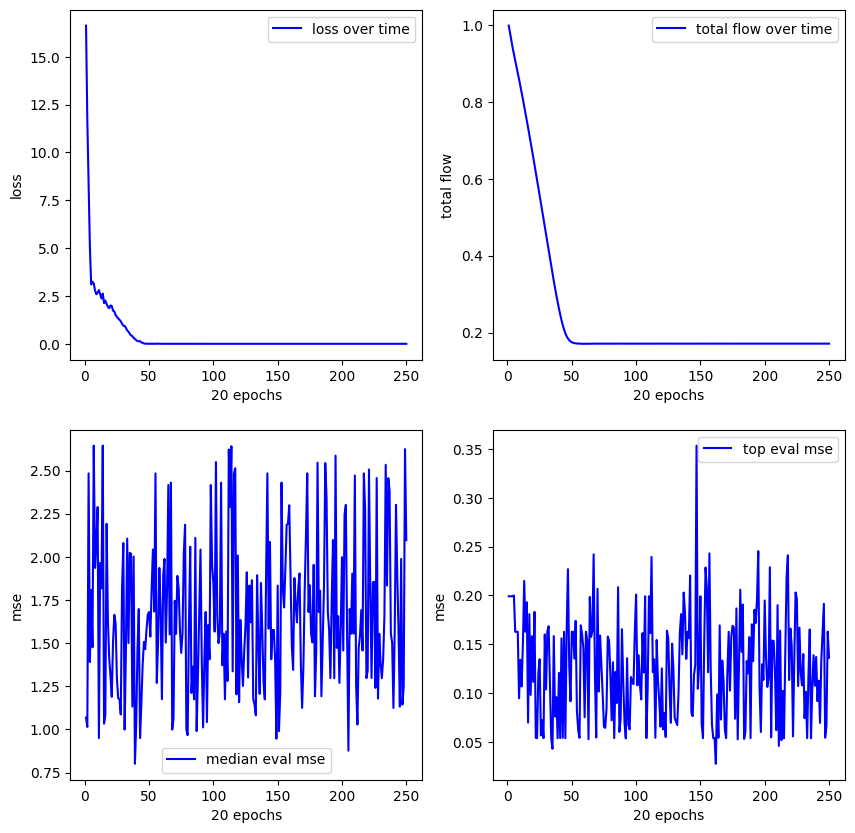

**************************************************
Experiment 15
training started with device cuda


15.194:   0%|          | 1/5000 [00:00<29:20,  2.84it/s]


new best reward (vanilla): 0.9349201917648315
mse (pre/post optimized): 0.045777883380651474/0.04578053578734398
exp((x1) - (0.86))
expr: 0.423162082317749*exp(x1)

new best reward (vanilla): 0.9873960018157959
mse (pre/post optimized): 0.0014058644883334637/0.001406166353262961
((0.68) * (x1)) / (0.49)
expr: 1.38775510204082*x1


0.000: 100%|██████████| 5000/5000 [03:13<00:00, 25.84it/s]


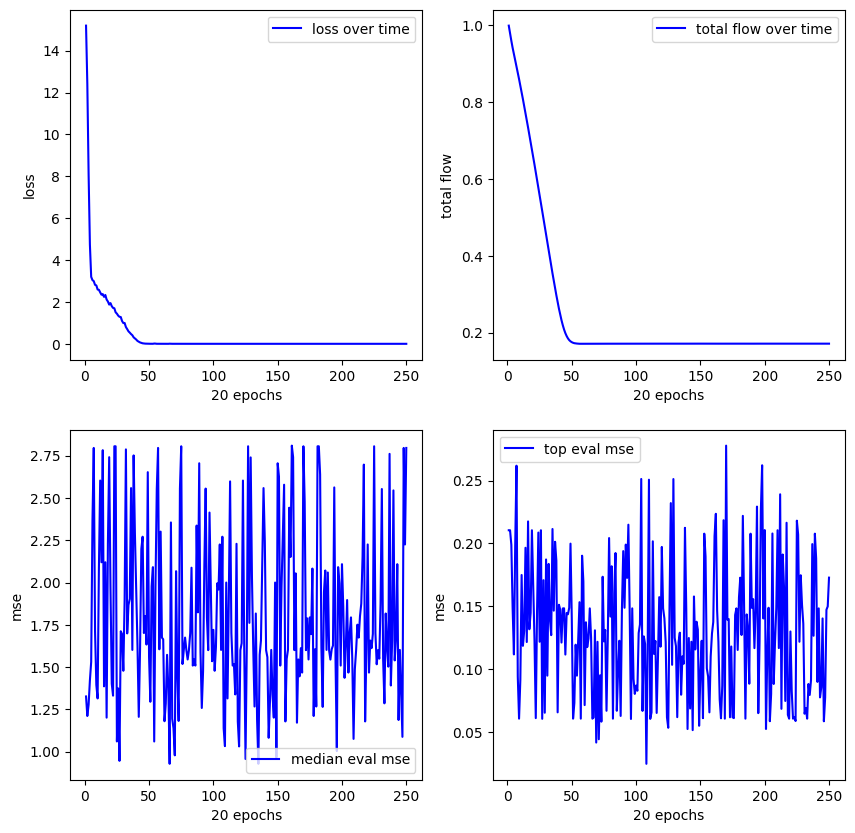

**************************************************
Experiment 16
training started with device cuda


17.756:   0%|          | 1/5000 [00:00<13:33,  6.15it/s]


new best reward (vanilla): 0.9282970428466797
mse (pre/post optimized): 0.04901014640927315/0.24684776365756989
(sqrt(x1)) * ((0.8) * (x1))
expr: 0.8*x1**(3/2)


17.756:   0%|          | 7/5000 [00:00<05:49, 14.27it/s]


new best reward (vanilla): 0.9567795395851135
mse (pre/post optimized): 0.0013186478754505515/0.001376279047690332
((0.58) * (x1)) / (0.42)
expr: 1.38095238095238*x1


0.000: 100%|██████████| 5000/5000 [03:09<00:00, 26.42it/s]


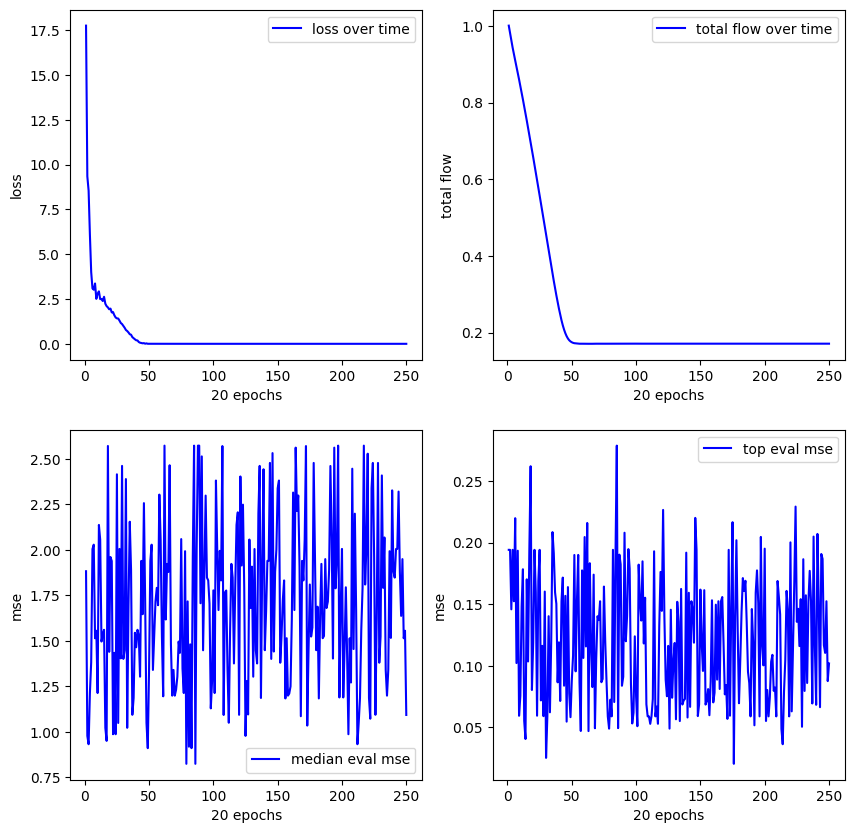

**************************************************
Experiment 17
training started with device cuda


16.694:   0%|          | 1/5000 [00:00<15:46,  5.28it/s]


new best reward (vanilla): 0.9471250772476196
mse (pre/post optimized): 0.034058067947626114/0.010648506693542004
(sin(x1)) + ((x1) - (0.35))
expr: x1 + sin(x1) - 0.35


16.694:   0%|          | 5/5000 [00:00<08:49,  9.44it/s]


new best reward (vanilla): 0.9865420460700989
mse (pre/post optimized): 0.000757373811211437/0.07995171844959259
(0.41) + ((x1) / (0.81))
expr: 1.23456790123457*x1 + 0.41


0.000: 100%|██████████| 5000/5000 [03:14<00:00, 25.69it/s]


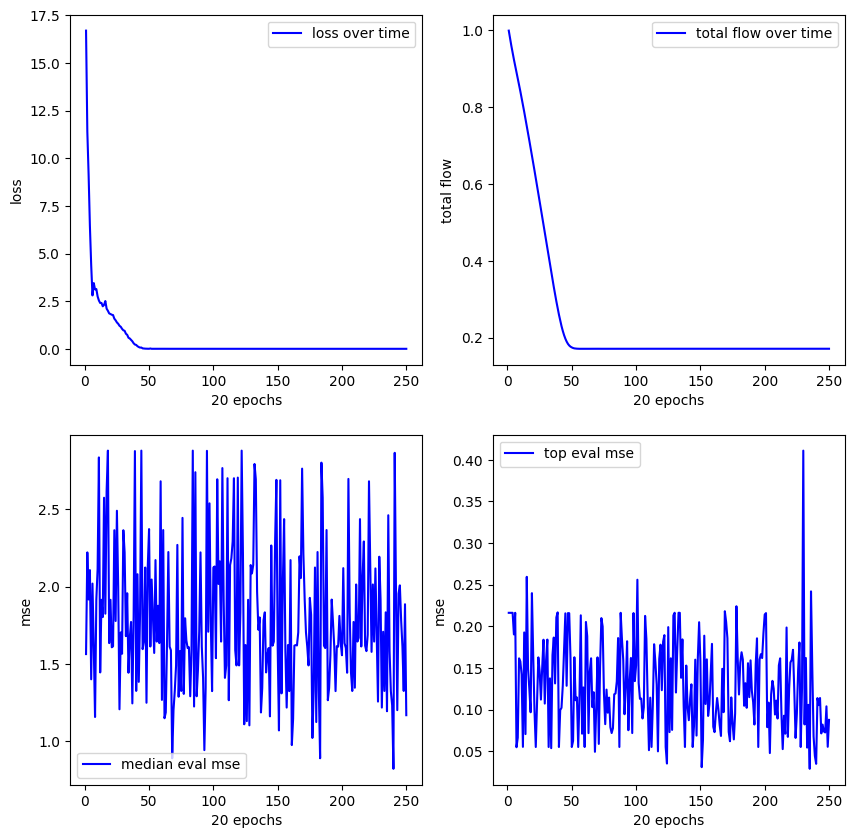

**************************************************
Experiment 18
training started with device cuda


17.292:   0%|          | 1/5000 [00:00<13:21,  6.24it/s]


new best reward (vanilla): 0.9627500176429749
mse (pre/post optimized): 0.024668574333190918/0.2962188720703125
((x1) - (0.3)) * (sqrt(x1))
expr: sqrt(x1)*(x1 - 0.3)


17.292:   0%|          | 9/5000 [00:00<06:46, 12.29it/s]


new best reward (vanilla): 0.9773909449577332
mse (pre/post optimized): 0.0007191917393356562/0.015153398737311363
((0.59) * (x1)) + ((x1) - (0.28))
expr: 1.59*x1 - 0.28


0.000: 100%|██████████| 5000/5000 [03:14<00:00, 25.65it/s]


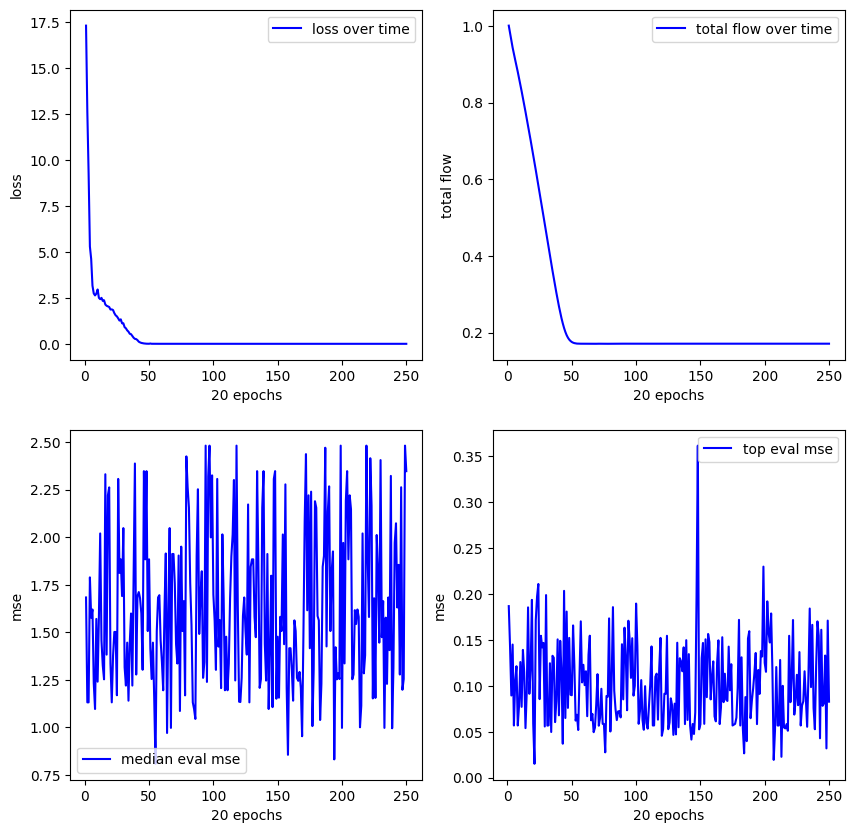

**************************************************
Experiment 19
training started with device cuda


12.424:   0%|          | 1/5000 [00:00<15:41,  5.31it/s]


new best reward (vanilla): 0.706749439239502
mse (pre/post optimized): 0.20040680468082428/0.20040680468082428
sqrt(square(x1))
expr: sqrt(square(x1))

new best reward (vanilla): 0.935049295425415
mse (pre/post optimized): 0.01615363173186779/0.012413984164595604
(sin(x1)) + ((x1) + (-0.33))
expr: x1 + sin(x1) - 0.33


0.000: 100%|██████████| 5000/5000 [03:12<00:00, 25.97it/s]


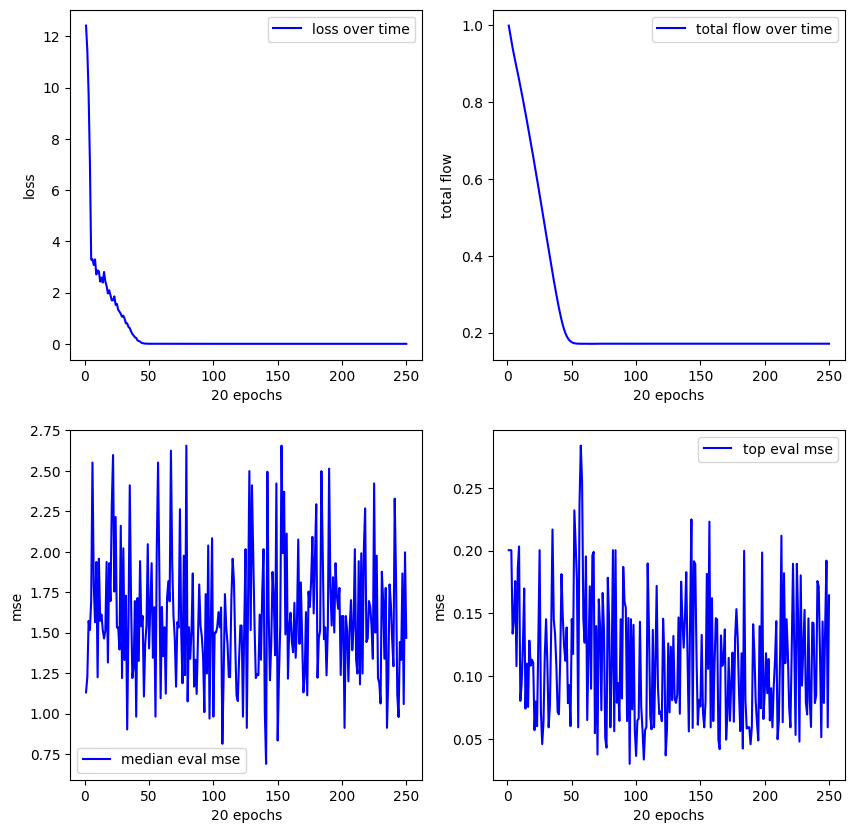

**************************************************
Experiment 20
training started with device cuda


13.152:   0%|          | 1/5000 [00:00<13:23,  6.23it/s]


new best reward (vanilla): 0.8946817517280579
mse (pre/post optimized): 0.06689992547035217/0.046313267201185226
exp((x1) - (0.82))
expr: 0.440431654505999*exp(x1)

new best reward (vanilla): 0.8997440338134766
mse (pre/post optimized): 0.012404832988977432/0.001204757601954043
(x1) + ((0.39) * (x1))
expr: 1.39*x1


13.152:   0%|          | 9/5000 [00:00<07:46, 10.71it/s]


new best reward (vanilla): 0.9163427948951721
mse (pre/post optimized): 0.0011308870743960142/0.0011308870743960142
(x1) / (0.72)
expr: 1.38888888888889*x1


0.000: 100%|██████████| 5000/5000 [03:13<00:00, 25.82it/s]


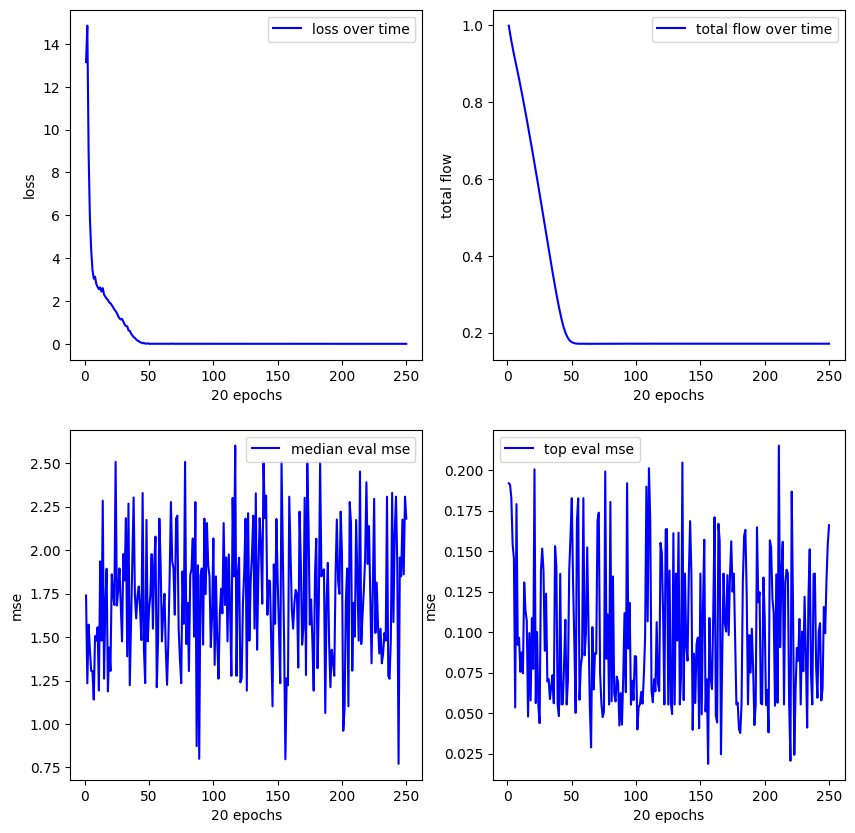

--------------------------------------------------
FUNCTION sqrt(x) Interval considered: [0, 4]
**************************************************
Experiment 1
training started with device cuda


16.735:   0%|          | 1/5000 [00:00<13:51,  6.01it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.001: 100%|██████████| 5000/5000 [03:46<00:00, 22.10it/s]


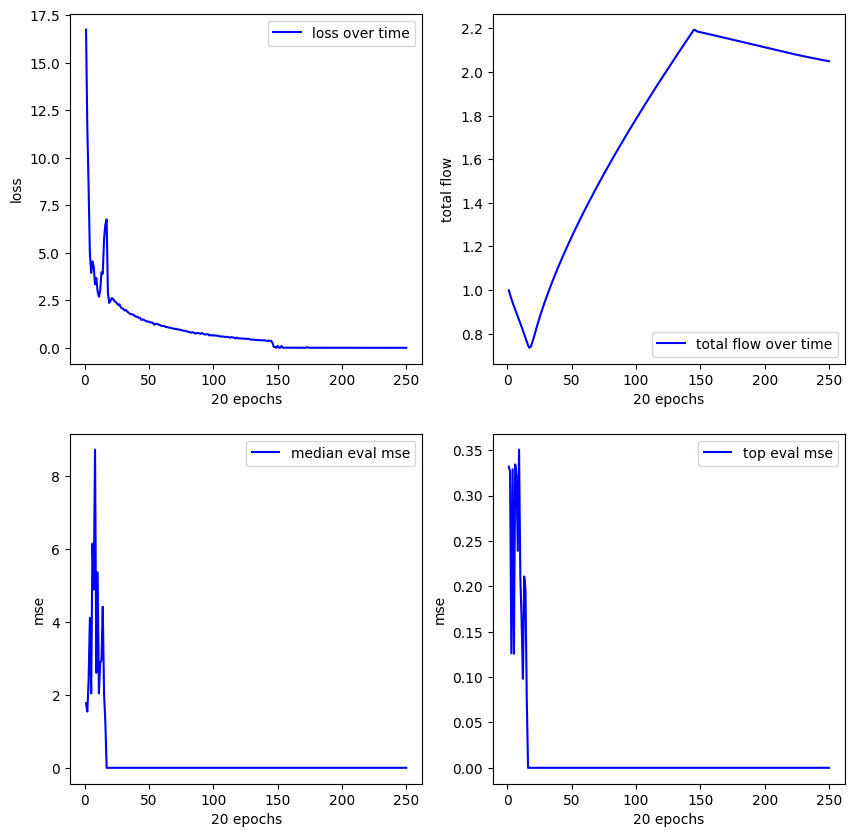

**************************************************
Experiment 2
training started with device cuda


14.236:   0%|          | 1/5000 [00:00<24:35,  3.39it/s]


new best reward (vanilla): 0.9992754459381104
mse (pre/post optimized): 0.00014689879026263952/3.68305372830946e-05
sqrt((0.01) + (x1))
expr: sqrt(x1 + 0.01)

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.083: 100%|██████████| 5000/5000 [03:43<00:00, 22.38it/s]


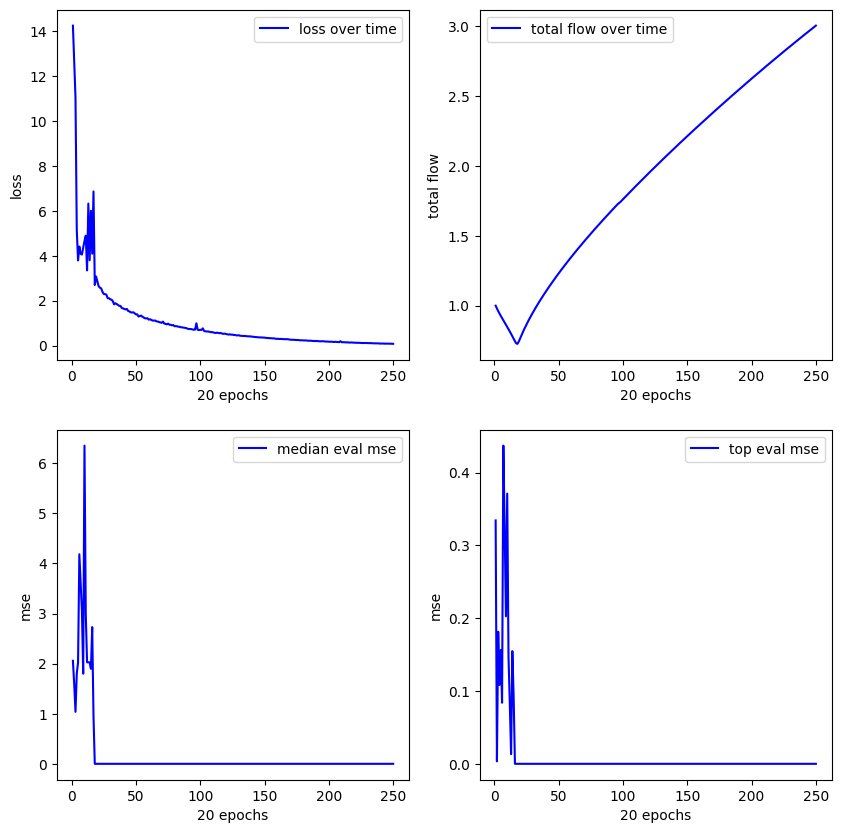

**************************************************
Experiment 3
training started with device cuda


16.181:   0%|          | 1/5000 [00:00<13:15,  6.28it/s]


new best reward (vanilla): 0.8652862310409546
mse (pre/post optimized): 0.0287962444126606/nan
sqrt((-0.05) + (x1))
expr: sqrt(x1 - 0.05)

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.349: 100%|██████████| 5000/5000 [03:15<00:00, 25.57it/s] 


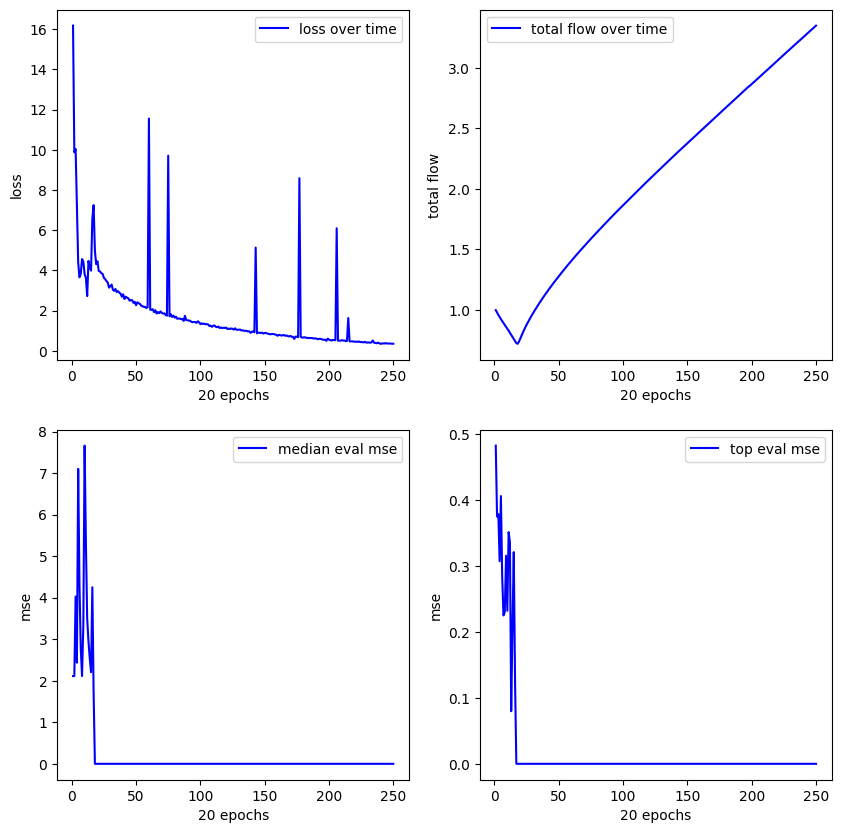

**************************************************
Experiment 4
training started with device cuda


16.561:   0%|          | 1/5000 [00:00<14:35,  5.71it/s]


new best reward (vanilla): 0.7464585304260254
mse (pre/post optimized): 0.05562274903059006/0.05562270060181618
exp((x1) * (0.17))
expr: exp(0.17*x1)

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.335: 100%|██████████| 5000/5000 [02:52<00:00, 28.93it/s] 


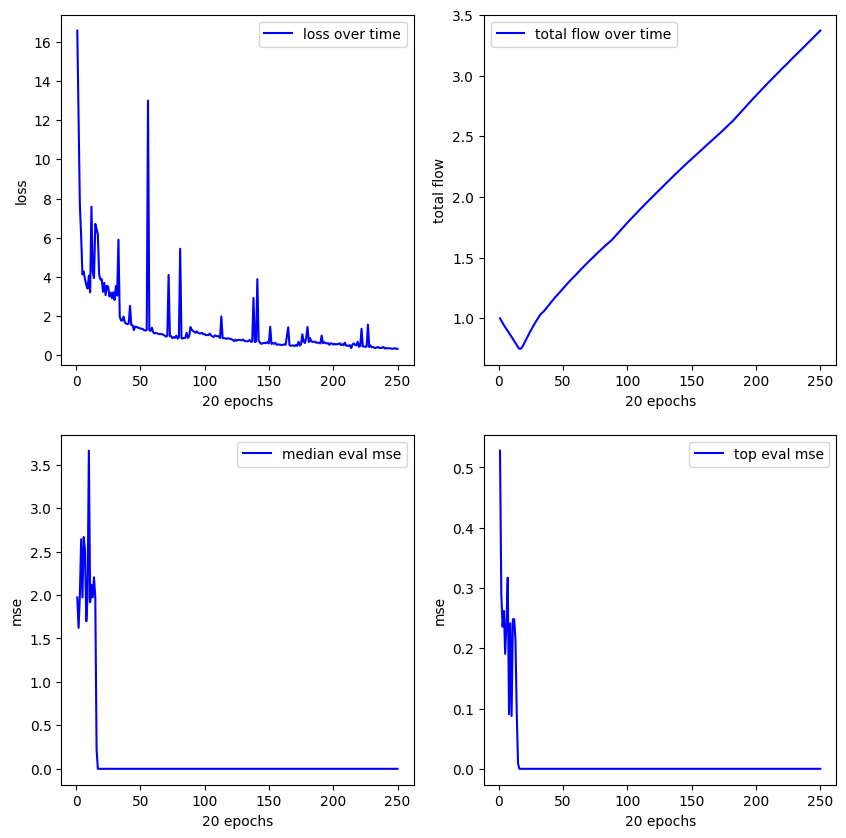

**************************************************
Experiment 5
training started with device cuda


12.071:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.7814897894859314
mse (pre/post optimized): 0.043301619589328766/8.622998237609863
exp((0.55) * (x1))
expr: exp(0.55*x1)


12.071:   0%|          | 3/5000 [00:00<08:00, 10.40it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
(sqrt(x1)) * ((x1) / (x1))
expr: sqrt(x1)


0.000: 100%|██████████| 5000/5000 [03:44<00:00, 22.25it/s] 


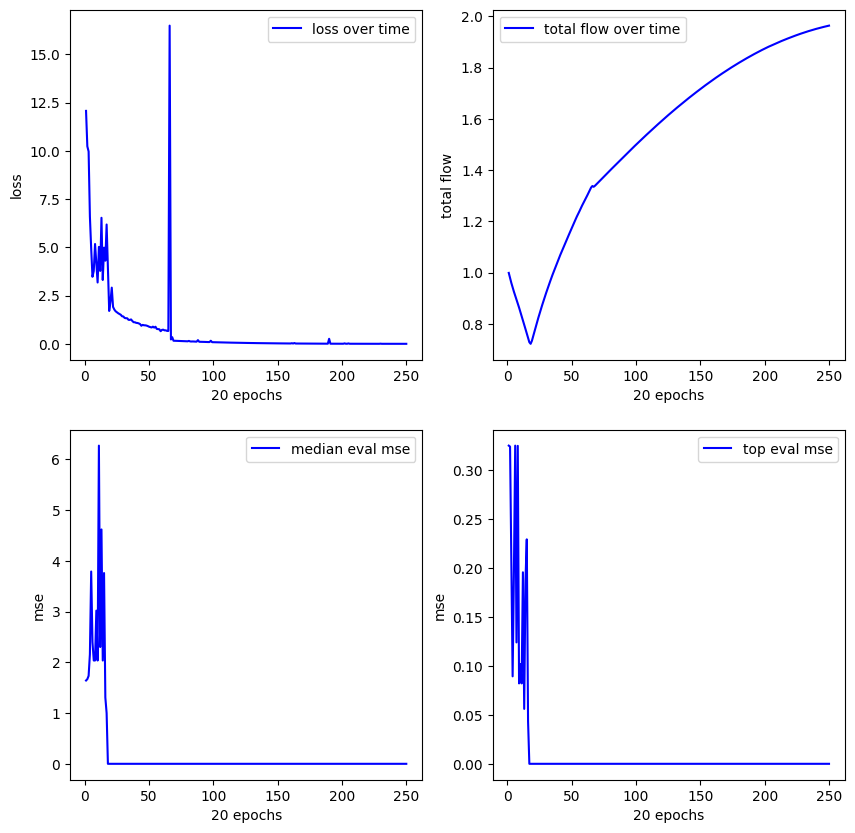

**************************************************
Experiment 6
training started with device cuda


11.813:   0%|          | 1/5000 [00:00<15:25,  5.40it/s]


new best reward (vanilla): 0.26280033588409424
mse (pre/post optimized): 0.17937280237674713/0.09285248070955276
((0.56) + (x1)) - (sqrt(x1))
expr: -sqrt(x1) + x1 + 0.56

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.089: 100%|██████████| 5000/5000 [03:47<00:00, 21.93it/s]


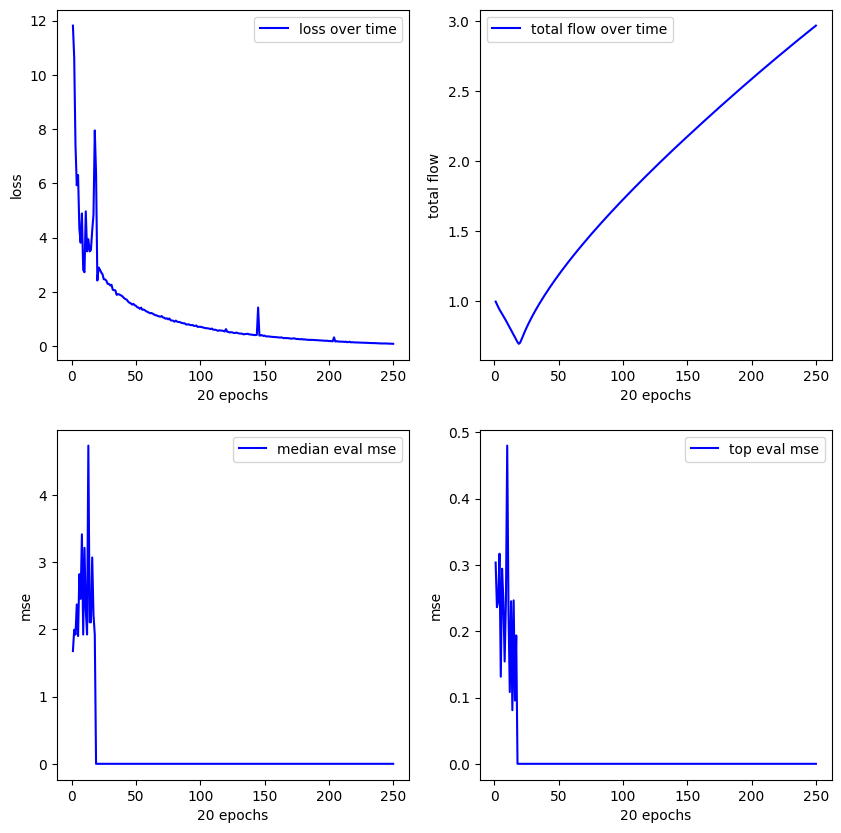

**************************************************
Experiment 7
training started with device cuda


14.853:   0%|          | 2/5000 [00:00<06:35, 12.65it/s]


new best reward (vanilla): 0.8633996248245239
mse (pre/post optimized): 0.0349397212266922/0.00572282774373889
(sqrt(x1)) + (0.08)
expr: sqrt(x1) + 0.08

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.793: 100%|██████████| 5000/5000 [02:30<00:00, 33.12it/s]


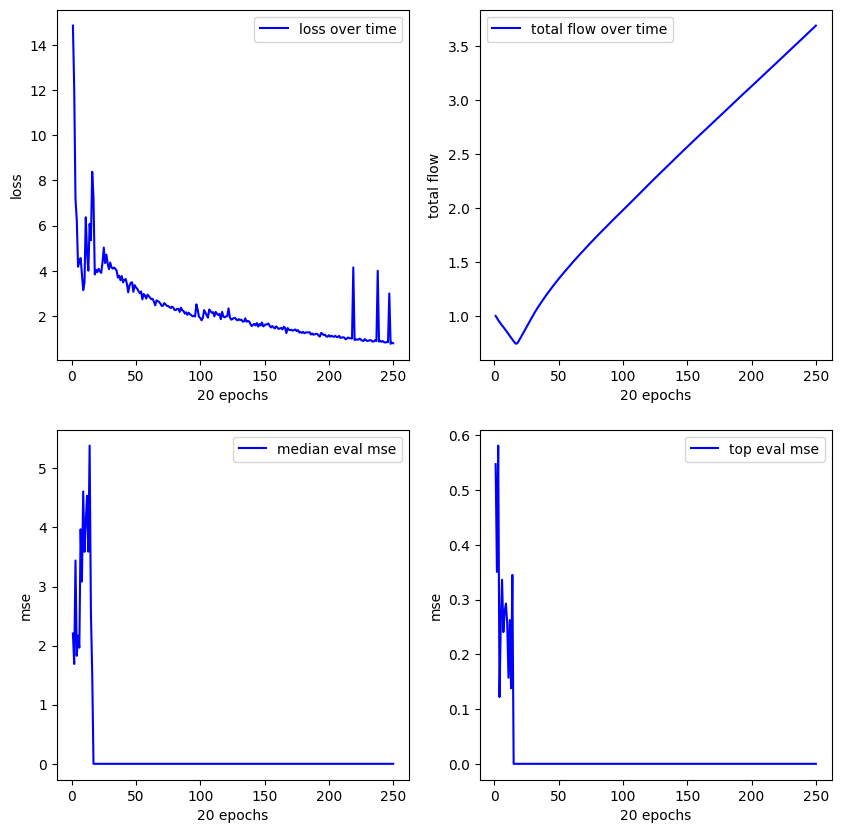

**************************************************
Experiment 8
training started with device cuda


18.208:   0%|          | 1/5000 [00:00<11:39,  7.14it/s]


new best reward (vanilla): 0.9951202869415283
mse (pre/post optimized): 0.0010160901583731174/1.894421251813494e-11
sqrt((1.0) * (x1))
expr: 1.0*sqrt(x1)

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.179: 100%|██████████| 5000/5000 [02:33<00:00, 32.64it/s] 


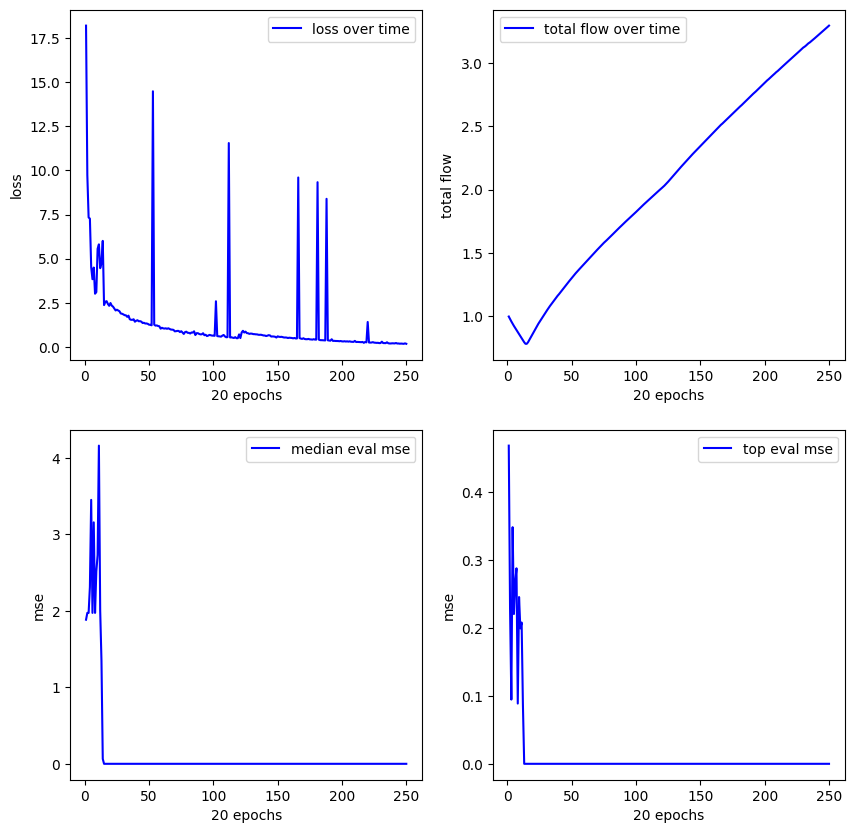

**************************************************
Experiment 9
training started with device cuda


17.770:   0%|          | 1/5000 [00:00<14:08,  5.89it/s]


new best reward (vanilla): 0.9287418127059937
mse (pre/post optimized): 0.014451679773628712/0.014616630040109158
((x1) * (0.47)) + (0.38)
expr: 0.47*x1 + 0.38

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.356: 100%|██████████| 5000/5000 [02:29<00:00, 33.41it/s]


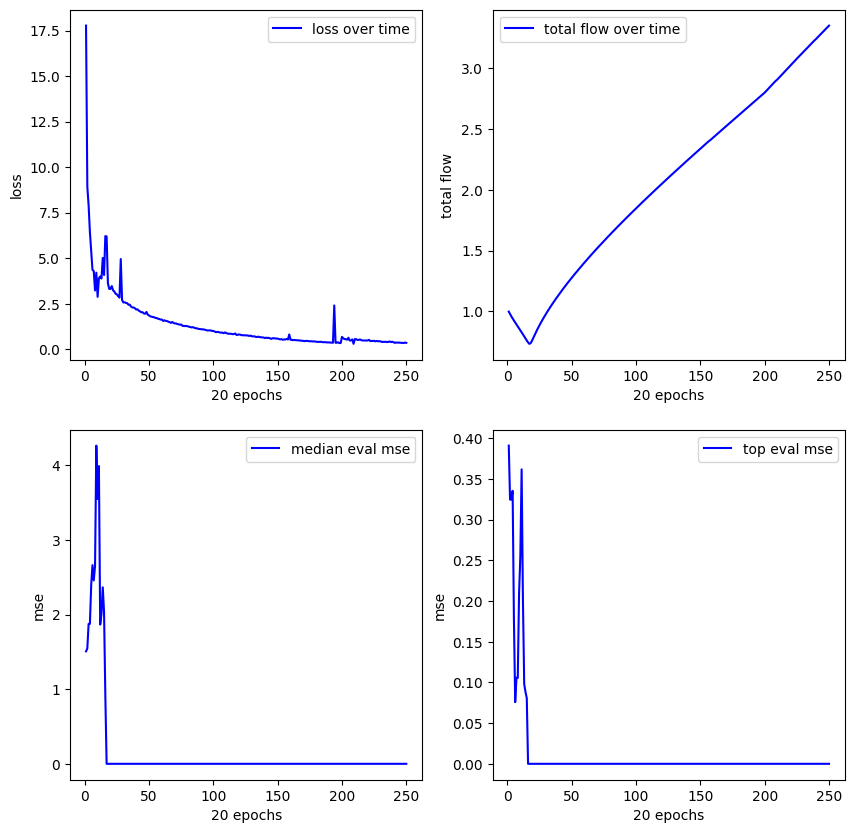

**************************************************
Experiment 10
training started with device cuda


17.183:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 5.2768899005180975e-15/5.2768899005180975e-15
(x1) / (sqrt(x1))
expr: sqrt(x1)


0.469: 100%|██████████| 5000/5000 [02:32<00:00, 32.72it/s]


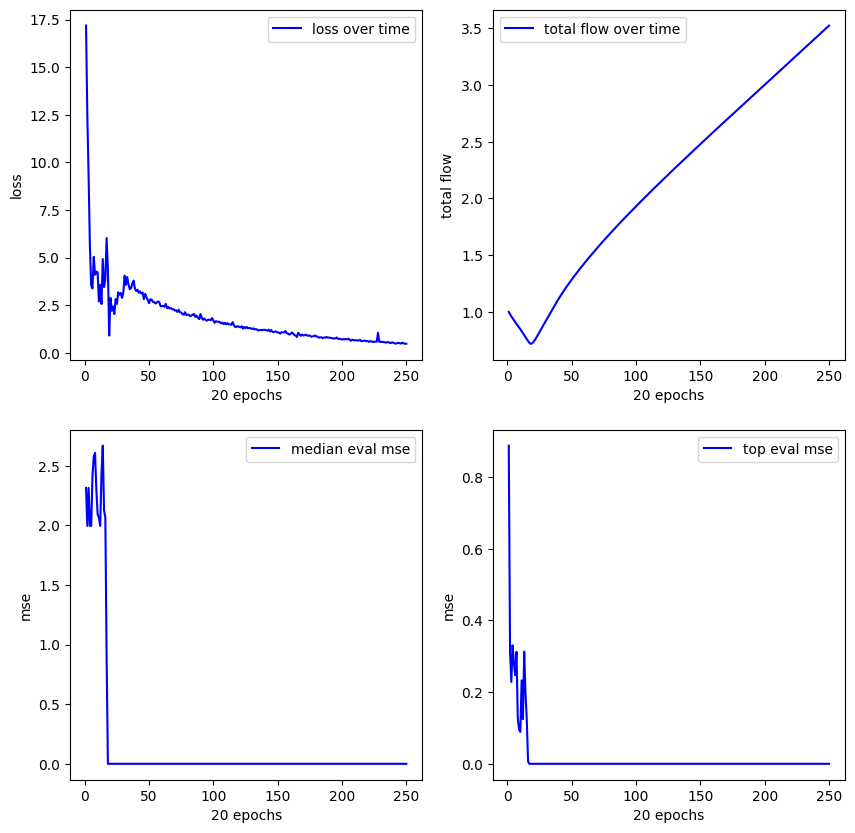

**************************************************
Experiment 11
training started with device cuda


14.838:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.170: 100%|██████████| 5000/5000 [02:35<00:00, 32.18it/s] 


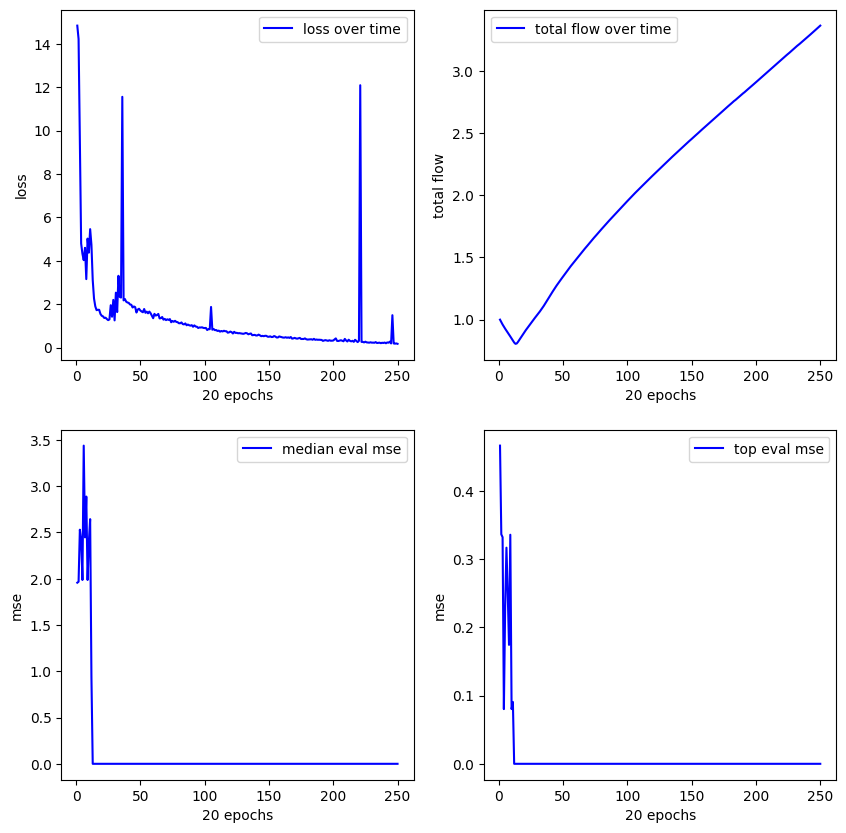

**************************************************
Experiment 12
training started with device cuda


16.249:   0%|          | 1/5000 [00:00<10:40,  7.80it/s]


new best reward (vanilla): 0.558218240737915
mse (pre/post optimized): 0.1047196313738823/0.1047196313738823
sqrt(sqrt(x1))
expr: x1**(1/4)

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.199: 100%|██████████| 5000/5000 [03:15<00:00, 25.58it/s]


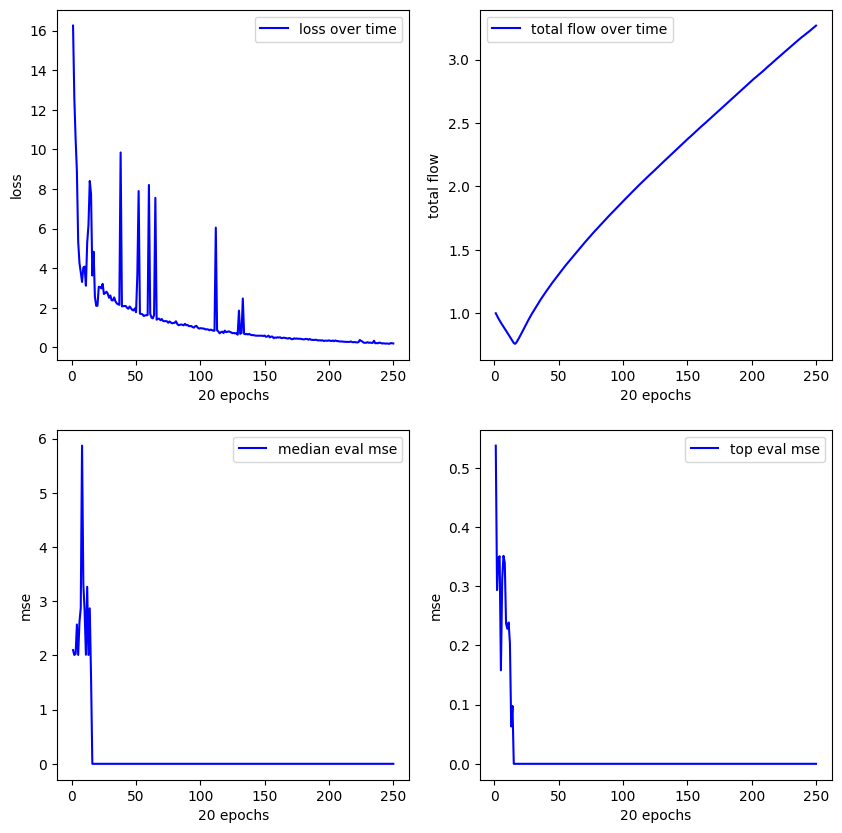

**************************************************
Experiment 13
training started with device cuda


15.355:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.323: 100%|██████████| 5000/5000 [02:39<00:00, 31.39it/s]


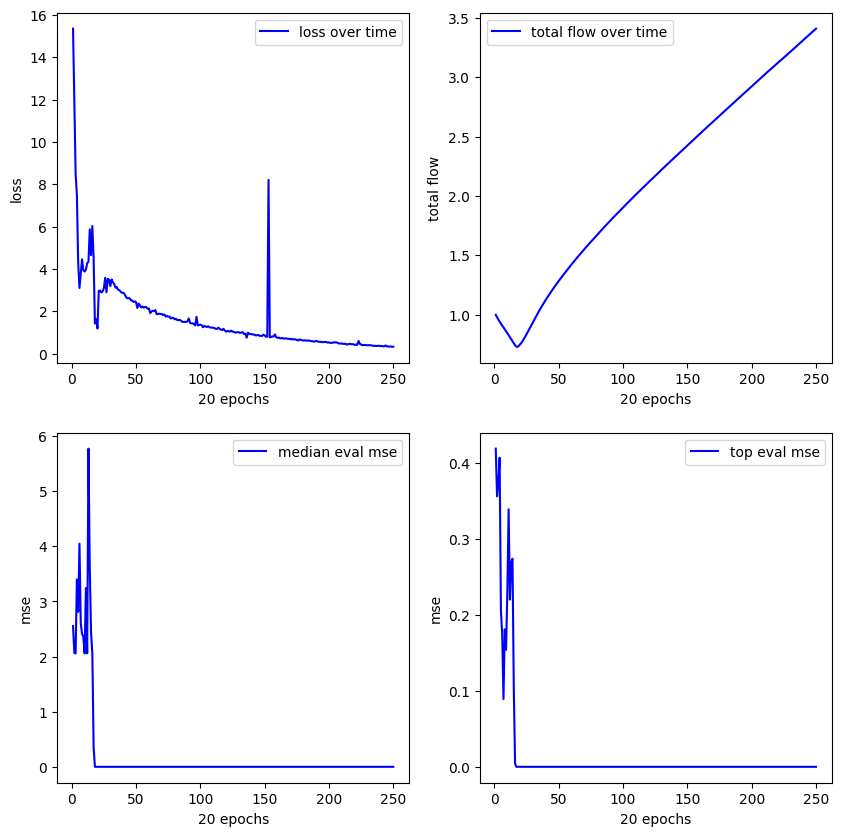

**************************************************
Experiment 14
training started with device cuda


13.884:   0%|          | 1/5000 [00:00<09:08,  9.11it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
((x1) - (x1)) + (sqrt(x1))
expr: sqrt(x1)


0.346: 100%|██████████| 5000/5000 [03:35<00:00, 23.16it/s]


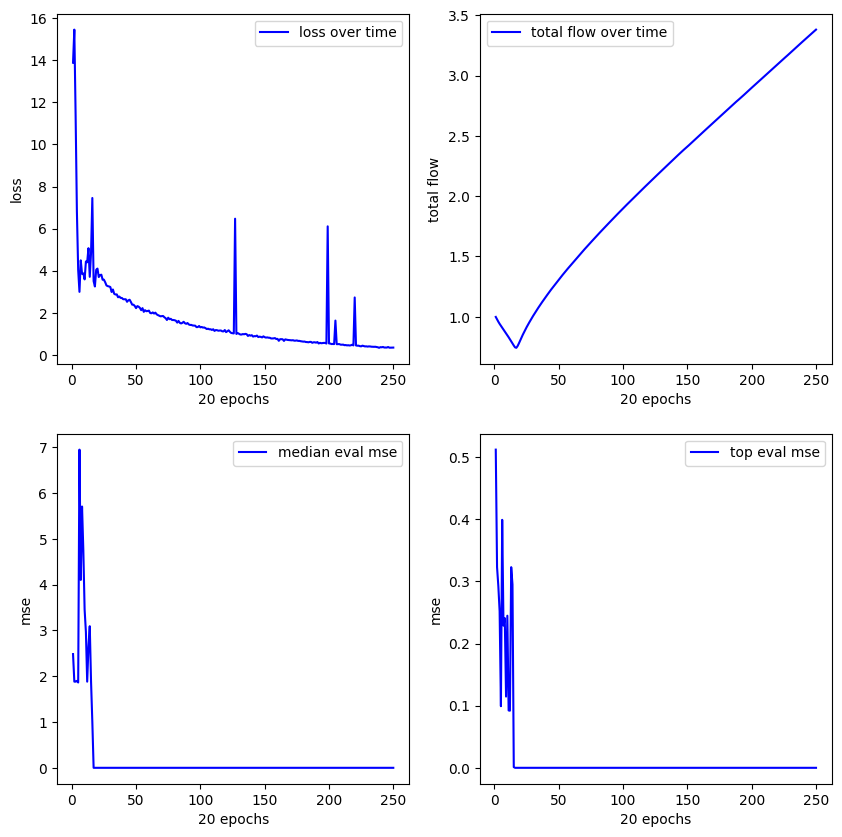

**************************************************
Experiment 15
training started with device cuda


16.993:   0%|          | 1/5000 [00:00<14:12,  5.86it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
(sqrt(x1)) / ((x1) / (x1))
expr: sqrt(x1)


0.084: 100%|██████████| 5000/5000 [03:45<00:00, 22.21it/s]


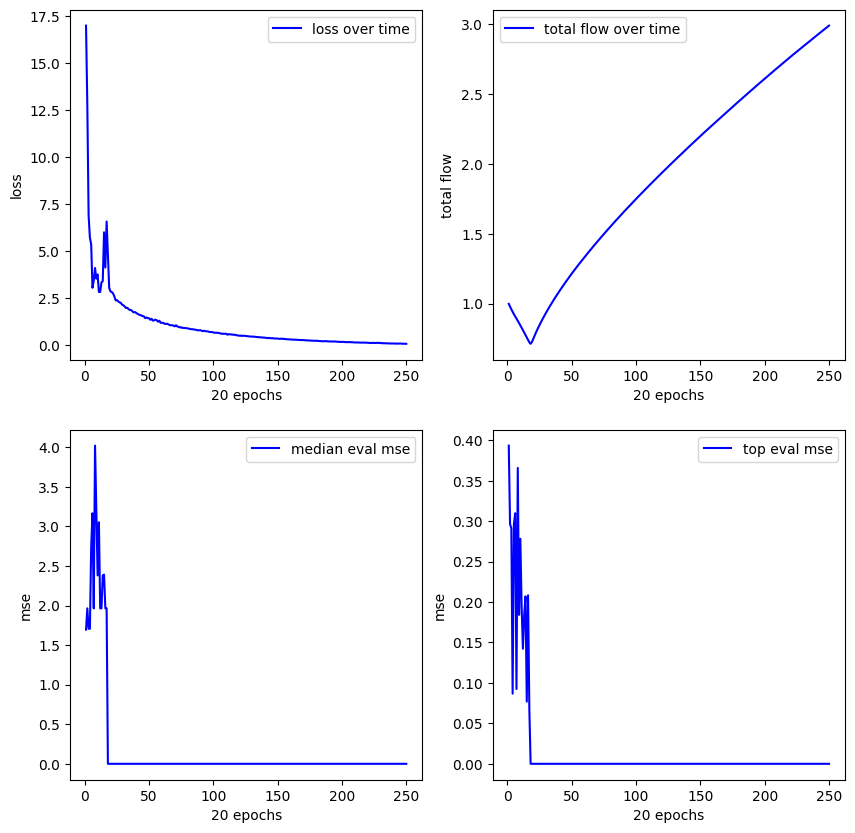

**************************************************
Experiment 16
training started with device cuda


14.251:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.081: 100%|██████████| 5000/5000 [03:51<00:00, 21.61it/s]


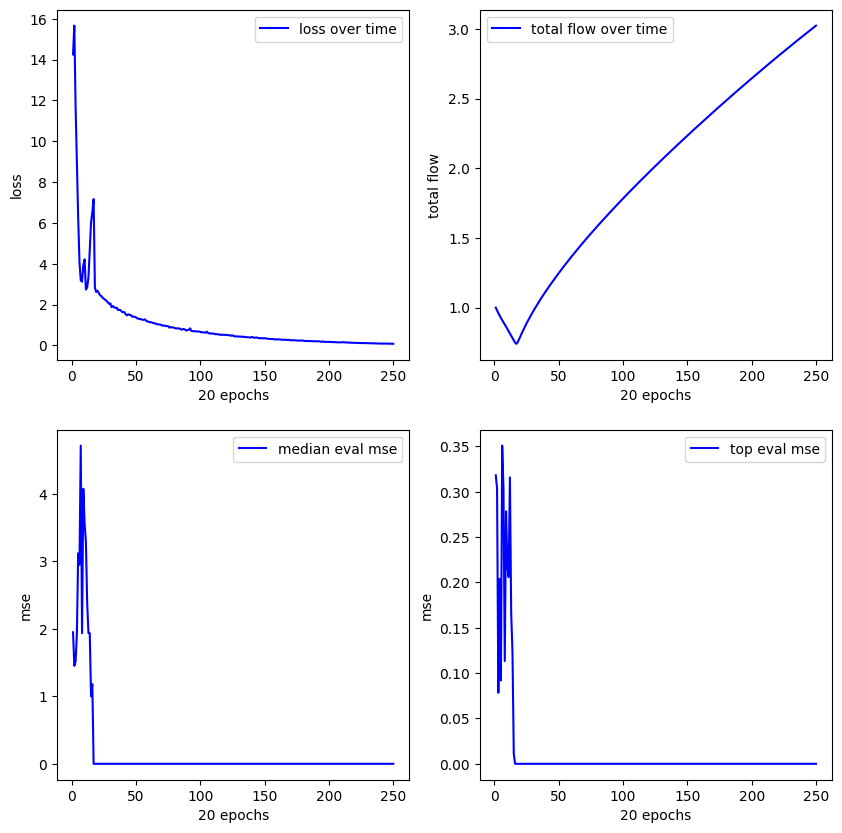

**************************************************
Experiment 17
training started with device cuda


15.983:   0%|          | 0/5000 [00:00<?, ?it/s]


new best reward (vanilla): 0.5027490854263306
mse (pre/post optimized): 0.09873417019844055/0.08113429695367813
((0.59) / (x1)) * (square(x1))
expr: 0.59*square(x1)/x1


15.983:   0%|          | 1/5000 [00:00<20:10,  4.13it/s]


new best reward (vanilla): 0.5843470692634583
mse (pre/post optimized): 0.04518844187259674/0.018494194373488426
(sqrt(x1)) - (0.14)
expr: sqrt(x1) - 0.14

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0


15.983:   0%|          | 3/5000 [00:00<11:23,  7.32it/s]

(sqrt(x1)) - ((x1) - (x1))
expr: sqrt(x1)


0.381: 100%|██████████| 5000/5000 [02:34<00:00, 32.32it/s]


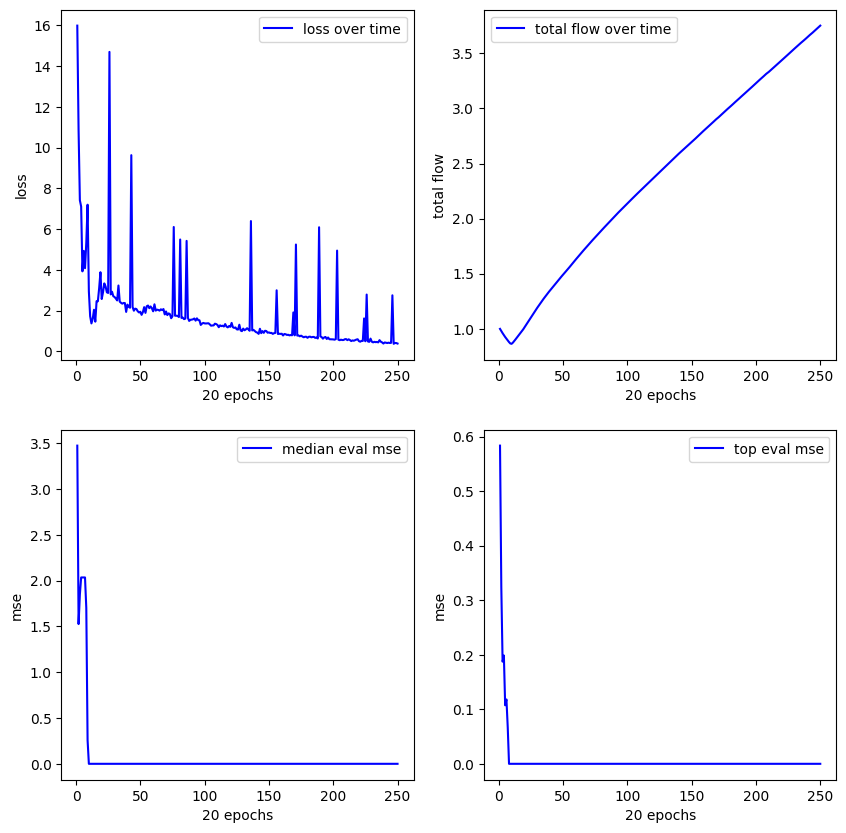

**************************************************
Experiment 18
training started with device cuda


14.986:   0%|          | 1/5000 [00:00<12:10,  6.84it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.086: 100%|██████████| 5000/5000 [03:46<00:00, 22.07it/s]


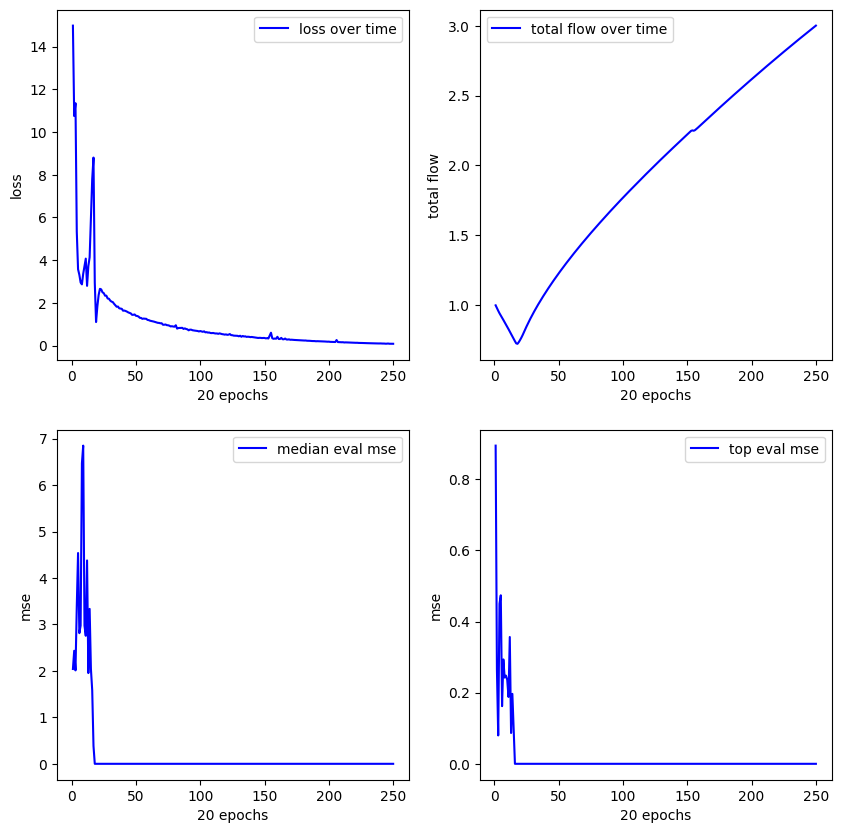

**************************************************
Experiment 19
training started with device cuda


16.097:   0%|          | 1/5000 [00:00<12:50,  6.49it/s]


new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
sqrt(x1)
expr: sqrt(x1)


0.315: 100%|██████████| 5000/5000 [02:49<00:00, 29.56it/s]


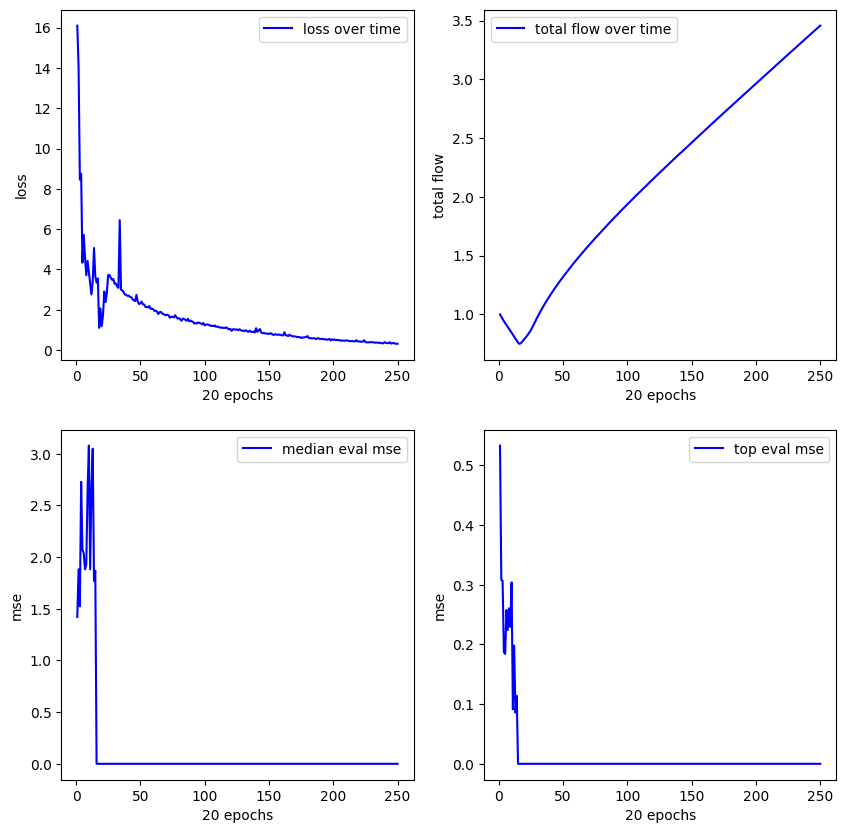

**************************************************
Experiment 20
training started with device cuda


17.385:   0%|          | 1/5000 [00:00<13:06,  6.36it/s]


new best reward (vanilla): 0.8571946024894714
mse (pre/post optimized): 0.02848866954445839/0.07825703918933868
sqrt((x1) * (0.65))
expr: 0.806225774829855*sqrt(x1)

new best reward (vanilla): 1.0
mse (pre/post optimized): 0.0/0.0
(sqrt(x1)) / ((x1) / (x1))
expr: sqrt(x1)


0.094: 100%|██████████| 5000/5000 [03:55<00:00, 21.24it/s]


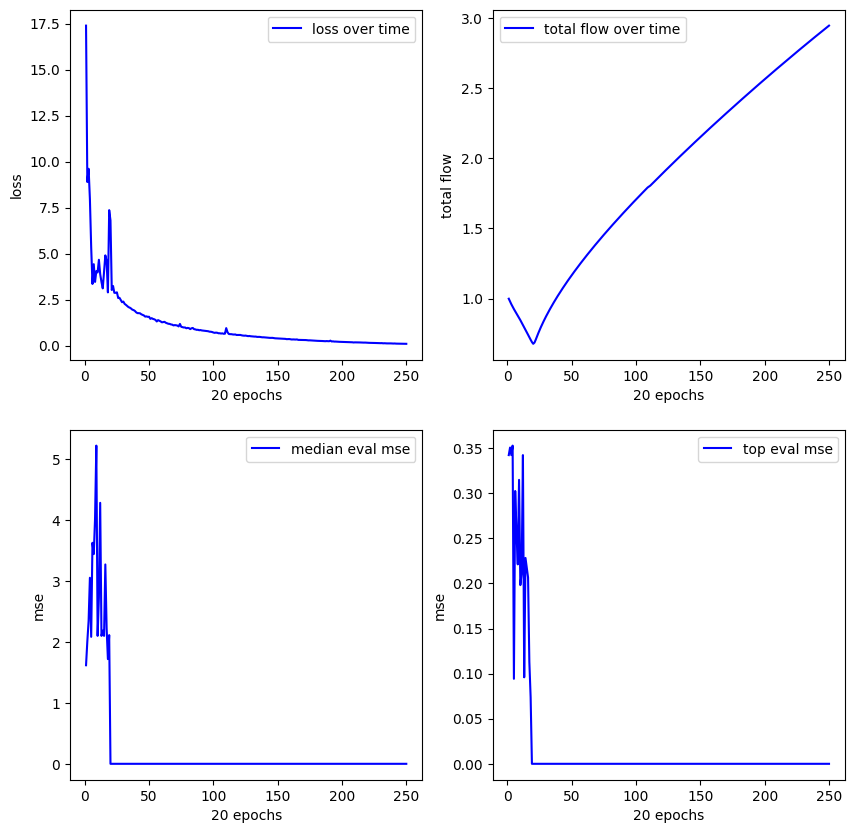

--------------------------------------------------
FUNCTION sin(x) + sin(y**2) Interval considered: [-1, 1]
**************************************************
Experiment 1
training started with device cuda


12.696:   0%|          | 1/5000 [00:00<11:02,  7.55it/s]


new best reward (vanilla): 0.6197737455368042
mse (pre/post optimized): 0.12468454986810684/0.07874903827905655
(x1) + (0.33)
expr: x1 + 0.33


8.353:   1%|          | 45/5000 [00:02<03:44, 22.05it/s] 


new best reward (vanilla): 0.9647122025489807
mse (pre/post optimized): 0.00202554720453918/0.00202554720453918
(sin(x1)) + ((x2) * (x2))
expr: x2**2 + sin(x1)


0.000: 100%|██████████| 5000/5000 [04:36<00:00, 18.08it/s]


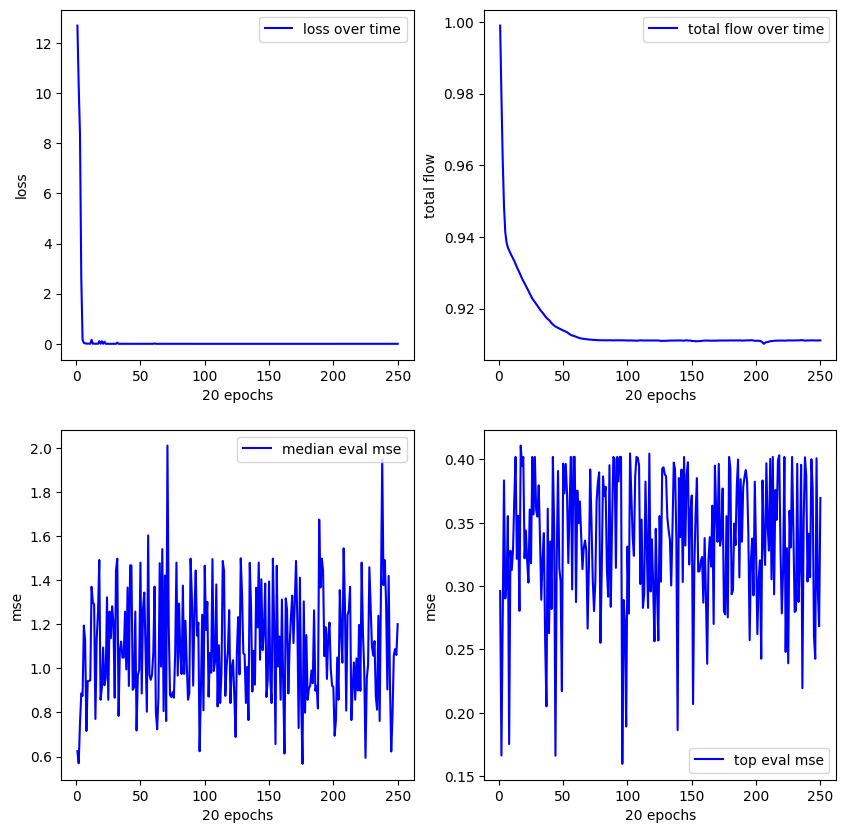

**************************************************
Experiment 2
training started with device cuda


16.602:   0%|          | 2/5000 [00:00<05:27, 15.28it/s]


new best reward (vanilla): 0.5395457744598389
mse (pre/post optimized): 0.17961731553077698/0.17961731553077698
x1
expr: x1


16.602:   0%|          | 13/5000 [00:00<03:26, 24.13it/s]


new best reward (vanilla): 0.9289583563804626
mse (pre/post optimized): 0.006350468844175339/0.006350468844175339
(x1) + (square(x2))
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:49<00:00, 17.24it/s]


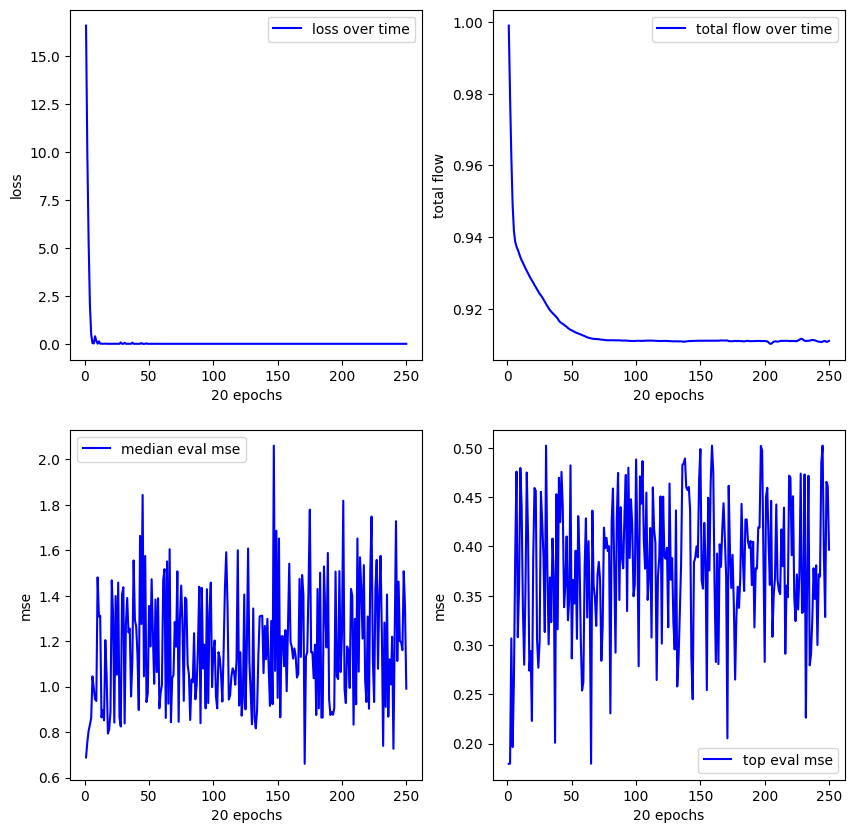

**************************************************
Experiment 3
training started with device cuda


11.556:   0%|          | 1/5000 [00:00<09:31,  8.75it/s]


new best reward (vanilla): 0.5452375411987305
mse (pre/post optimized): 0.13784494996070862/0.13784494996070862
(x1) + (square(x1))
expr: x1 + square(x1)


11.556:   0%|          | 12/5000 [00:00<03:22, 24.63it/s]


new best reward (vanilla): 0.9649479389190674
mse (pre/post optimized): 0.004889677744358778/0.004889677744358778
((x2) * (x2)) + (x1)
expr: x1 + x2**2


0.000: 100%|██████████| 5000/5000 [04:33<00:00, 18.27it/s]


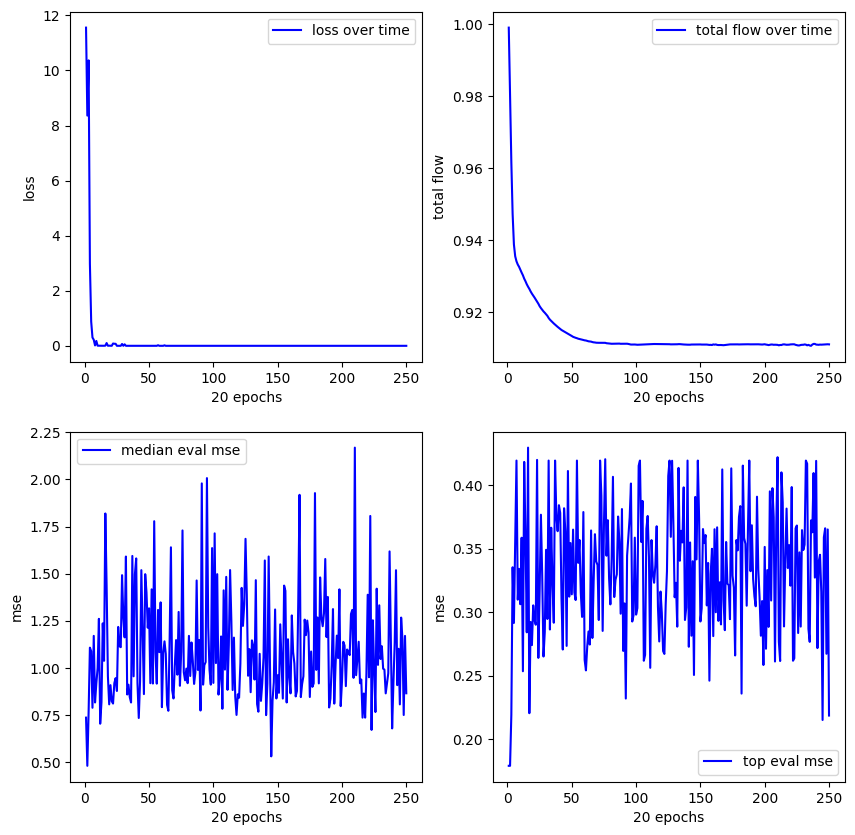

**************************************************
Experiment 4
training started with device cuda


14.308:   0%|          | 1/5000 [00:00<11:57,  6.96it/s]


new best reward (vanilla): 0.6306966543197632
mse (pre/post optimized): 0.1470651924610138/0.1470651924610138
log(exp(x1))
expr: log(exp(x1))


7.689:   1%|          | 36/5000 [00:01<03:18, 25.05it/s] 


new best reward (vanilla): 0.9717676639556885
mse (pre/post optimized): 0.0020307586528360844/0.0020307586528360844
(square(x2)) + (sin(x1))
expr: square(x2) + sin(x1)


0.000: 100%|██████████| 5000/5000 [04:36<00:00, 18.10it/s]


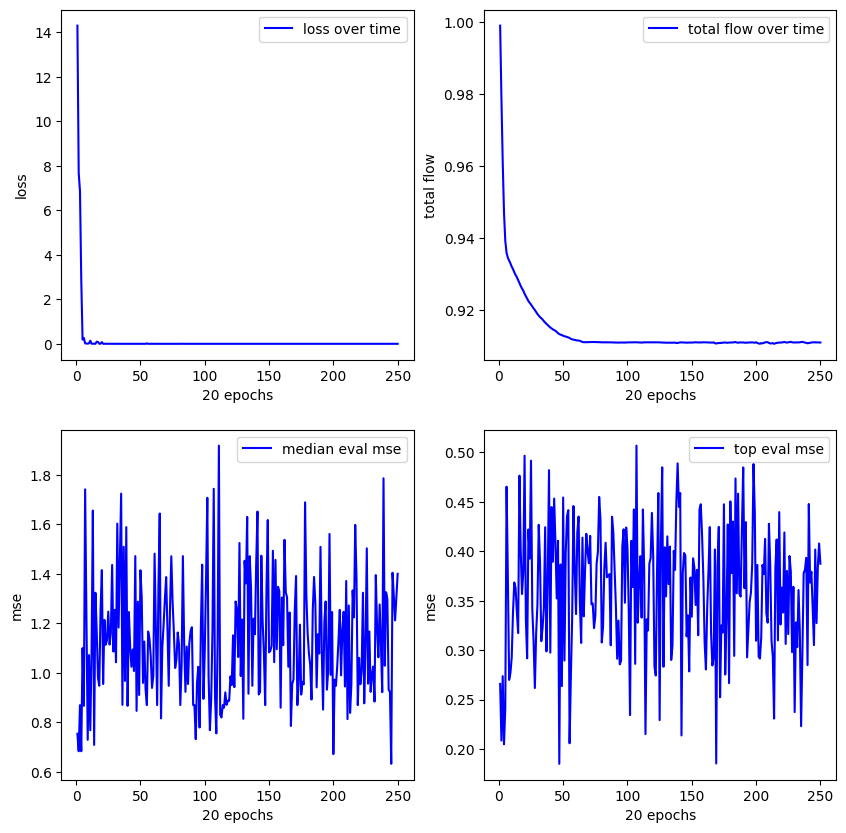

**************************************************
Experiment 5
training started with device cuda


12.325:   0%|          | 1/5000 [00:00<10:38,  7.83it/s]


new best reward (vanilla): 0.5394243001937866
mse (pre/post optimized): 0.14714252948760986/0.14714252948760986
(x1) * (cos(x2))
expr: x1*cos(x2)

new best reward (vanilla): 0.5997809171676636
mse (pre/post optimized): 0.06578633934259415/0.0662219449877739
sin((0.39) + (x1))
expr: sin(x1 + 0.39)


9.393:   1%|          | 27/5000 [00:01<03:14, 25.62it/s] 


new best reward (vanilla): 0.9190955758094788
mse (pre/post optimized): 0.005309862084686756/0.005309862084686756
(x1) + (square(x2))
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:34<00:00, 18.22it/s]


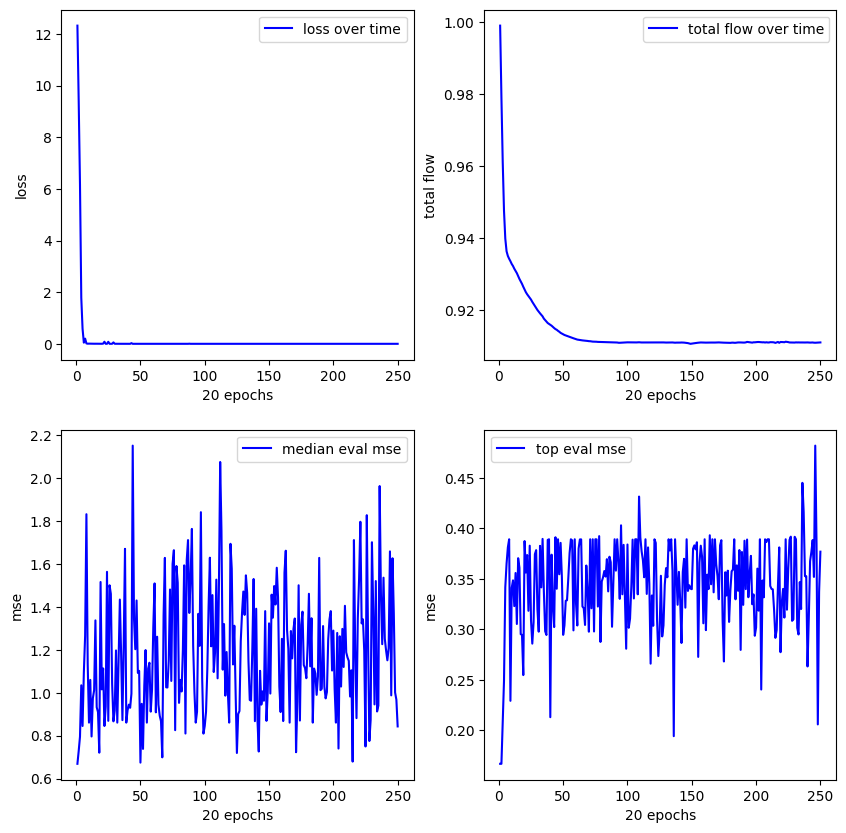

**************************************************
Experiment 6
training started with device cuda


16.806:   0%|          | 1/5000 [00:00<08:58,  9.29it/s]


new best reward (vanilla): 0.9848478436470032
mse (pre/post optimized): 0.005630005616694689/0.005630005616694689
(x1) + (square(x2))
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:36<00:00, 18.08it/s]


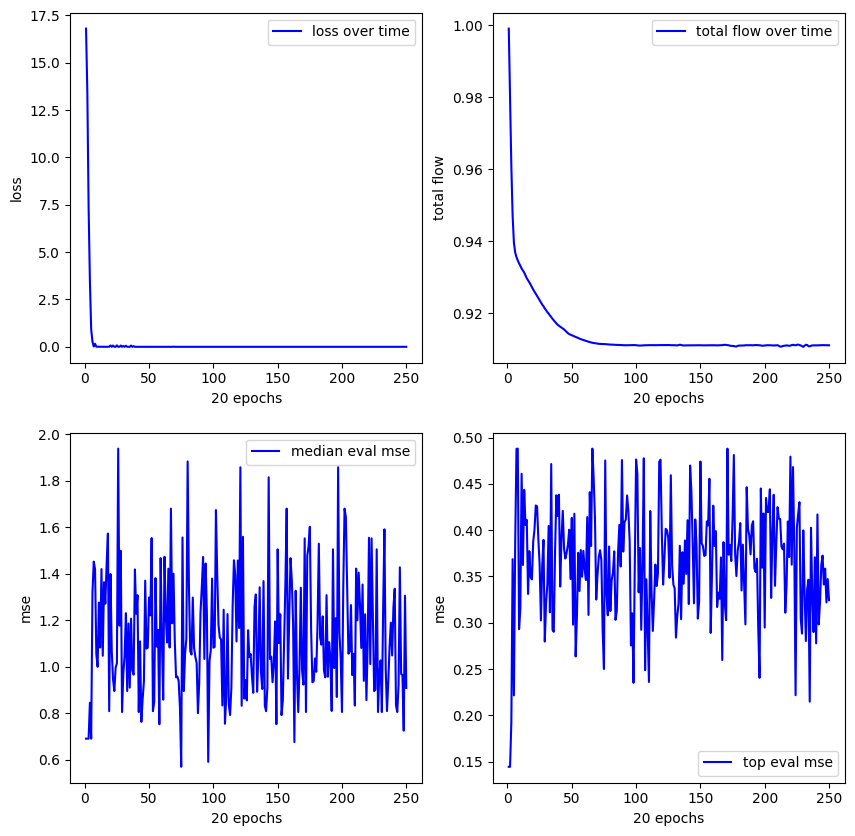

**************************************************
Experiment 7
training started with device cuda


8.896:   0%|          | 1/5000 [00:00<11:46,  7.08it/s]


new best reward (vanilla): 0.4682677388191223
mse (pre/post optimized): 0.18189990520477295/0.18175677955150604
sin((x1) / (0.89))
expr: sin(1.12359550561798*x1)


12.556:   0%|          | 25/5000 [00:01<03:48, 21.79it/s]


new best reward (vanilla): 0.9311366677284241
mse (pre/post optimized): 0.006145812105387449/0.006145812105387449
(x1) + (square(x2))
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:30<00:00, 18.49it/s]


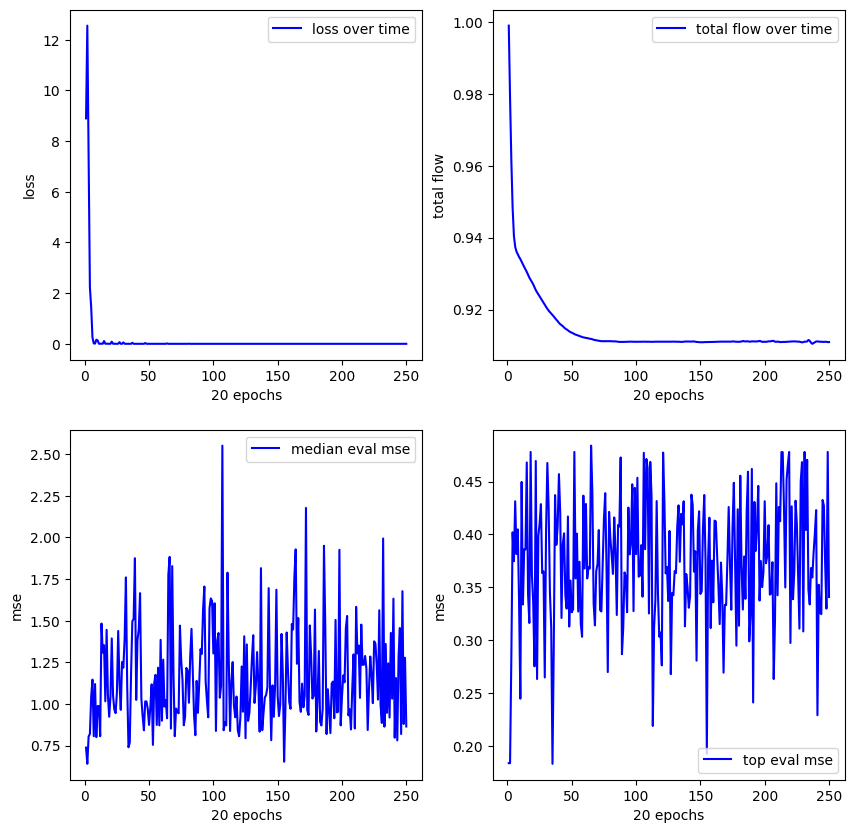

**************************************************
Experiment 8
training started with device cuda


12.131:   0%|          | 1/5000 [00:00<11:02,  7.55it/s]


new best reward (vanilla): 0.4966707229614258
mse (pre/post optimized): 0.15451397001743317/0.15451397001743317
sin(x1)
expr: sin(x1)

new best reward (vanilla): 0.9699307084083557
mse (pre/post optimized): 0.005104594863951206/0.005104594863951206
(x1) + ((x2) * (x2))
expr: x1 + x2**2


0.000: 100%|██████████| 5000/5000 [04:34<00:00, 18.22it/s]


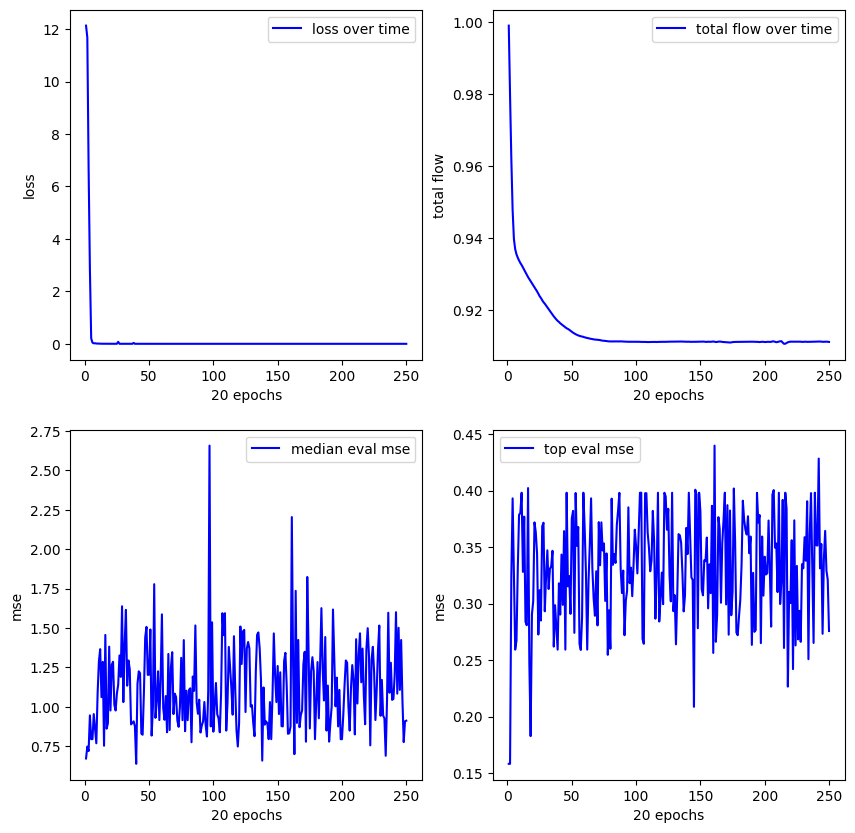

**************************************************
Experiment 9
training started with device cuda


15.643:   0%|          | 2/5000 [00:00<05:21, 15.57it/s]


new best reward (vanilla): 0.640575647354126
mse (pre/post optimized): 0.1250462681055069/0.0736137330532074
sin((x1) + (0.3))
expr: sin(x1 + 0.3)

new best reward (vanilla): 0.960277259349823
mse (pre/post optimized): 0.005852441769093275/0.005852441769093275
(square(x2)) + (x1)
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:33<00:00, 18.28it/s]


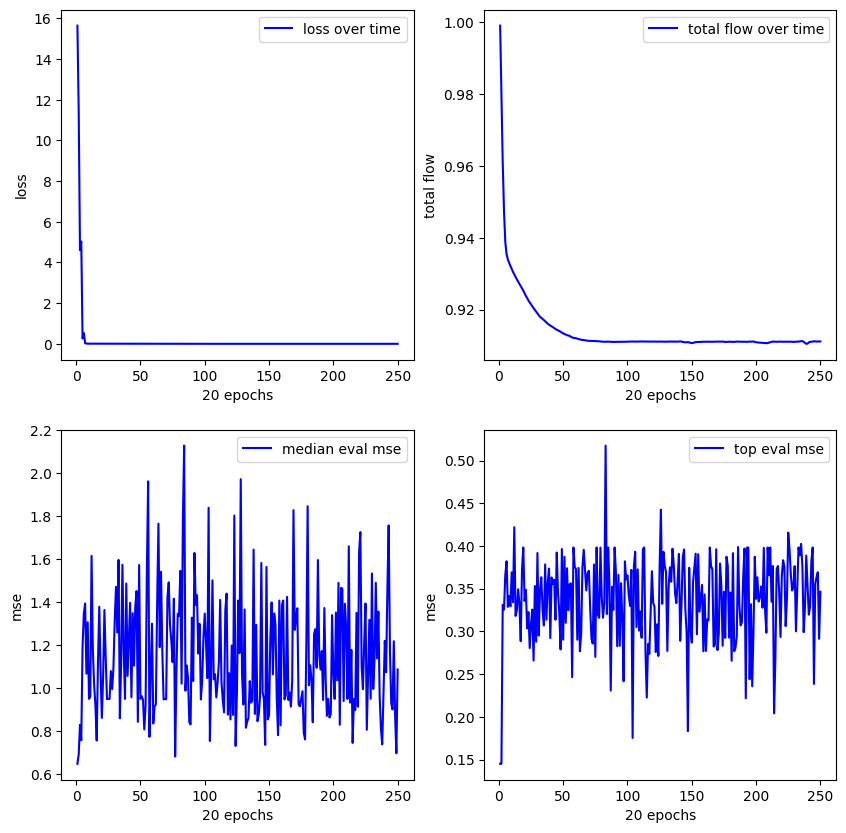

**************************************************
Experiment 10
training started with device cuda


14.516:   0%|          | 1/5000 [00:00<11:21,  7.33it/s]


new best reward (vanilla): 0.6764836311340332
mse (pre/post optimized): 0.11529426276683807/0.10736725479364395
cos((x1) - (0.99))
expr: cos(x1 - 0.99)


6.706:   1%|          | 43/5000 [00:01<03:17, 25.10it/s] 


new best reward (vanilla): 0.9689074754714966
mse (pre/post optimized): 0.0022008433006703854/0.002859831089153886
((x2) * (x2)) + ((x1) / (1.06))
expr: 0.943396226415094*x1 + x2**2


0.000: 100%|██████████| 5000/5000 [04:34<00:00, 18.19it/s]


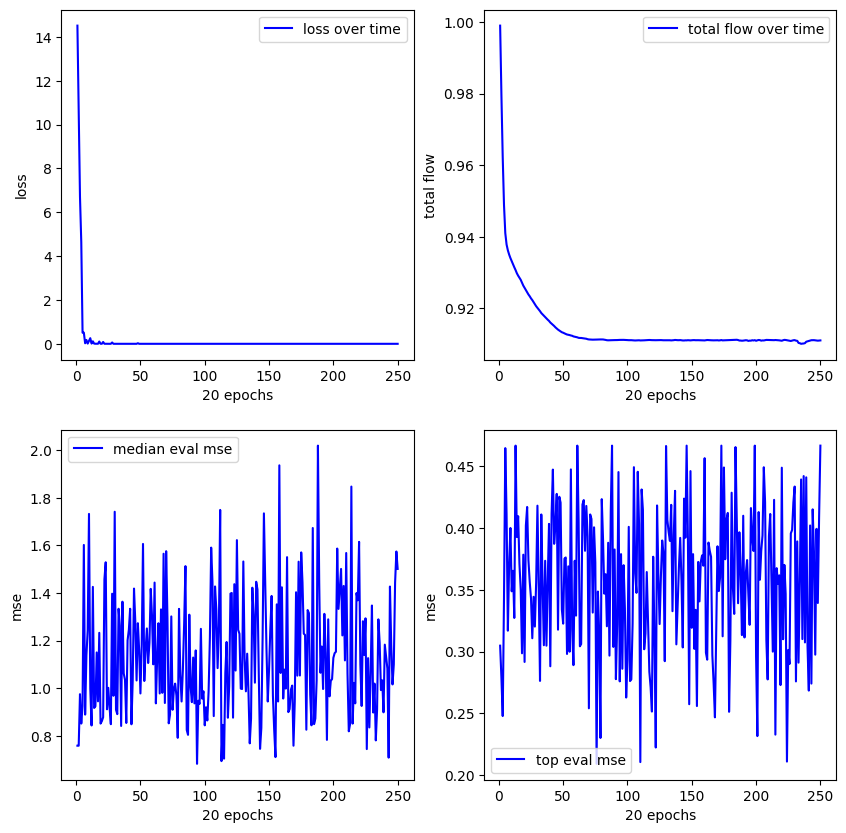

**************************************************
Experiment 11
training started with device cuda


14.258:   0%|          | 1/5000 [00:00<08:32,  9.75it/s]


new best reward (vanilla): 0.44293737411499023
mse (pre/post optimized): 0.19377116858959198/0.19377116858959198
log(exp(x1))
expr: log(exp(x1))


14.258:   0%|          | 3/5000 [00:00<05:56, 14.00it/s]


new best reward (vanilla): 0.9705958366394043
mse (pre/post optimized): 0.0055150301195681095/0.0055150301195681095
(x1) + (square(x2))
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:32<00:00, 18.32it/s]


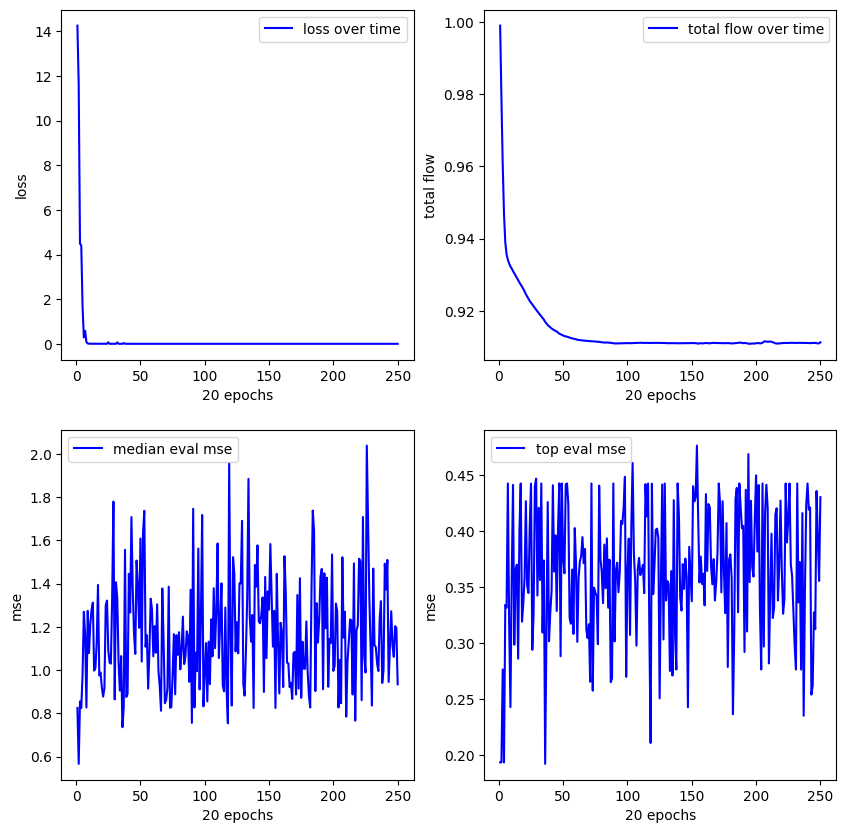

**************************************************
Experiment 12
training started with device cuda


10.986:   0%|          | 1/5000 [00:00<10:43,  7.77it/s]


new best reward (vanilla): 0.5507736802101135
mse (pre/post optimized): 0.1750677525997162/0.19341355562210083
((x1) - (x2)) + ((0.71) * (x2))
expr: x1 - 0.29*x2

new best reward (vanilla): 0.9677347540855408
mse (pre/post optimized): 0.005668445955961943/0.005668445955961943
(square(x2)) + (x1)
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:34<00:00, 18.21it/s]


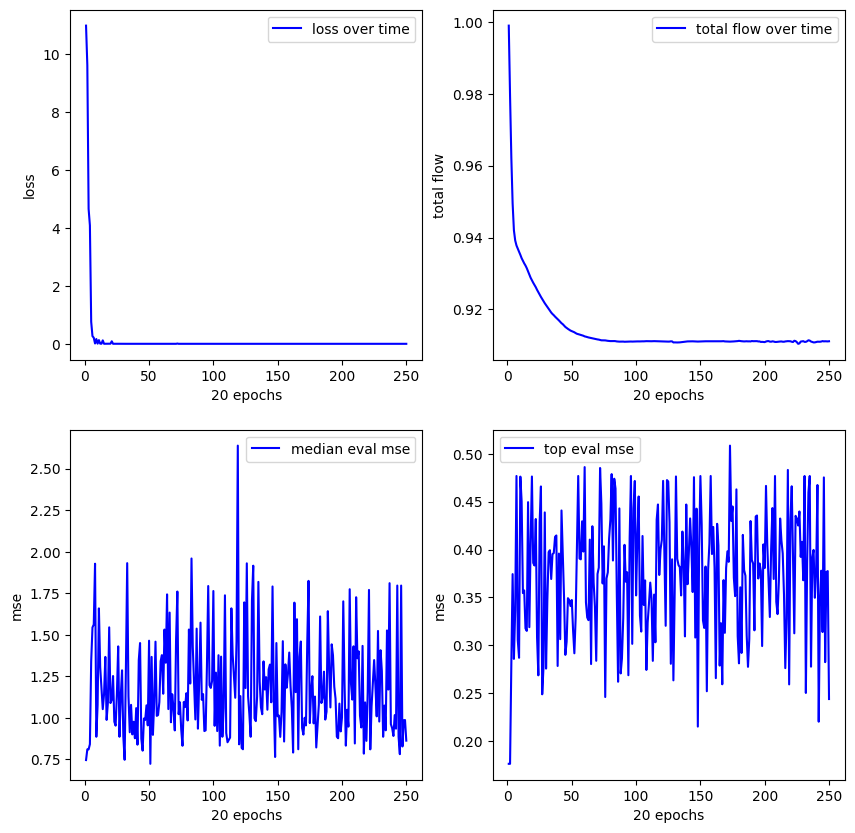

**************************************************
Experiment 13
training started with device cuda


16.596:   0%|          | 2/5000 [00:00<05:32, 15.05it/s]


new best reward (vanilla): 0.553816556930542
mse (pre/post optimized): 0.1589677780866623/0.1589677780866623
x1
expr: x1


16.596:   0%|          | 14/5000 [00:00<03:53, 21.31it/s]


new best reward (vanilla): 0.9506227374076843
mse (pre/post optimized): 0.005181398242712021/0.005181398242712021
((x2) * (x2)) + (x1)
expr: x1 + x2**2


0.000: 100%|██████████| 5000/5000 [04:34<00:00, 18.23it/s]


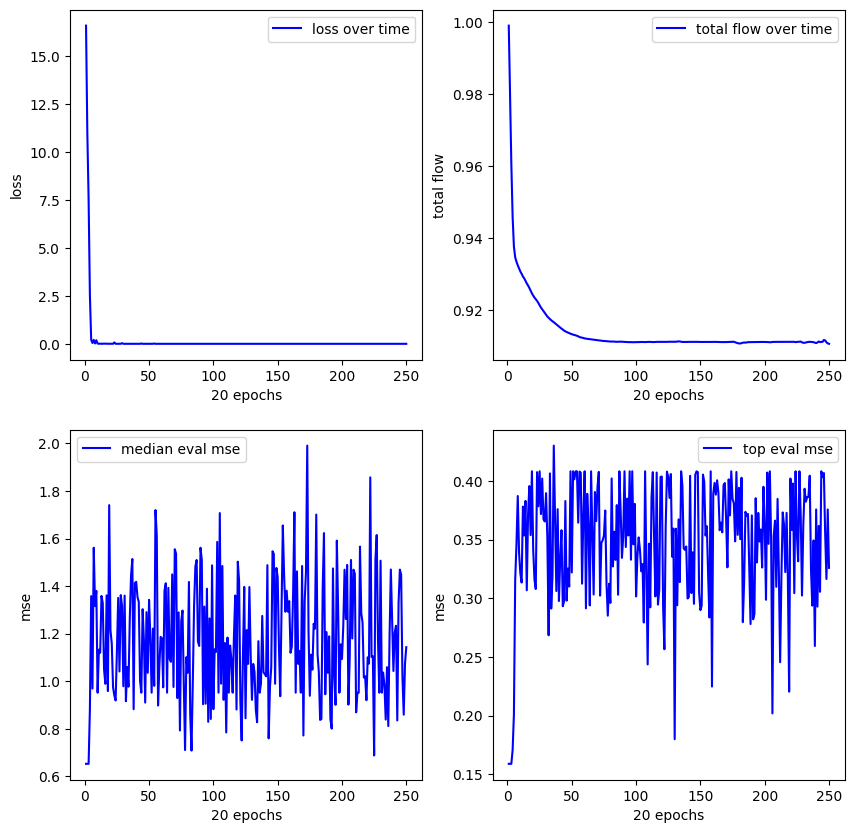

**************************************************
Experiment 14
training started with device cuda


12.108:   0%|          | 2/5000 [00:00<06:46, 12.30it/s]


new best reward (vanilla): 0.5306251049041748
mse (pre/post optimized): 0.16072095930576324/0.16072095930576324
x1
expr: x1

new best reward (vanilla): 0.5472878217697144
mse (pre/post optimized): 0.07163159549236298/0.06948884576559067
sin((0.35) + (x1))
expr: sin(x1 + 0.35)


12.108:   0%|          | 18/5000 [00:00<02:59, 27.73it/s]


new best reward (vanilla): 0.9135134220123291
mse (pre/post optimized): 0.005784007720649242/0.005784007720649242
(x1) + ((x2) * (x2))
expr: x1 + x2**2


0.000: 100%|██████████| 5000/5000 [04:34<00:00, 18.18it/s]


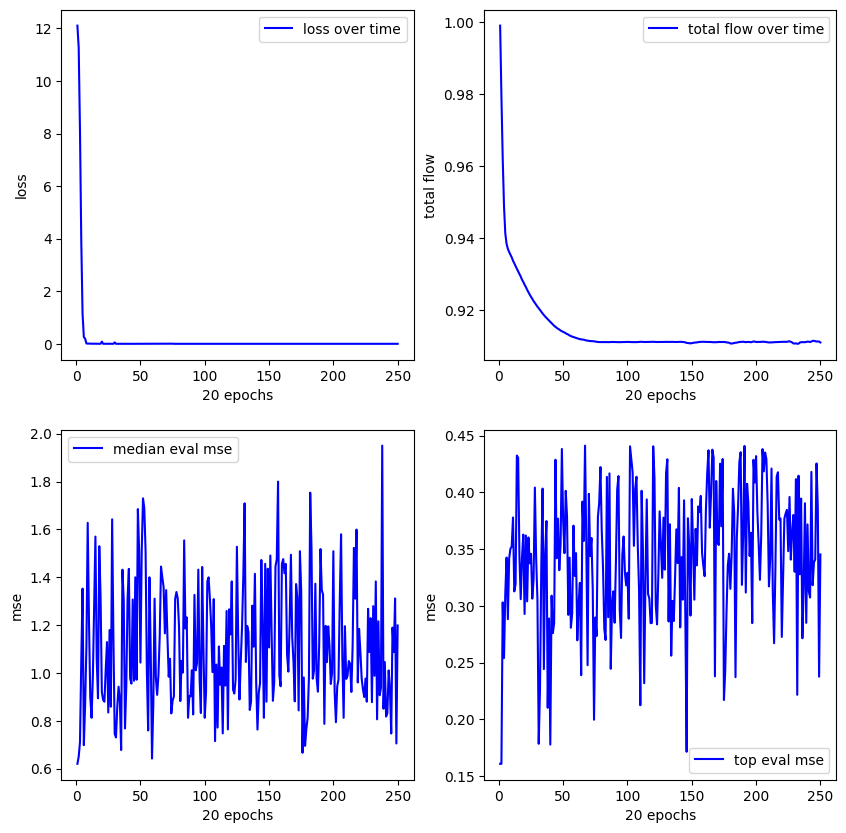

**************************************************
Experiment 15
training started with device cuda


8.306:   0%|          | 2/5000 [00:00<05:25, 15.37it/s]


new best reward (vanilla): 0.5013830661773682
mse (pre/post optimized): 0.16680294275283813/0.16680294275283813
x1
expr: x1

new best reward (vanilla): 0.5552364587783813
mse (pre/post optimized): 0.07345479726791382/0.07345546036958694
sin((0.36) + (x1))
expr: sin(x1 + 0.36)


8.306:   0%|          | 6/5000 [00:00<04:43, 17.63it/s]


new best reward (vanilla): 0.931907057762146
mse (pre/post optimized): 0.005626165308058262/0.005626165308058262
(square(x2)) + (x1)
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:31<00:00, 18.40it/s]


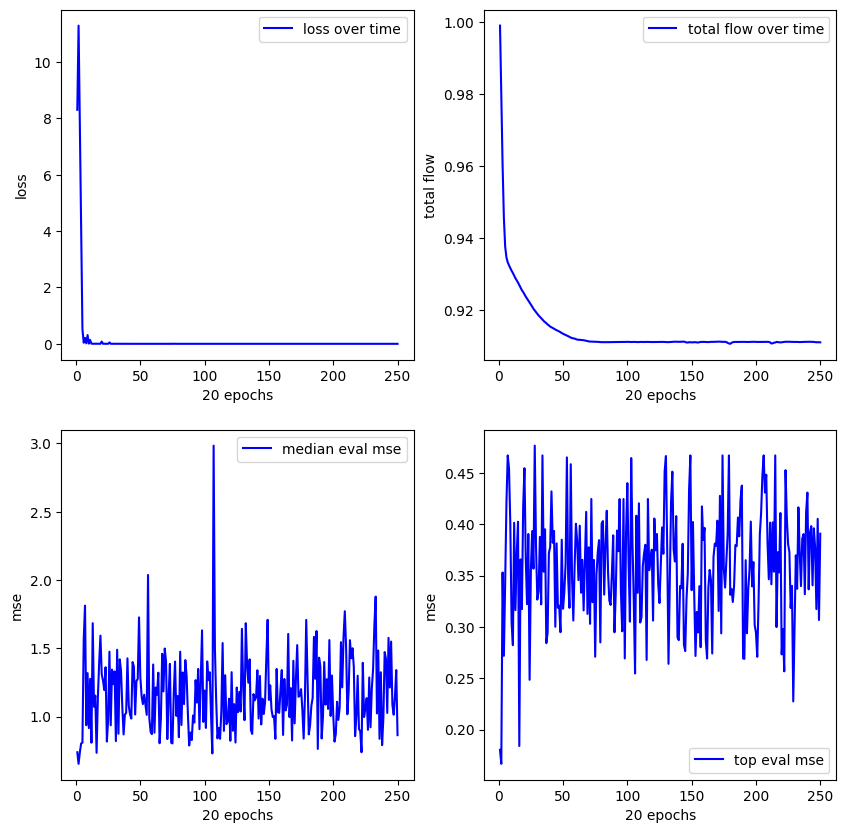

**************************************************
Experiment 16
training started with device cuda


13.518:   0%|          | 2/5000 [00:00<07:13, 11.52it/s]


new best reward (vanilla): 0.5318434238433838
mse (pre/post optimized): 0.14933714270591736/0.14933714270591736
x1
expr: x1

new best reward (vanilla): 0.9824027419090271
mse (pre/post optimized): 0.0016984861576929688/0.0016984861576929688
(square(x2)) + (sin(x1))
expr: square(x2) + sin(x1)


0.000: 100%|██████████| 5000/5000 [04:34<00:00, 18.19it/s]


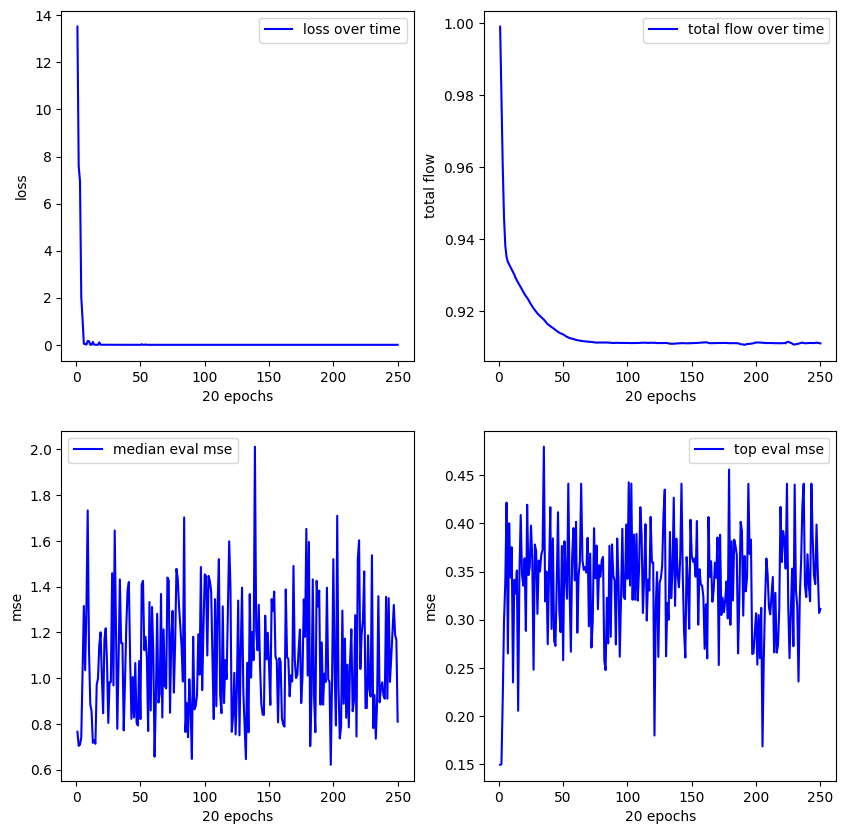

**************************************************
Experiment 17
training started with device cuda


11.749:   0%|          | 1/5000 [00:00<08:58,  9.28it/s]


new best reward (vanilla): 0.41289693117141724
mse (pre/post optimized): 0.18583887815475464/0.18583887815475464
x1
expr: x1

new best reward (vanilla): 0.967373788356781
mse (pre/post optimized): 0.006105856969952583/0.006105856969952583
(x1) + (square(x2))
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:34<00:00, 18.23it/s]


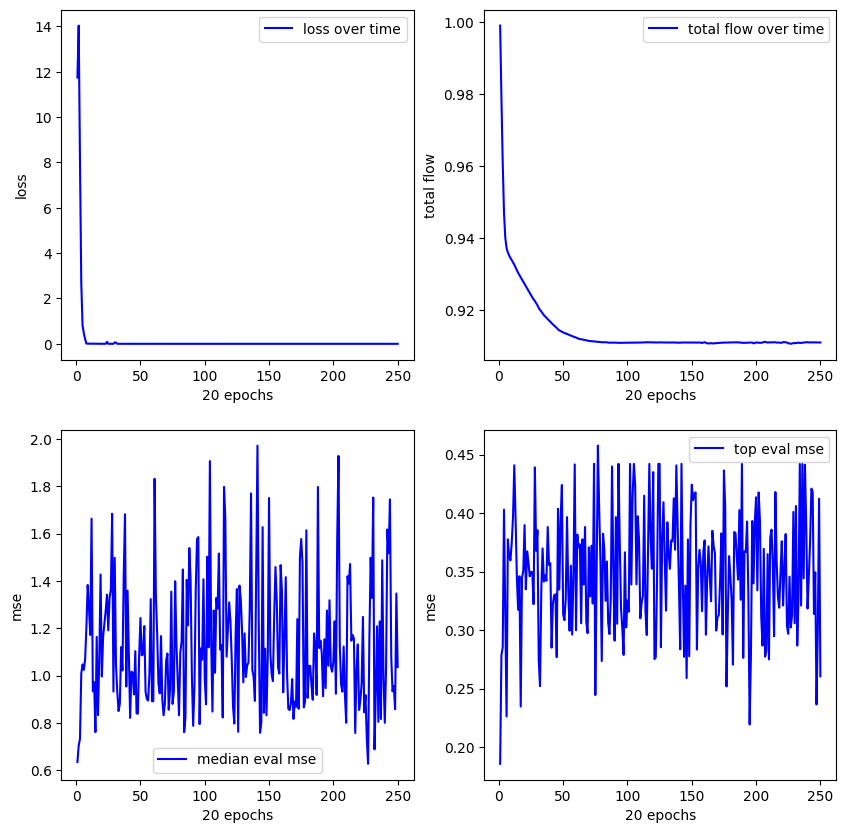

**************************************************
Experiment 18
training started with device cuda


10.929:   0%|          | 1/5000 [00:00<16:21,  5.09it/s]


new best reward (vanilla): 0.5111858248710632
mse (pre/post optimized): 0.1767568141222/0.1767568141222
sin(x1)
expr: sin(x1)

new best reward (vanilla): 0.7495920658111572
mse (pre/post optimized): 0.04889002442359924/0.025909438729286194
((1.09) + (x1)) - (cos(x2))
expr: x1 - cos(x2) + 1.09


8.915:   0%|          | 22/5000 [00:00<03:07, 26.50it/s] 


new best reward (vanilla): 0.904071033000946
mse (pre/post optimized): 0.006093903910368681/0.006093903910368681
(square(x2)) + (x1)
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:31<00:00, 18.44it/s]


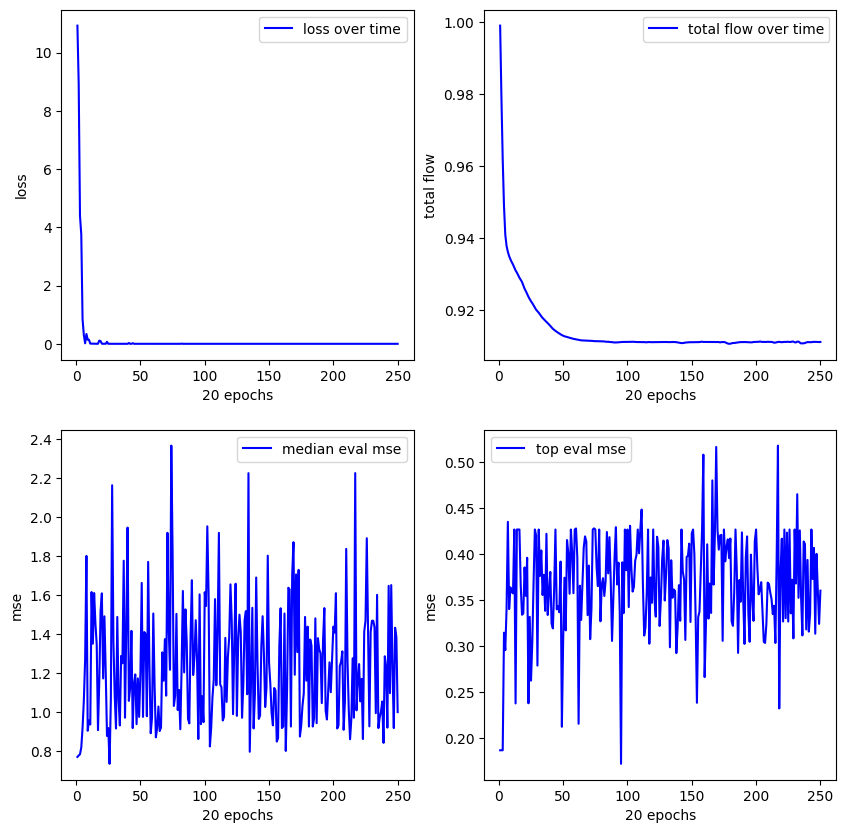

**************************************************
Experiment 19
training started with device cuda


12.956:   0%|          | 1/5000 [00:00<11:15,  7.40it/s]


new best reward (vanilla): 0.6825688481330872
mse (pre/post optimized): 0.10735215246677399/0.08979055285453796
(exp(x1)) - (0.82)
expr: exp(x1) - 0.82


12.956:   0%|          | 17/5000 [00:00<03:24, 24.32it/s]


new best reward (vanilla): 0.9740036129951477
mse (pre/post optimized): 0.0016388064250349998/0.0016388064250349998
(sin(x1)) + (square(x2))
expr: square(x2) + sin(x1)


0.000: 100%|██████████| 5000/5000 [04:36<00:00, 18.08it/s]


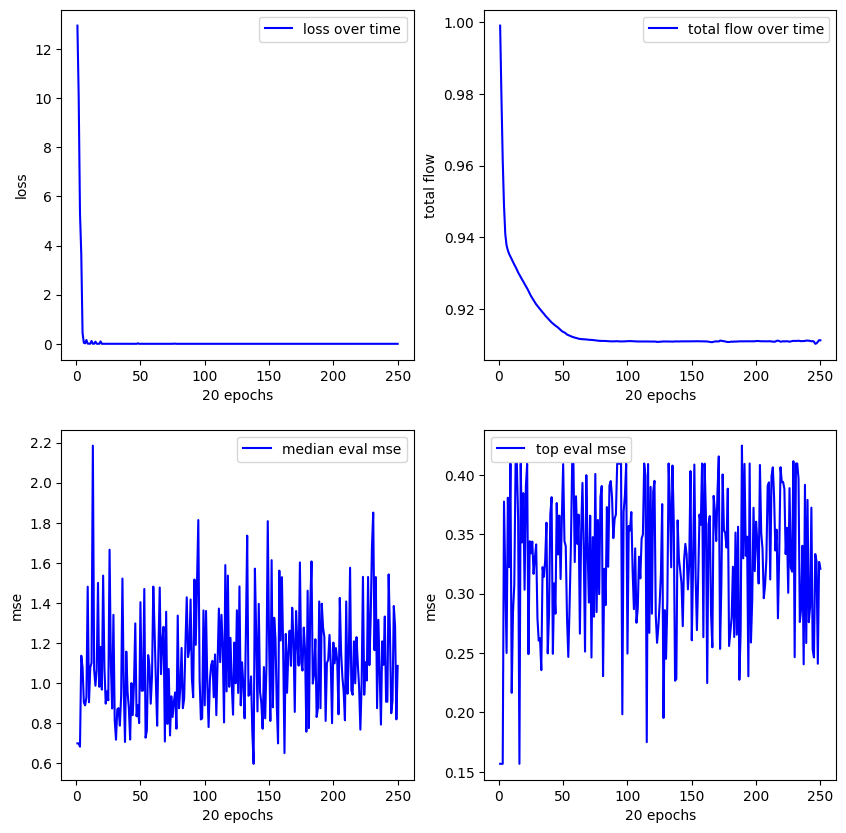

**************************************************
Experiment 20
training started with device cuda


12.161:   0%|          | 1/5000 [00:00<09:07,  9.14it/s]


new best reward (vanilla): 0.4707227945327759
mse (pre/post optimized): 0.1767655611038208/0.1767655611038208
x1
expr: x1


10.839:   0%|          | 21/5000 [00:01<04:23, 18.90it/s]


new best reward (vanilla): 0.9414855241775513
mse (pre/post optimized): 0.005985684227198362/0.005985684227198362
(x1) + (square(x2))
expr: x1 + square(x2)


0.000: 100%|██████████| 5000/5000 [04:37<00:00, 18.02it/s]


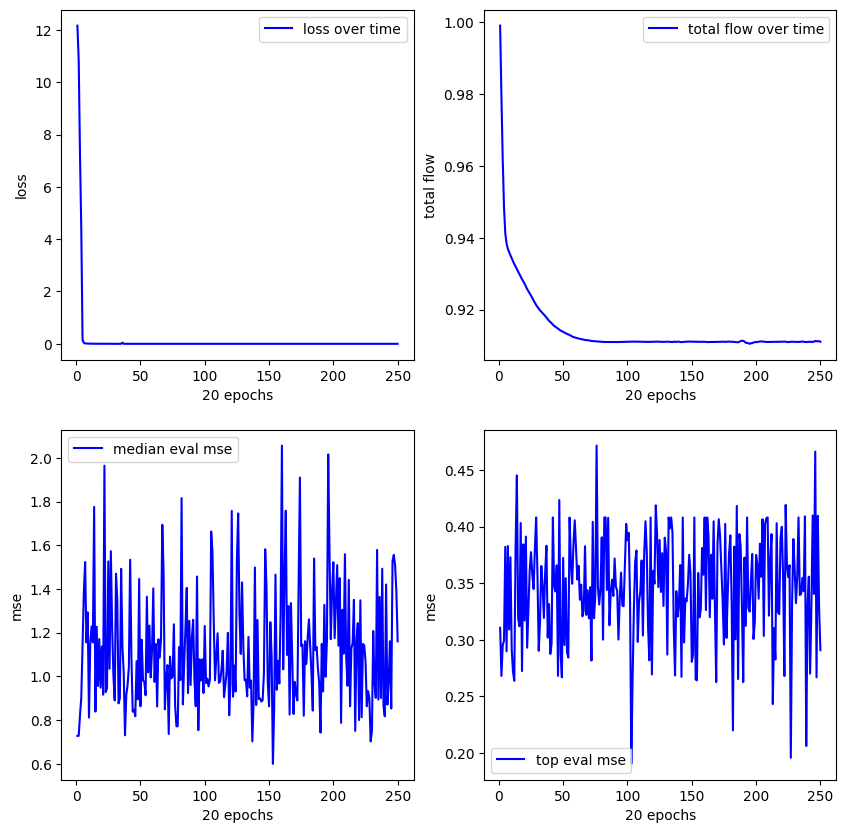

--------------------------------------------------
FUNCTION 2sin(x)cos(y) Interval considered: [-1, 1]
**************************************************
Experiment 1
training started with device cuda


15.952:   0%|          | 2/5000 [00:00<05:14, 15.91it/s]


new best reward (vanilla): 0.8562899827957153
mse (pre/post optimized): 0.12042663246393204/0.12042663246393204
x1
expr: x1


0.009:   4%|▎         | 177/5000 [00:10<05:17, 15.20it/s]


new best reward (vanilla): 0.8698253035545349
mse (pre/post optimized): 0.0016344173345714808/3.4579648971557617
(cos(x2)) / ((0.18) / (x1))
expr: 5.55555555555556*x1*cos(x2)


0.000: 100%|██████████| 5000/5000 [04:35<00:00, 18.12it/s]


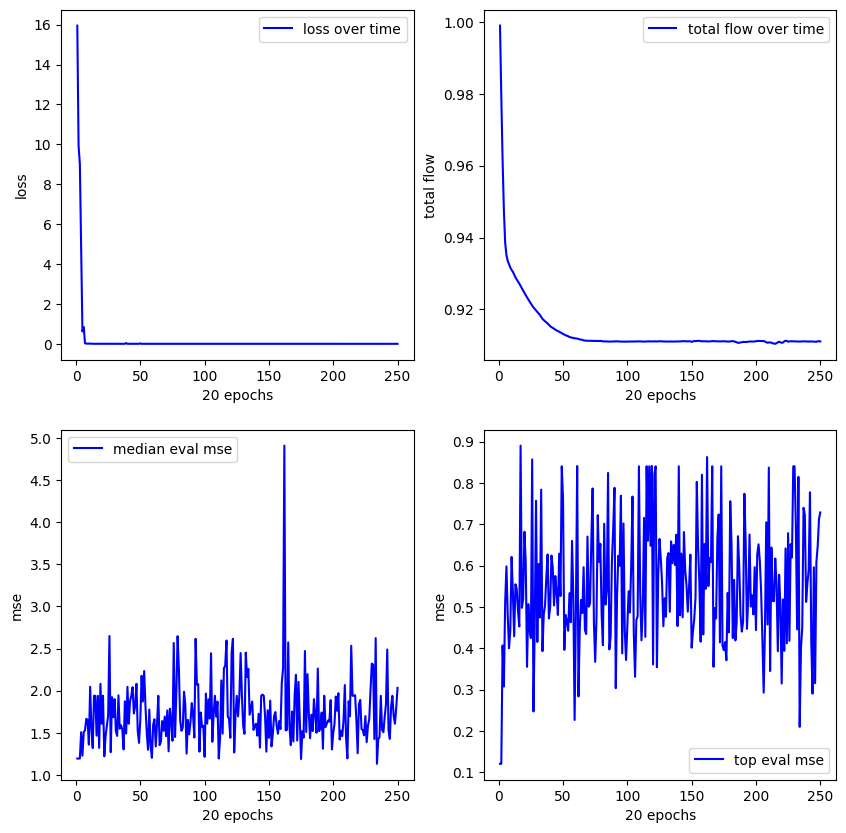

**************************************************
Experiment 2
training started with device cuda


16.216:   0%|          | 1/5000 [00:00<15:11,  5.49it/s]


new best reward (vanilla): 0.9331967830657959
mse (pre/post optimized): 0.05402185395359993/0.05402185395359993
sin((x1) + (x1))
expr: sin(2*x1)


0.000: 100%|██████████| 5000/5000 [04:31<00:00, 18.39it/s]


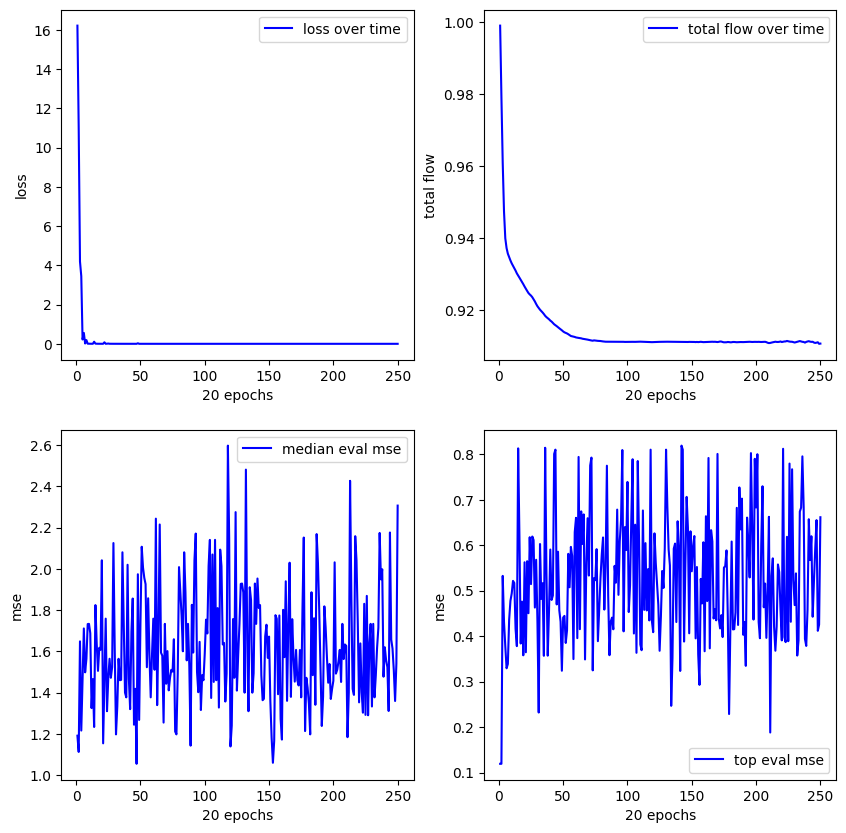

**************************************************
Experiment 3
training started with device cuda


13.265:   0%|          | 2/5000 [00:00<05:58, 13.96it/s]


new best reward (vanilla): 0.8543014526367188
mse (pre/post optimized): 0.1034882441163063/0.1034882441163063
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [04:33<00:00, 18.27it/s]


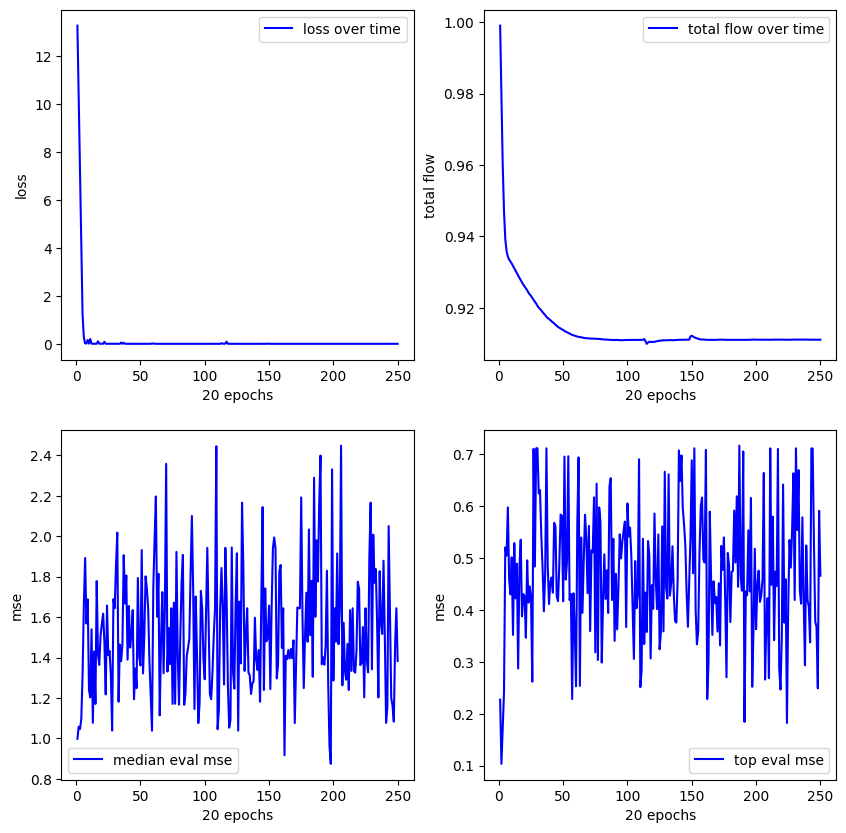

**************************************************
Experiment 4
training started with device cuda


12.424:   0%|          | 2/5000 [00:00<06:11, 13.46it/s]


new best reward (vanilla): 0.8523814082145691
mse (pre/post optimized): 0.10441385954618454/0.10441385954618454
log(exp(x1))
expr: log(exp(x1))


0.000: 100%|██████████| 5000/5000 [04:32<00:00, 18.37it/s]


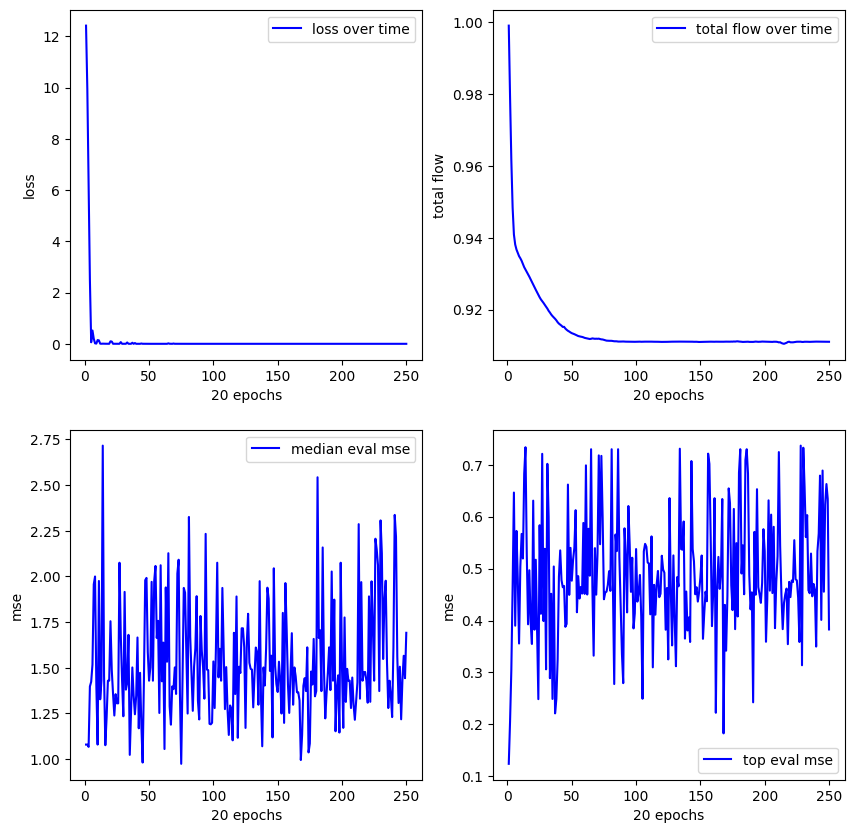

**************************************************
Experiment 5
training started with device cuda


13.371:   0%|          | 2/5000 [00:00<06:08, 13.54it/s]


new best reward (vanilla): 0.8452867865562439
mse (pre/post optimized): 0.10917194187641144/0.10917194187641144
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [04:32<00:00, 18.36it/s]


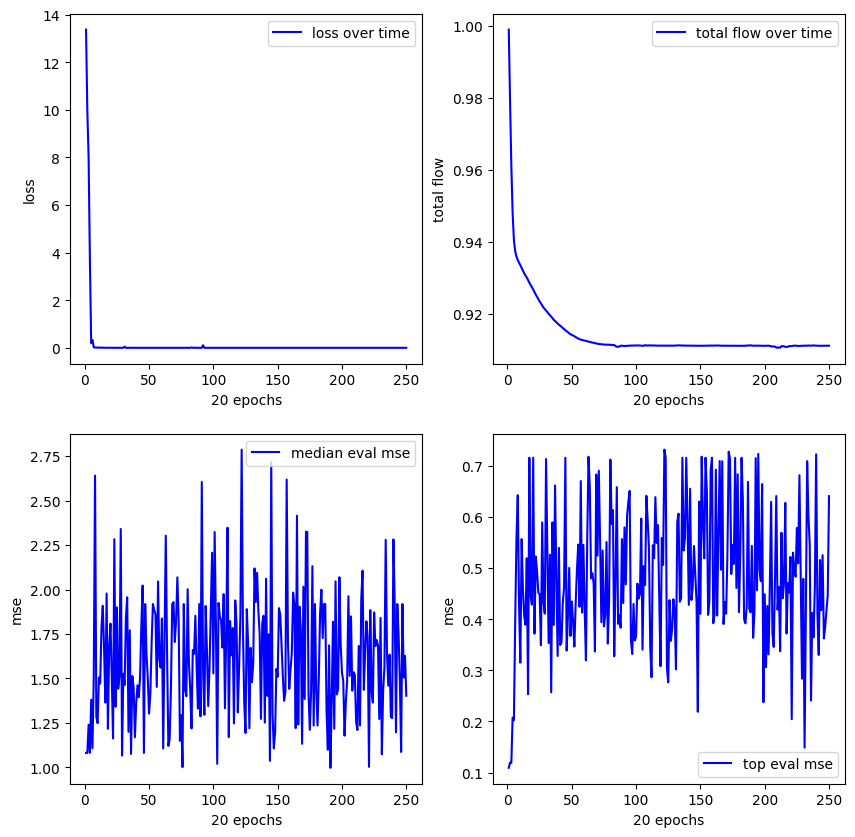

**************************************************
Experiment 6
training started with device cuda


11.453:   0%|          | 2/5000 [00:00<05:46, 14.42it/s]


new best reward (vanilla): 0.8558559417724609
mse (pre/post optimized): 0.11617264896631241/0.11617264896631241
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [04:30<00:00, 18.52it/s]


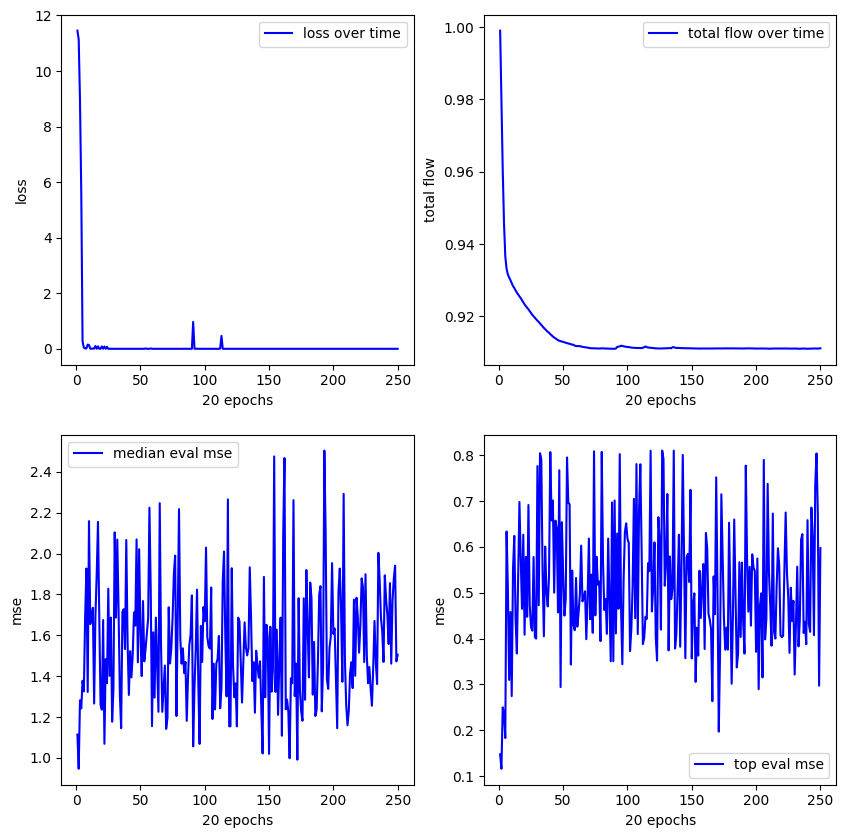

**************************************************
Experiment 7
training started with device cuda


19.413:   0%|          | 2/5000 [00:00<07:11, 11.58it/s]


new best reward (vanilla): 0.935012698173523
mse (pre/post optimized): 0.04832734912633896/0.04832734912633896
(sin(x1)) + (sin(x1))
expr: 2*sin(x1)


10.010:   1%|          | 33/5000 [00:01<02:52, 28.72it/s]


new best reward (vanilla): 0.9575539231300354
mse (pre/post optimized): 0.0018319477094337344/0.0016947750700637698
((x1) / (0.55)) * (cos(x2))
expr: 1.81818181818182*x1*cos(x2)


0.000: 100%|██████████| 5000/5000 [04:37<00:00, 18.04it/s]


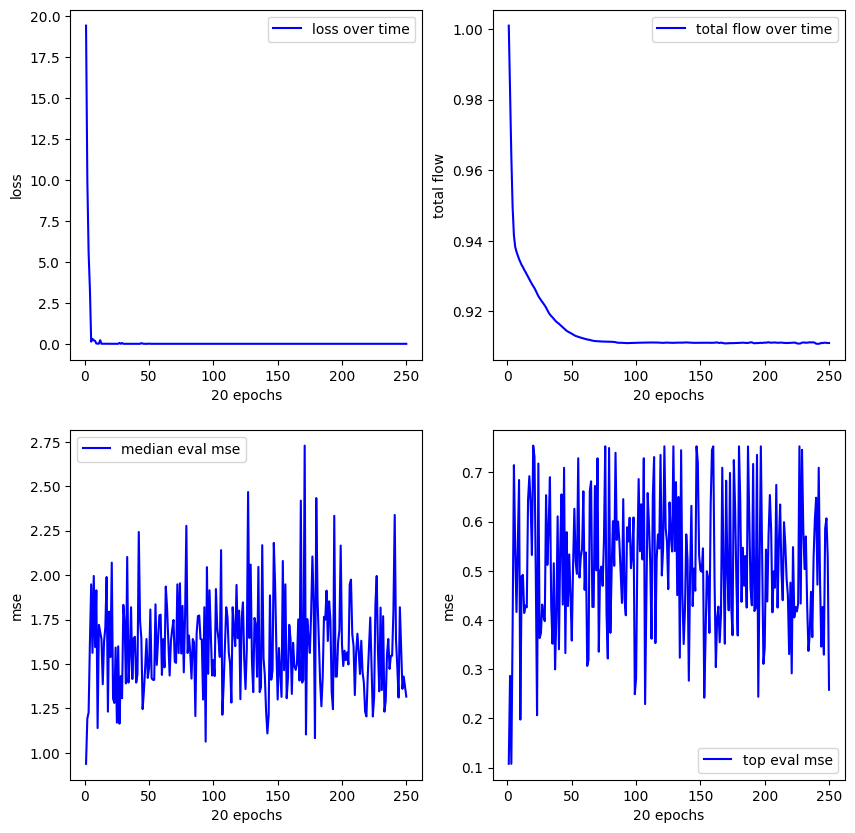

**************************************************
Experiment 8
training started with device cuda


11.653:   0%|          | 1/5000 [00:00<08:50,  9.43it/s]


new best reward (vanilla): 0.8780802488327026
mse (pre/post optimized): 0.0892319455742836/0.0892319455742836
(x1) + (x1)
expr: 2*x1


0.000: 100%|██████████| 5000/5000 [04:32<00:00, 18.36it/s]


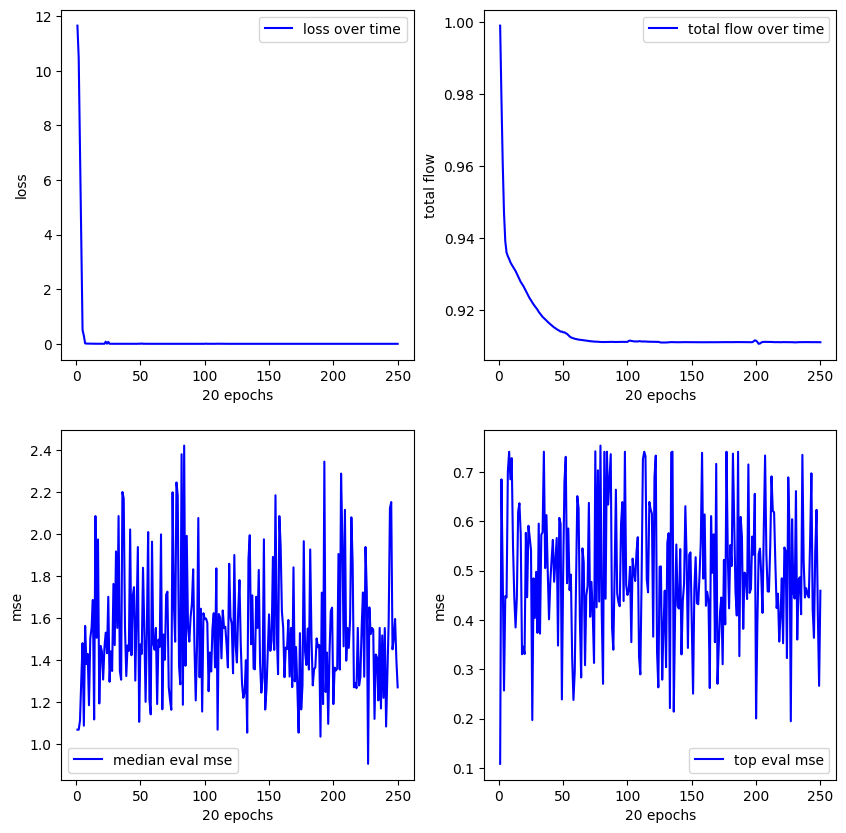

**************************************************
Experiment 9
training started with device cuda


11.713:   0%|          | 1/5000 [00:00<10:41,  7.80it/s]


new best reward (vanilla): 0.8514008522033691
mse (pre/post optimized): 0.12056419998407364/0.12056419998407364
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [04:37<00:00, 17.99it/s]


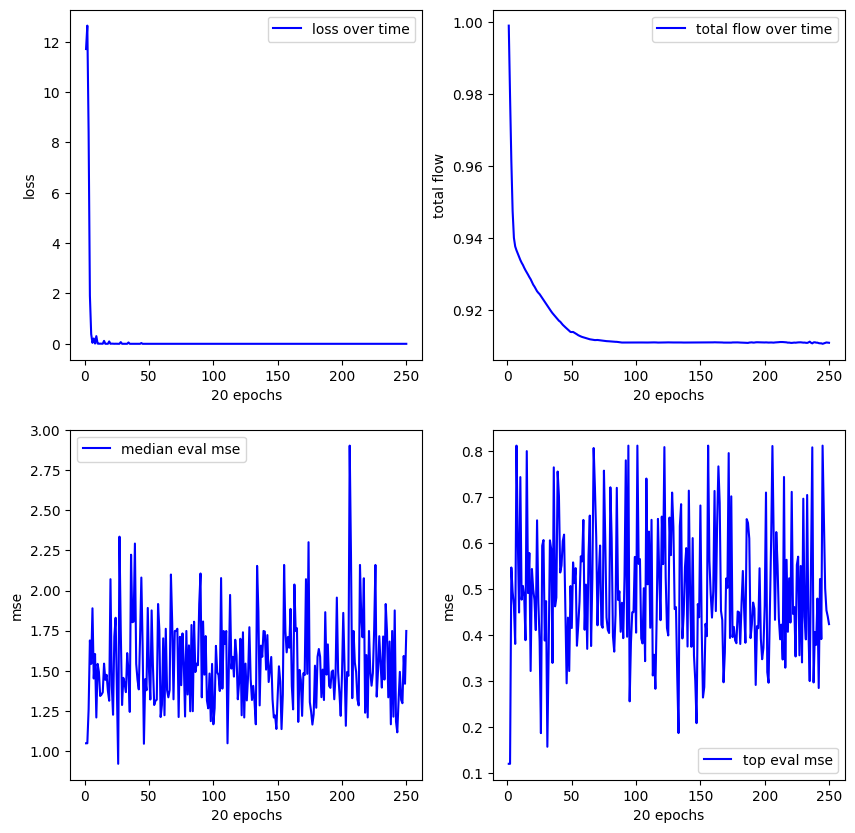

**************************************************
Experiment 10
training started with device cuda


16.554:   0%|          | 2/5000 [00:00<06:28, 12.87it/s]


new best reward (vanilla): 0.8632727861404419
mse (pre/post optimized): 0.0949094295501709/0.0949094295501709
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [03:16<00:00, 25.47it/s]


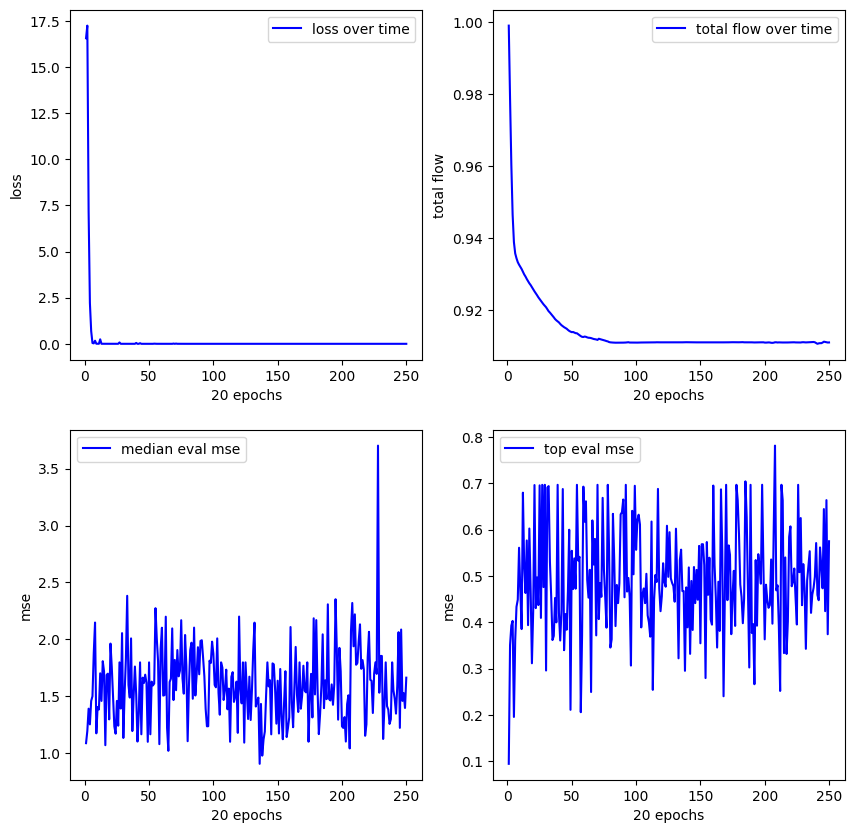

**************************************************
Experiment 11
training started with device cuda


12.583:   0%|          | 3/5000 [00:00<03:06, 26.75it/s]


new best reward (vanilla): 0.859368085861206
mse (pre/post optimized): 0.10842397809028625/0.10842397809028625
x1
expr: x1


0.393:   2%|▏         | 119/5000 [00:02<02:08, 38.11it/s]


new best reward (vanilla): 0.8743489980697632
mse (pre/post optimized): 0.0013280442217364907/0.0013280442217364907
((x1) / (0.55)) * (cos(x2))
expr: 1.81818181818182*x1*cos(x2)


0.000: 100%|██████████| 5000/5000 [02:05<00:00, 39.78it/s]


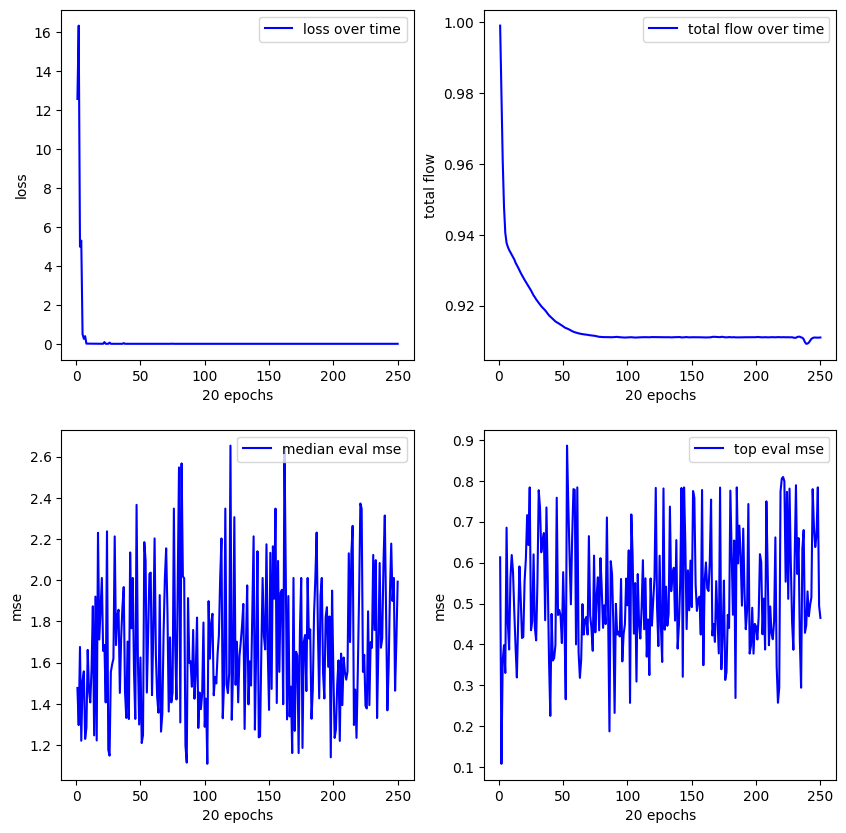

**************************************************
Experiment 12
training started with device cuda


15.248:   0%|          | 3/5000 [00:00<03:28, 24.01it/s]


new best reward (vanilla): 0.8498151302337646
mse (pre/post optimized): 0.10687953233718872/0.10687953233718872
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [02:05<00:00, 39.73it/s]


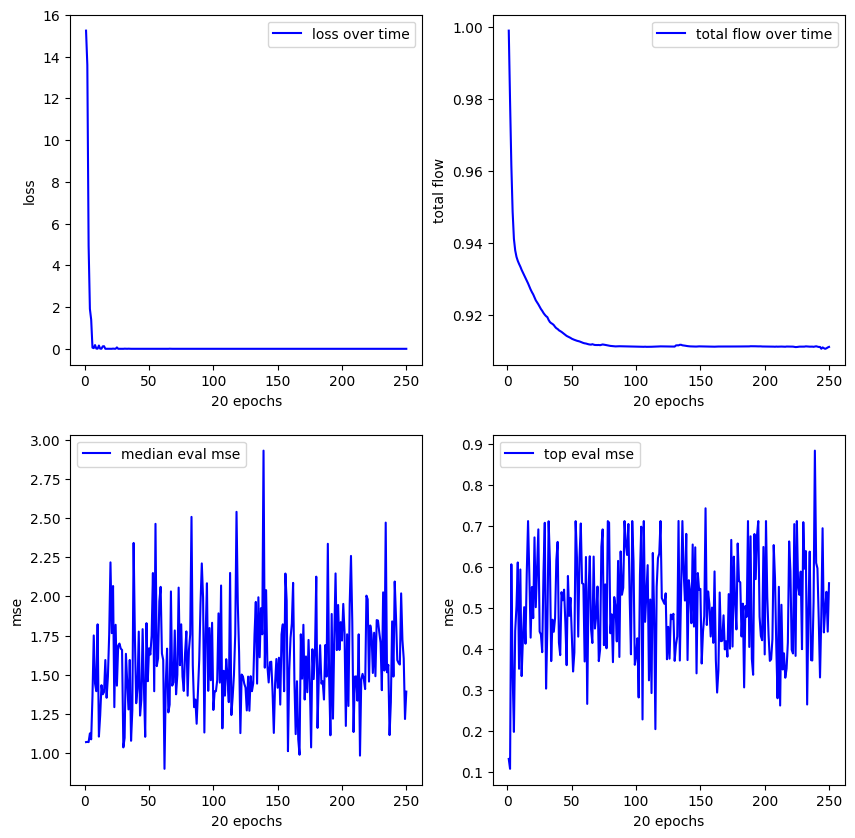

**************************************************
Experiment 13
training started with device cuda


16.967:   0%|          | 2/5000 [00:00<05:43, 14.54it/s]


new best reward (vanilla): 0.8494086265563965
mse (pre/post optimized): 0.12772943079471588/0.12772943079471588
x1
expr: x1


0.029:   3%|▎         | 141/5000 [00:03<02:12, 36.66it/s]


new best reward (vanilla): 0.8543657660484314
mse (pre/post optimized): 0.0016742980806156993/0.0016742980806156993
((x1) / (0.55)) * (cos(x2))
expr: 1.81818181818182*x1*cos(x2)


0.000: 100%|██████████| 5000/5000 [02:07<00:00, 39.36it/s]


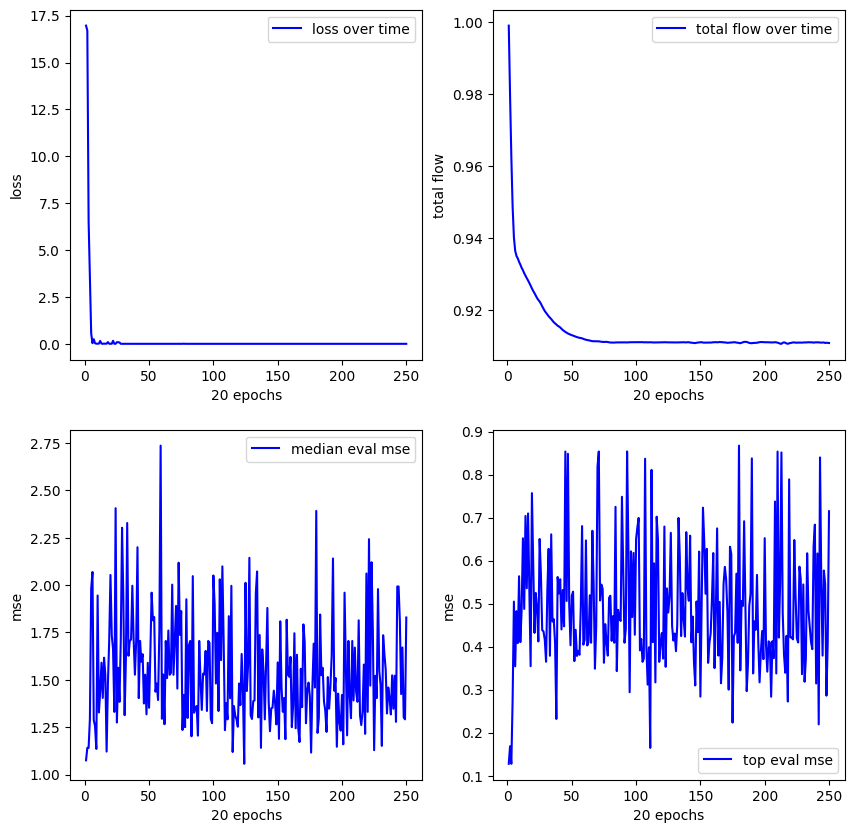

**************************************************
Experiment 14
training started with device cuda


19.655:   0%|          | 3/5000 [00:00<03:36, 23.04it/s]


new best reward (vanilla): 0.9012886881828308
mse (pre/post optimized): 0.0790415033698082/0.11080877482891083
((0.19) + (x1)) + (sin(x1))
expr: x1 + sin(x1) + 0.19


0.000: 100%|██████████| 5000/5000 [02:07<00:00, 39.10it/s]


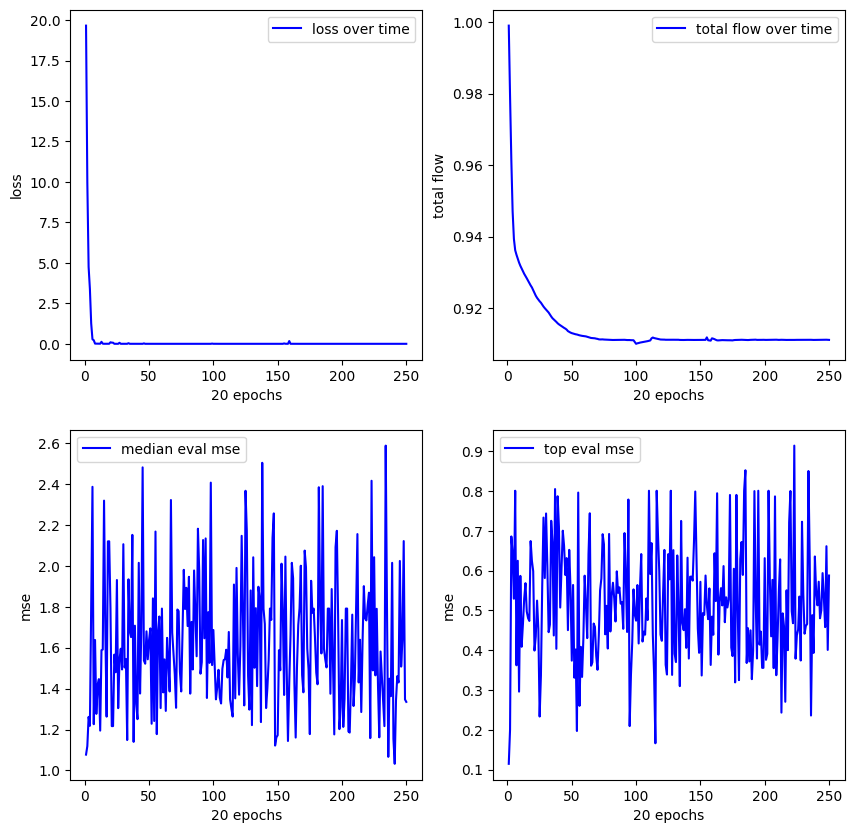

**************************************************
Experiment 15
training started with device cuda


14.667:   0%|          | 4/5000 [00:00<02:24, 34.66it/s]


new best reward (vanilla): 0.8617854714393616
mse (pre/post optimized): 0.11172150820493698/0.11172150820493698
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [02:04<00:00, 40.28it/s]


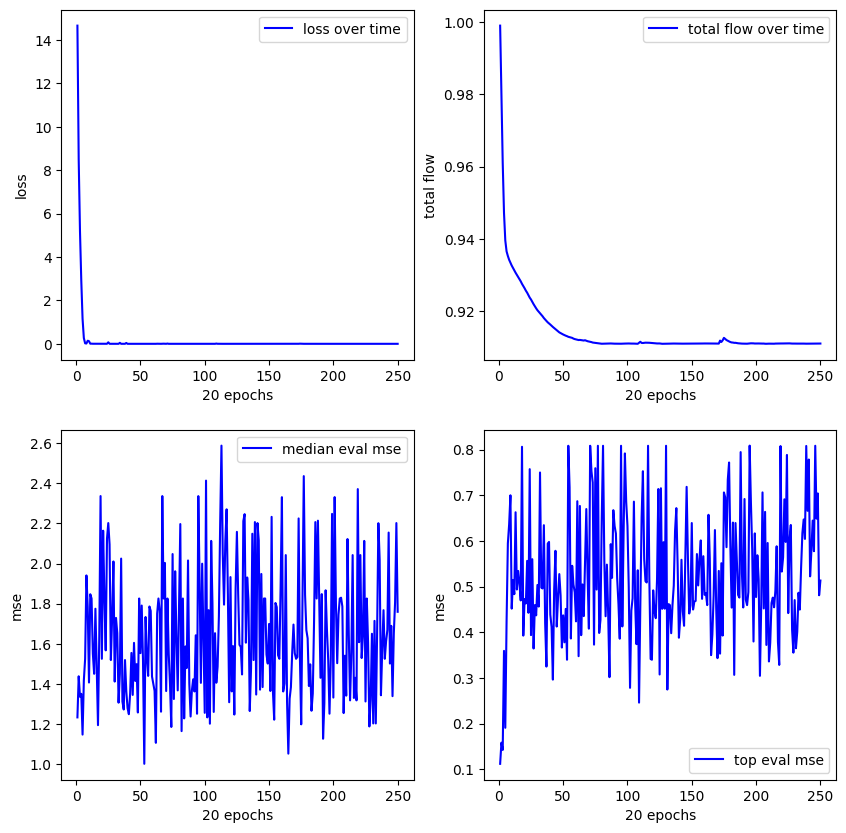

**************************************************
Experiment 16
training started with device cuda


17.057:   0%|          | 2/5000 [00:00<04:31, 18.38it/s]


new best reward (vanilla): 0.8691225051879883
mse (pre/post optimized): 0.09832208603620529/0.09832208603620529
x1
expr: x1


6.124:   1%|          | 43/5000 [00:01<02:02, 40.47it/s] 


new best reward (vanilla): 0.9472553133964539
mse (pre/post optimized): 0.0018045702017843723/0.0015829993644729257
(cos(x2)) / ((0.55) / (x1))
expr: 1.81818181818182*x1*cos(x2)


0.000: 100%|██████████| 5000/5000 [02:05<00:00, 39.94it/s]


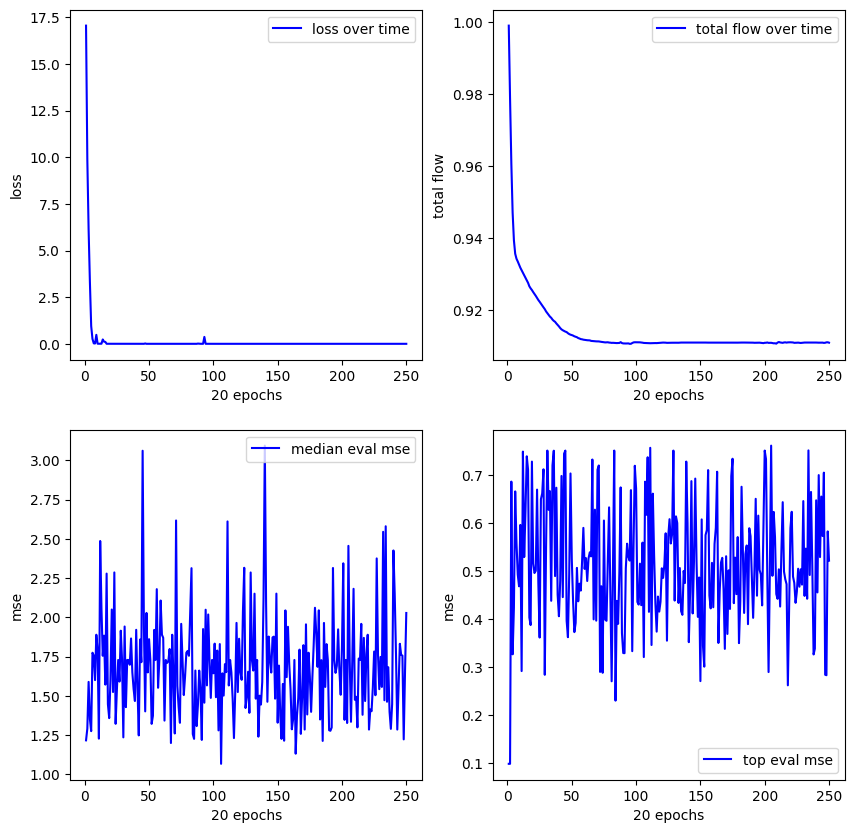

**************************************************
Experiment 17
training started with device cuda


18.144:   0%|          | 2/5000 [00:00<04:26, 18.78it/s]


new best reward (vanilla): 0.8409977555274963
mse (pre/post optimized): 0.13773581385612488/0.13773581385612488
x1
expr: x1

new best reward (vanilla): 0.9004343152046204
mse (pre/post optimized): 0.01360468752682209/0.01360468752682209
(cos(x2)) * ((x1) + (x1))
expr: 2*x1*cos(x2)


0.000: 100%|██████████| 5000/5000 [02:06<00:00, 39.65it/s]


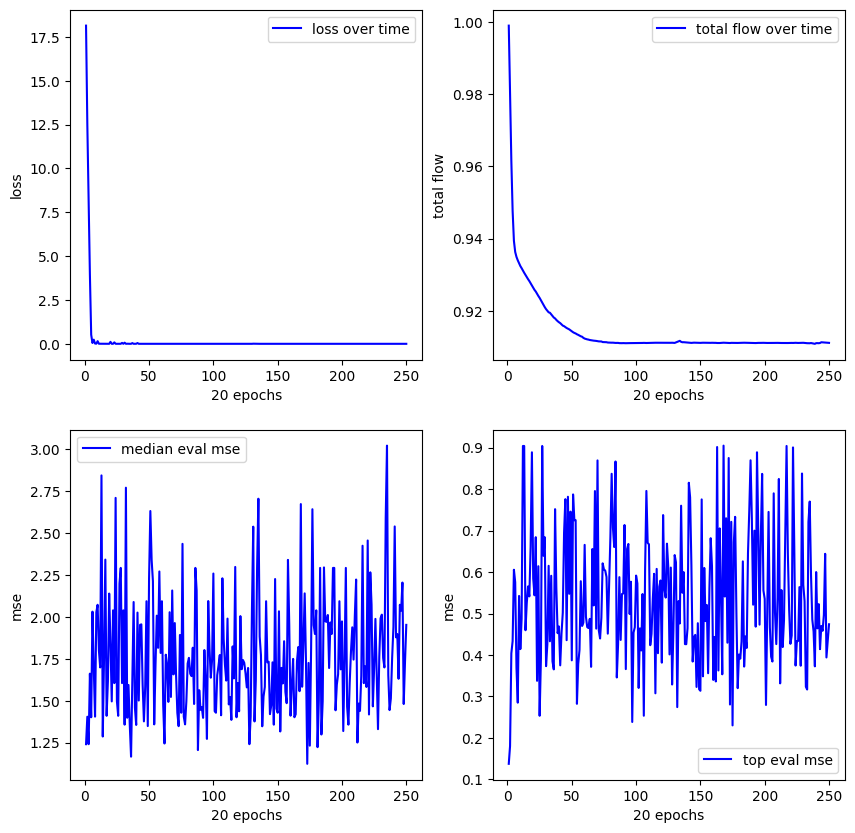

**************************************************
Experiment 18
training started with device cuda


16.367:   0%|          | 3/5000 [00:00<02:57, 28.20it/s]


new best reward (vanilla): 0.8648941516876221
mse (pre/post optimized): 0.10885491222143173/0.10885491222143173
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [02:06<00:00, 39.43it/s]


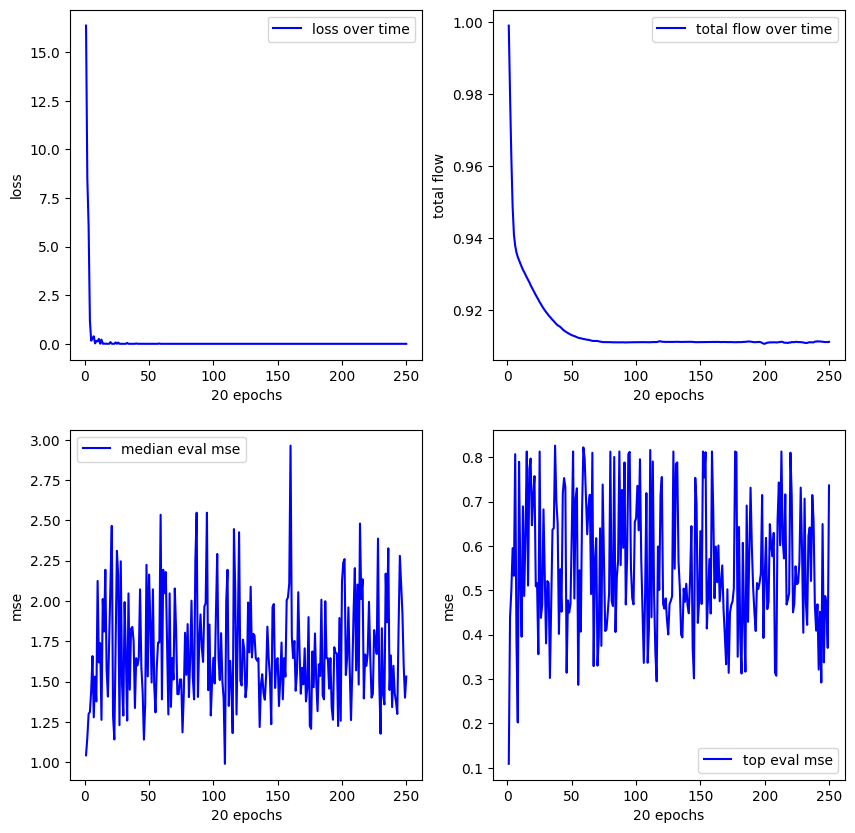

**************************************************
Experiment 19
training started with device cuda


12.551:   0%|          | 1/5000 [00:00<09:01,  9.23it/s]


new best reward (vanilla): 0.9138655662536621
mse (pre/post optimized): 0.06692565232515335/0.04103308543562889
sin((x1) / (0.55))
expr: sin(1.81818181818182*x1)


0.000: 100%|██████████| 5000/5000 [02:04<00:00, 40.25it/s]


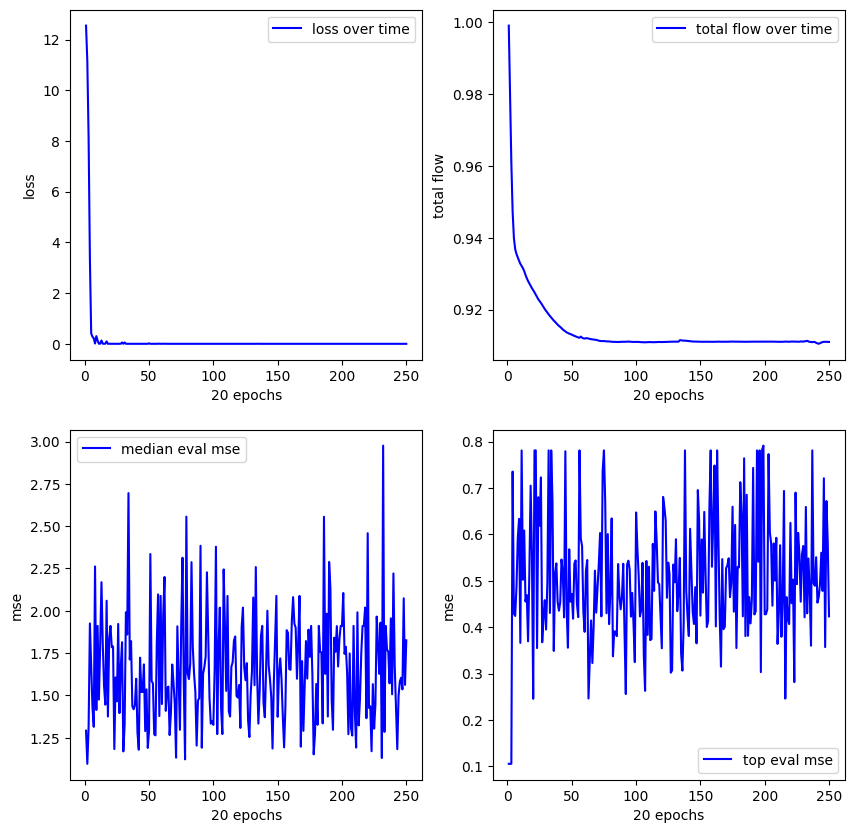

**************************************************
Experiment 20
training started with device cuda


12.528:   0%|          | 3/5000 [00:00<03:52, 21.51it/s]


new best reward (vanilla): 0.8467718958854675
mse (pre/post optimized): 0.12053065001964569/0.12053065001964569
x1
expr: x1


0.000: 100%|██████████| 5000/5000 [02:01<00:00, 41.25it/s]


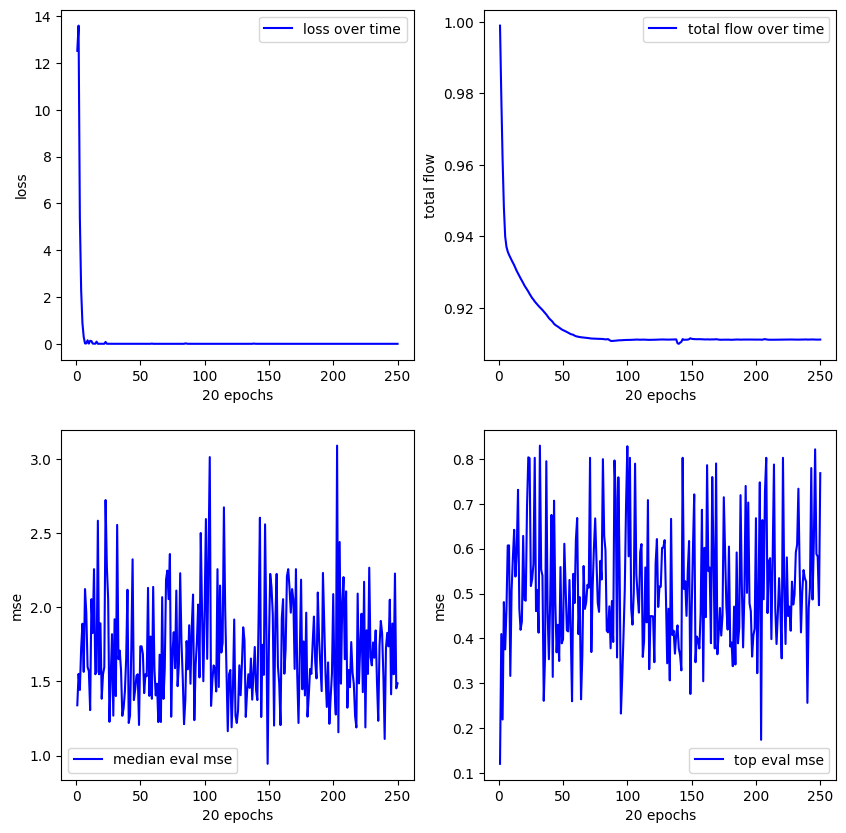

In [7]:
for i, (function, params) in enumerate(FUNC_PARAMS.items()):
    print('-'*50)
    print(f"FUNCTION {params['expr']}", f"Interval considered: [{params['interval'][0]}, {params['interval'][1]}]")
    for k in range(20):
        print('*'*50)
        print(f"Experiment {k+1}")

        low_bound, upp_bound = params["interval"]
        exp_path = results_folder/f"h{i+1}"/f"exp{k+1}"
        exp_path.mkdir(exist_ok=True, parents=True)
        # Traslación lineal al intervalo correspondiente
        X = torch.empty(200, params["n_variables"]).uniform_(0, 1) * (upp_bound - low_bound) + low_bound
        y = function(*X.split(1, dim=1))
        model, env, errs, avg_mses, top_mses = train_gfn_sr(X, y, batch_size, num_epochs, seed=(i+1)*k, show_plot=True, use_gpu=True, save_path=str(exp_path/"plots.png"))
        torch.save(model, str(exp_path/f"h{i+1}_no_noise.pt"))
        evaluate_model(env, model, save_path=str(exp_path/"results.json"))

#### Resultados

In [11]:
for experiment in sorted(results_folder.iterdir(), key=lambda x: int(x.name[1:])):
    results_list = []
    for iteration in experiment.rglob("*.json"):
        with iteration.open('r') as file:
            results = json.load(file)
            results_list.append(results["rmse"])
    results_tensor = torch.tensor(results_list)
    print(f"{experiment.name:3} -> mean: {results_tensor.mean().item():.3f}, std: {results_tensor.std().item():.3f}")

h1  -> mean: 1.044, std: 0.201
h2  -> mean: 1.180, std: 0.167
h3  -> mean: 1.364, std: 0.186
h4  -> mean: 1.506, std: 0.252
h5  -> mean: 1.299, std: 0.284
h6  -> mean: 1.032, std: 0.131
h7  -> mean: 1.123, std: 0.254
h8  -> mean: 0.000, std: 0.000
h9  -> mean: 1.037, std: 0.198
h10 -> mean: 1.316, std: 0.271


In [ ]:
model = SR